In [1]:
# Auto loading
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

In [2]:
%matplotlib inline
import matplotlib.pyplot as plt
import cPickle as pickle
import multiprocessing
import scipy.special
import numpy as np
import numpy.fft as fft
import time
import os
import sys
sys.path.insert(1,'/Users/zyzdiana/GitHub/AC297r-Volume-Registration/code')

In [3]:
from utils import to_radian,res_to_rad,ax_to_w,rep_to_angle
from rotation_3d import tricubic_derivatives,tricubic_interp
from visualize import plot_cost_func,plot_volume
from cost_functions import cf_ssd
from Gauss_Newton import Gauss_Newton, axis_derivatives,print_results,sphere_mask,get_nonzero_mask,fourier_filter,get_gradient_P, window,get_mask_weights
from conversion import angles_from_q

In [4]:
oct13_dict_10 = pickle.load(open('/Users/zyzdiana/Dropbox/THESIS/Pickled_Results/oct13_dict_10.p','rb'))
oct13_dict_8 = pickle.load(open('/Users/zyzdiana/Dropbox/THESIS/Pickled_Results/oct13_dict_8.p','rb'))
oct13_dict_6_4 = pickle.load(open('/Users/zyzdiana/Dropbox/THESIS/Pickled_Results/oct13_dict_6_4.p','rb'))

In [5]:
# Get All Axes of Rotations
path = '/Users/zyzdiana/Dropbox/THESIS/Sept_23_navs/'
ranges = ['0_5_to_2_5','3_0_to_5_0']
files = os.listdir(path)
axes_dict = {}
for f in files[1:]:
    rot_ax = f.split('_')[2]
    trans_ax = f.split('_')[10]
    if not axes_dict.has_key(rot_ax):
        axes_dict[rot_ax] = trans_ax
print axes_dict
print axes_dict.keys()

{'xz': 'xy', 'y': 'z', 'yz': 'xy', 'xy': 'xy', 'x': 'z', 'z': 'z'}
['xz', 'y', 'yz', 'xy', 'x', 'z']


Gauss-Newton method allows us to find the minimum of a least squared function through iterative procedures. Let 
$$\begin{align}
r_i(\boldsymbol{P}) = V^S(\boldsymbol{x_i}+\boldsymbol{d}(\boldsymbol{P}))-V^T
\end{align}$$

Then the iteration goes as follows,
$$\boldsymbol{P}^{s+1} = \boldsymbol{P}^{s} - \left(\mathbf{J_r}^\mathsf{T} \mathbf{J_r} \right)^{-1} \mathbf{ J_r} ^\mathsf{T} \mathbf{r}(\boldsymbol P^{s}),$$

let $w$ be weights, which is defined as $$w_i = \frac{\phi(r_i)}{r_i},$$ where
$$   \phi(r,c) = \left\{
\begin{array}{ll}
      x(1-\frac{x^2}{c^2})& |x|\leq c \\
      0 & otherwier
\end{array} 
\right. $$

Let $W = diag(w)$ then the updated Gauss_Newton iteration becomes,
$$\boldsymbol{P}^{s+1} = \boldsymbol{P}^{s} - \left(\mathbf{J_r}^\mathsf{T} \mathbf{W}\mathbf{J_r} \right)^{-1} \mathbf{ J_r} ^\mathsf{T} \mathbf{W} \mathbf{r}(\boldsymbol P^{s}),$$

### The window function

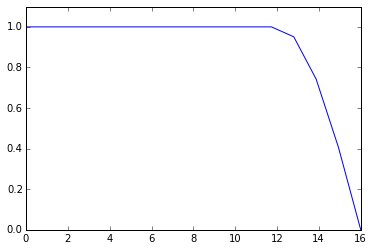

In [6]:
x = np.linspace(0,16,16)
y = [window(i,16,0.5) for i in x]
plt.plot(x,y)
plt.ylim([0,1.1])
plt.show()

In [82]:
def plot_slices_z(volume):
    fig, ax = plt.subplots(4,8)
    fig.set_figwidth(12)
    fig.set_figheight(6)
    axes = ax.ravel()
    for i in xrange(len(axes)):
        axes[i].imshow(abs(volume[:,:,i]), interpolation = 'None', cmap='gray')
        axes[i].get_xaxis().set_ticks([])
        axes[i].get_yaxis().set_ticks([])
    plt.tight_layout(pad=0, w_pad=0.3, h_pad=0.3)
    plt.show()
    
def plot_slices_y(volume):
    fig, ax = plt.subplots(4,8)
    fig.set_figwidth(12)
    fig.set_figheight(6)
    axes = ax.ravel()
    for i in xrange(len(axes)):
        axes[i].imshow(abs(volume[i,:,:]), interpolation = 'None', cmap='gray')
        axes[i].get_xaxis().set_ticks([])
        axes[i].get_yaxis().set_ticks([])
    plt.tight_layout(pad=0, w_pad=0.3, h_pad=0.3)
    plt.show()
    
def plot_slices_x(volume):
    fig, ax = plt.subplots(4,8)
    fig.set_figwidth(12)
    fig.set_figheight(6)
    axes = ax.ravel()
    for i in xrange(len(axes)):
        axes[i].imshow(abs(volume[:,i,:]), interpolation = 'None', cmap='gray')
        axes[i].get_xaxis().set_ticks([])
        axes[i].get_yaxis().set_ticks([])
    plt.tight_layout(pad=0, w_pad=0.3, h_pad=0.3)
    plt.show()

### Functions for calculating mask in iteratively  reweighted least squares

In [7]:
def Tukeys_Biweight(R, c):
    r = np.zeros(R.shape)
    mask = abs(R)<=c
    x = R[mask]
    r[mask]=x*(1-x**2/c**2)**2
    return r

def Tukeys_Biweight_1(x, c):
    if(abs(x) <= c):
        return x*(1-x**2/c**2)**2
    else:
        return 0

In [8]:
import numpy.ma as ma
import statsmodels.robust
#statsmodels.robust.scale.mad(R)
def MAD(a, c = 1.4826):
    """
    Median Absolute Deviation along given axis of an array:
    """

    a = ma.masked_where(a!=a, a)
    if a.ndim == 1:
        d = ma.median(a)
        m = c*ma.median(ma.fabs(a - d))
    else:
        d = ma.median(a, axis=axis)
        if axis > 0:
            aswp = ma.swapaxes(a,0,axis)
        else:
            aswp = a
        m = ma.median(c*ma.fabs(aswp - d), axis=0)

    return m

In [96]:
from Gauss_Newton import rotate_coords_transformation_m,trace_plot,plot_errors
def Gauss_Newton_IRLS(Vol1, Vol1_Grad_P, Vol2, Vol2_derivatives, w,
                      d = 0.4, c = 6., divide_factor = 1., alpha = 1., decrease_factor = 0.25, 
                      P_initial = np.array([0,0,0,0,0,0]), max_iter = 10, plot = True, mask = True):
    s0,s1,s2 = Vol1.shape
    if (s0 == 26): res = '10'
    if (s0 == 32): res = '8'
    if (s0 == 40): res = '6_4'
    rad = res_to_rad(res)

    xx,yy,zz = pickle.load(open('/Users/zyzdiana/Dropbox/THESIS/for_cluster/mesh_grid_%s.p'%res,'rb'))
    ox = s1/2.-0.5
    oy = s0/2.-0.5
    oz = s2/2.-0.5

    if(mask):
        mask_weights = get_mask_weights(Vol1,rad,d)

    Ps = []
    P_old = P_initial.copy()
    P_new = P_old.copy()
    Ps.append(P_new)
    errors = []
    errors.append(1.0)
    E2s = []
    #E2s.append(np.sum((Vol1-Vol2)**2)/(s0*s1*s2))
    E2s.append(1.0)
    Jr = Vol1_Grad_P.T
    #Jr_T_w = Vol1_Grad_P.dot(w)
    volume_shape = Vol1.shape
    for counter in xrange(max_iter):
        print counter,
        P_old = P_new.copy()
        # Get the new coordinates by rotating the volume by the opposite amount of P_s
        dest_x, dest_y, dest_z = rotate_coords_transformation_m(xx, yy, zz, P_old, ox, oy, oz,divide_factor,volume_shape)
        # Initilization
        dest = np.empty(volume_shape)

        for i in xrange(volume_shape[0]):
            dest[i,:,:] = tricubic_interp(volume_shape,Vol2_derivatives,dest_x[i,:,:],dest_y[i,:,:],dest_z[i,:,:])
        if(mask):
            dest *= mask_weights

        flatR = np.ravel(Vol1-dest)
        error = np.sum(flatR**2)

        ## if error is getting larger, go back one step and decrease alpha
        if(error > errors[-1]):
            alpha = alpha * decrease_factor
            P_new = Ps[-1]
        else:
            errors.append(error)
            Ps.append(P_old)
            
            # compute weights
            mad_r = MAD(flatR)
            if mad_r != 0:
                print 'MAD: ', mad_r
                R = (1./mad_r)*flatR
            W = Tukeys_Biweight(R,c)
            w = np.diag(W)
            E2 = np.sum(W*(flatR**2))/np.sum(W)
            
            # update parameters with new weights
            Jr_T_w = Vol1_Grad_P.dot(w)
            Jr_rP = -Jr_T_w.dot(flatR)
            P_new = P_old - alpha*np.dot(np.linalg.inv(np.dot(Jr_T_w,Jr)),Jr_rP)
            if((abs(P_new - P_old) < 1e-5).all()):
                print 'Converged in %s iterations!' % counter
                break
            
            residual = flatR.reshape([32,32,32])
            plot_slices_z(residual)
            weights = W.reshape([32,32,32])
            plot_slices_z(weights)
            
#             if(abs(E2-E2s[-1]) < 1e-9):
#                 E2s.append(E2)
#                 print 'mask Converged in %s iterations!' % counter
#                 break
            E2s.append(E2)
    if(plot):
        trace_plot(Ps, float('.'.join(res.split('_'))))
        plot_errors(errors)
    print 'min error:', errors[-1]
    return Ps[-1], flatR, errors[-1], E2s

0 1 2 3 4 5 6 7 8 9

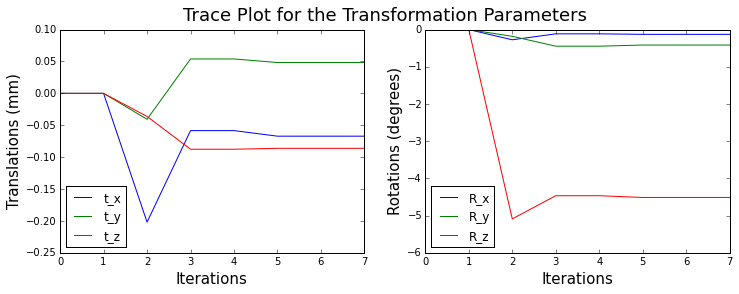

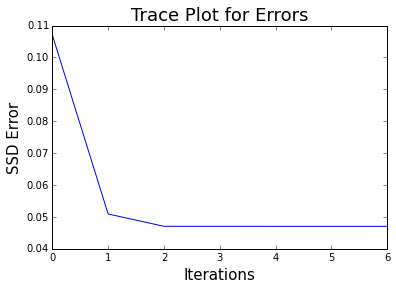

 min error: 0.0470479528212
translations: [-0.06711851  0.04838567 -0.08615962] rotations: [-0.12746684 -0.41511678 -4.51234914]


In [28]:
## No masking original
w = np.eye(s0*s1*s2)
P, R, error,error2 = Gauss_Newton_IRLS(testVol1, vol1_dervs, testVol2, vol2_dervs, w,
                         d=0.4, c=2, divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                         max_iter = 10, mask = False)
print 'translations:', P[:3]*8., 'rotations:',P[3:]*180/np.pi

0

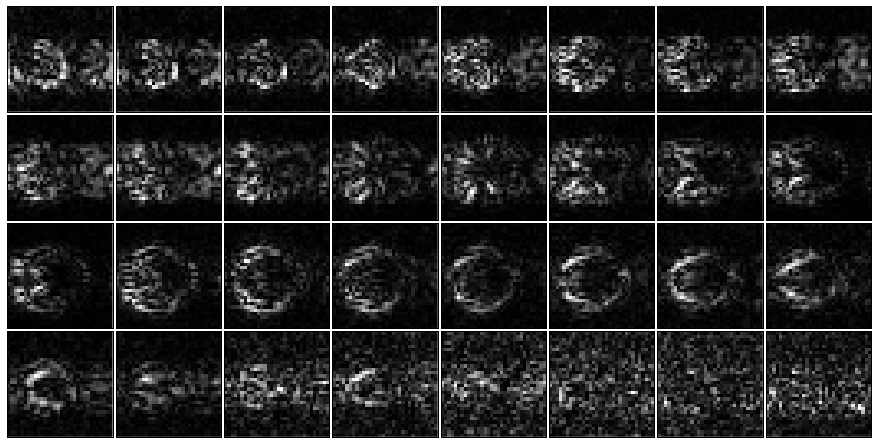

 MAD:  0.000452667400145


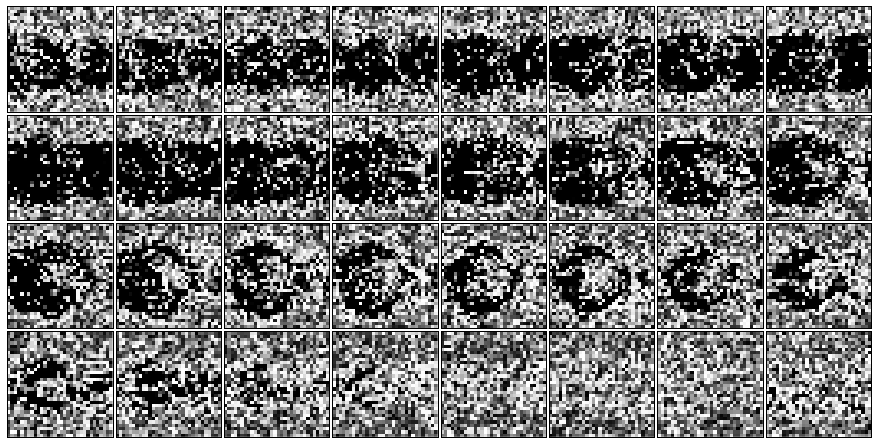

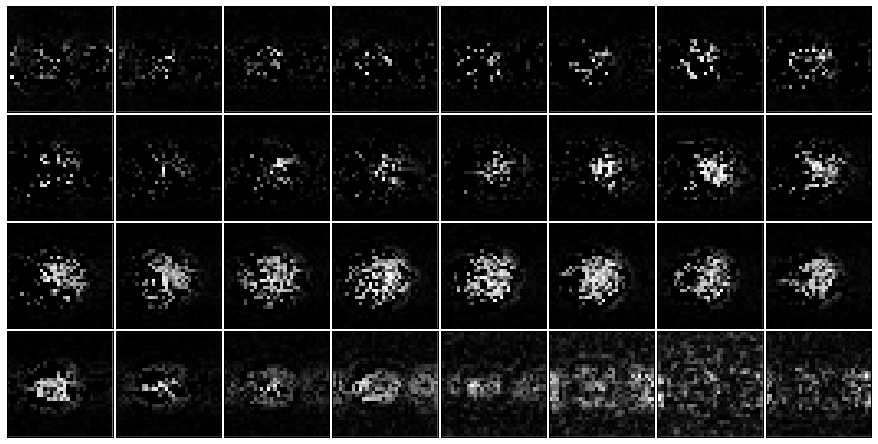

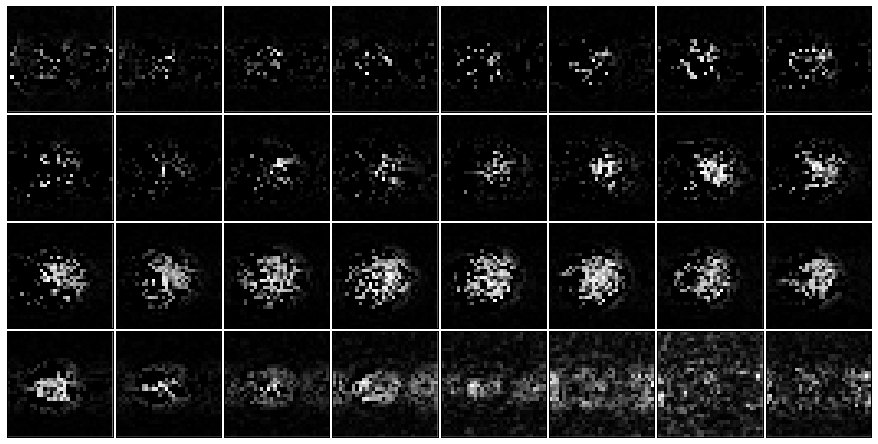

1

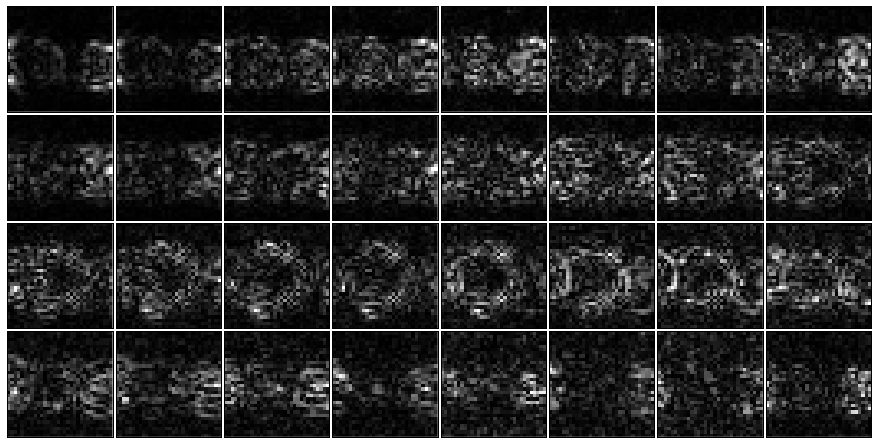

 MAD:  0.000442641087634


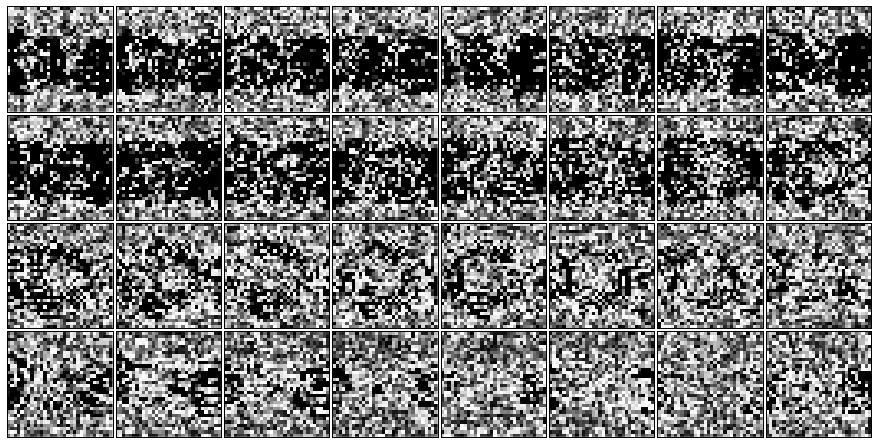

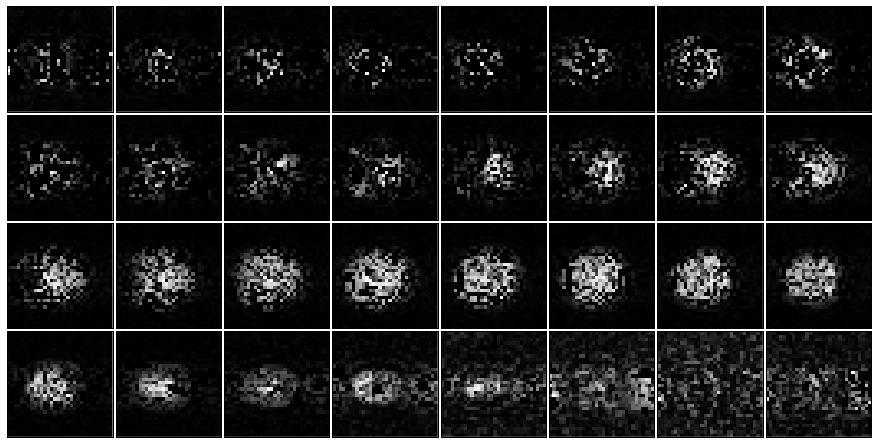

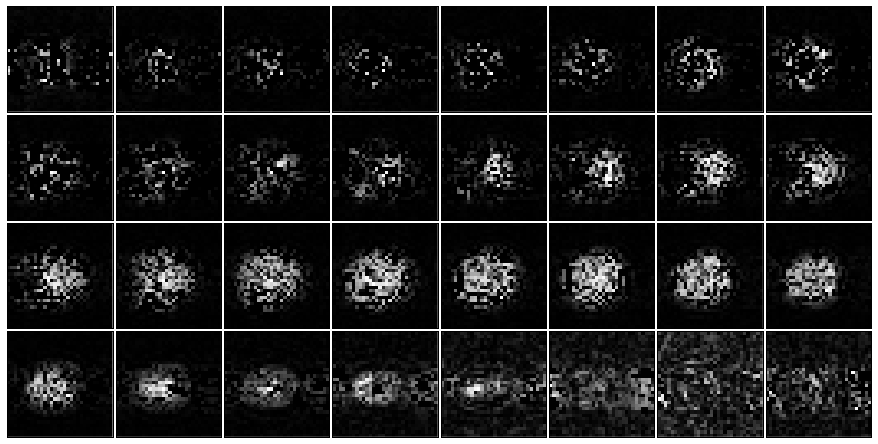

2

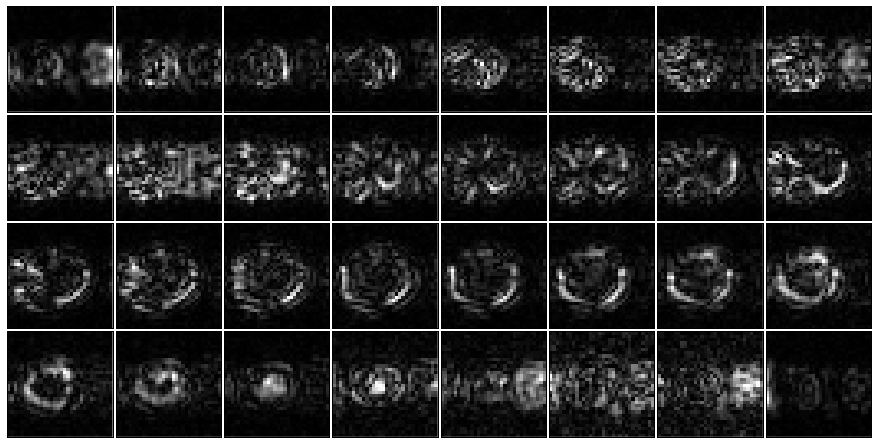

 3

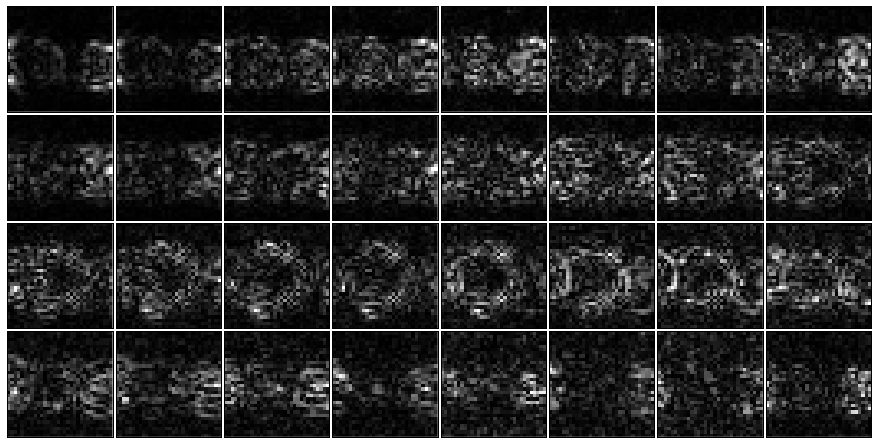

 MAD:  0.000442641087634


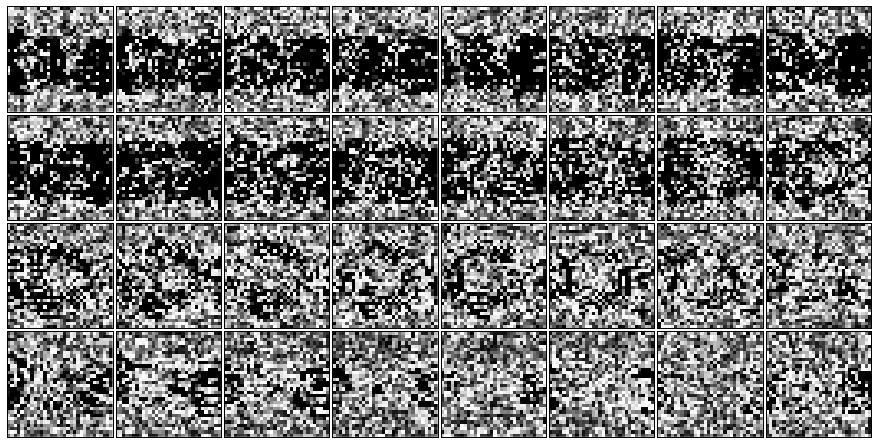

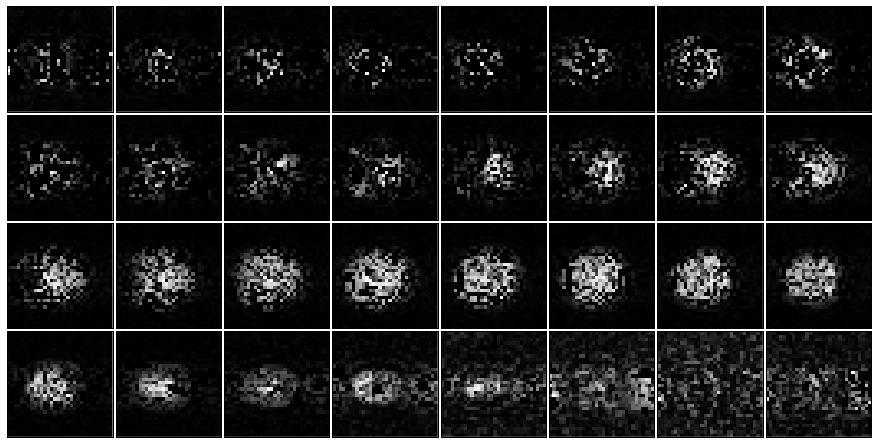

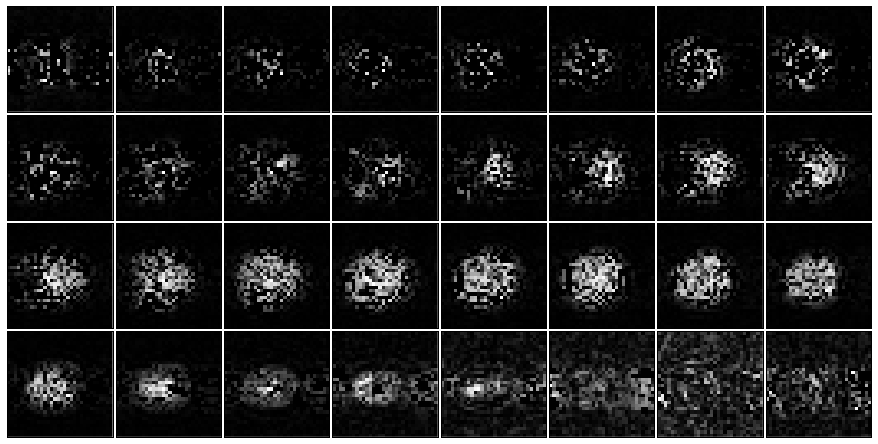

mask Converged in 3 iterations!


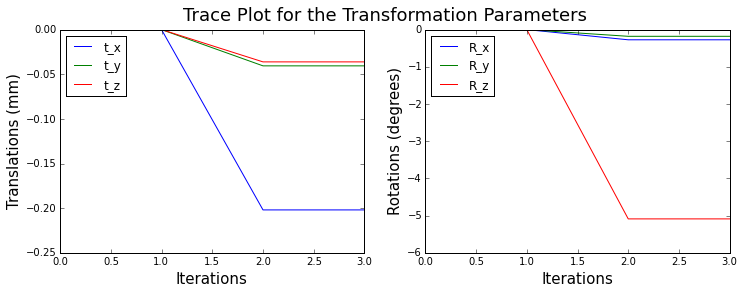

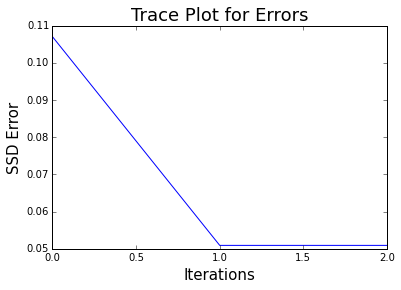

min error: 0.0509196797227
translations: [-0.2019664  -0.0406084  -0.03616002] rotations: [-0.27405924 -0.18038399 -5.08848377]


In [87]:
## No masking, just looking at the weights
w = np.eye(s0*s1*s2)
P, R, error,error2 = Gauss_Newton_IRLS(testVol1, vol1_dervs, testVol2, vol2_dervs, w,
                         d=0.4, c=2, divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                         max_iter = 5, mask = False)
print 'translations:', P[:3]*8., 'rotations:',P[3:]*180/np.pi

0

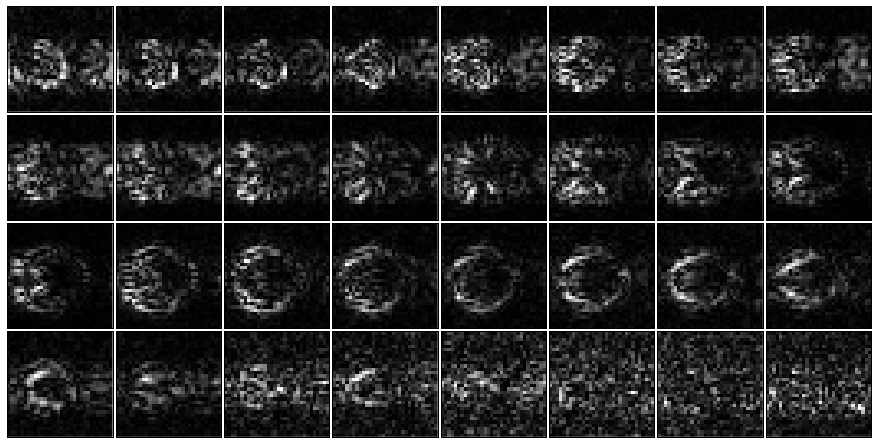

 MAD:  0.000452667400145


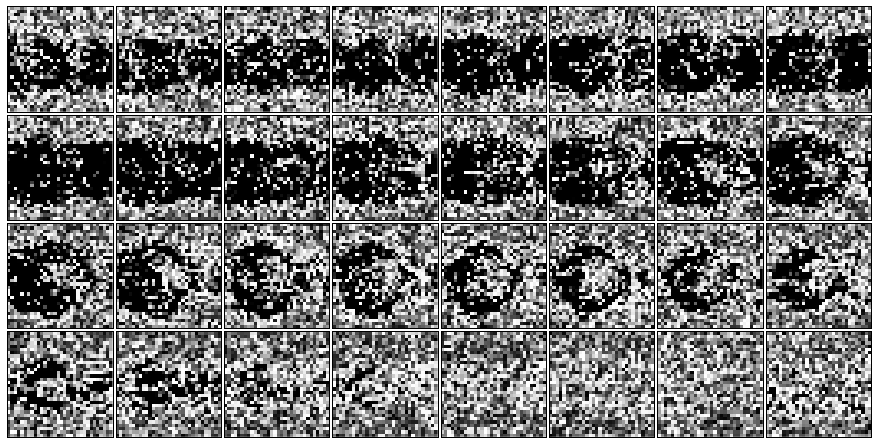

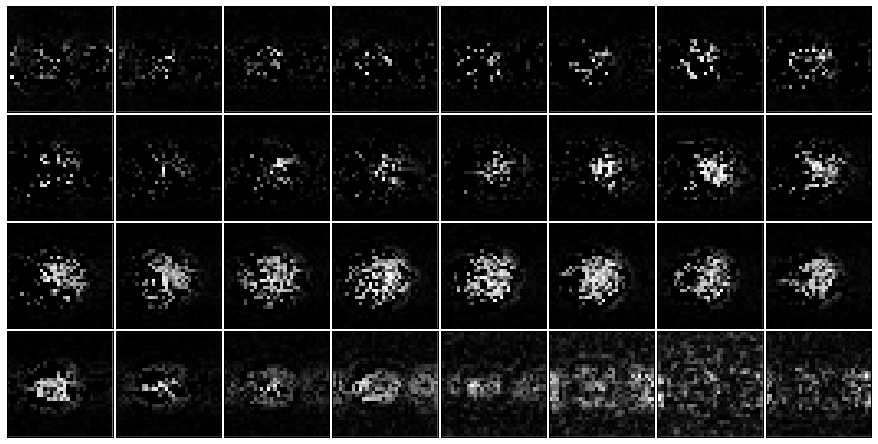

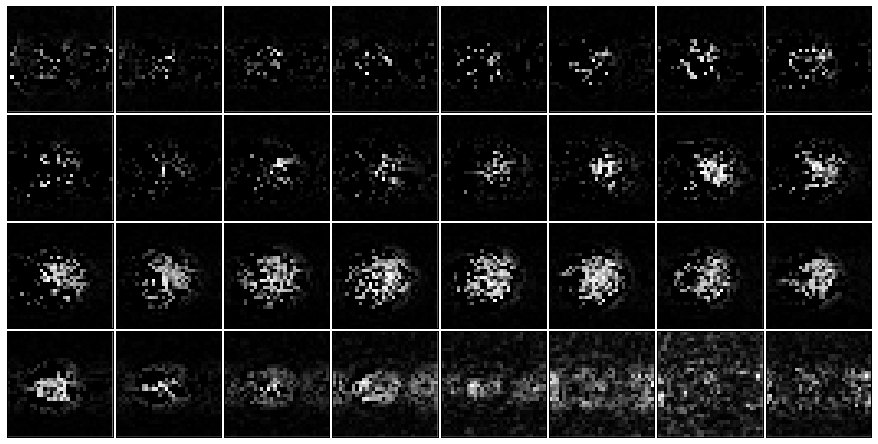

1

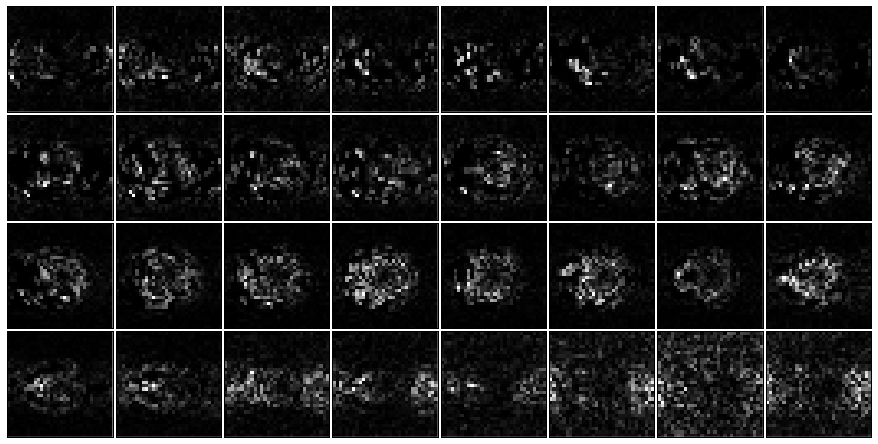

 2

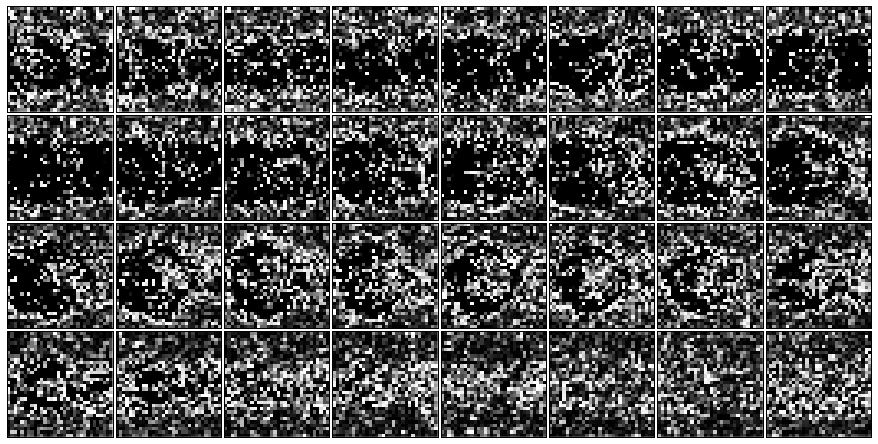

 MAD:  4.25065403896e-05


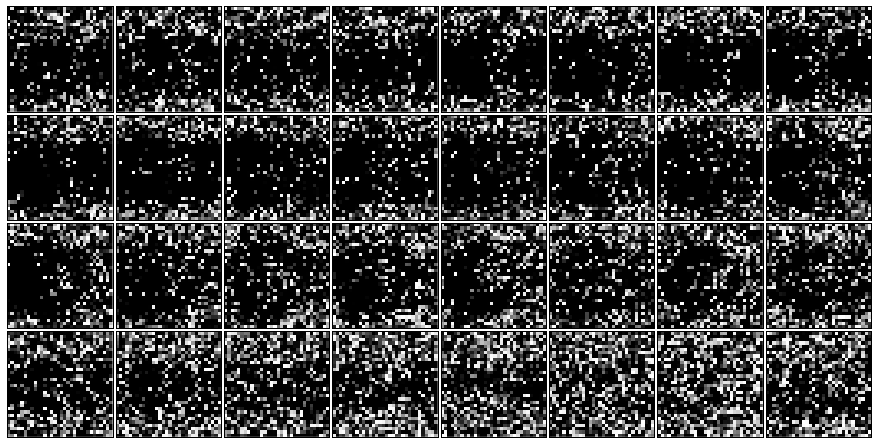

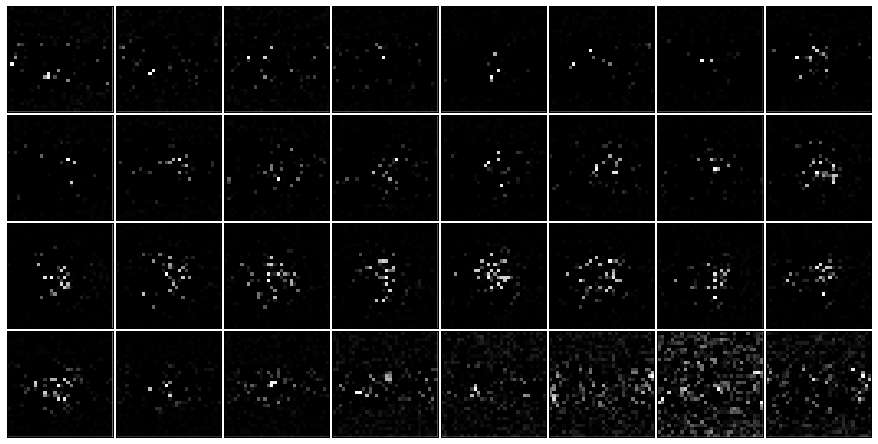

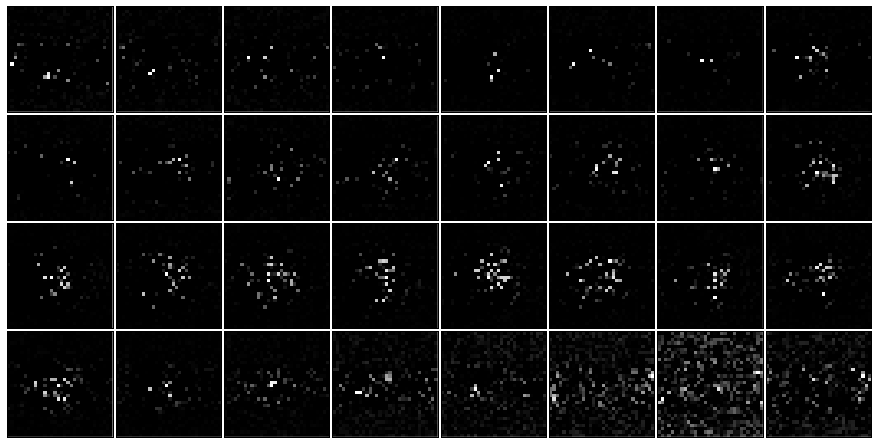

3

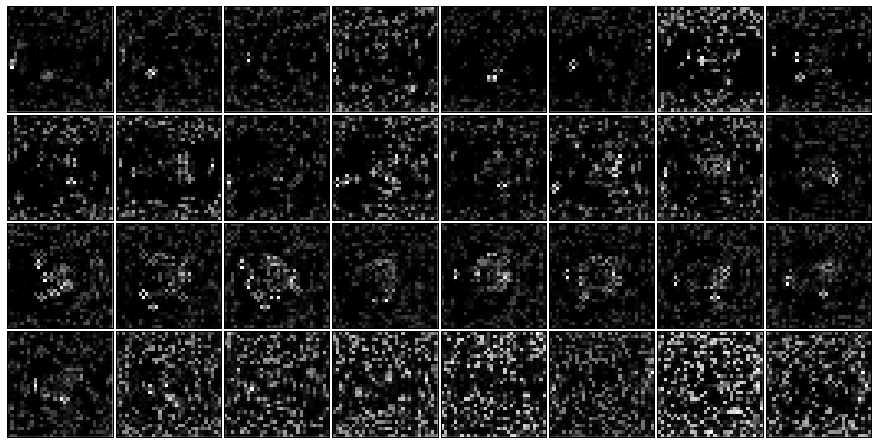

 MAD:  2.12510050933e-06


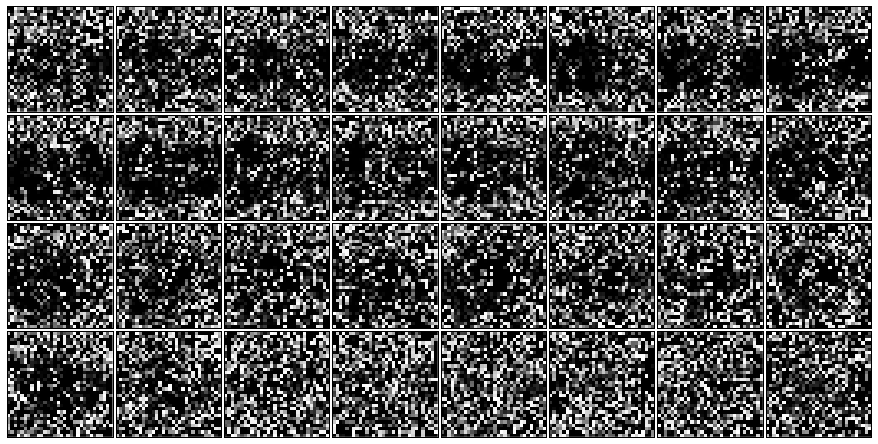

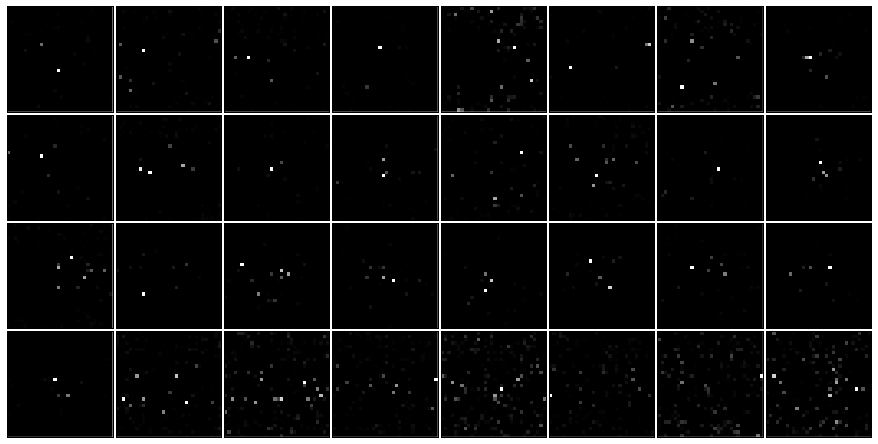

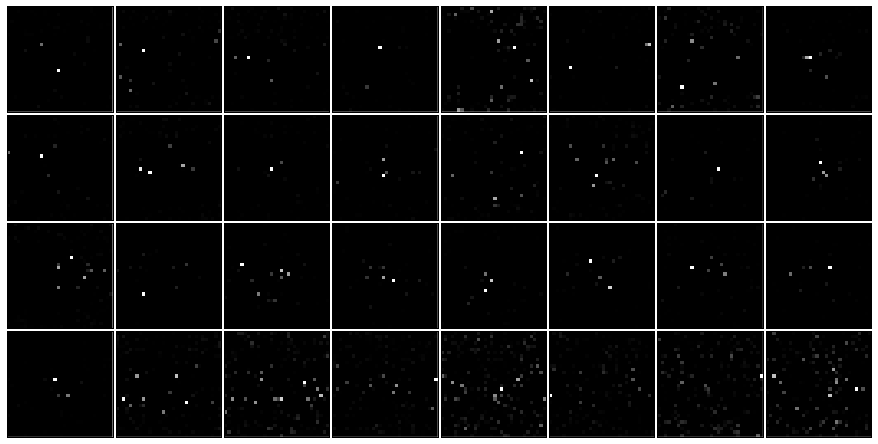

4

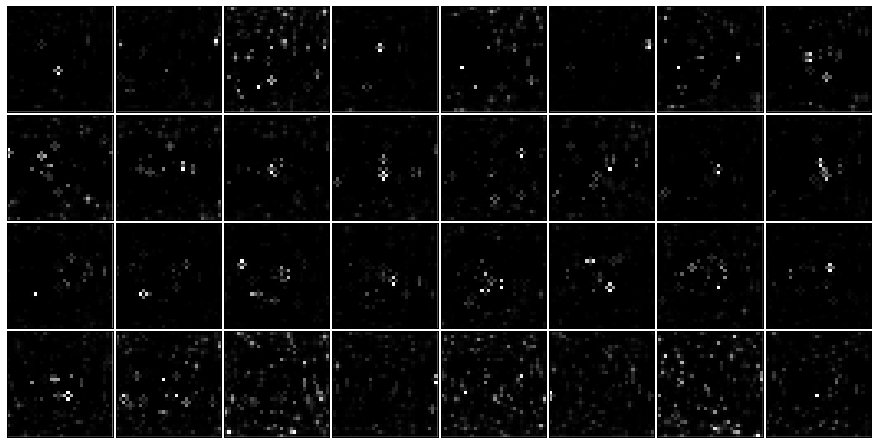

 MAD:  1.33817946878e-08


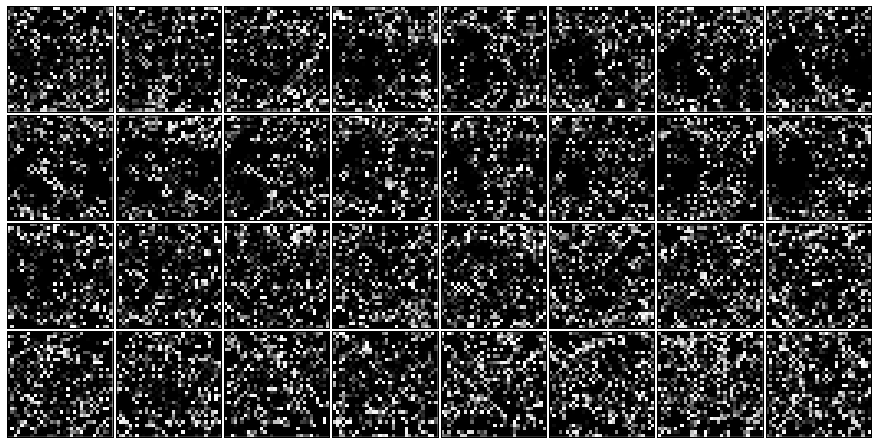

mask Converged in 4 iterations!


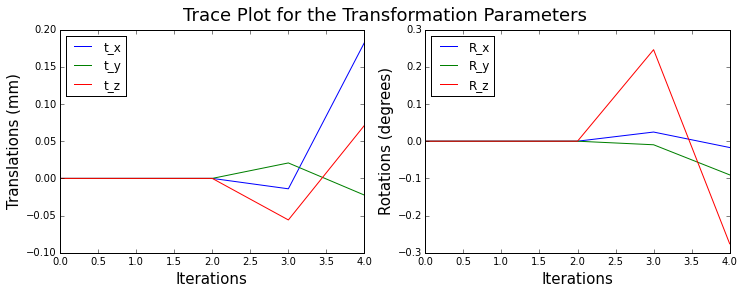

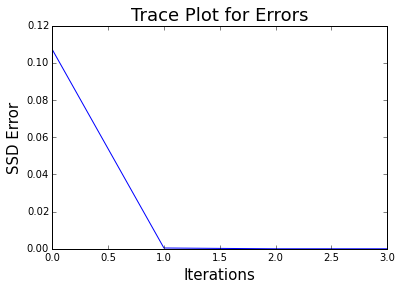

min error: 4.1972106457e-08
translations: [ 0.1826566  -0.02246456  0.0713047 ] rotations: [-0.01699446 -0.09051699 -0.27573723]


In [89]:
## No masking, recomputing all derivatives at each iteration
w = np.eye(s0*s1*s2)
P, R, error,error2 = Gauss_Newton_IRLS(testVol1, vol1_dervs, testVol2, vol2_dervs, w,
                         d=0.4, c=2, divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                         max_iter = 5, mask = False)
print 'translations:', P[:3]*8., 'rotations:',P[3:]*180/np.pi

0 MAD:  0.000452667400145


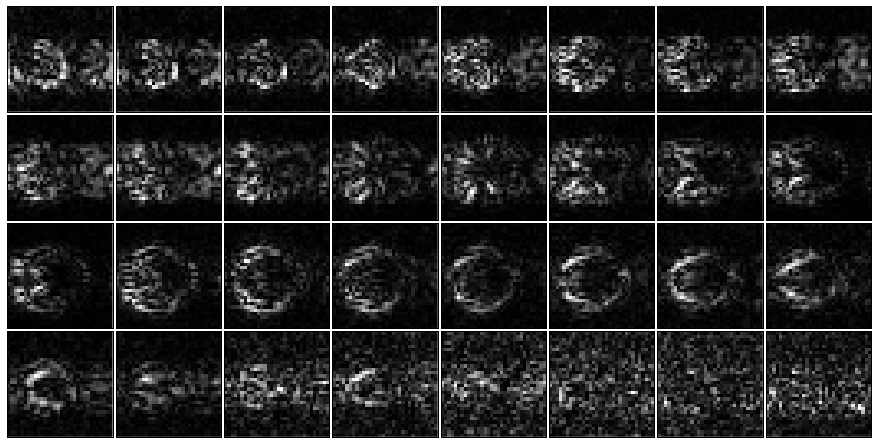

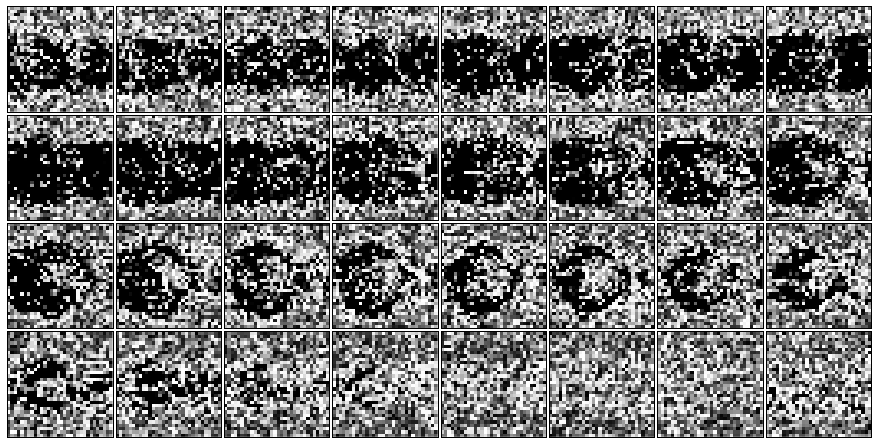

1 2 MAD:  0.000452667400145


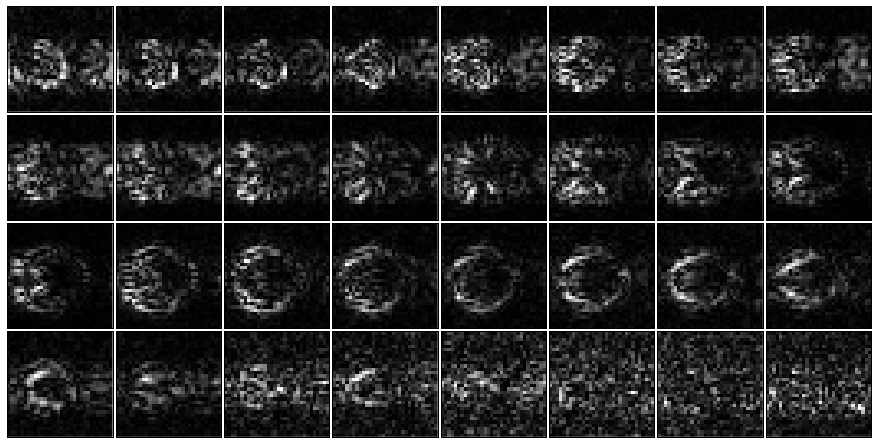

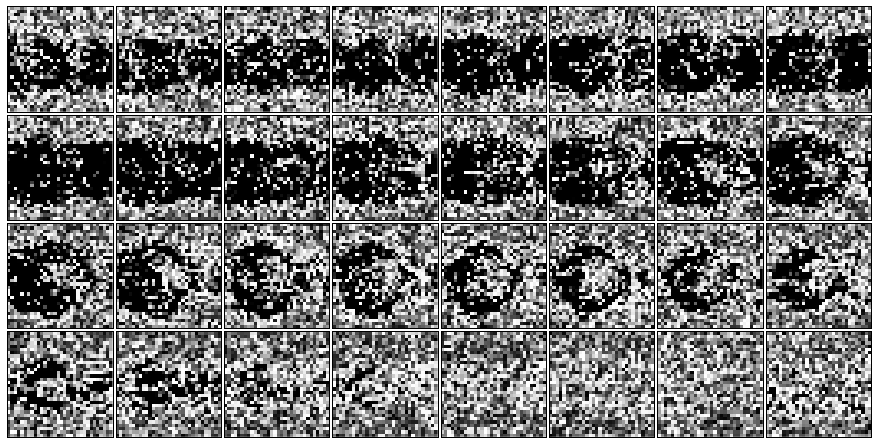

3 MAD:  0.000448060931381


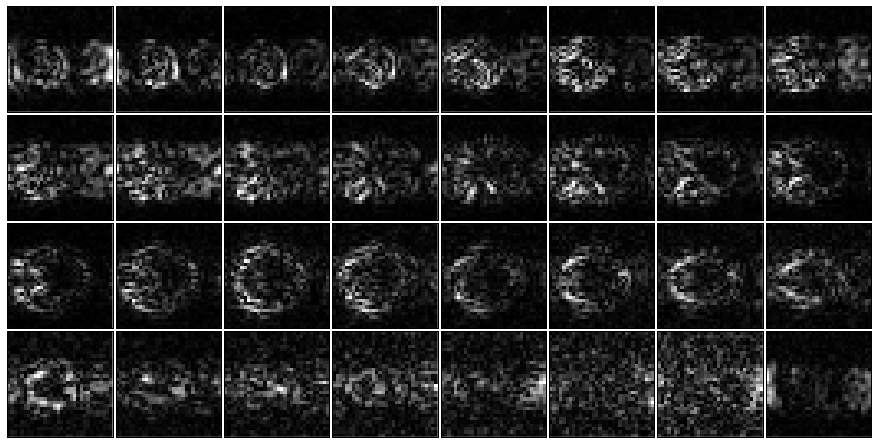

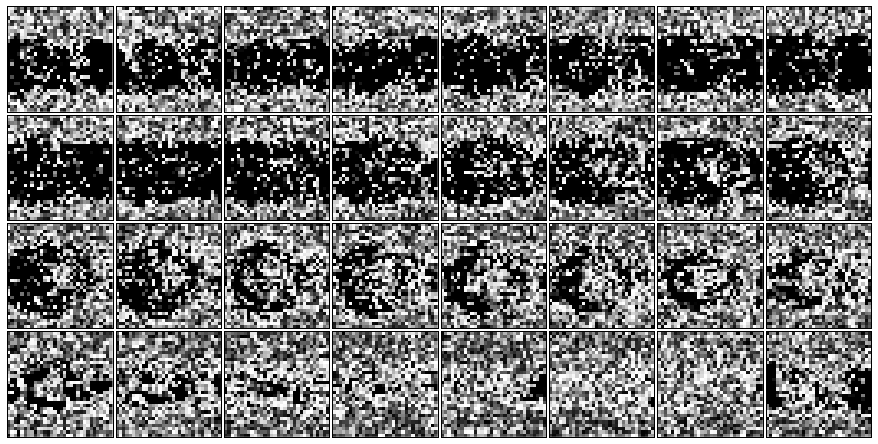

4 MAD:  0.00044067583358


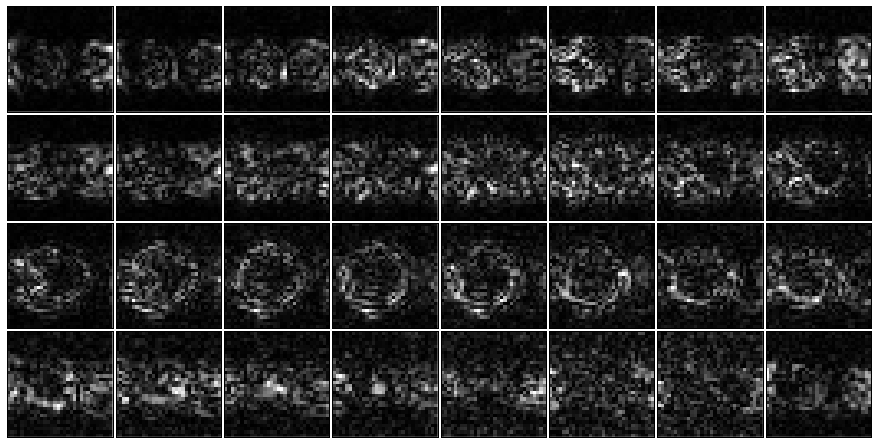

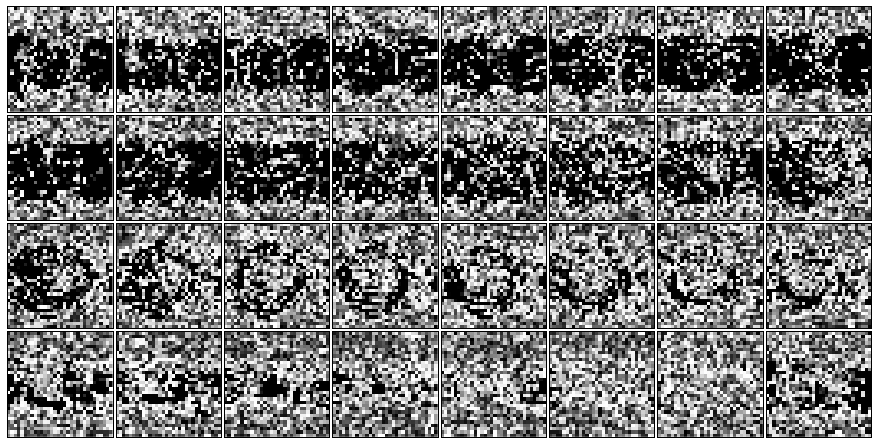

5 MAD:  0.0004310909936


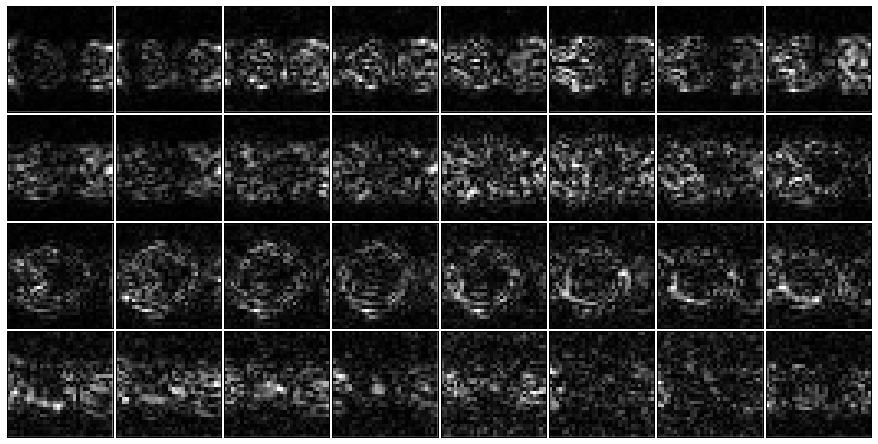

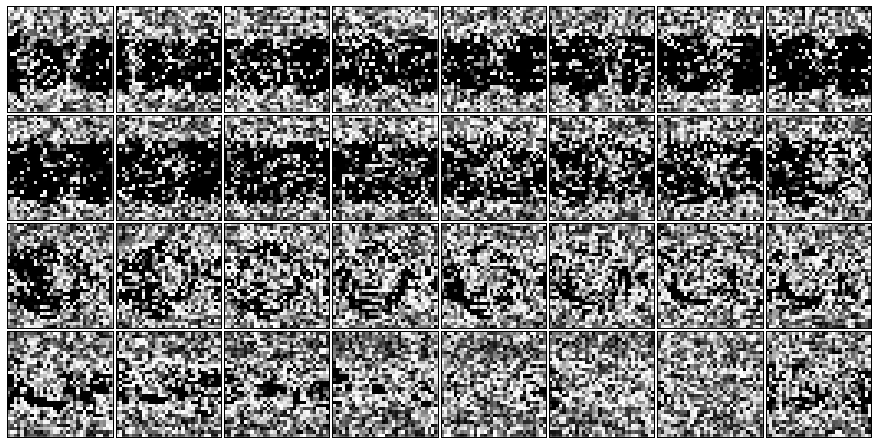

6 7 MAD:  0.0004310909936


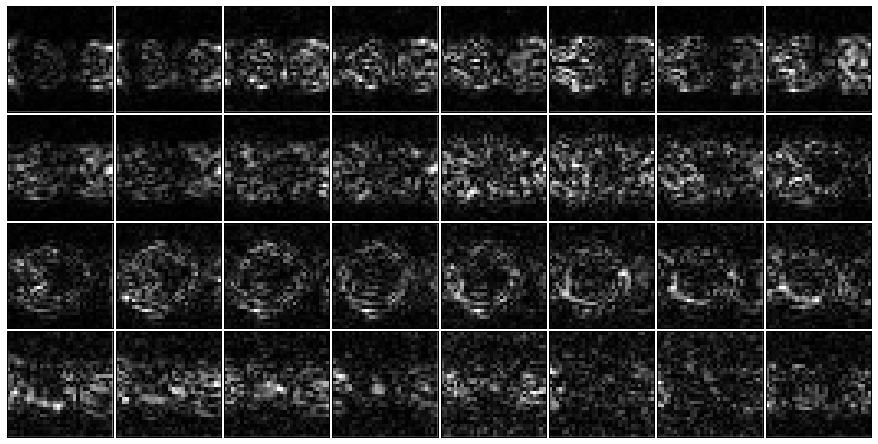

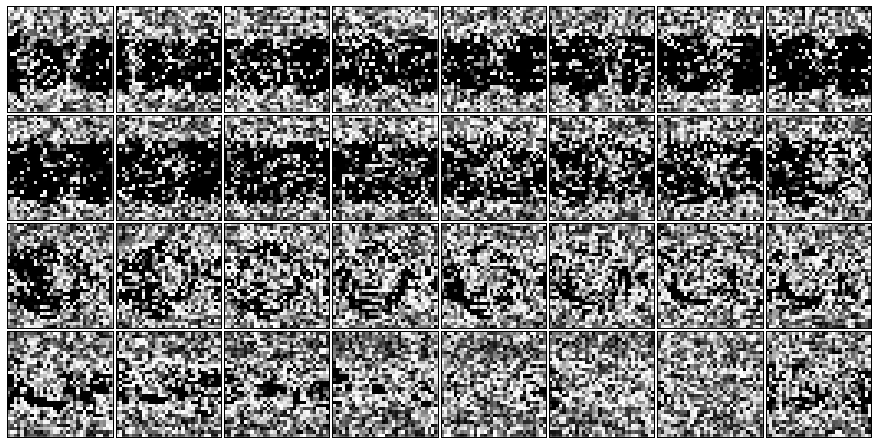

8 9 MAD:  0.0004310909936


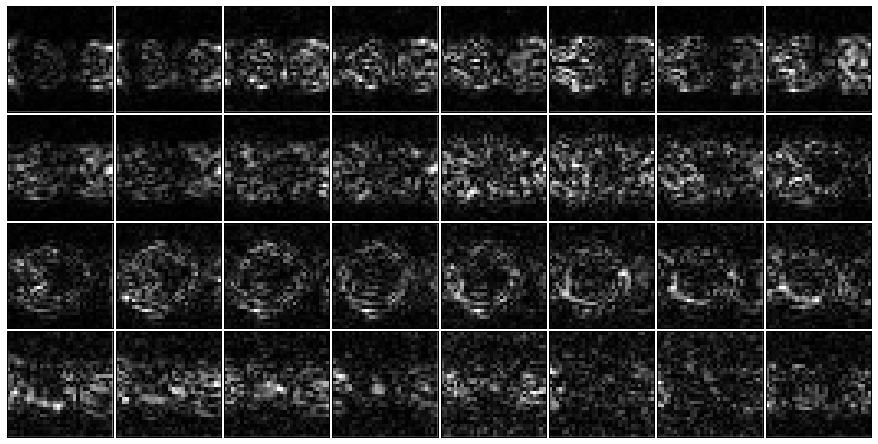

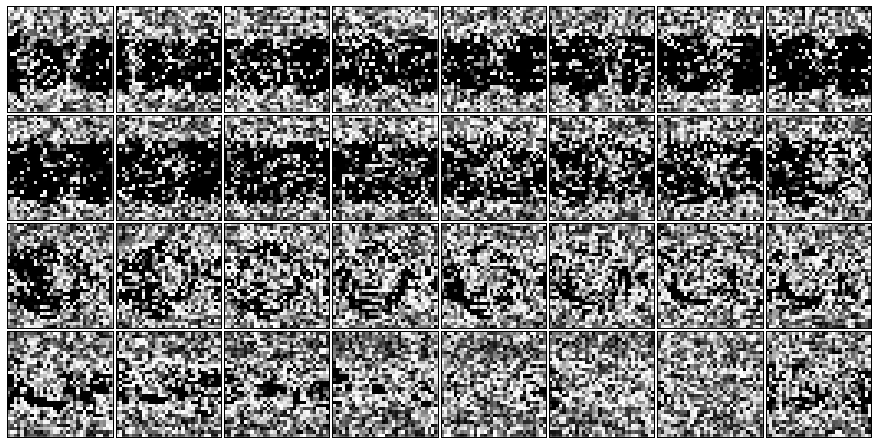

10 11 MAD:  0.0004310909936


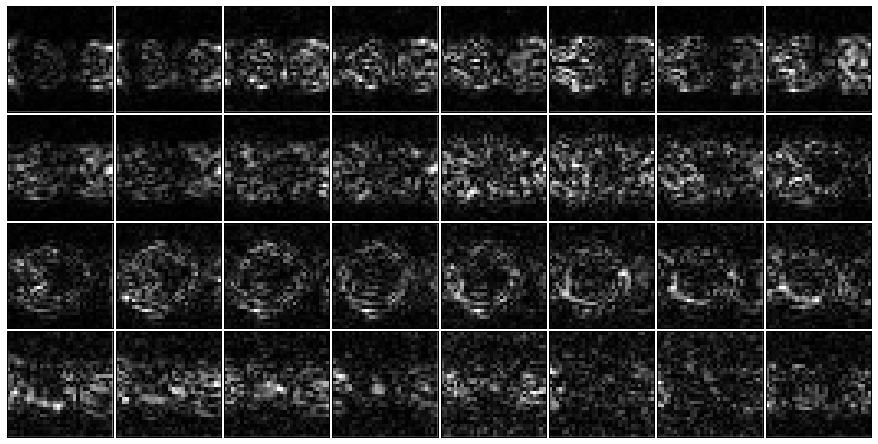

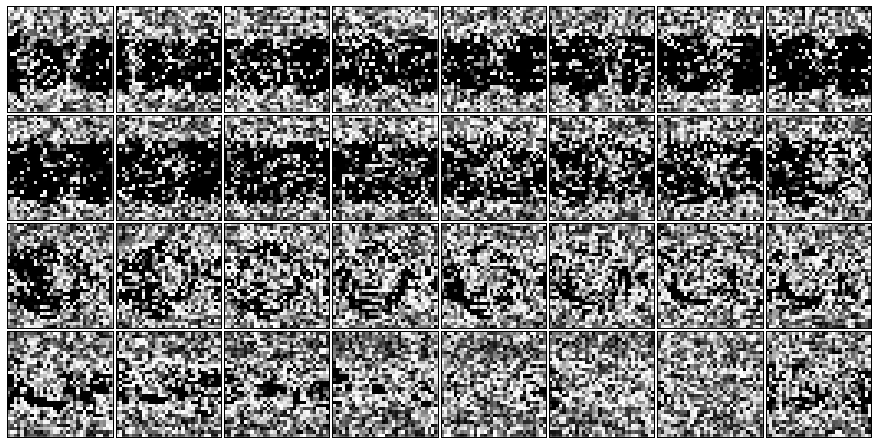

12 13 MAD:  0.0004310909936


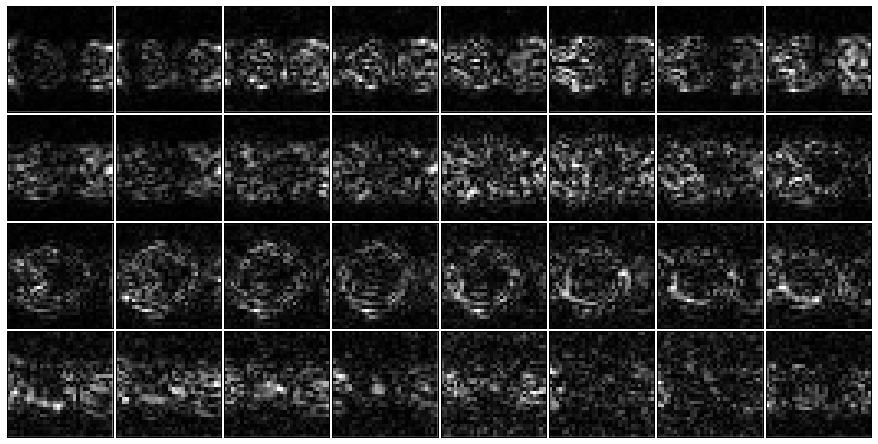

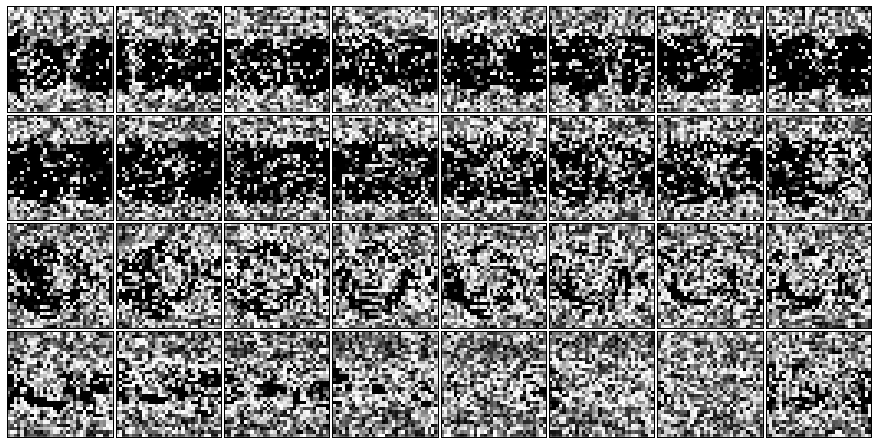

14 15 MAD:  0.0004310909936


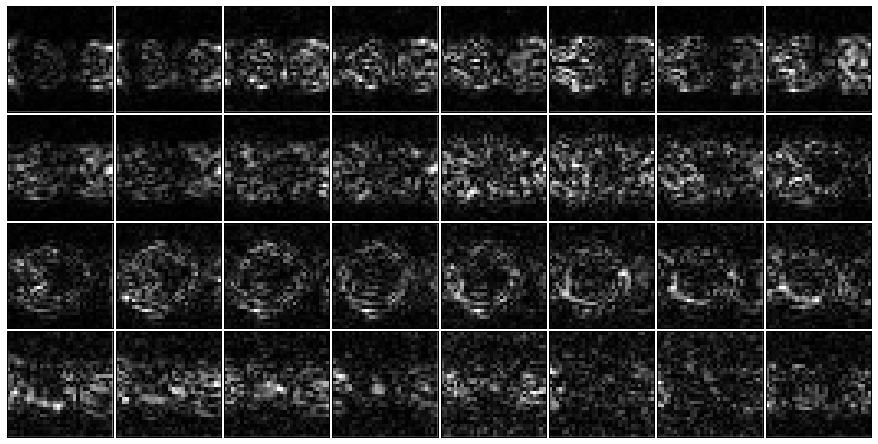

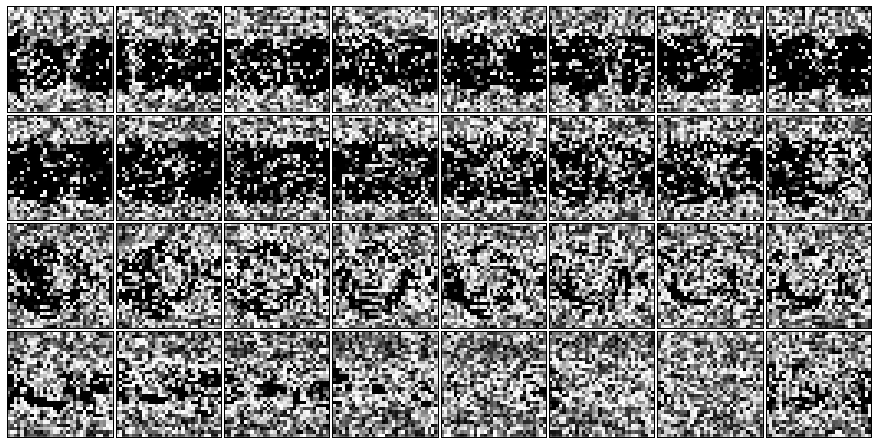

16 17 MAD:  0.0004310909936


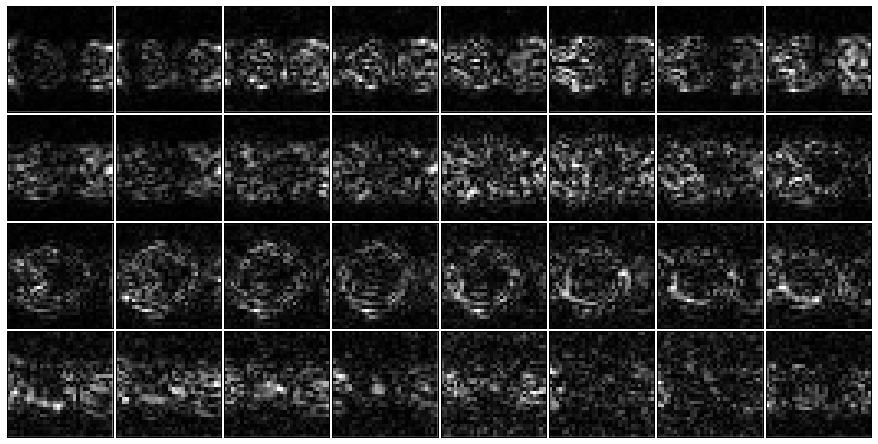

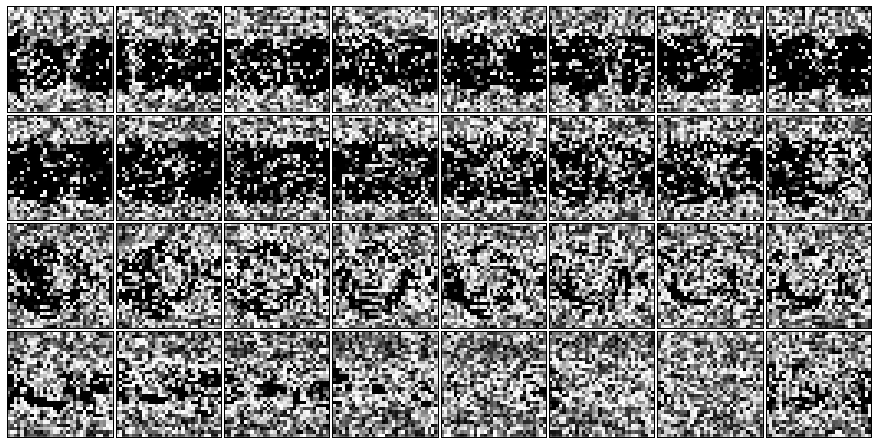

18 19 MAD:  0.0004310909936


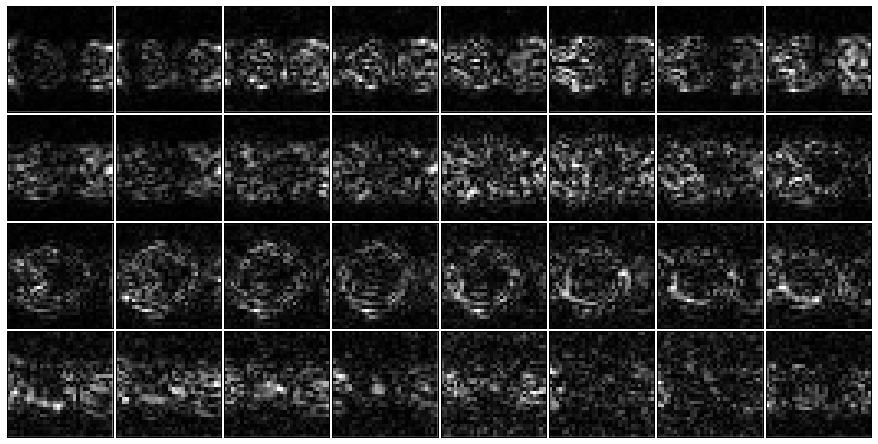

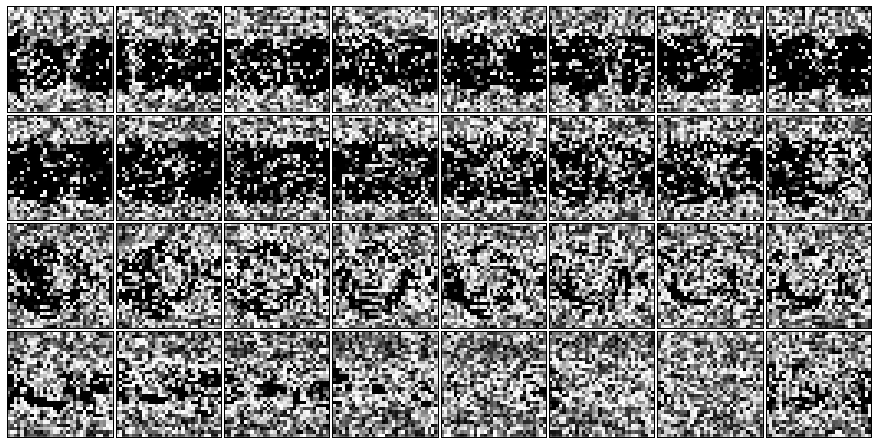

20 MAD:  0.000433723992639
Converged in 20 iterations!


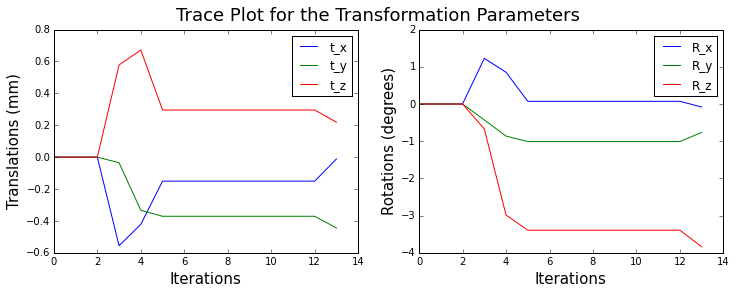

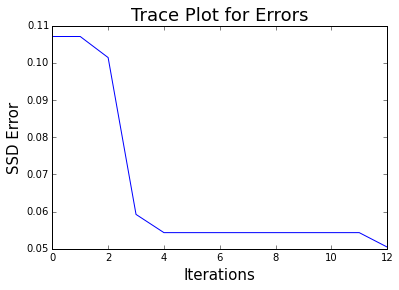

min error: 0.0504765983074
translations: [-0.01123649 -0.44427762  0.21907212] rotations: [-0.08172821 -0.7637246  -3.83930202]


In [99]:
## No masking
w = np.eye(s0*s1*s2)
P, R, error,error2 = Gauss_Newton_IRLS(testVol1, vol1_dervs, testVol2, vol2_dervs, w,
                         d=0.4, c=2, divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                         max_iter = 30, mask = False)
print 'translations:', P[:3]*8., 'rotations:',P[3:]*180/np.pi

0 MAD:  0.000433723992639


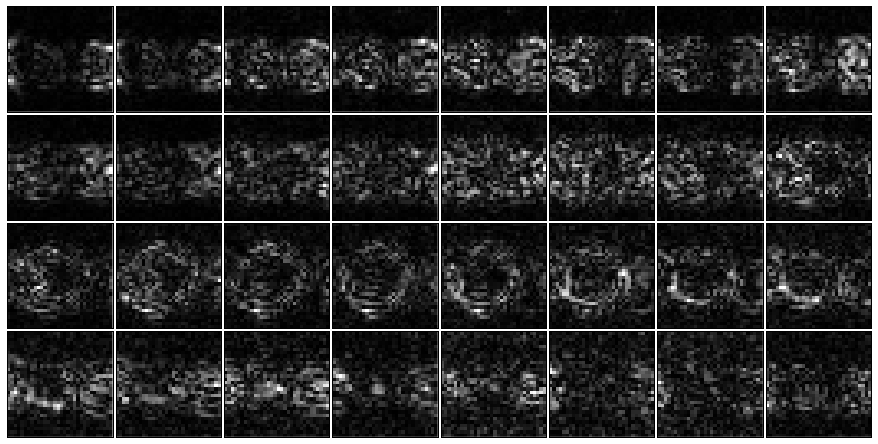

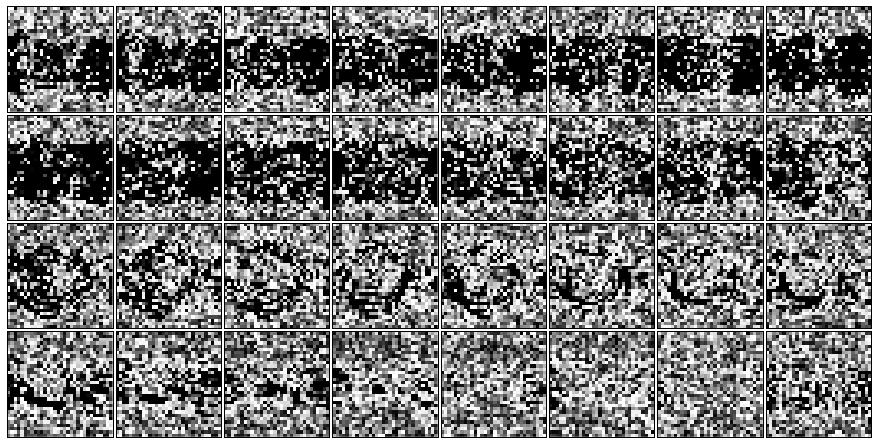

1 2 MAD:  0.000433723992639


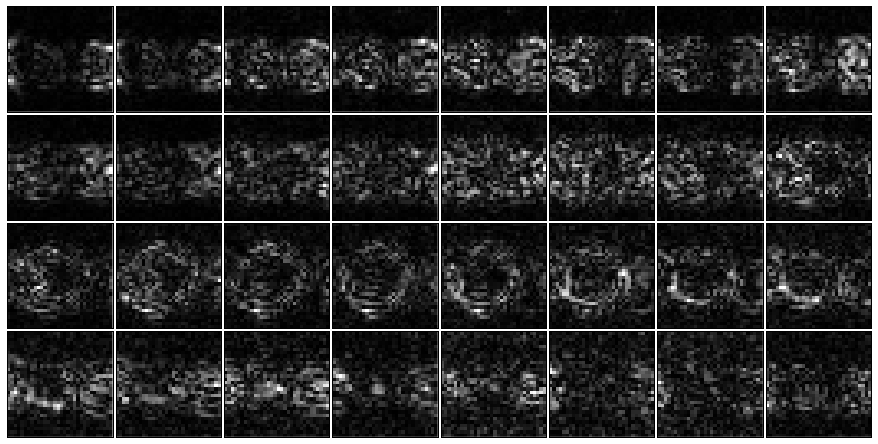

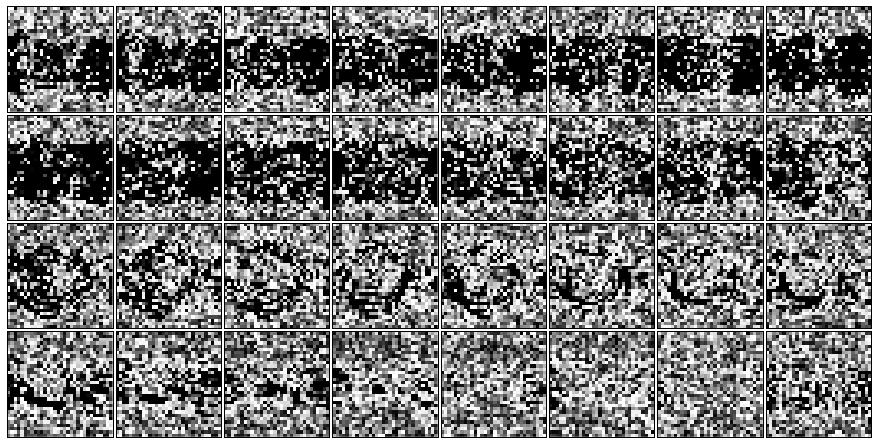

3 4 MAD:  0.000433723992639


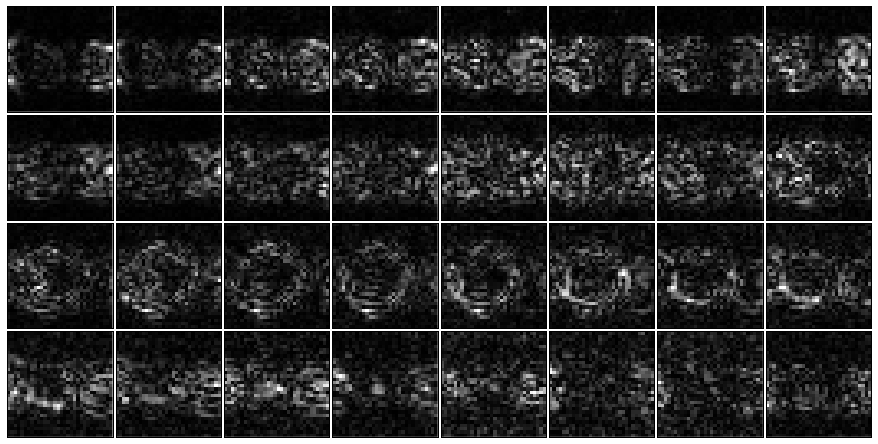

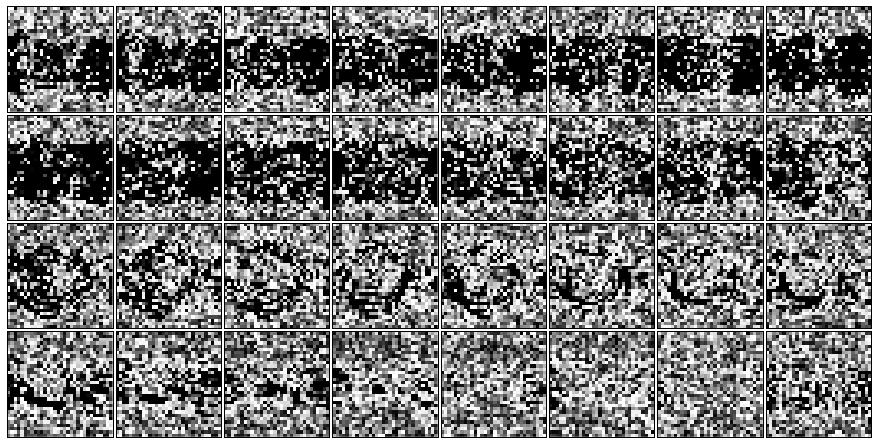

5 6 MAD:  0.000433723992639


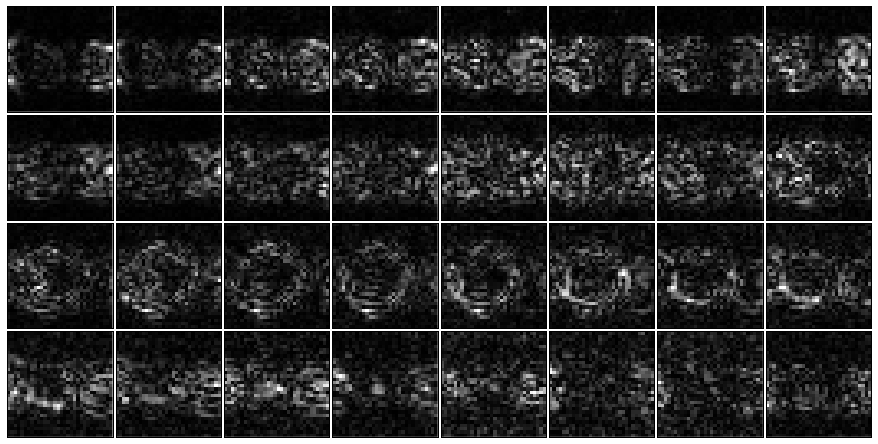

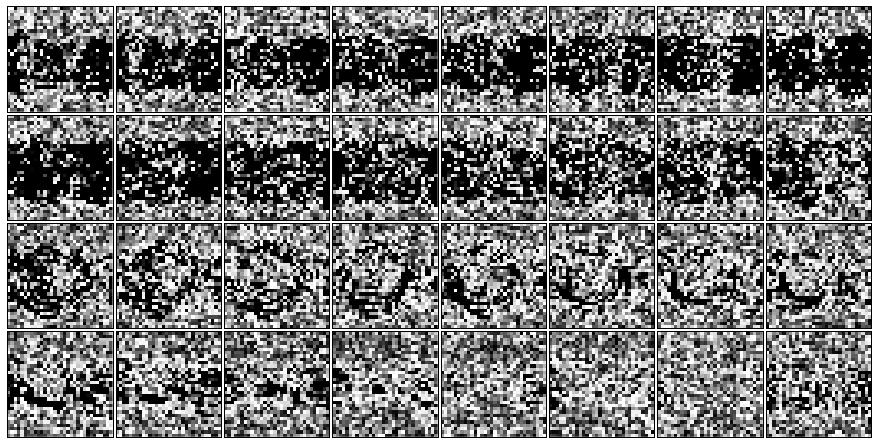

7 MAD:  0.000434653299926


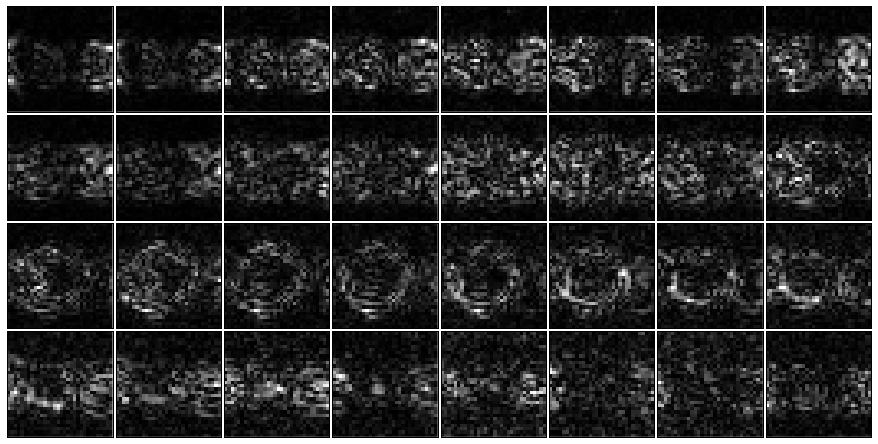

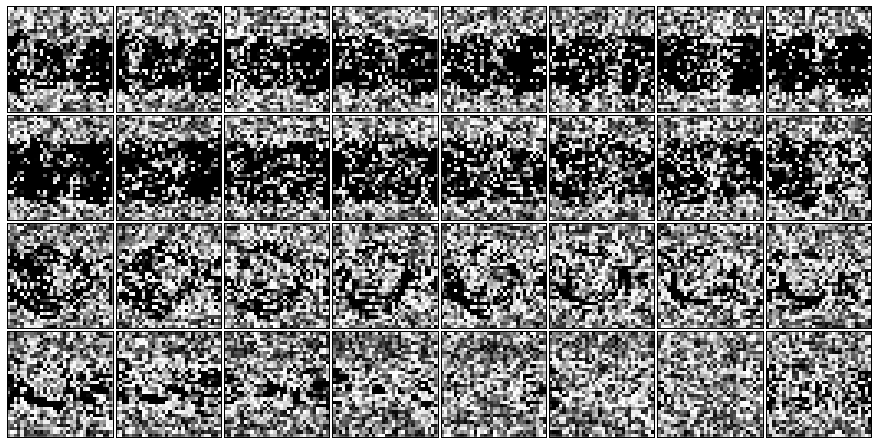

8 MAD:  0.000433788395192


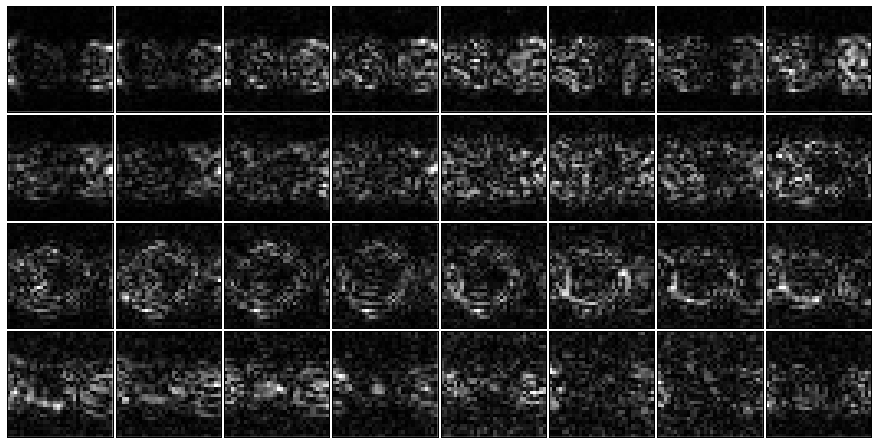

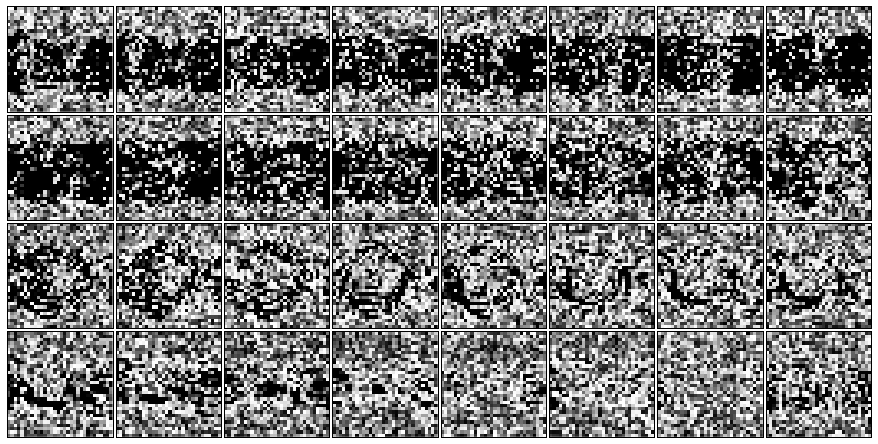

9 MAD:  0.000433355179671


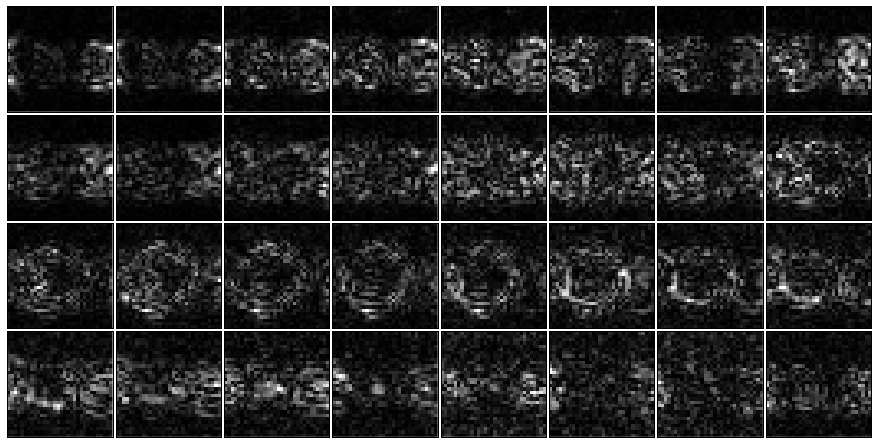

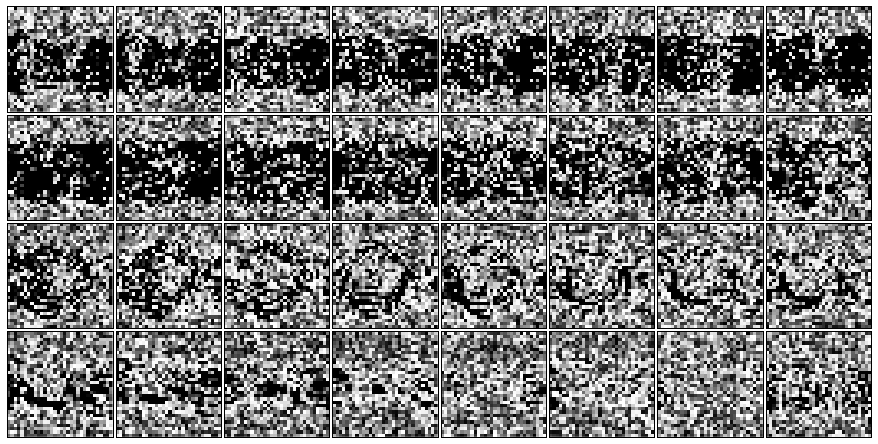

10 MAD:  0.000433322139826


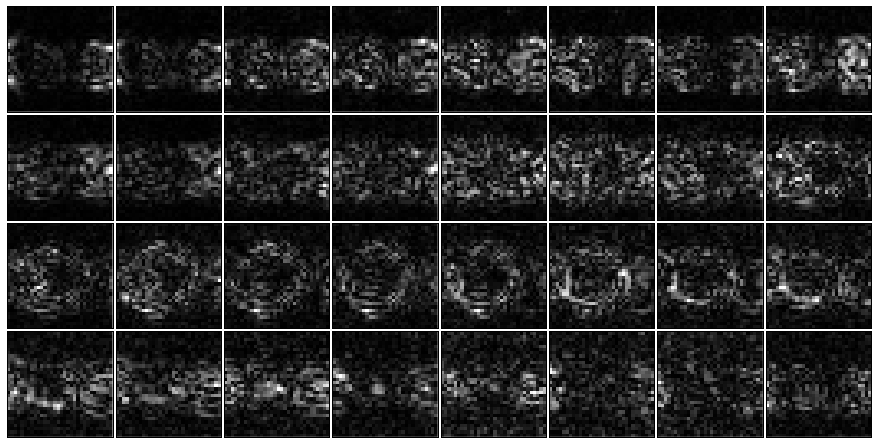

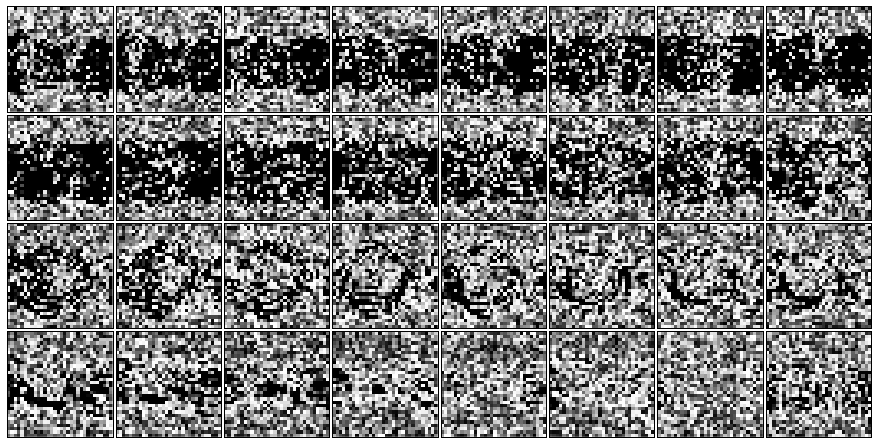

11 MAD:  0.000432321552319


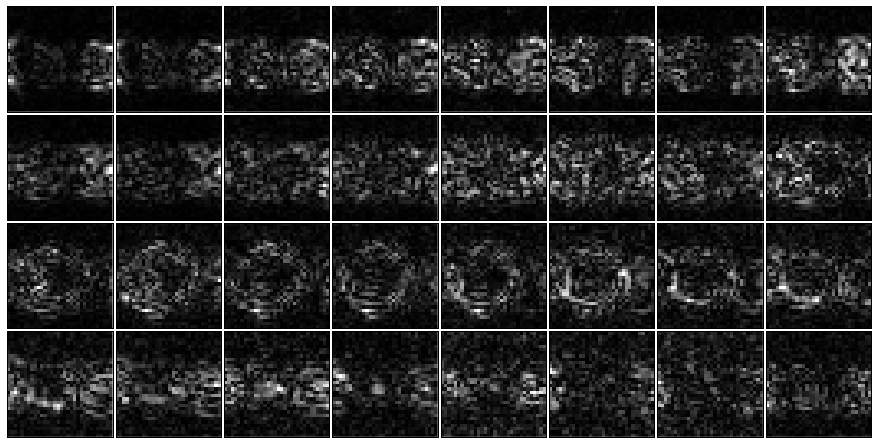

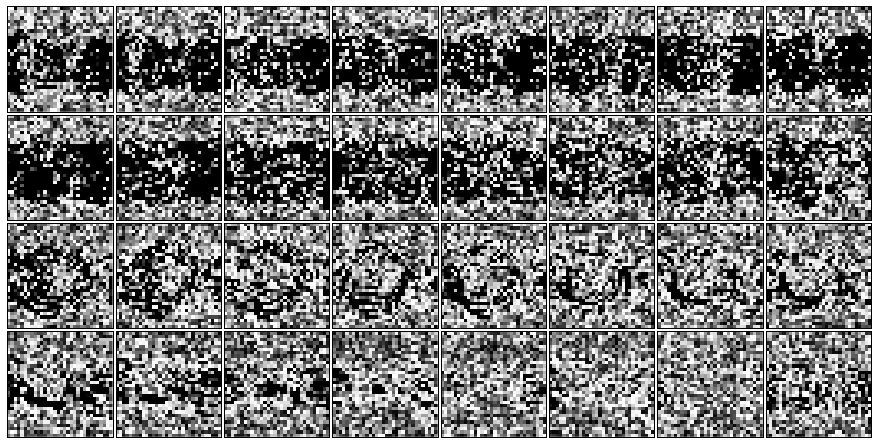

12 MAD:  0.000432437818851


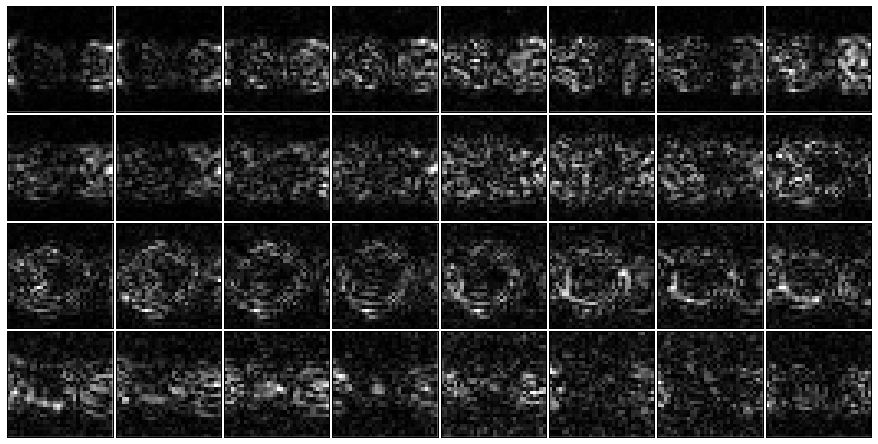

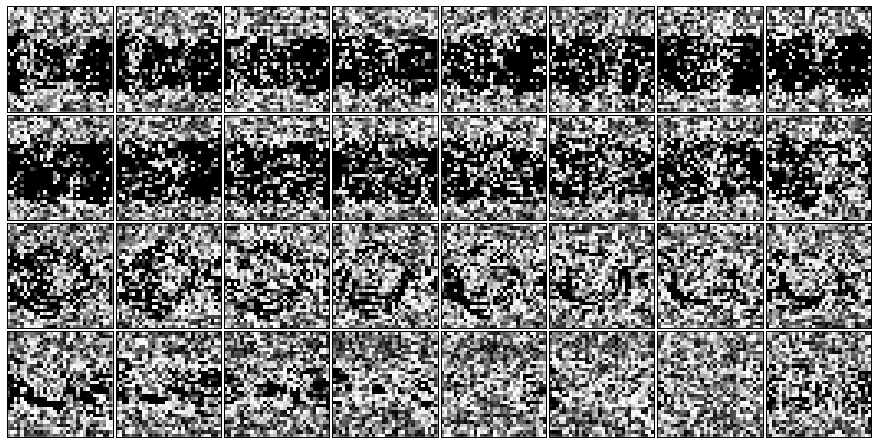

13 MAD:  0.000431475796842


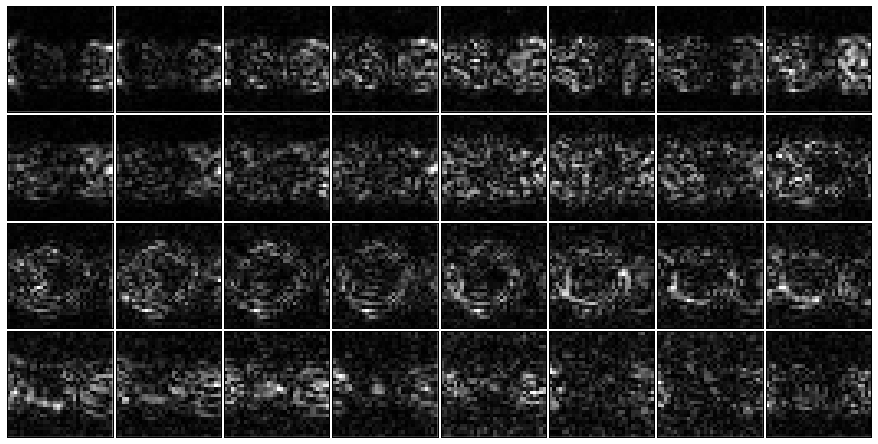

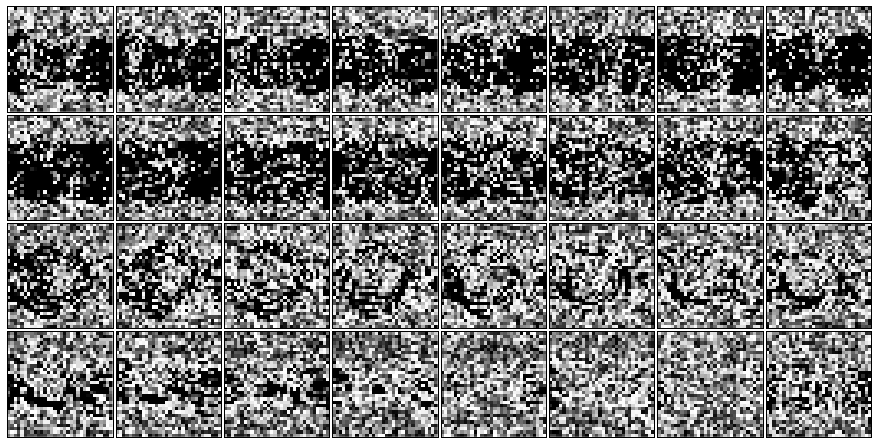

14 15 MAD:  0.000431475796842


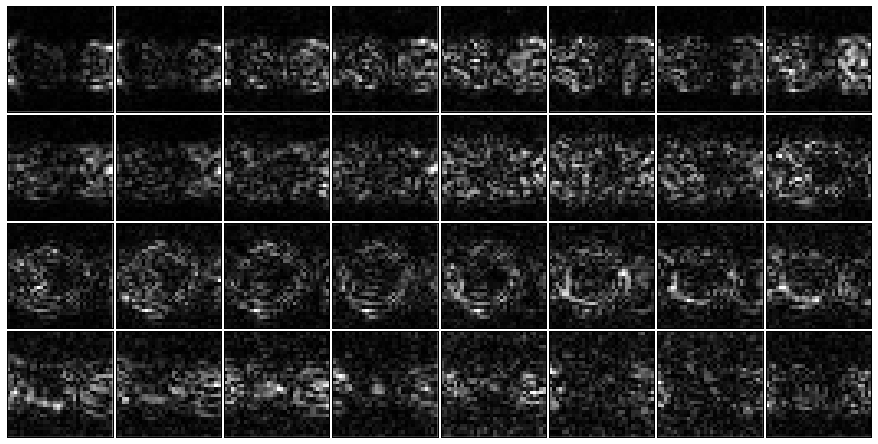

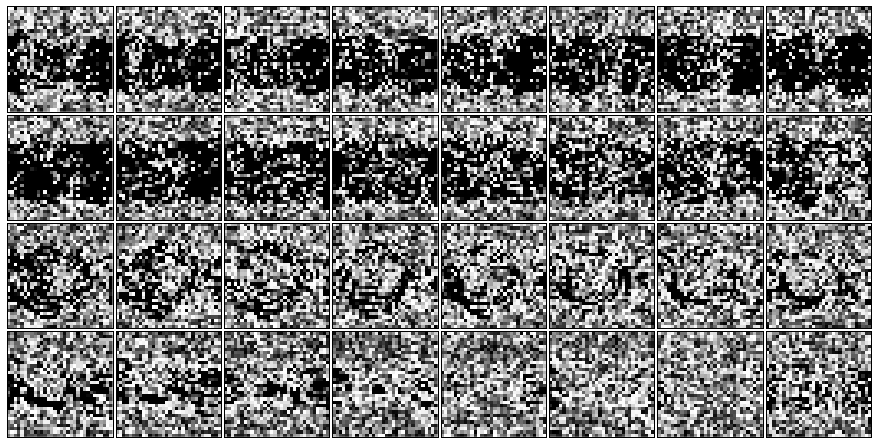

16 17 MAD:  0.000431475796842


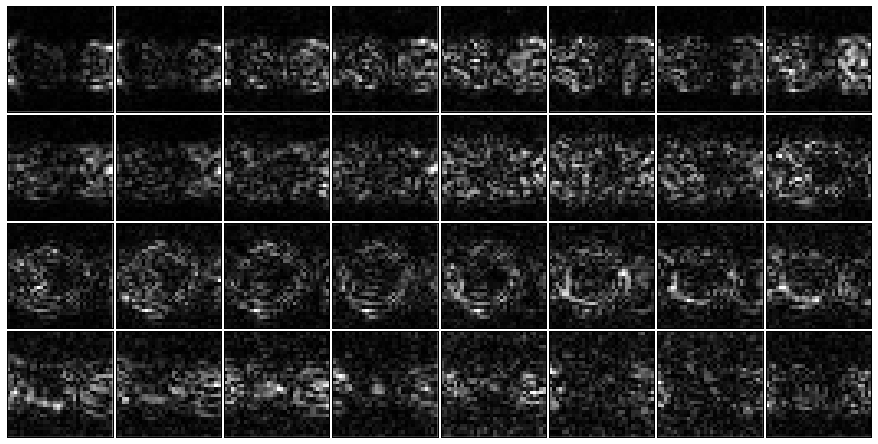

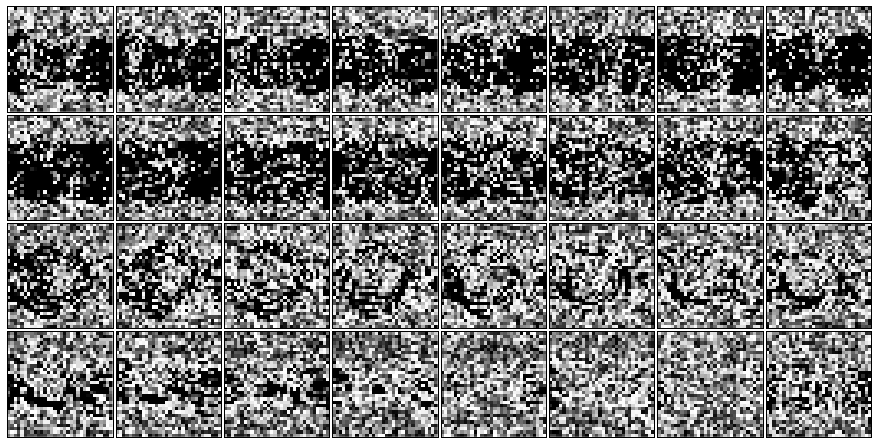

18 19 MAD:  0.000431475796842


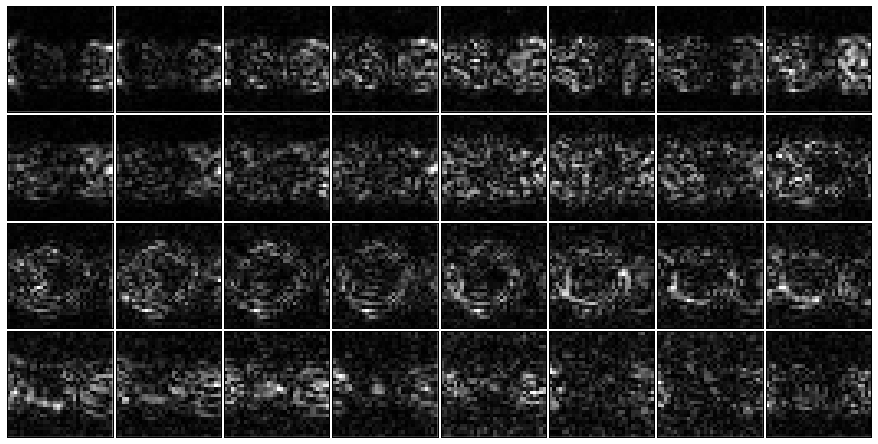

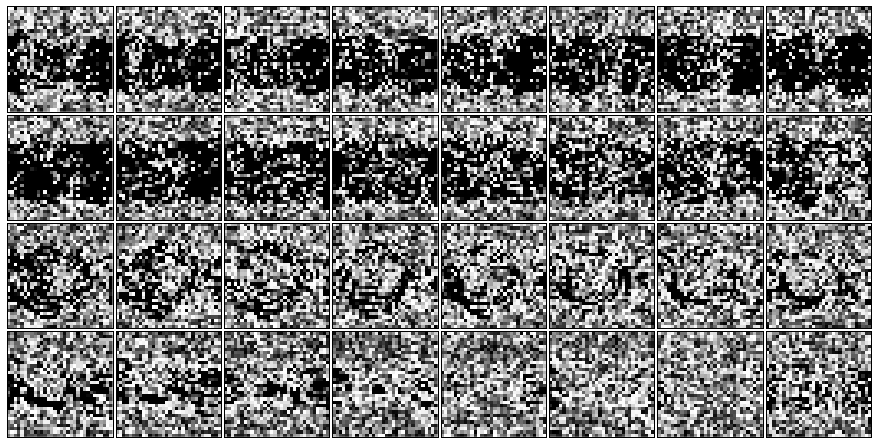

20 21 MAD:  0.000431475796842


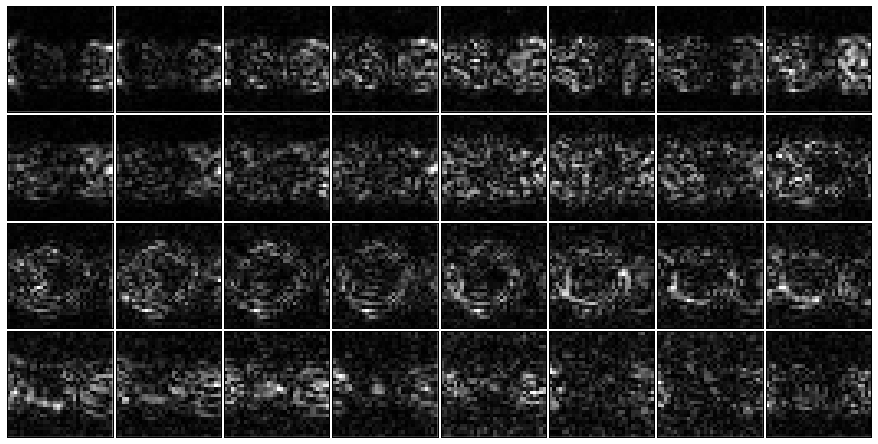

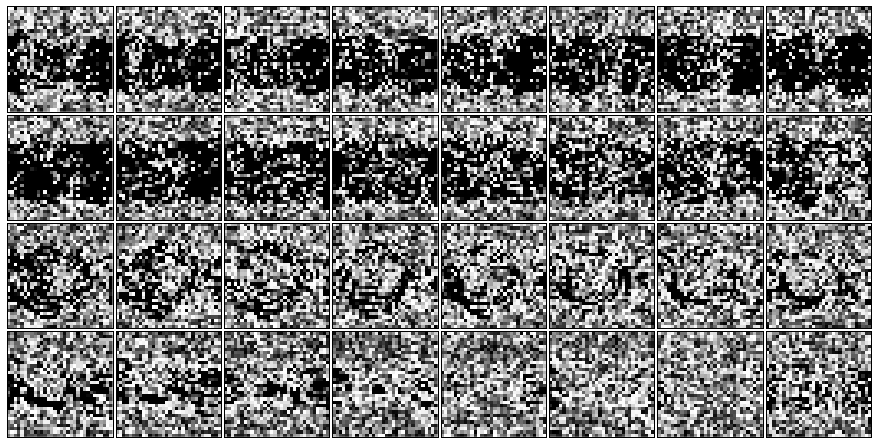

22 23 MAD:  0.000431475796842
Converged in 23 iterations!


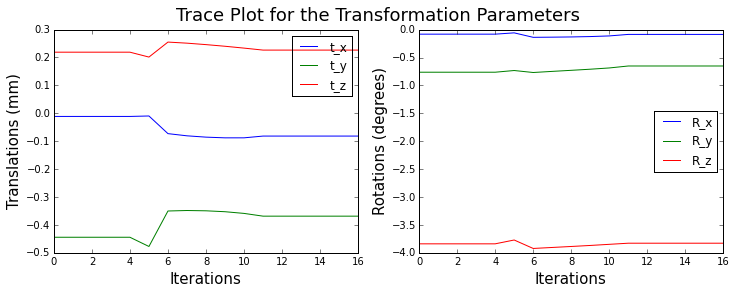

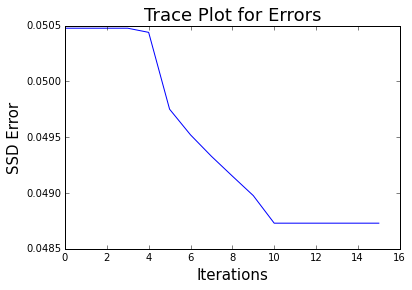

min error: 0.0487296126756
translations: [-0.08161018 -0.36865529  0.22653669] rotations: [-0.08613754 -0.65218287 -3.8280514 ]


In [100]:
## No masking
w = np.eye(s0*s1*s2)
P, R, error,error2 = Gauss_Newton_IRLS(testVol1, vol1_dervs, testVol2, vol2_dervs, w,
                         d=0.4, c=2, divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                         P_initial = P, max_iter = 30, mask = False)
print 'translations:', P[:3]*8., 'rotations:',P[3:]*180/np.pi

### Get two test volumes with 5.0 degree rotation along x and no translations

### Help C++

In [7]:
res = '8'
rad = res_to_rad(res)
rot_ax = 'z'


testVol1 = fourier_filter(oct13_dict_8[rot_ax][axes_dict[rot_ax]][ranges[1]][(0.0, 0)],rad)
testVol2 = fourier_filter(oct13_dict_8[rot_ax][axes_dict[rot_ax]][ranges[1]][(5.0, 0)],rad)

In [8]:
testVol1.tofile("testVol1.dat", sep='\n', format = "%e")
testVol1.tofile("testVol2.dat", sep='\n', format = "%e")

In [147]:
from rotation_3d import trilinear_interp,get_target_Y_1d,tricubic_interp,tricubic_interp_1d,X_inv,rotate_coords_3d

In [59]:
trilinear_interp(testVol1,-0.5,-1.5,2.5)
tricubic_interp_1d(testVol2.shape,vol2_dervs,0.5,1.5,2.5)

0.0011886630390472177

In [61]:
get_target_Y_1d(1,2,3)

array([[   1.,    1.,    1.,    1.,    2.,    2.,    2.,    2.,    4.,
           4.,    4.,    4.,    8.,    8.,    8.,    8.,    3.,    3.,
           3.,    3.,    6.,    6.,    6.,    6.,   12.,   12.,   12.,
          12.,   24.,   24.,   24.,   24.,    9.,    9.,    9.,    9.,
          18.,   18.,   18.,   18.,   36.,   36.,   36.,   36.,   72.,
          72.,   72.,   72.,   27.,   27.,   27.,   27.,   54.,   54.,
          54.,   54.,  108.,  108.,  108.,  108.,  216.,  216.,  216.,
         216.]])

In [148]:
x, y, z = 10,14,18
wx, wy, wz = 0,0,1
ox,oy,oz = 15.5,15.5,15.5
rotate_coords_3d(x, y, z, 15, wx, wy, wz, ox,oy,oz)

(10.575636523063906, 12.627606512502533, 18.0)

In [81]:
path = '/Users/zyzdiana/GitHub/AC297r-Volume-Registration/C++/'
file_name = 'vol2_derivs.dat'
shape  = vol2_dervs.shape
res = np.array(np.memmap(path+file_name, dtype=np.float32, mode='c', shape=shape))

In [136]:
vol1_dervs = tricubic_derivatives(testVol1)

In [63]:
# Calculate the radius for masking
res = '8'
rad = res_to_rad(res)
rot_ax = 'z'

# Get two volumes to register
testVol1 = fourier_filter(oct13_dict_8[rot_ax][axes_dict[rot_ax]][ranges[1]][(0.0, 0)],rad)
testVol2 = fourier_filter(oct13_dict_8[rot_ax][axes_dict[rot_ax]][ranges[1]][(5.0, 0)],rad)
s0,s1,s2 = testVol1.shape

testVol1_masked = sphere_mask(testVol1,rad)

vol1_dervs = get_gradient_P(testVol1)
vol2_dervs = tricubic_derivatives(testVol2)

In [81]:
%%time
t = tricubic_derivatives(testVol2)

CPU times: user 22.4 s, sys: 247 ms, total: 22.7 s
Wall time: 22.8 s


In [14]:
nonzero_mask = get_nonzero_mask(testVol1,rad)
testVol1_nonzero = testVol1_masked[nonzero_mask]

###  Initial IRLS using masked volumes

0 1 2 3 4 5 6 7 8 9 Converged in 9 iterations!


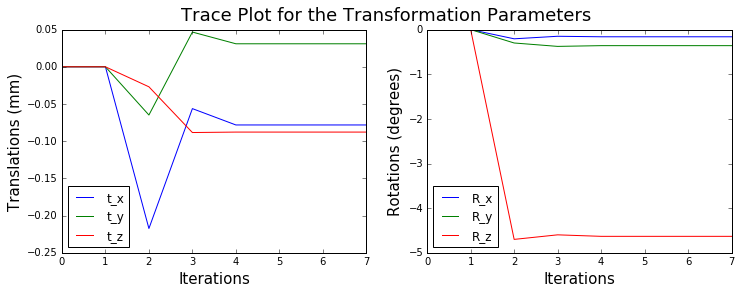

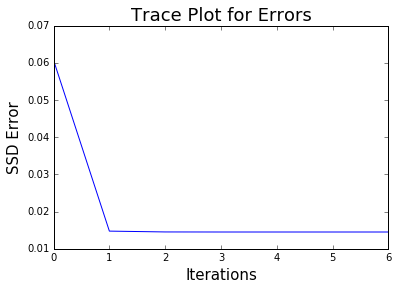

min error: 0.0145154700721
translations: [-0.07816676  0.03094133 -0.08774321] rotations: [-0.1608661  -0.35953459 -4.63127124]
CPU times: user 11.8 s, sys: 8.28 s, total: 20.1 s
Wall time: 11.9 s


In [17]:
%%time
w = np.eye(s0*s1*s2)
P, R, error = Gauss_Newton_IRLS(testVol1_masked, vol1_dervs, testVol2, vol2_dervs, w,
                         d=0.4, divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                         max_iter = 15, mask = True)
print 'translations:', P[:3]*8, 'rotations:',P[3:]*180/np.pi

In [19]:
mad_r = MAD(R)
if mad_r != 0:
    print 'normalized residual'
    R = (1./mad_r)*R

c =  1
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

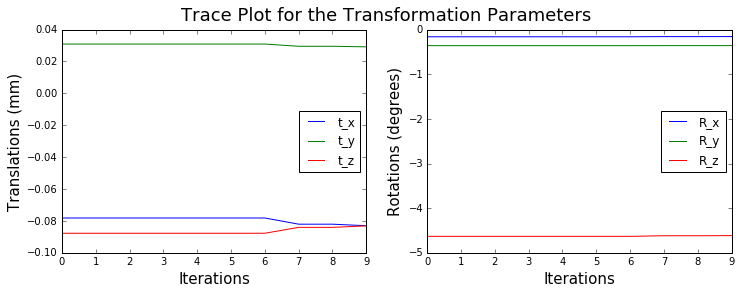

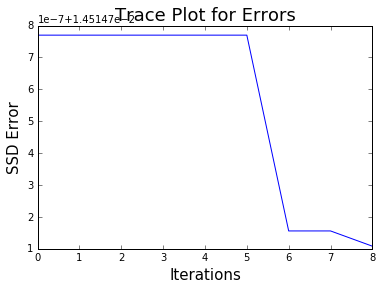

 min error: 0.0145148082031
translations: [-0.0830224   0.0291874  -0.08311713] rotations: [-0.1561904  -0.35835871 -4.61490981]
CPU times: user 12.4 s, sys: 8.39 s, total: 20.8 s
Wall time: 12.2 s


In [21]:
%%time
c = 1
print 'c = ', c
w = Tukeys_Biweight(R,c)
W = np.diag(w)
P_new, R_new, err = Gauss_Newton_IRLS(testVol1_masked, vol1_dervs, testVol2, vol2_dervs, W,
                         divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                         P_initial = P, max_iter = 15, mask = True)
print 'translations:', P_new[:3]*8, 'rotations:',P_new[3:]*180/np.pi

c =  0.0005
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

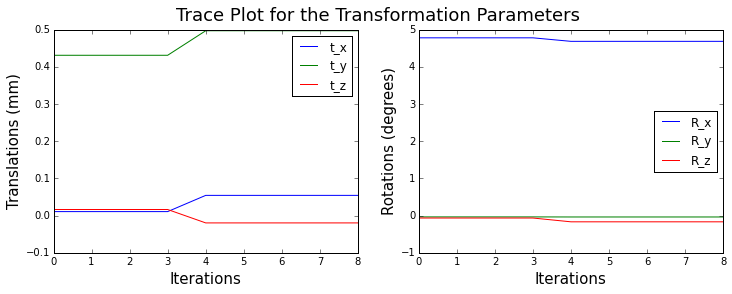

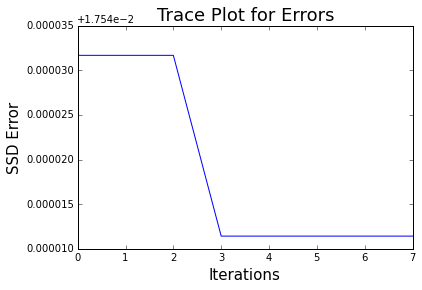

 min error: 0.0175514221777
translations: [ 0.05437178  0.49693075 -0.01964593] rotations: [ 4.68430358 -0.03696083 -0.1671195 ]
c =  0.001
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

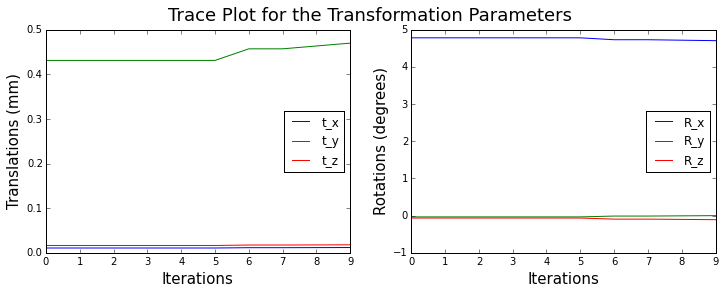

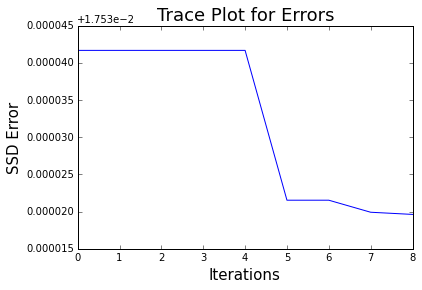

 min error: 0.0175496217072
translations: [ 0.01180906  0.46970951  0.01791285] rotations: [  4.70261577e+00  -1.04995152e-03  -1.09800047e-01]
c =  0.0015
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

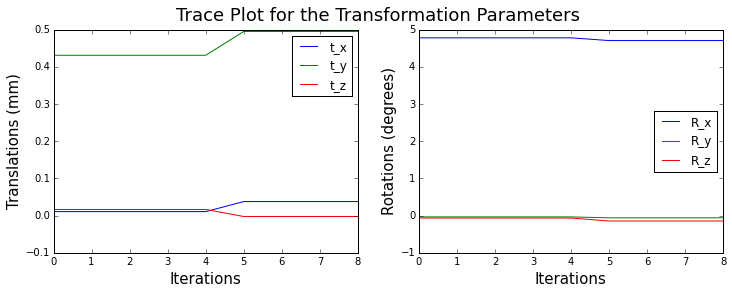

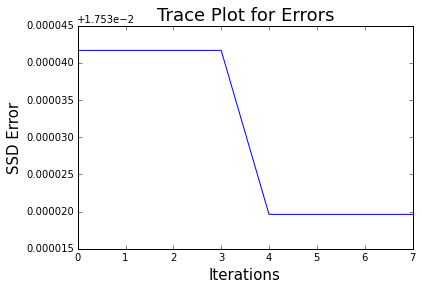

 min error: 0.0175496284419
translations: [ 0.03776112  0.49495863 -0.00251271] rotations: [ 4.70536298 -0.05991332 -0.14547983]
c =  0.002
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

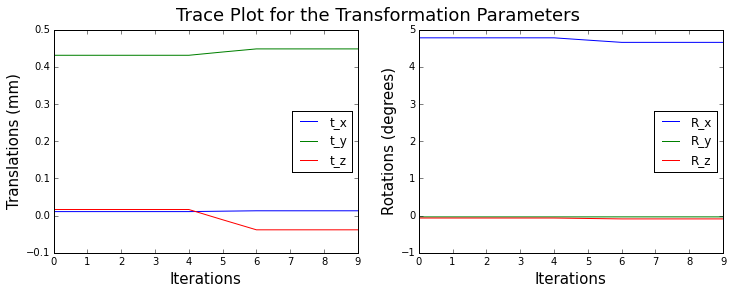

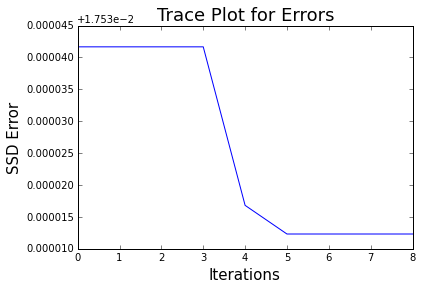

 min error: 0.0175423202241
translations: [ 0.01293928  0.44811499 -0.03821613] rotations: [ 4.6567452  -0.03414434 -0.08874981]
c =  0.0025
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

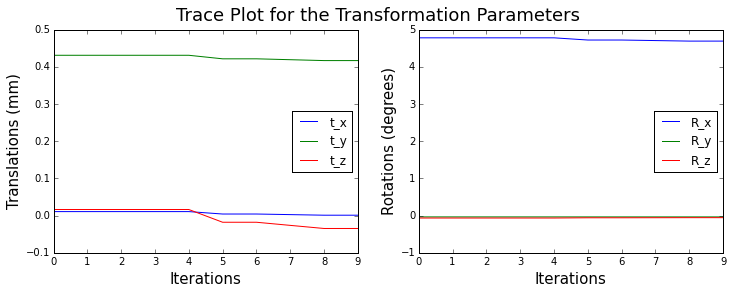

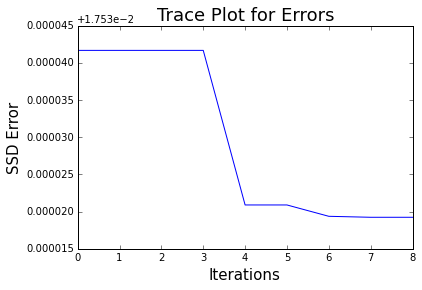

 min error: 0.0175492361932
translations: [ 0.00106719  0.4167193  -0.03462587] rotations: [ 4.69084284 -0.03498481 -0.05552917]
c =  0.003
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

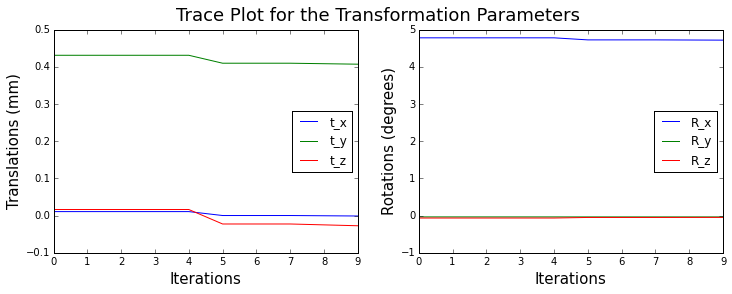

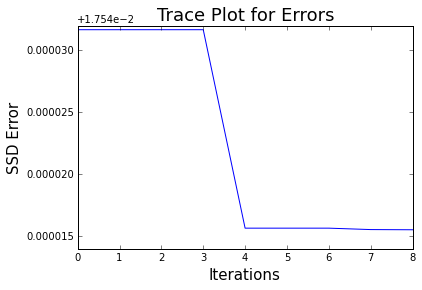

 min error: 0.017555535357
translations: [-0.00107863  0.40701851 -0.0273104 ] rotations: [ 4.71673155 -0.03551807 -0.04794609]
c =  0.0035
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

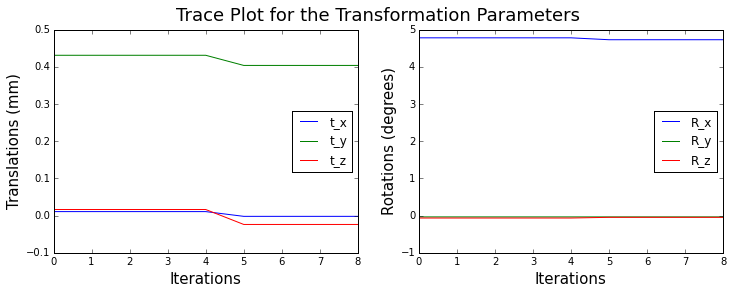

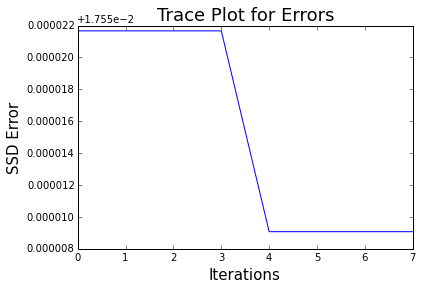

 min error: 0.0175590736789
translations: [-0.00201245  0.40369192 -0.02381929] rotations: [ 4.72773953 -0.03506838 -0.04639376]
c =  0.004
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

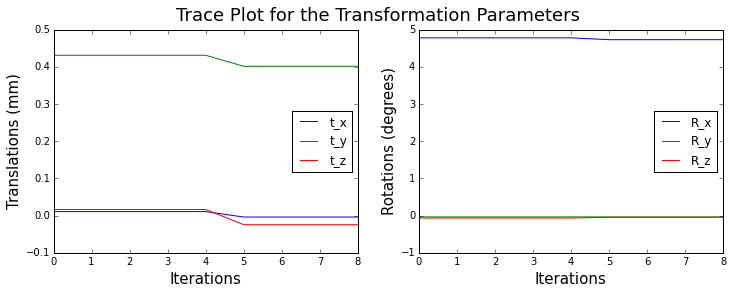

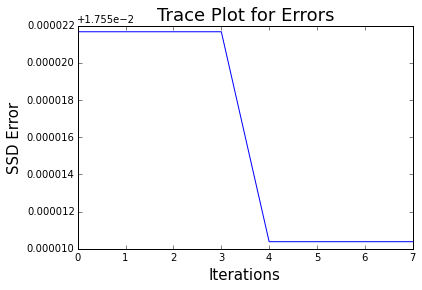

 min error: 0.0175603818041
translations: [-0.00385424  0.40140489 -0.02443435] rotations: [ 4.72910279 -0.03568331 -0.04503644]
c =  0.0045
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

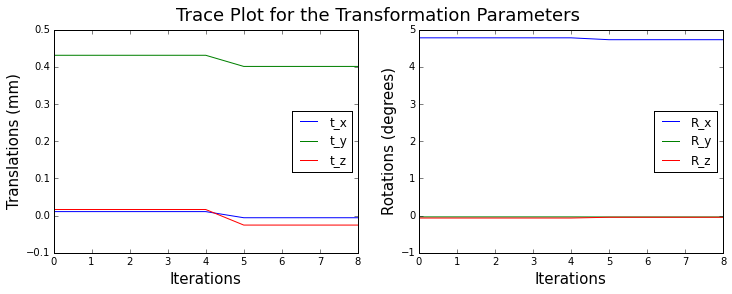

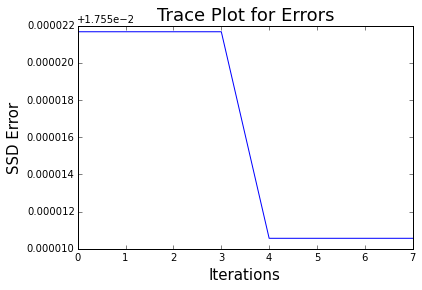

 min error: 0.0175605647668
translations: [-0.00573379  0.40100427 -0.02546454] rotations: [ 4.72852121 -0.03722904 -0.0444684 ]
c =  0.005
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

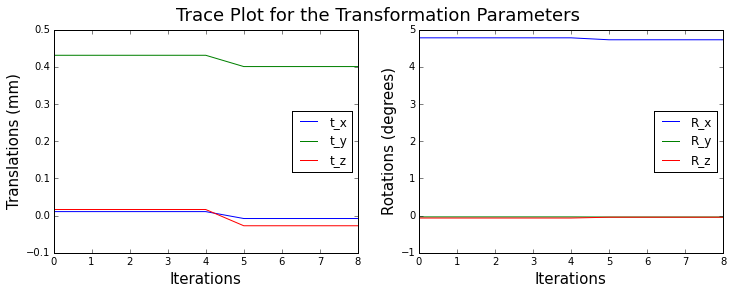

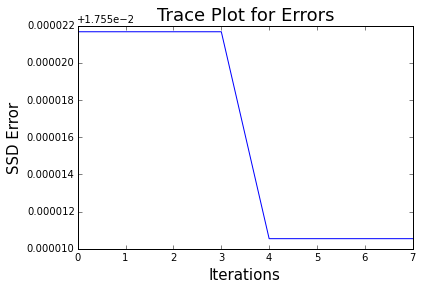

 min error: 0.0175605443118
translations: [-0.00785151  0.40063692 -0.02729571] rotations: [ 4.72647057 -0.03857692 -0.04339157]
c =  0.0055
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

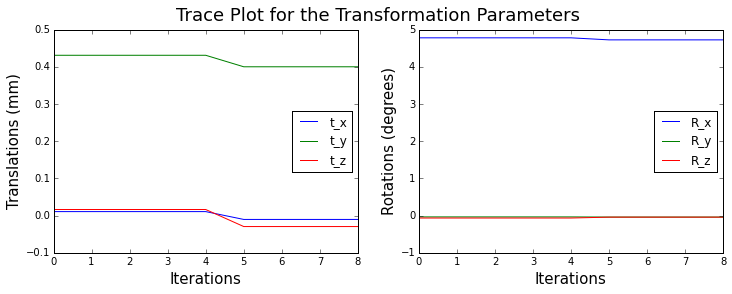

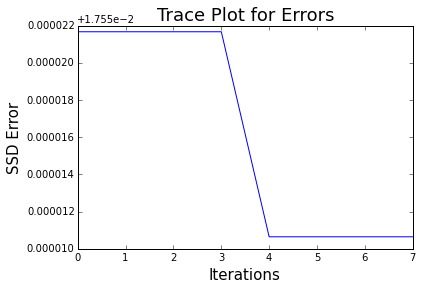

 min error: 0.0175606452953
translations: [-0.01031563  0.40005009 -0.02943121] rotations: [ 4.72390944 -0.03949602 -0.04138813]
c =  0.006
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

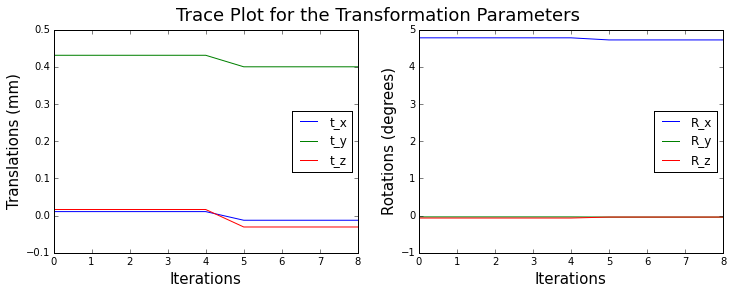

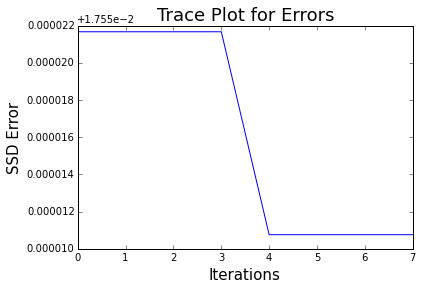

 min error: 0.0175607588098
translations: [-0.01250164  0.40001142 -0.03061353] rotations: [ 4.72247644 -0.03995101 -0.03919757]
c =  0.0065
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

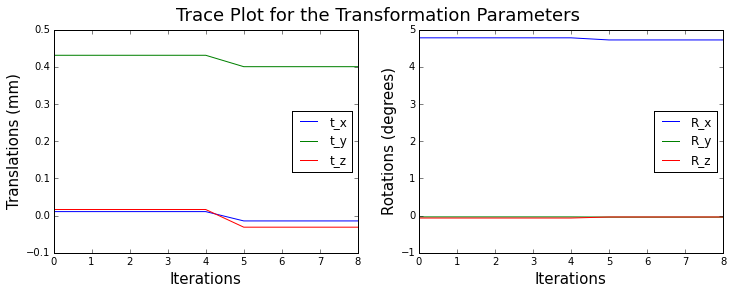

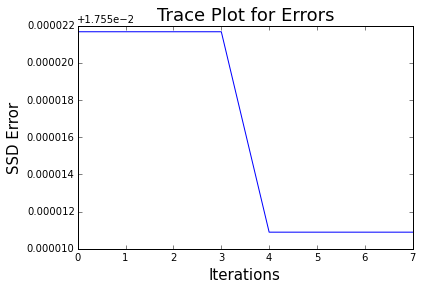

 min error: 0.0175608944117
translations: [-0.01431776  0.40032436 -0.0311309 ] rotations: [ 4.72197275 -0.04011506 -0.03717121]
c =  0.007
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

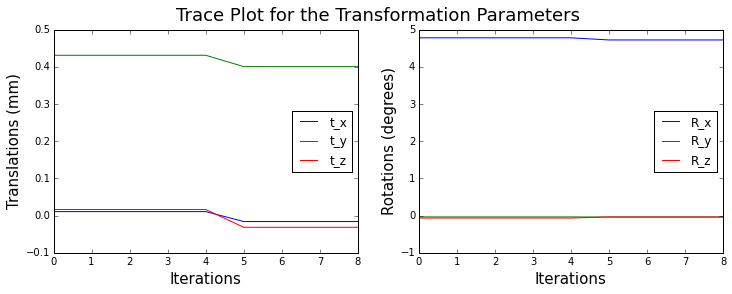

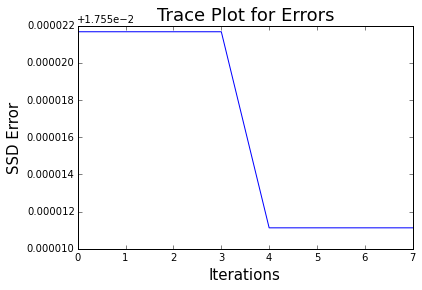

 min error: 0.0175611270652
translations: [-0.01597125  0.40050635 -0.03141434] rotations: [ 4.72183097 -0.04009659 -0.03517938]
c =  0.0075
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

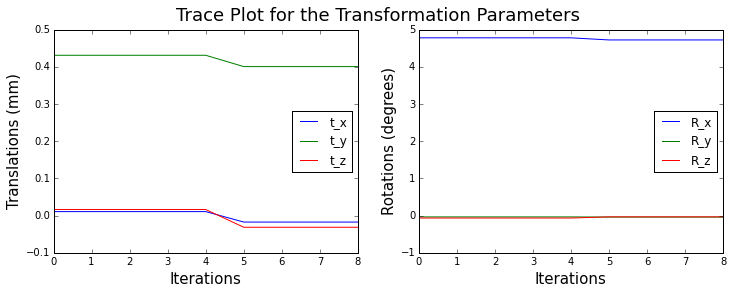

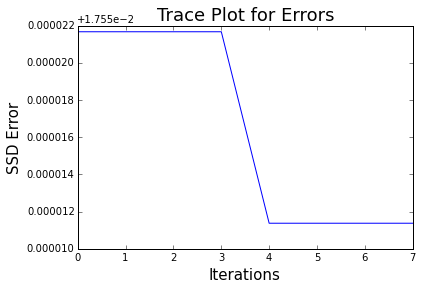

 min error: 0.0175613748417
translations: [-0.01737552  0.40057192 -0.0313374 ] rotations: [ 4.72203978 -0.03998555 -0.03351541]
c =  0.008
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

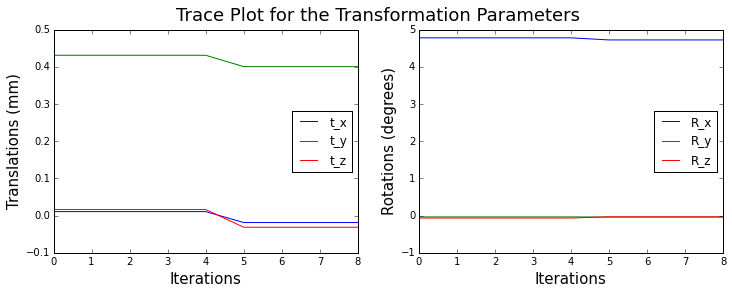

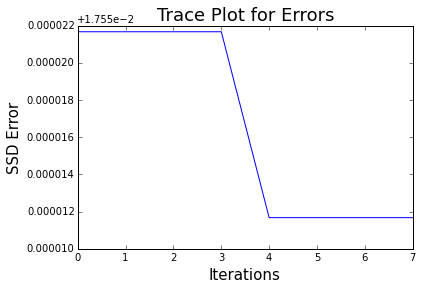

 min error: 0.0175616743064
translations: [-0.01867963  0.40044279 -0.03131649] rotations: [ 4.72221097 -0.03985939 -0.03194163]
c =  0.0085
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

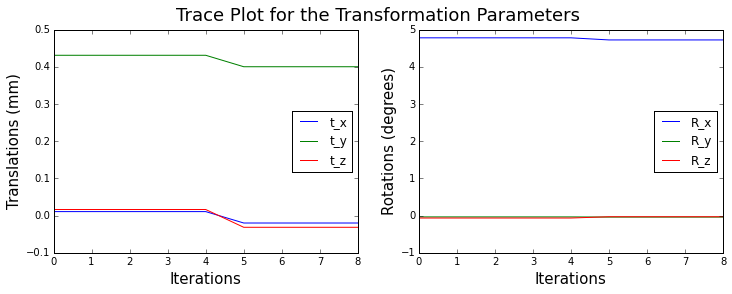

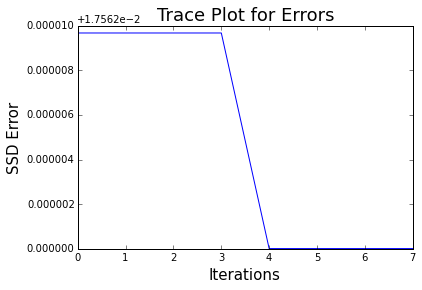

 min error: 0.01756200994
translations: [-0.01991606  0.40017568 -0.03143864] rotations: [ 4.722256   -0.03974522 -0.03042056]
c =  0.009
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

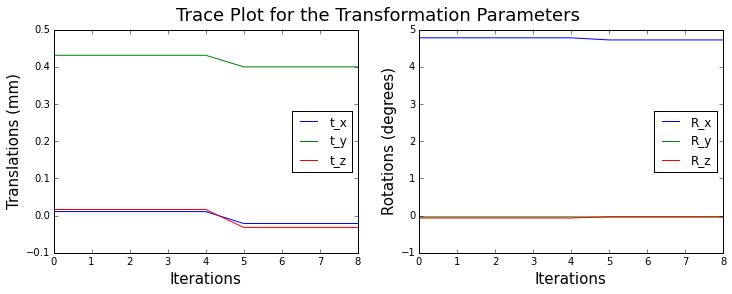

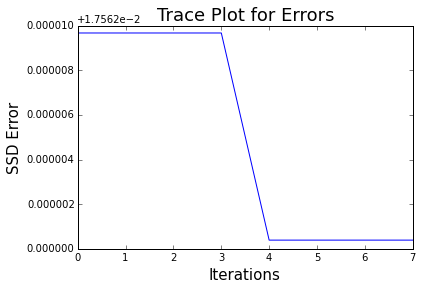

 min error: 0.017562388954
translations: [-0.02117078  0.39980807 -0.03173753] rotations: [ 4.72213623 -0.03961698 -0.02877553]
c =  0.0095
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

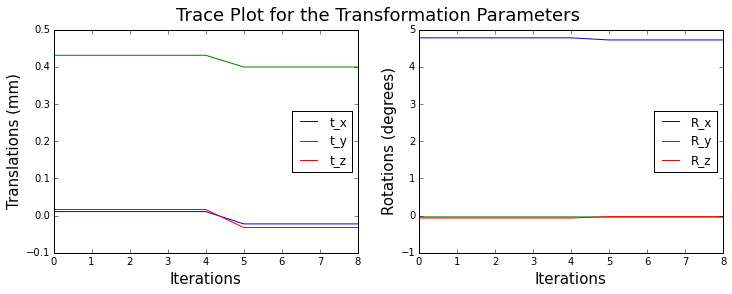

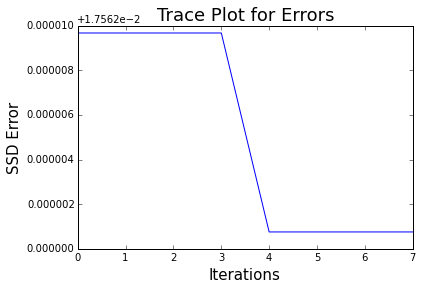

 min error: 0.0175627551936
translations: [-0.02231604  0.39943585 -0.03204942] rotations: [ 4.72200077 -0.03951184 -0.02726862]
CPU times: user 2min 42s, sys: 1min 56s, total: 4min 38s
Wall time: 2min 27s


In [100]:
%%time

c_errors = []
c_errors.append(error)
c_ls = np.arange(0,0.01,0.0005)[1:]
for c in c_ls:
    print 'c = ', c
    w = Tukeys_Biweight(R,c)
    W = np.diag(w)
    P_new, R_new, err = Gauss_Newton_IRLS(testVol1_masked, vol1_dervs, testVol2, vol2_dervs, W,
                             divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                             P_initial = P, max_iter = 15, mask = True)
    c_errors.append(err)
    print 'translations:', P_new[:3]*8, 'rotations:',P_new[3:]*180/np.pi

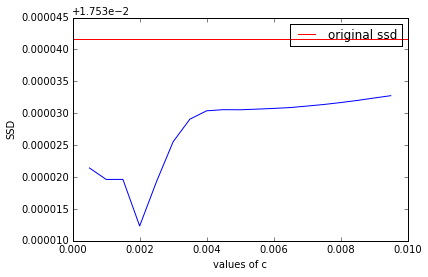

In [101]:
c_ls = np.arange(0,0.01,0.0005)[1:]
plt.plot(c_ls, c_errors[1:])
plt.hlines(c_errors[0],0,0.01,'red',label='original ssd')
plt.xlabel('values of c')
plt.ylabel('SSD')
plt.legend(loc='best')
plt.show()

c =  1
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

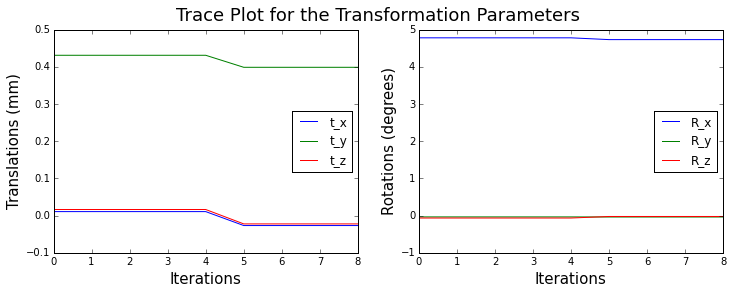

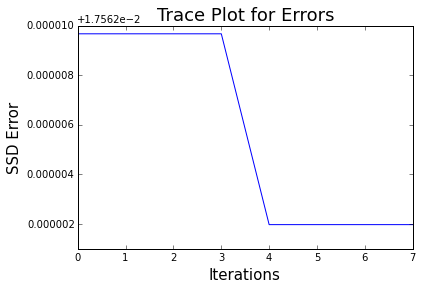

 min error: 0.0175639746423
translations: [-0.02674065  0.39865604 -0.02232846] rotations: [ 4.73089464 -0.03768058 -0.02366956]
c =  2
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

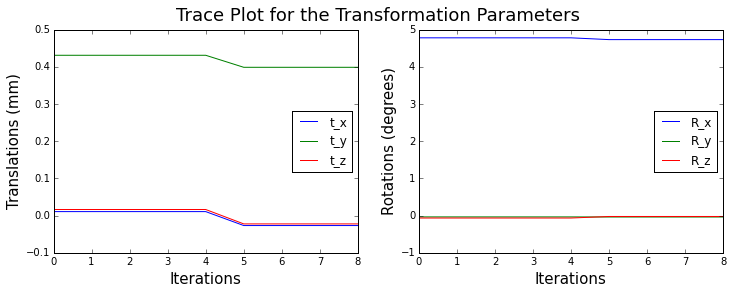

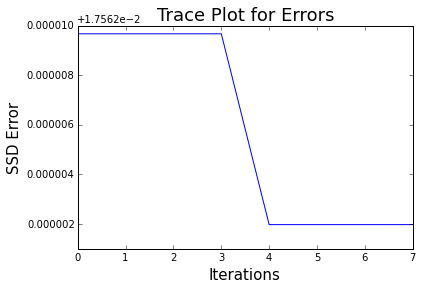

 min error: 0.0175639750936
translations: [-0.02674199  0.39865544 -0.02232919] rotations: [ 4.73089413 -0.03768054 -0.02366768]
c =  3
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

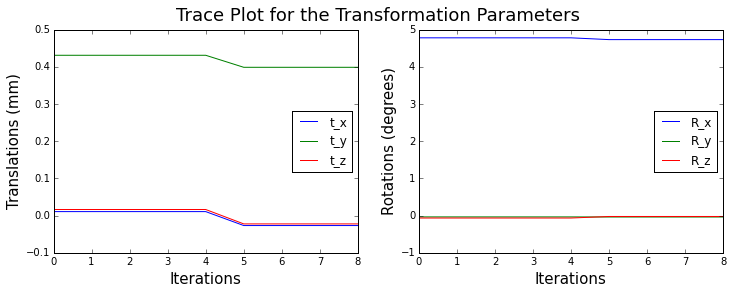

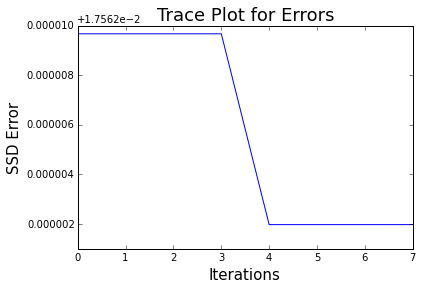

 min error: 0.0175639751772
translations: [-0.02674224  0.39865532 -0.02232932] rotations: [ 4.73089404 -0.03768053 -0.02366733]
c =  4
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

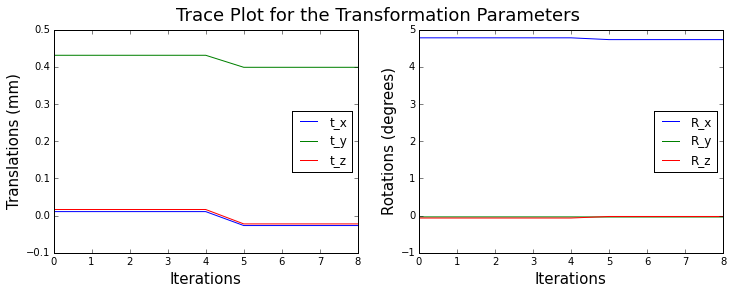

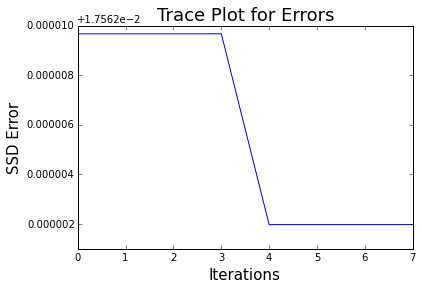

 min error: 0.0175639752064
translations: [-0.02674232  0.39865529 -0.02232937] rotations: [ 4.730894   -0.03768053 -0.0236672 ]
c =  5
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

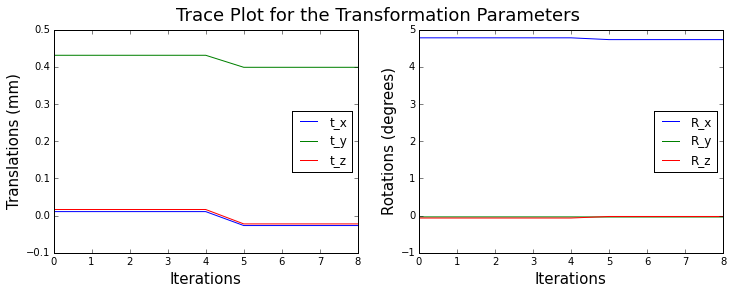

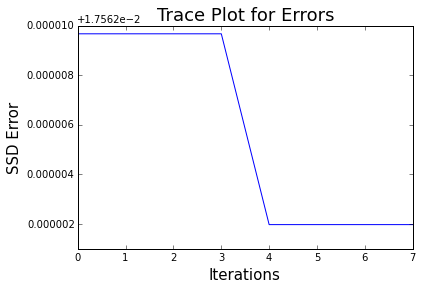

 min error: 0.0175639752199
translations: [-0.02674236  0.39865527 -0.02232939] rotations: [ 4.73089399 -0.03768053 -0.02366715]
c =  6
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

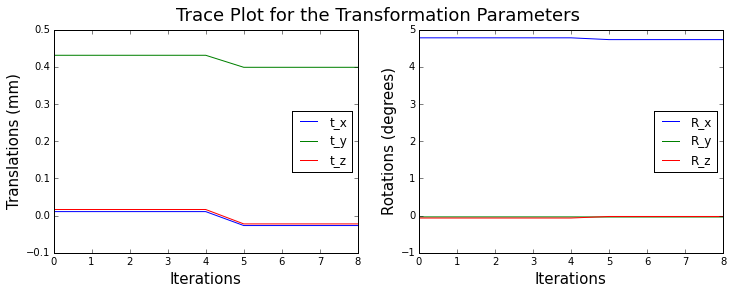

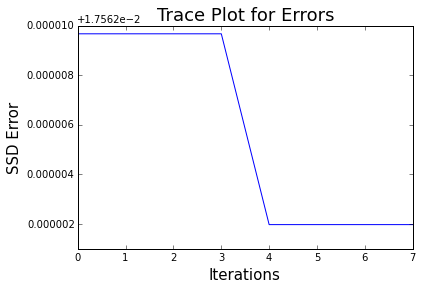

 min error: 0.0175639752273
translations: [-0.02674239  0.39865526 -0.0223294 ] rotations: [ 4.73089398 -0.03768053 -0.02366712]
c =  7
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

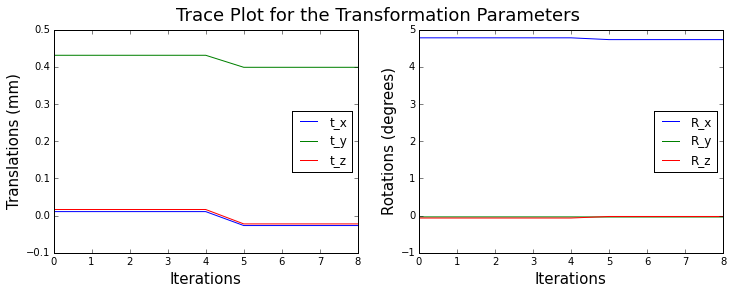

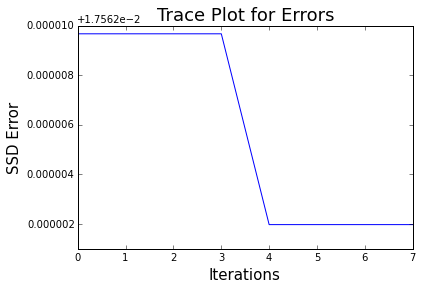

 min error: 0.0175639752317
translations: [-0.0267424   0.39865525 -0.02232941] rotations: [ 4.73089397 -0.03768053 -0.0236671 ]
c =  8
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

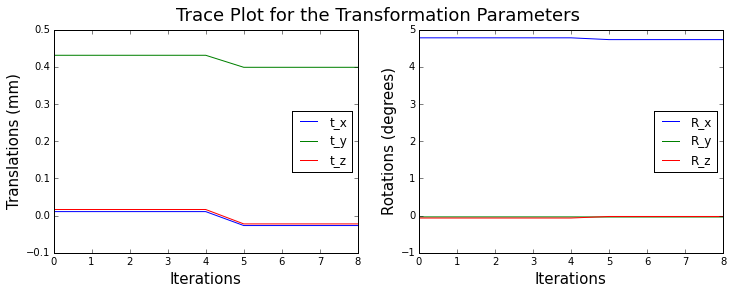

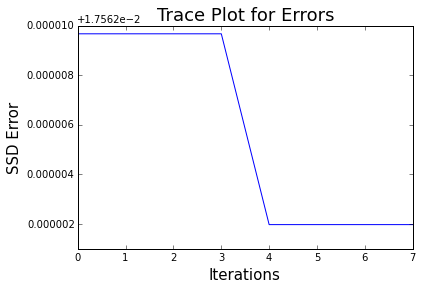

 min error: 0.0175639752346
translations: [-0.02674241  0.39865525 -0.02232941] rotations: [ 4.73089397 -0.03768053 -0.02366709]
c =  9
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

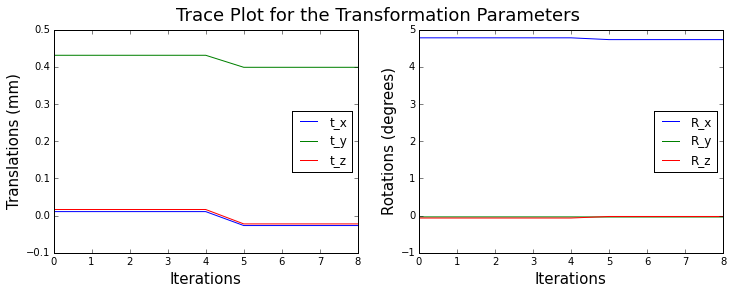

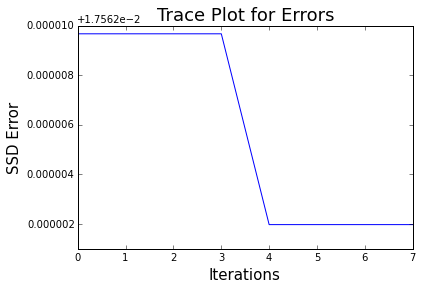

 min error: 0.0175639752366
translations: [-0.02674241  0.39865525 -0.02232942] rotations: [ 4.73089397 -0.03768053 -0.02366708]
c =  10
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

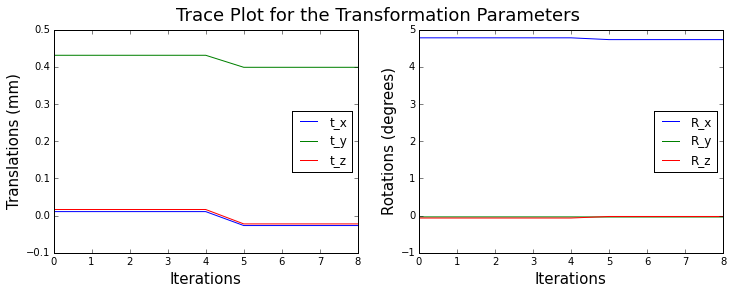

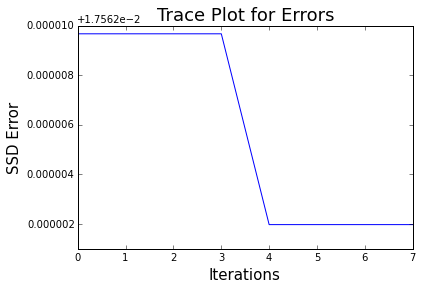

 min error: 0.017563975238
translations: [-0.02674242  0.39865524 -0.02232942] rotations: [ 4.73089397 -0.03768053 -0.02366707]
c =  11
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

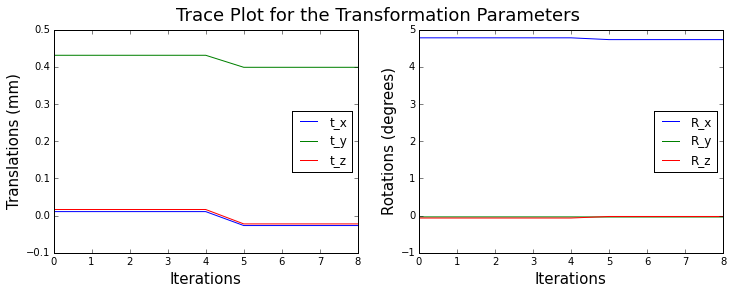

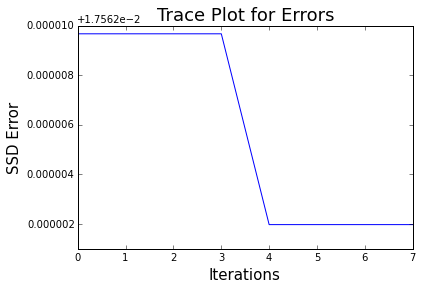

 min error: 0.017563975239
translations: [-0.02674242  0.39865524 -0.02232942] rotations: [ 4.73089397 -0.03768053 -0.02366707]
c =  12
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

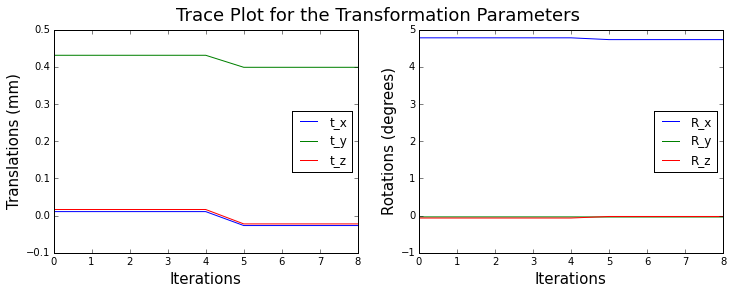

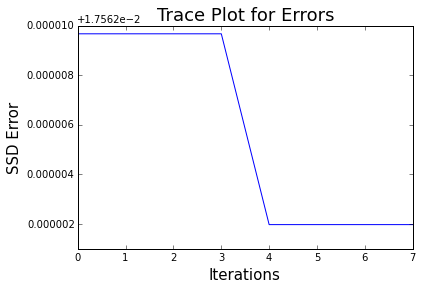

 min error: 0.0175639752398
translations: [-0.02674242  0.39865524 -0.02232942] rotations: [ 4.73089396 -0.03768053 -0.02366706]
c =  13
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

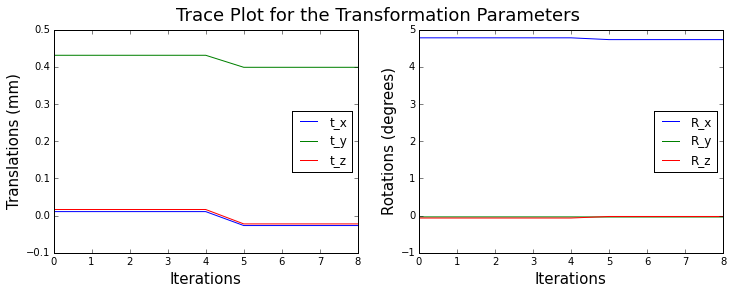

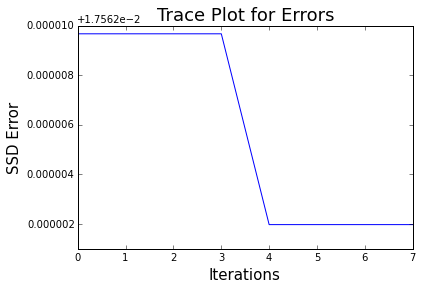

 min error: 0.0175639752405
translations: [-0.02674243  0.39865524 -0.02232942] rotations: [ 4.73089396 -0.03768053 -0.02366706]
c =  14
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

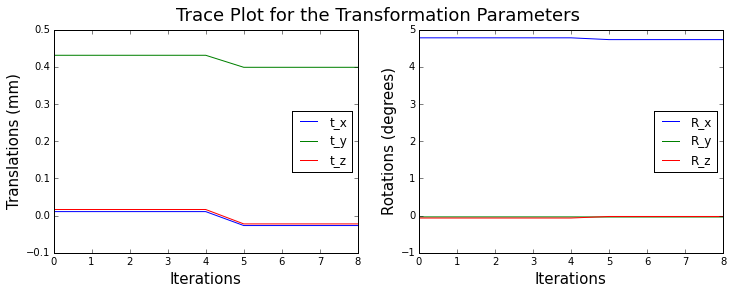

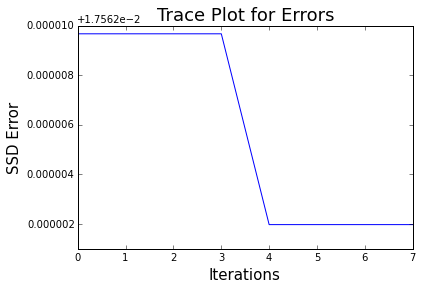

 min error: 0.0175639752409
translations: [-0.02674243  0.39865524 -0.02232942] rotations: [ 4.73089396 -0.03768053 -0.02366706]
c =  15
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

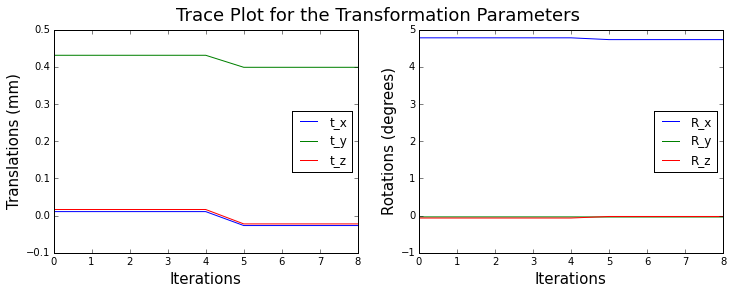

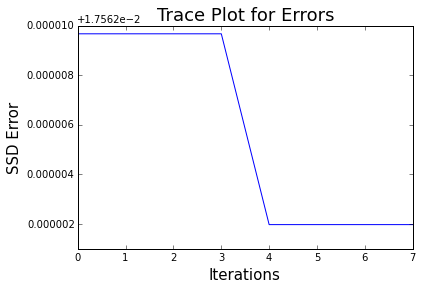

 min error: 0.0175639752413
translations: [-0.02674243  0.39865524 -0.02232942] rotations: [ 4.73089396 -0.03768053 -0.02366706]
c =  16
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

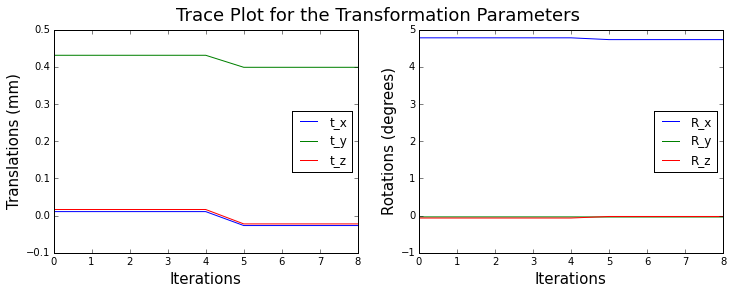

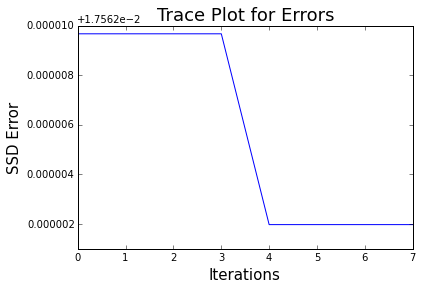

 min error: 0.0175639752417
translations: [-0.02674243  0.39865524 -0.02232942] rotations: [ 4.73089396 -0.03768053 -0.02366706]
c =  17
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

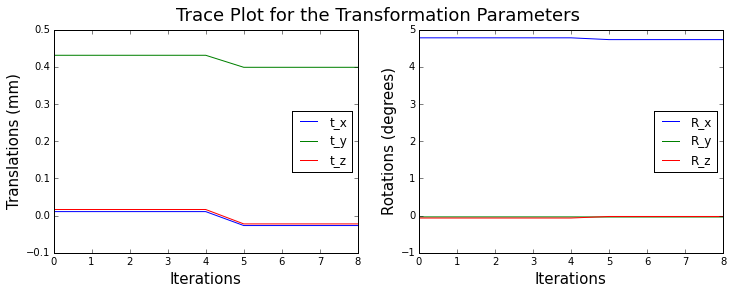

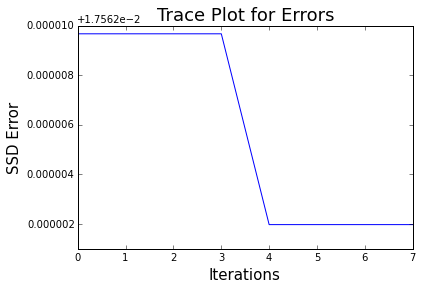

 min error: 0.0175639752419
translations: [-0.02674243  0.39865524 -0.02232942] rotations: [ 4.73089396 -0.03768053 -0.02366706]
c =  18
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

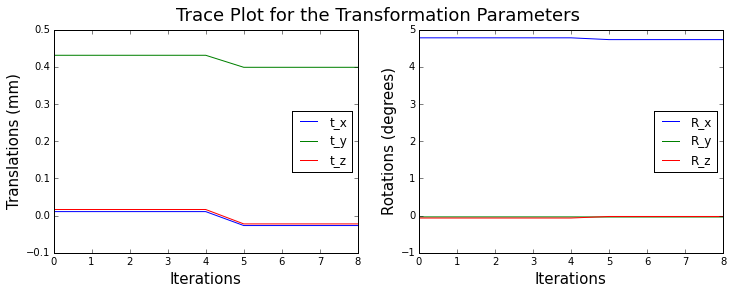

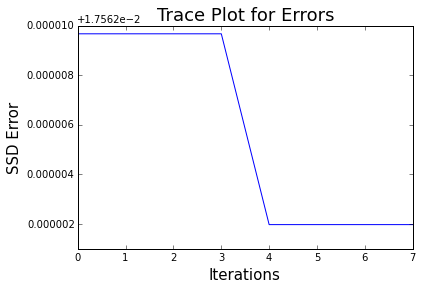

 min error: 0.0175639752422
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366706]
c =  19
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

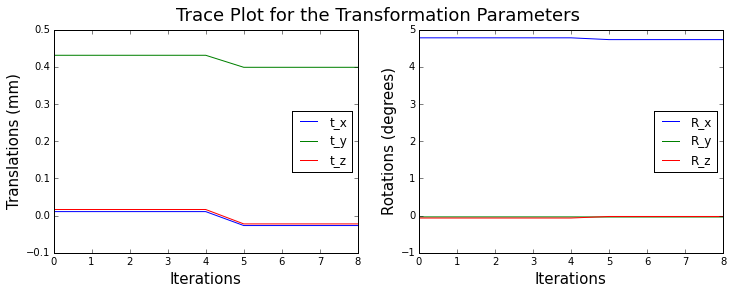

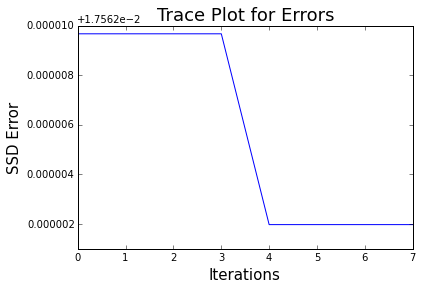

 min error: 0.0175639752424
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  20
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

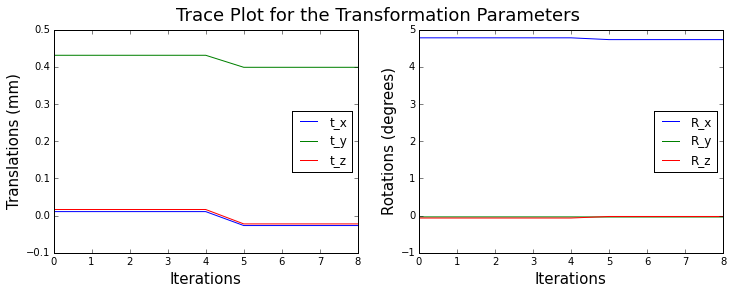

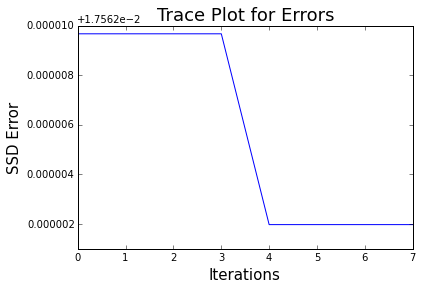

 min error: 0.0175639752425
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  21
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

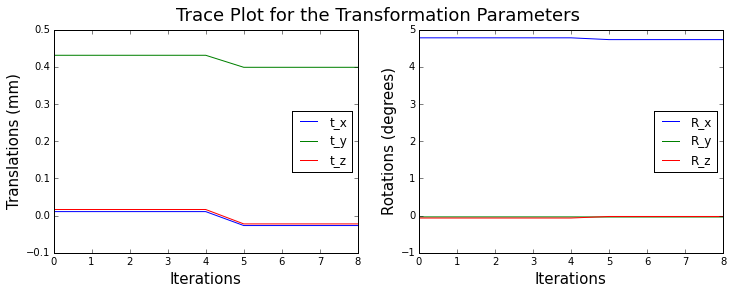

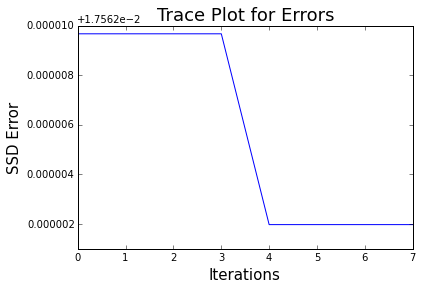

 min error: 0.0175639752427
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  22
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

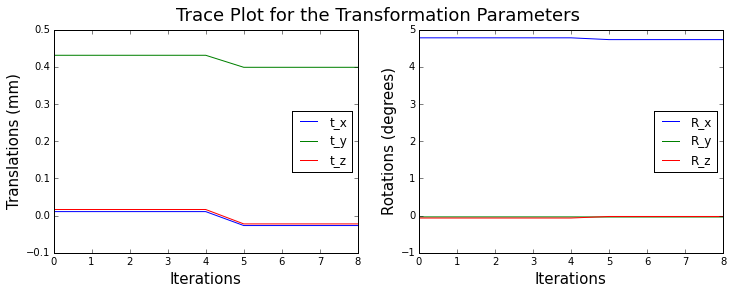

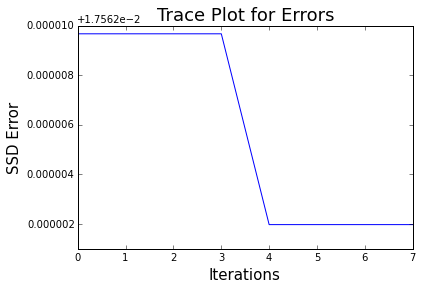

 min error: 0.0175639752428
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  23
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

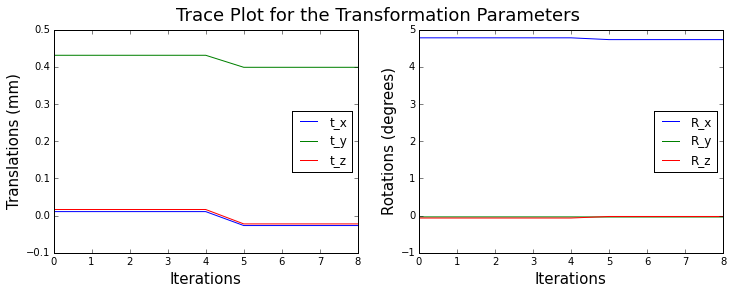

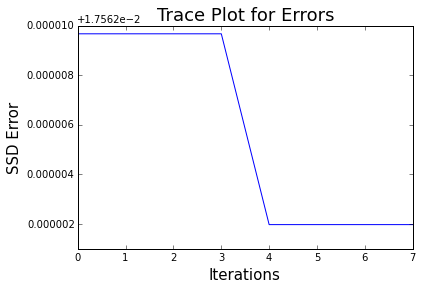

 min error: 0.0175639752429
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  24
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

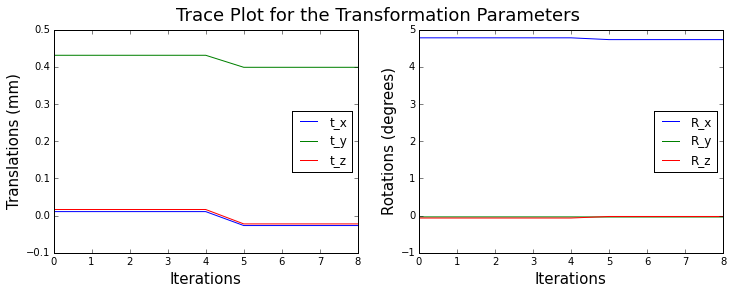

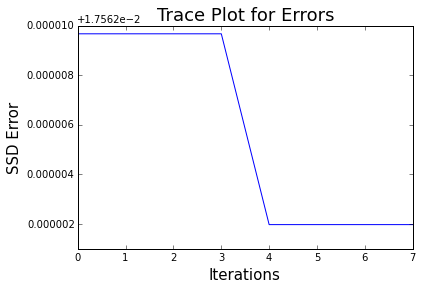

 min error: 0.017563975243
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  25
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

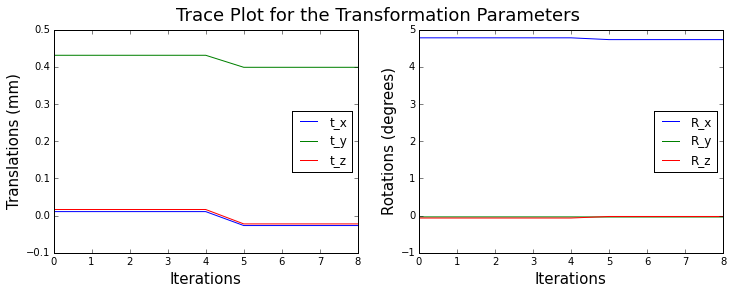

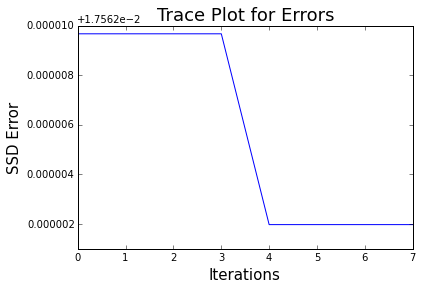

 min error: 0.0175639752431
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  26
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

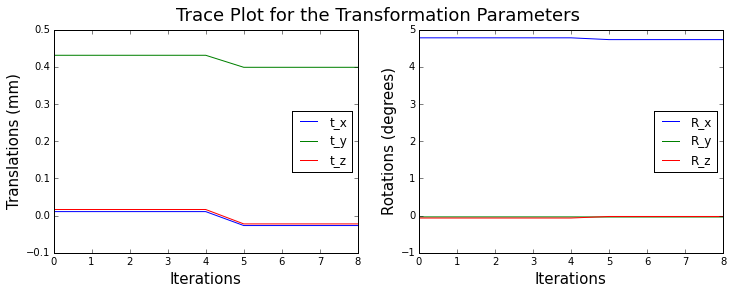

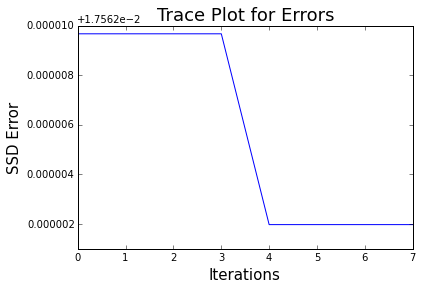

 min error: 0.0175639752431
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  27
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

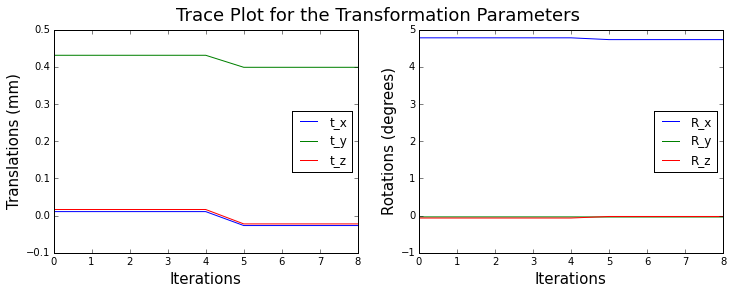

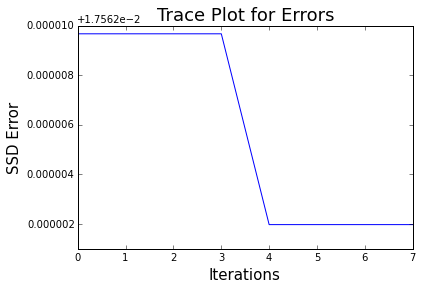

 min error: 0.0175639752432
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  28
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

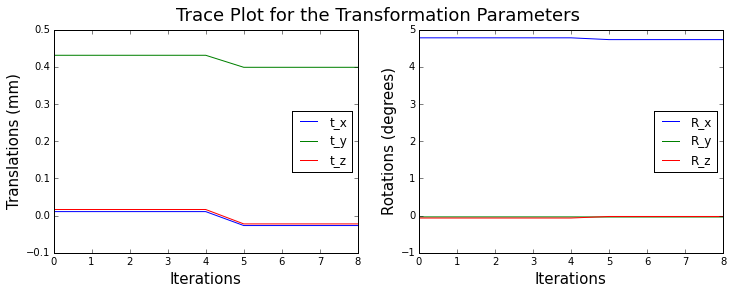

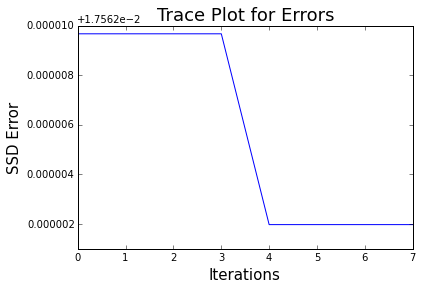

 min error: 0.0175639752432
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  29
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

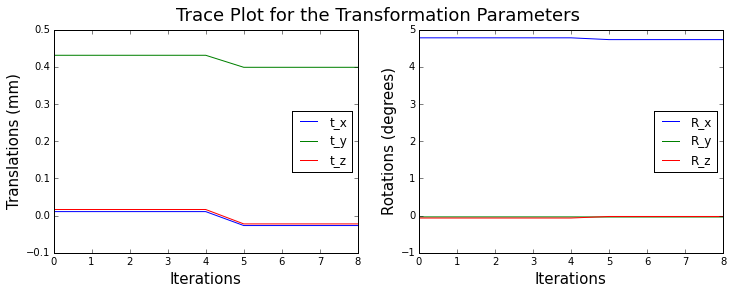

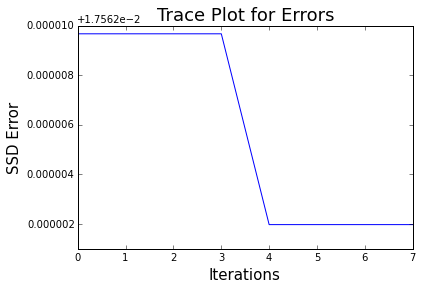

 min error: 0.0175639752433
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  30
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

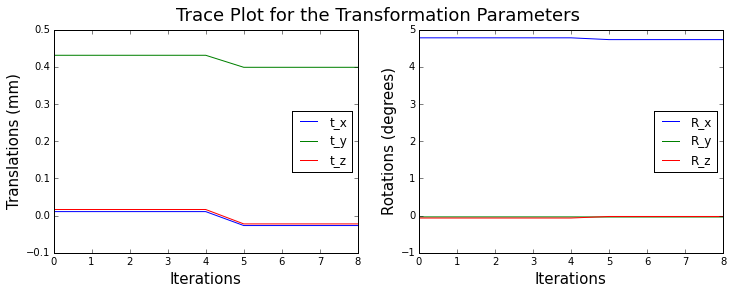

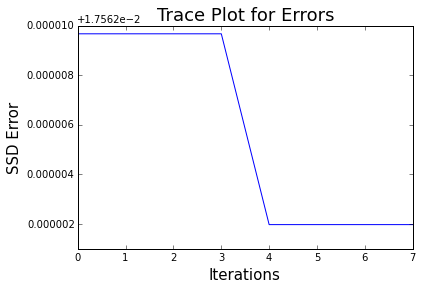

 min error: 0.0175639752433
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  31
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

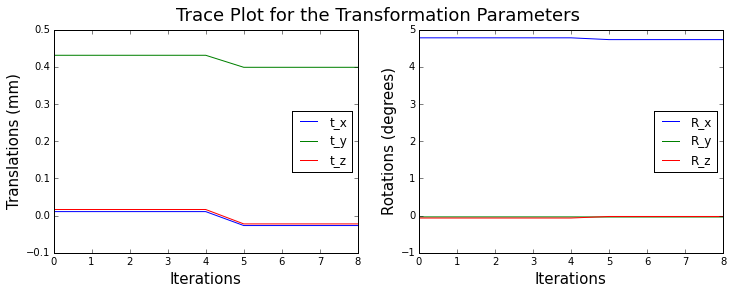

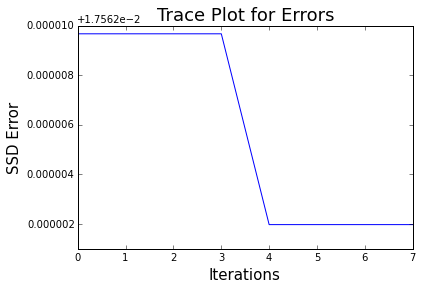

 min error: 0.0175639752434
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  32
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

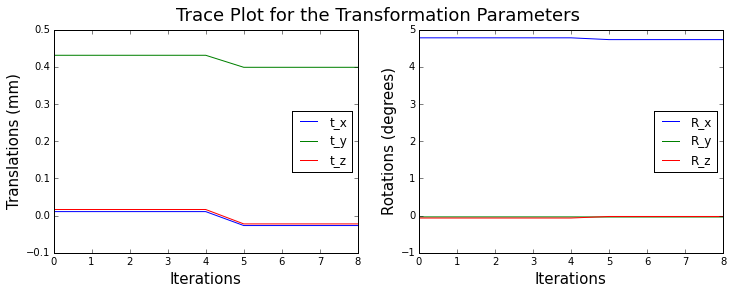

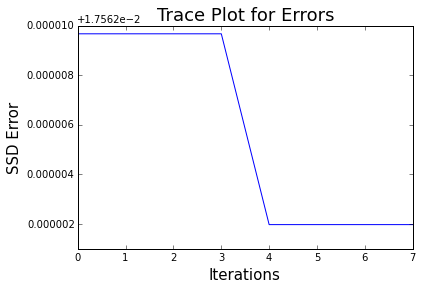

 min error: 0.0175639752434
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  33
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

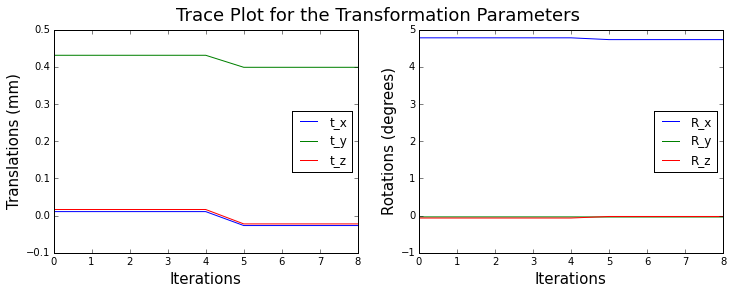

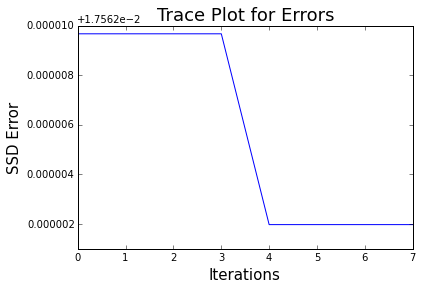

 min error: 0.0175639752435
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  34
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

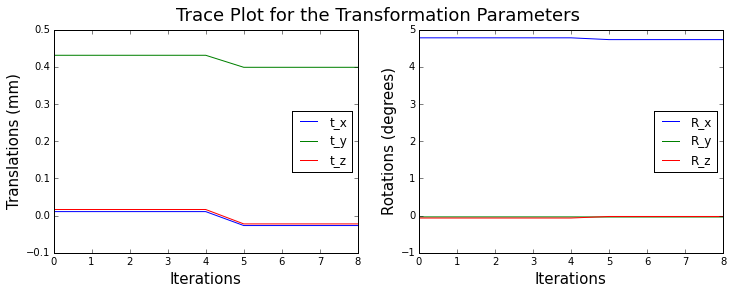

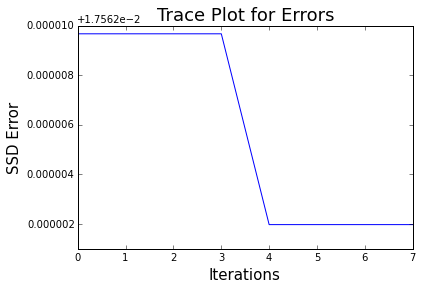

 min error: 0.0175639752435
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  35
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

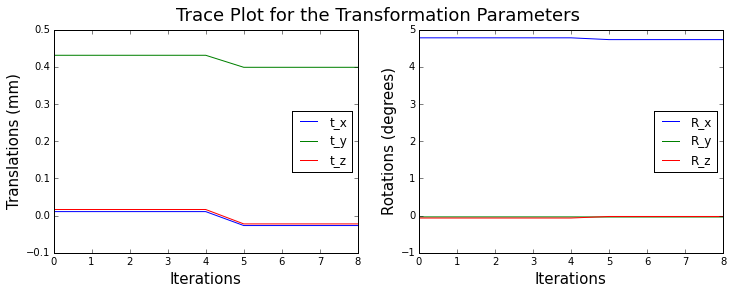

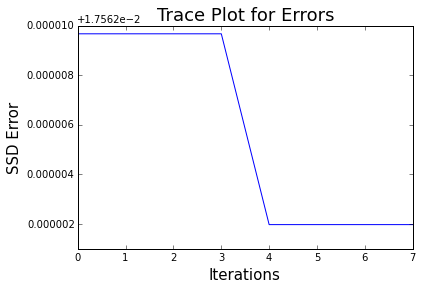

 min error: 0.0175639752435
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  36
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

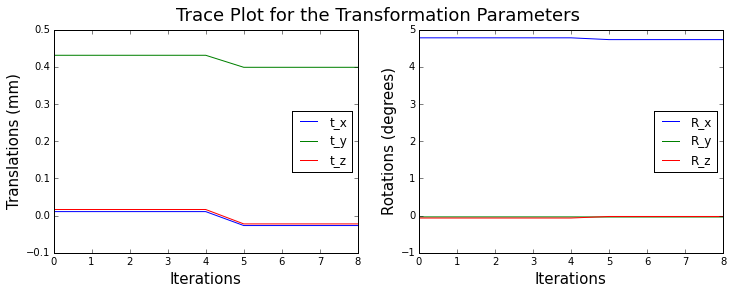

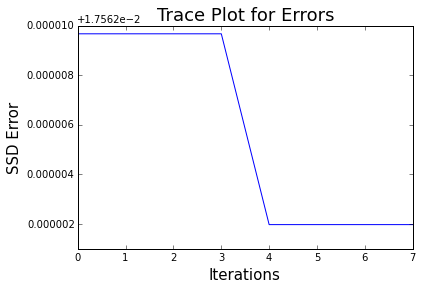

 min error: 0.0175639752436
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  37
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

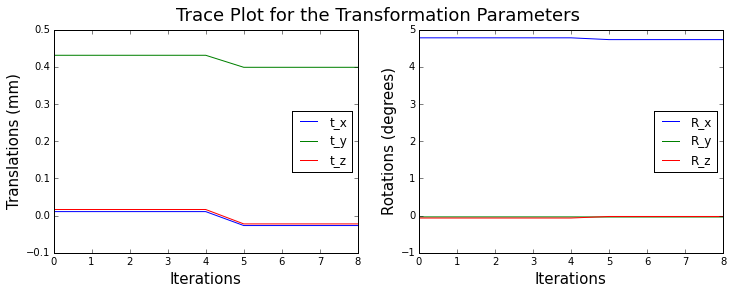

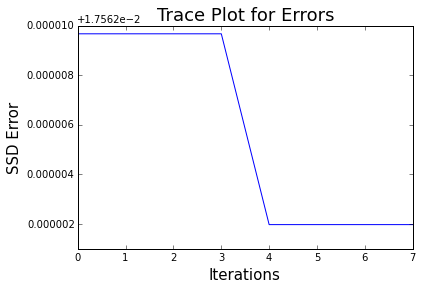

 min error: 0.0175639752436
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  38
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

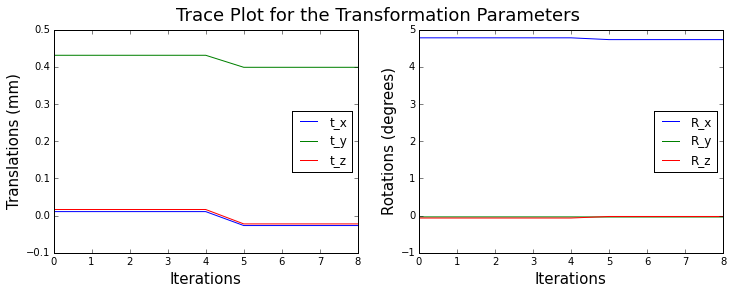

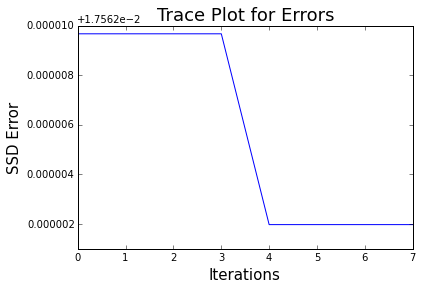

 min error: 0.0175639752436
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  39
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

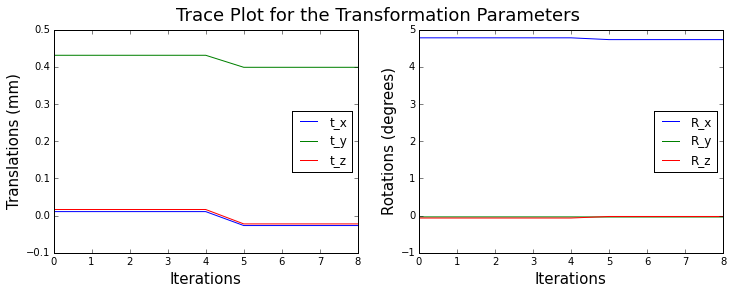

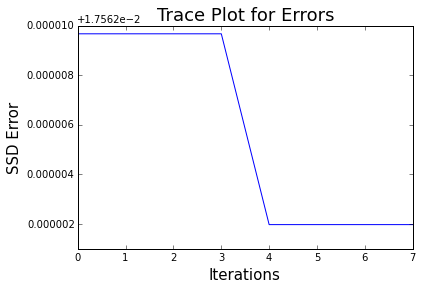

 min error: 0.0175639752436
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  40
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

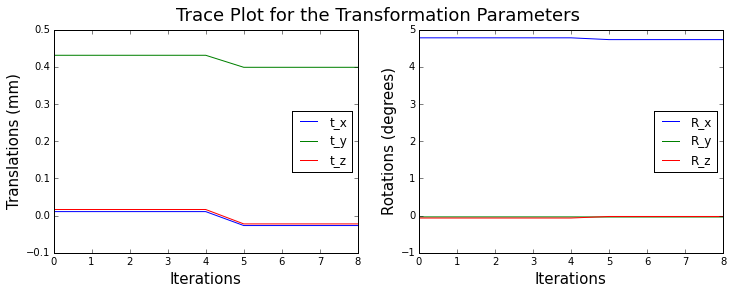

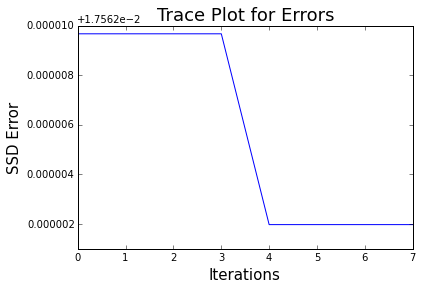

 min error: 0.0175639752436
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  41
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

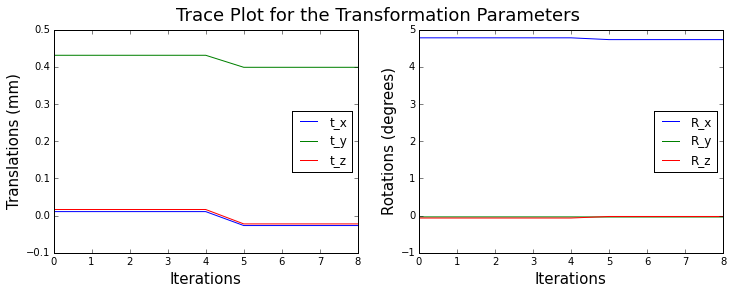

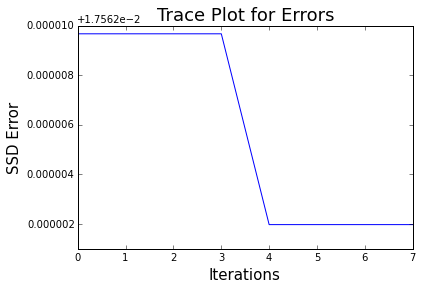

 min error: 0.0175639752437
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  42
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

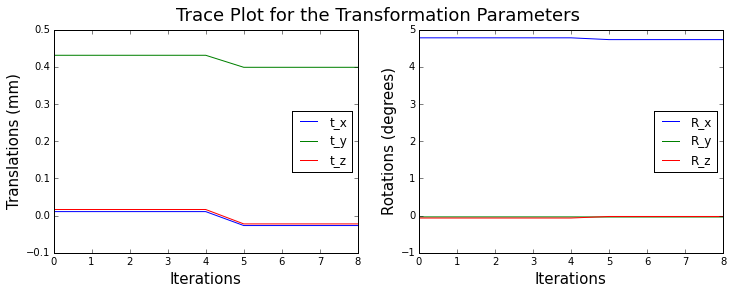

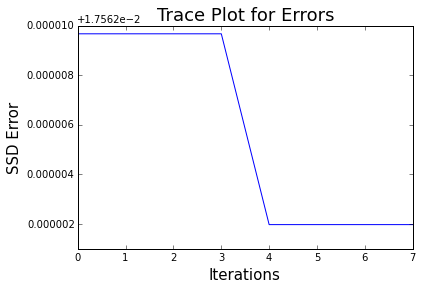

 min error: 0.0175639752437
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  43
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

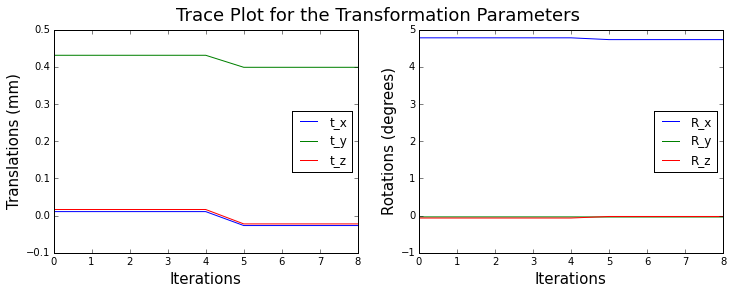

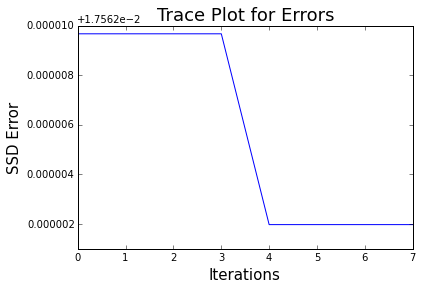

 min error: 0.0175639752437
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  44
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

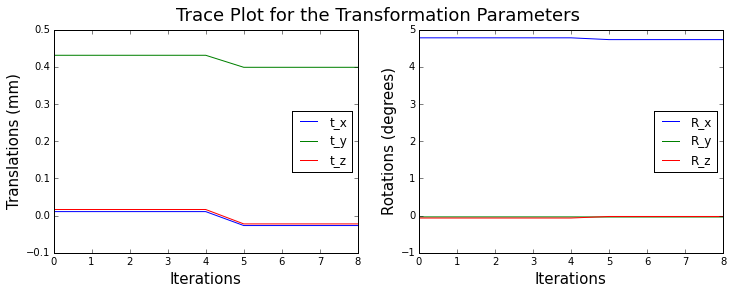

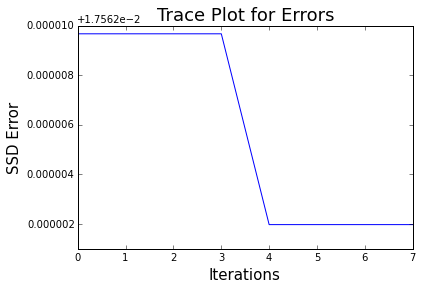

 min error: 0.0175639752437
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  45
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

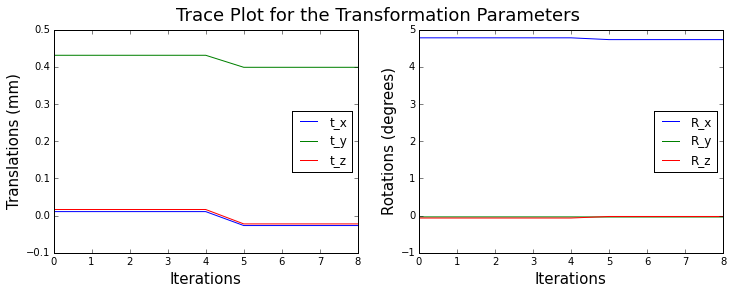

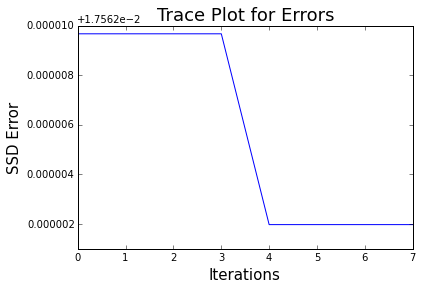

 min error: 0.0175639752437
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  46
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

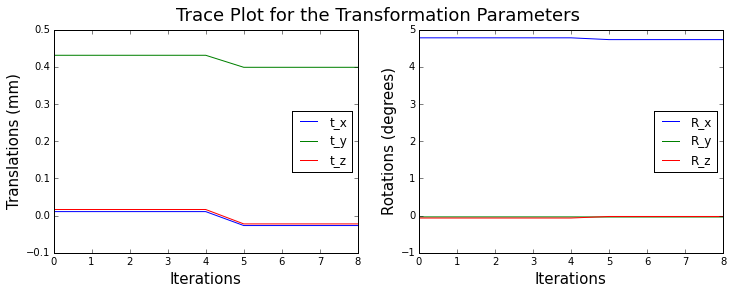

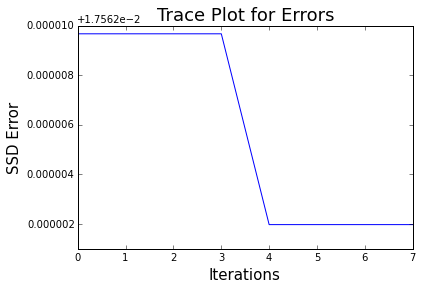

 min error: 0.0175639752437
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  47
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

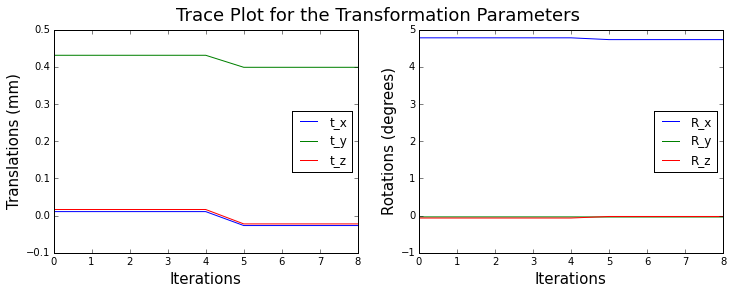

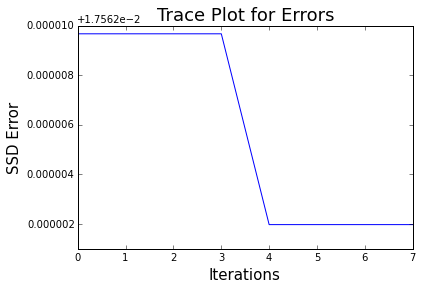

 min error: 0.0175639752437
translations: [-0.02674243  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  48
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

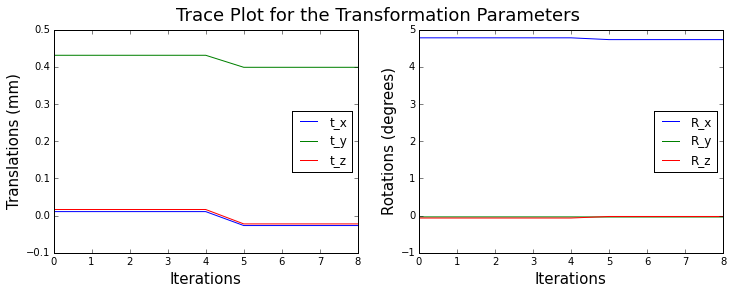

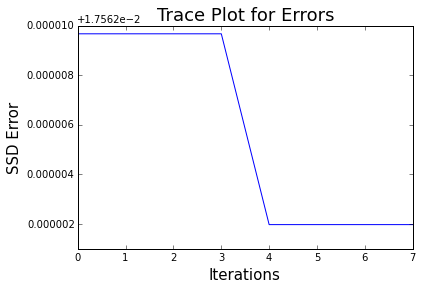

 min error: 0.0175639752438
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  49
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

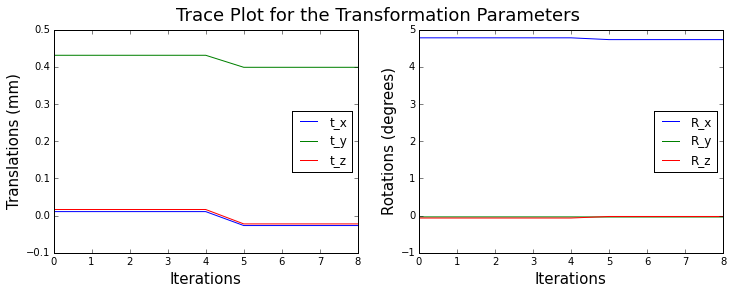

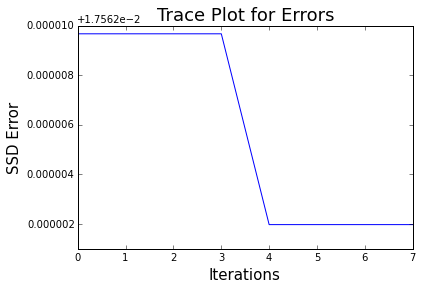

 min error: 0.0175639752438
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  50
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

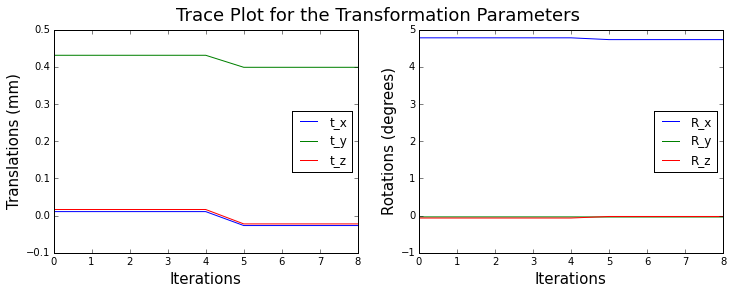

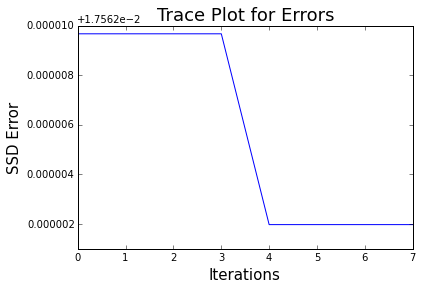

 min error: 0.0175639752438
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  51
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

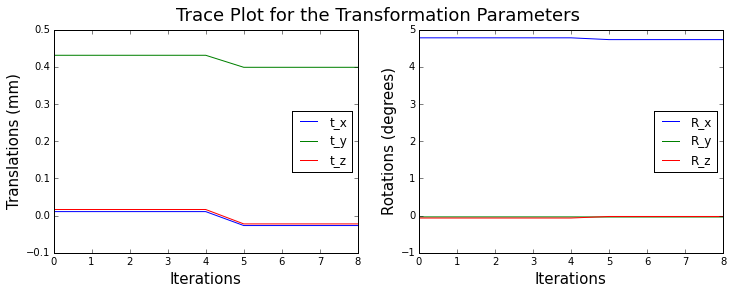

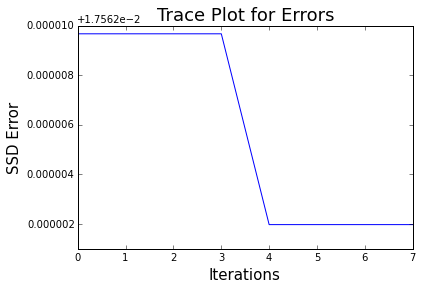

 min error: 0.0175639752438
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  52
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

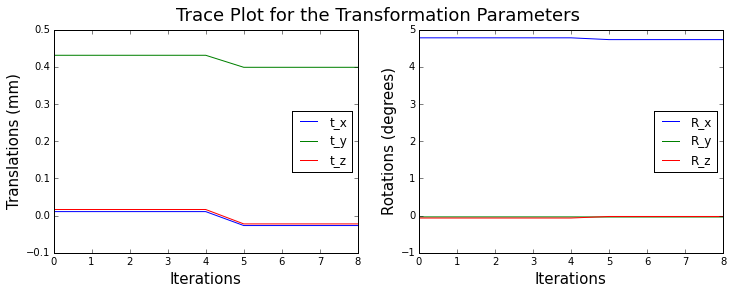

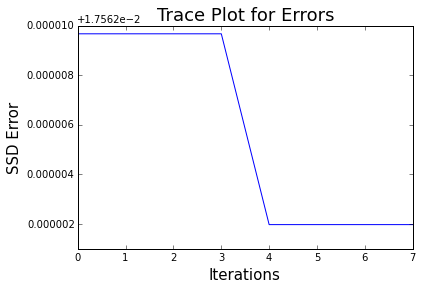

 min error: 0.0175639752438
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  53
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

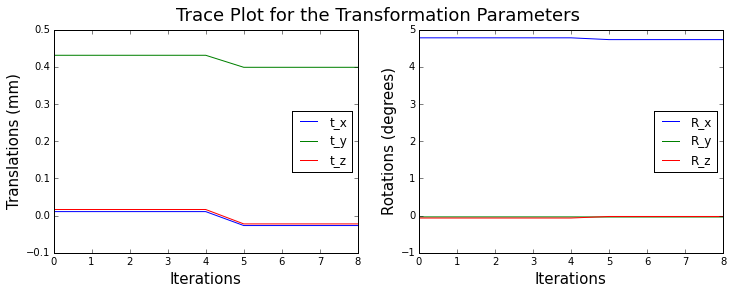

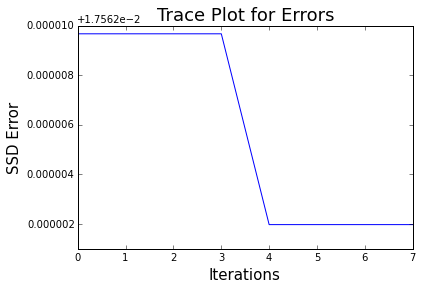

 min error: 0.0175639752438
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  54
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

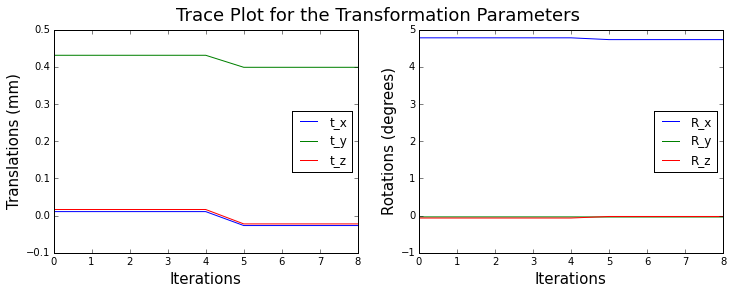

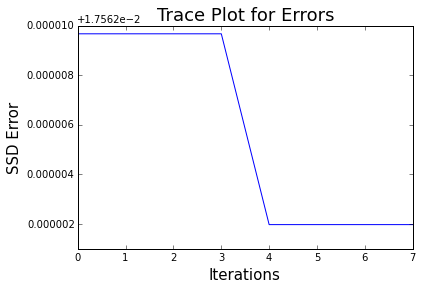

 min error: 0.0175639752438
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  55
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

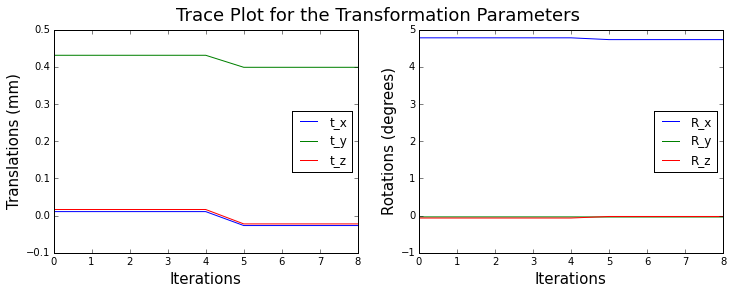

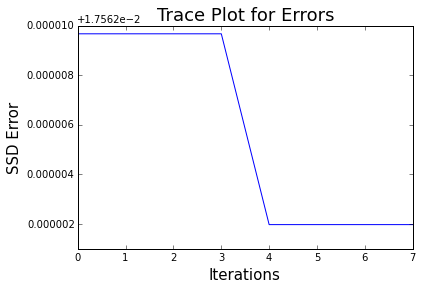

 min error: 0.0175639752438
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  56
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

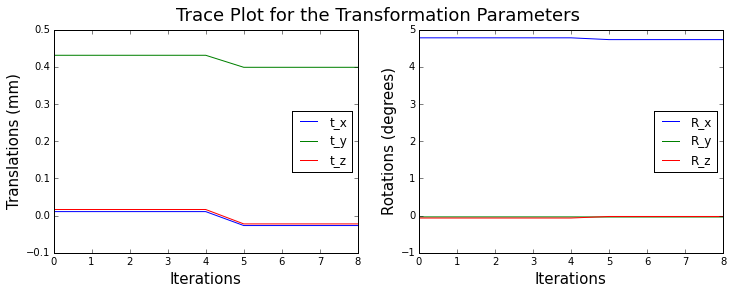

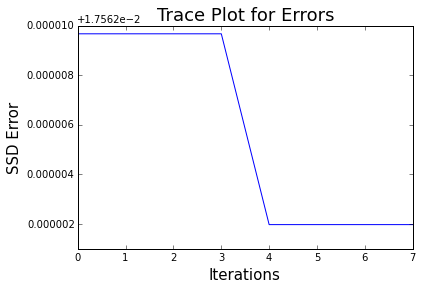

 min error: 0.0175639752438
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  57
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

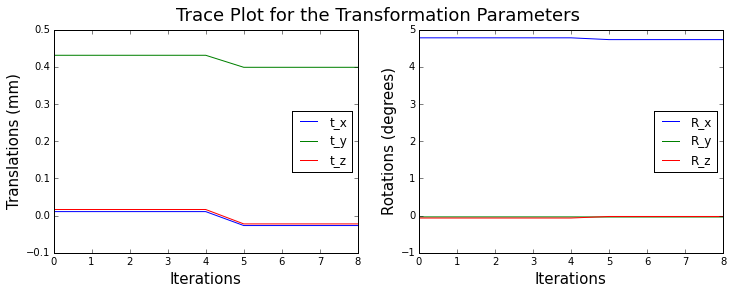

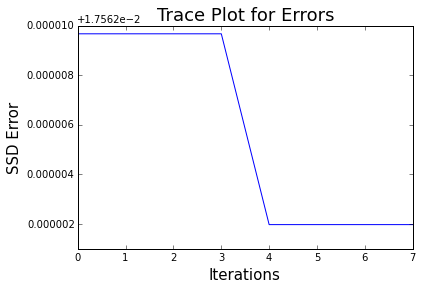

 min error: 0.0175639752438
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  58
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

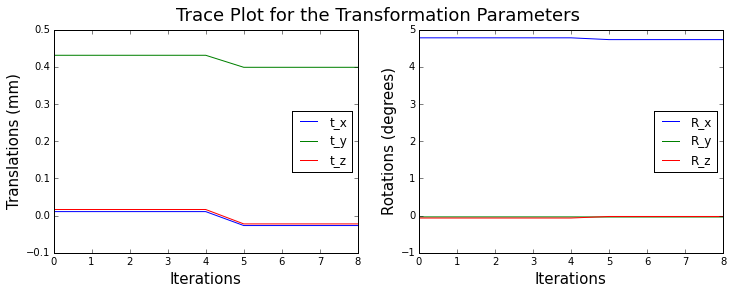

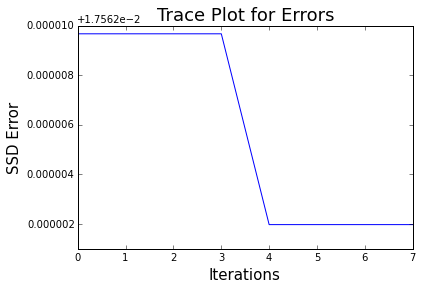

 min error: 0.0175639752438
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  59
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

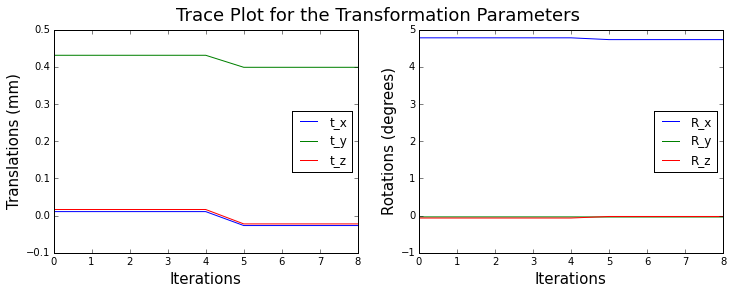

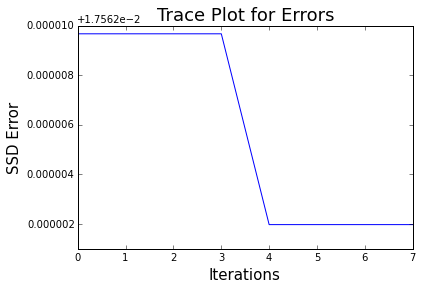

 min error: 0.0175639752438
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  60
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

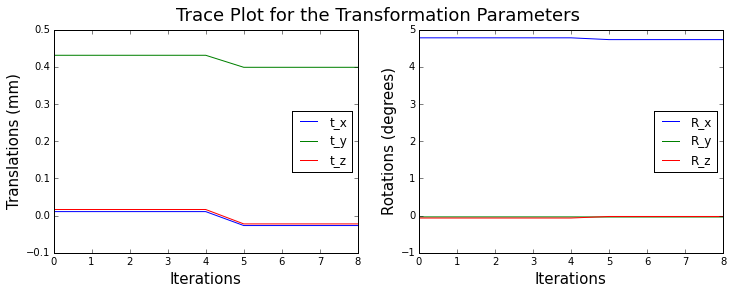

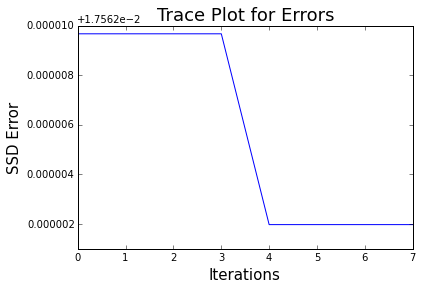

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  61
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

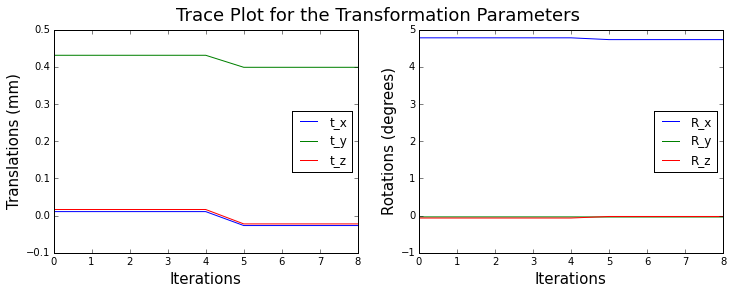

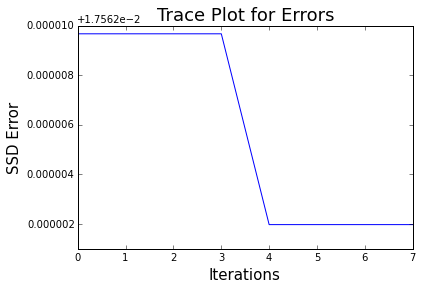

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  62
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

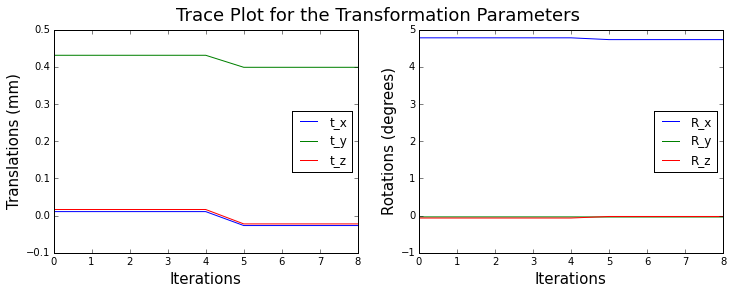

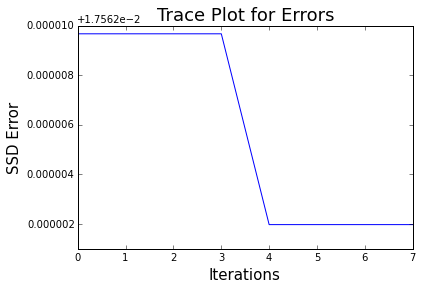

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  63
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

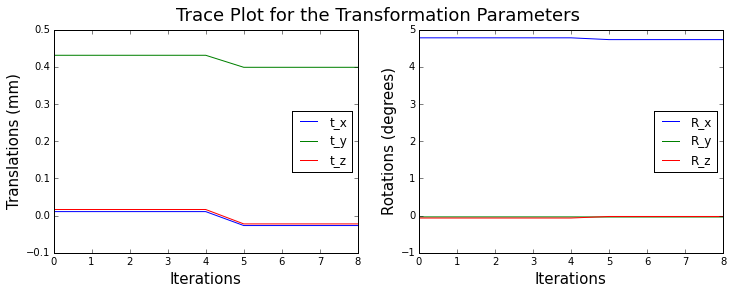

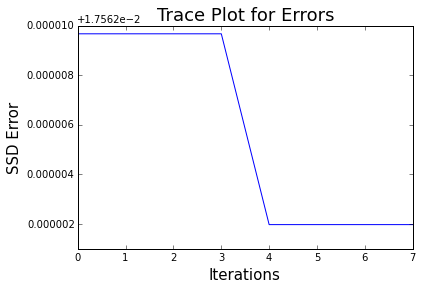

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  64
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

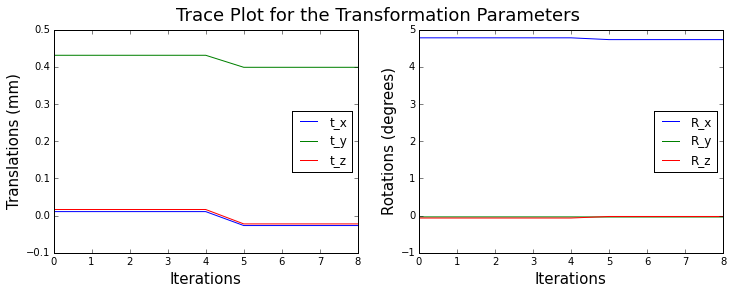

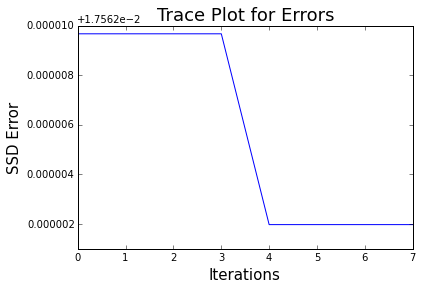

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  65
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

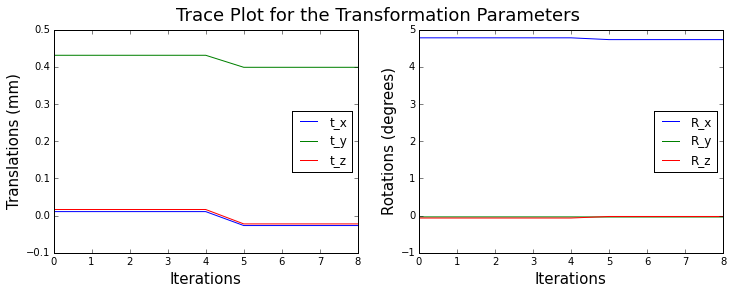

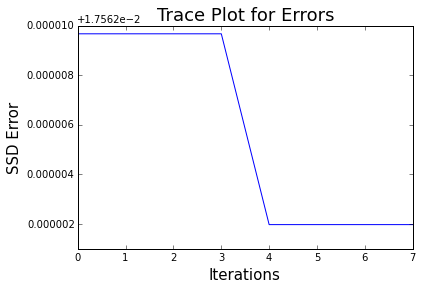

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  66
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

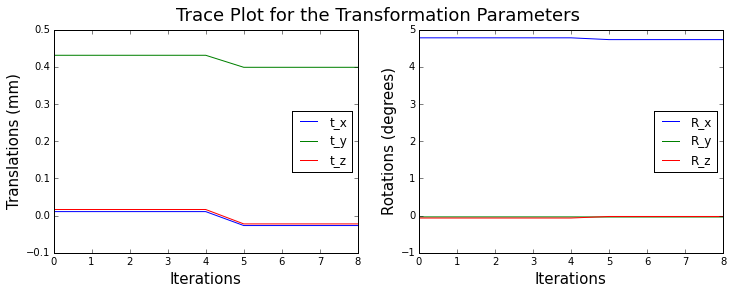

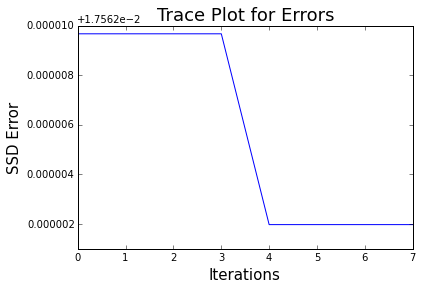

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  67
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

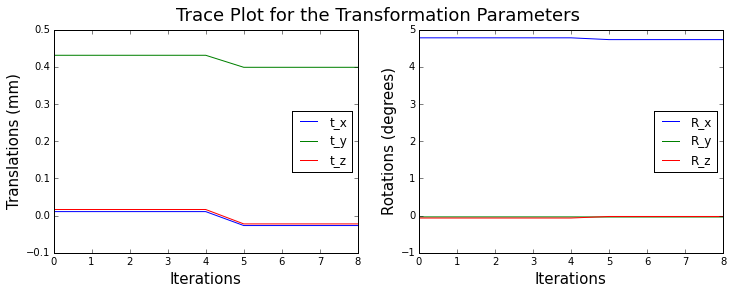

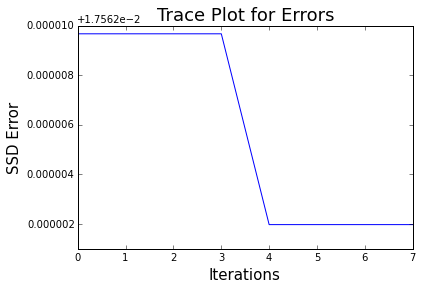

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  68
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

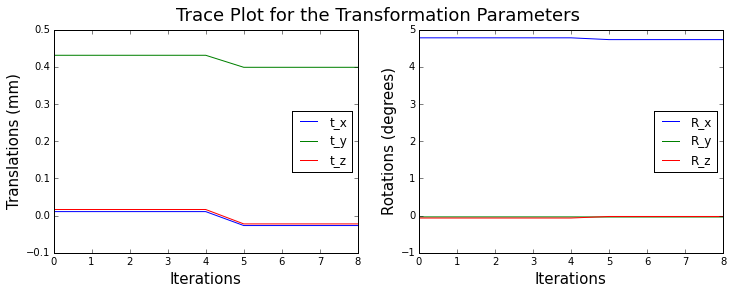

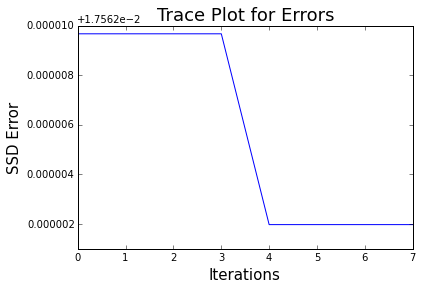

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  69
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

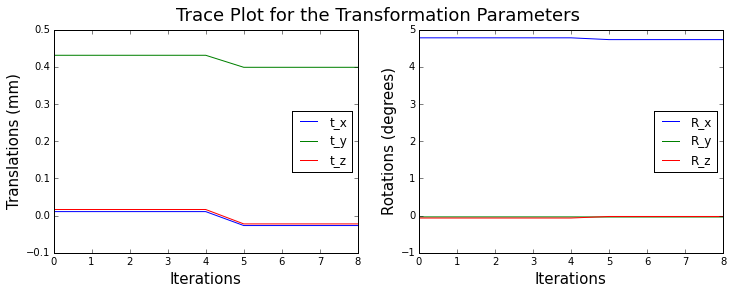

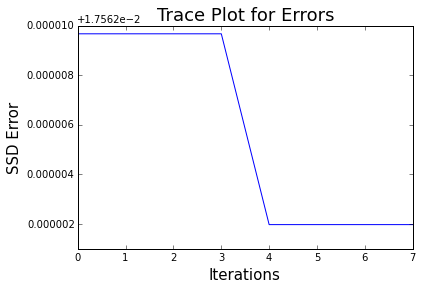

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  70
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

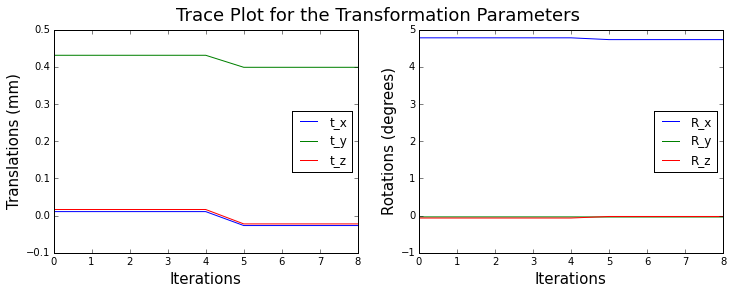

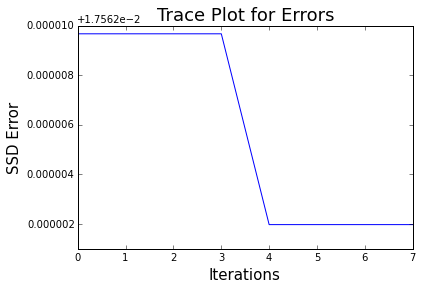

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  71
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

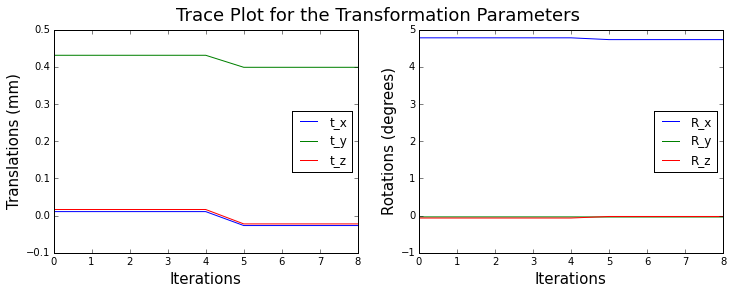

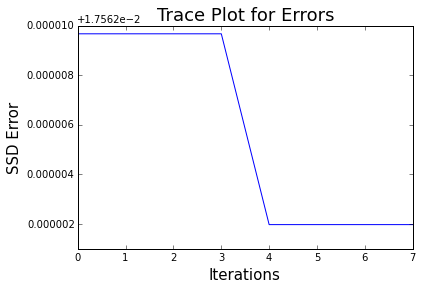

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  72
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

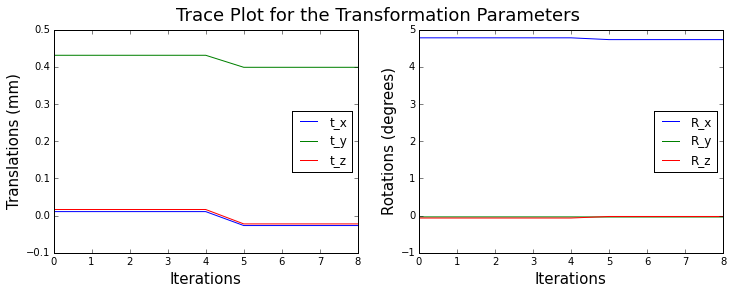

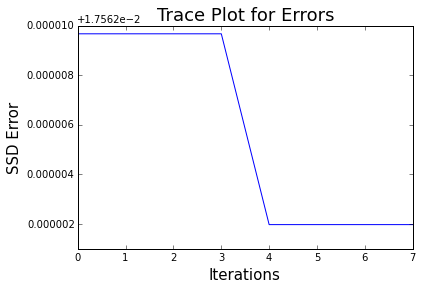

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  73
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

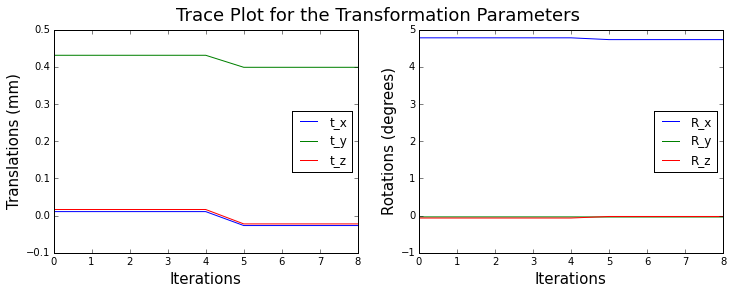

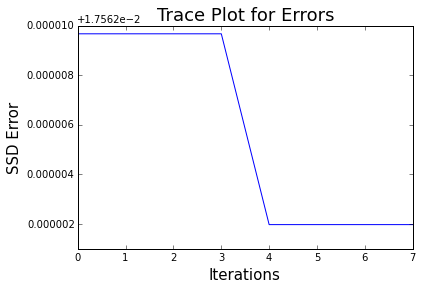

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  74
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

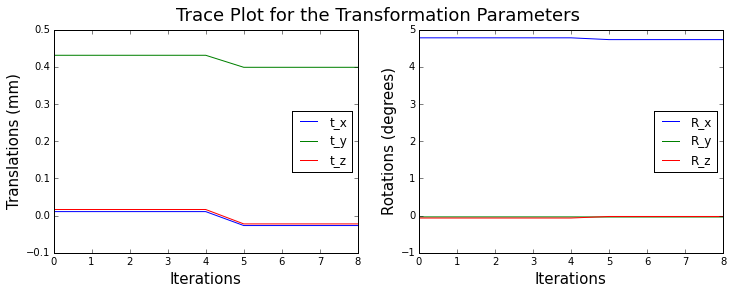

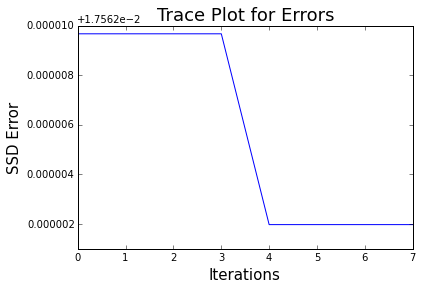

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  75
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

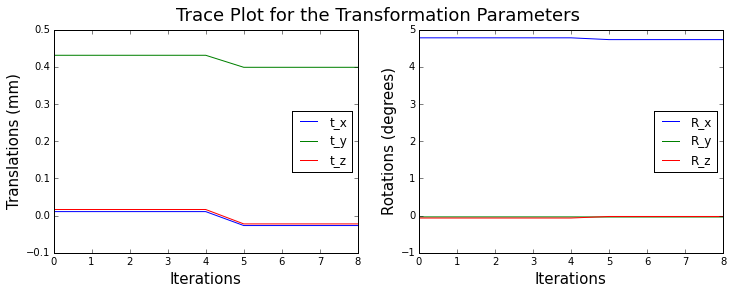

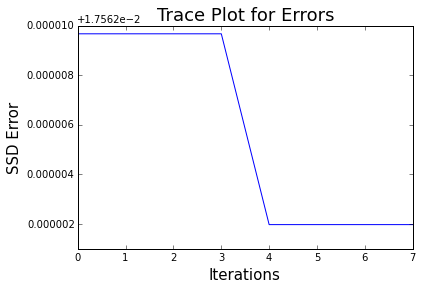

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  76
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

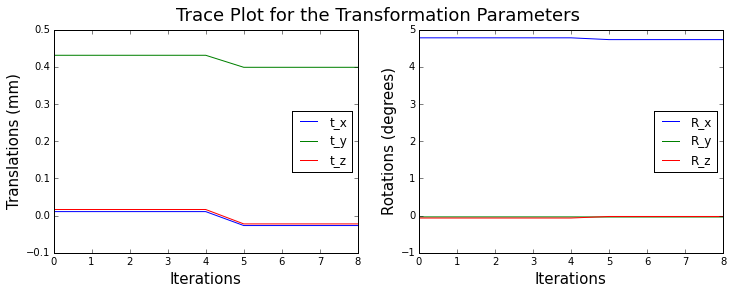

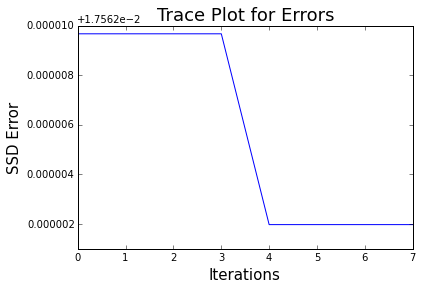

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  77
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

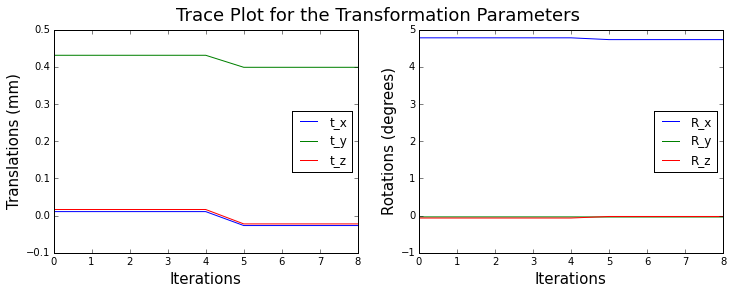

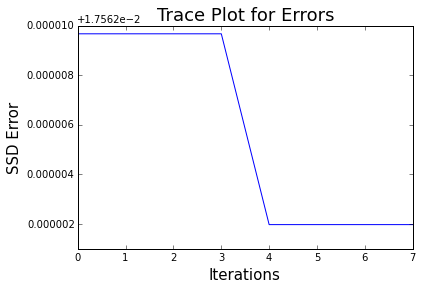

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  78
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

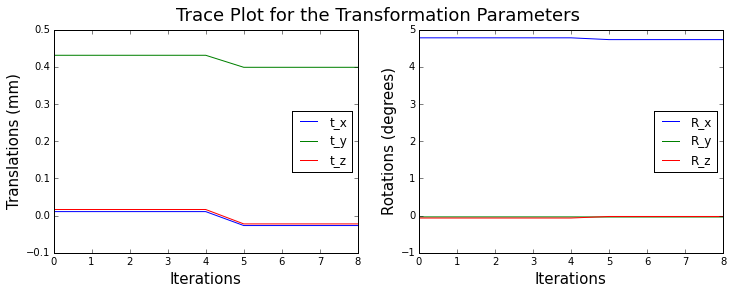

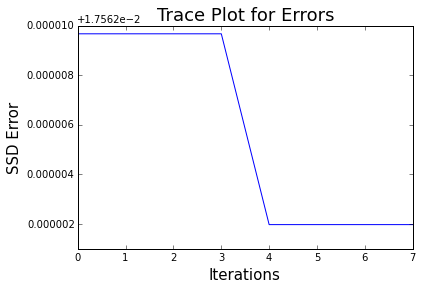

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  79
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

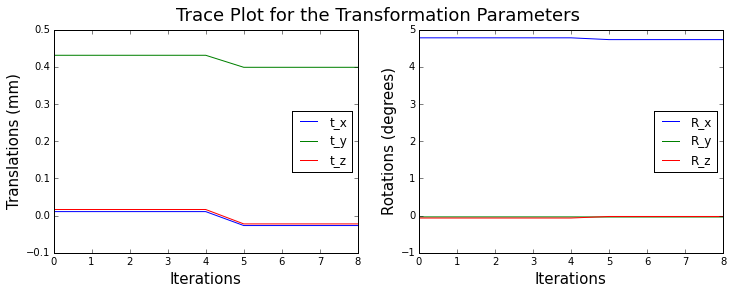

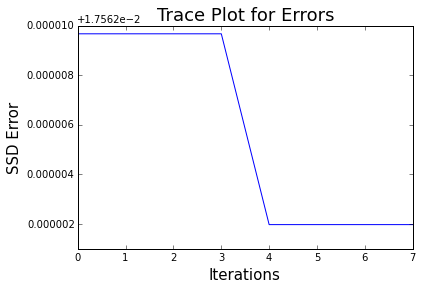

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  80
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

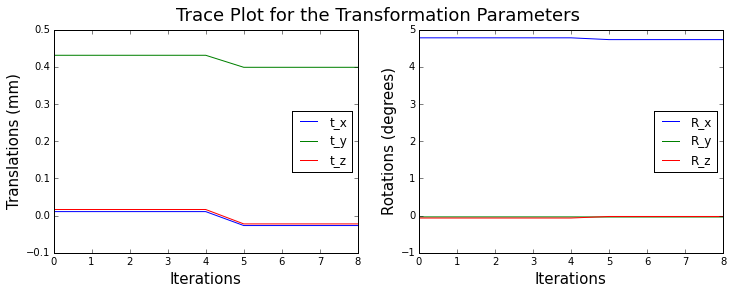

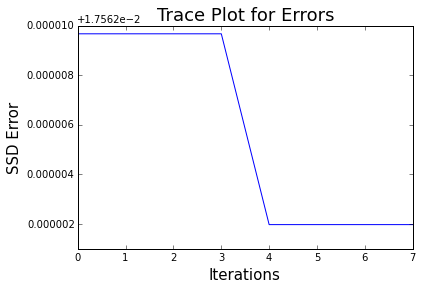

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  81
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

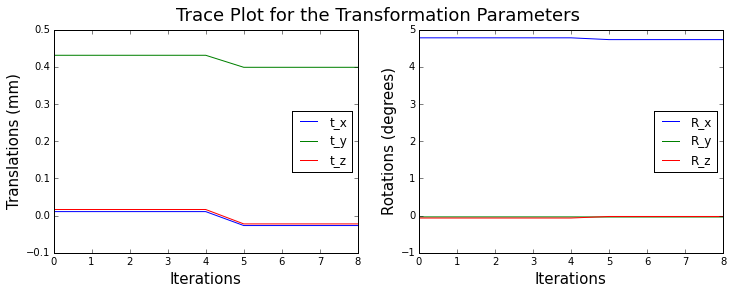

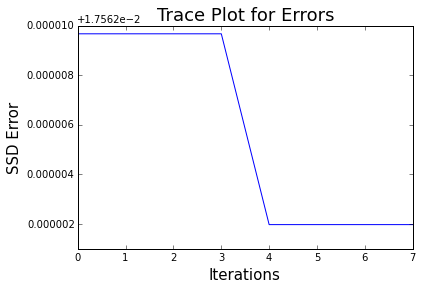

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  82
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

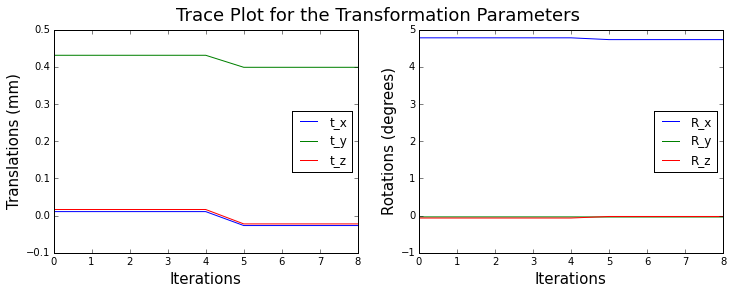

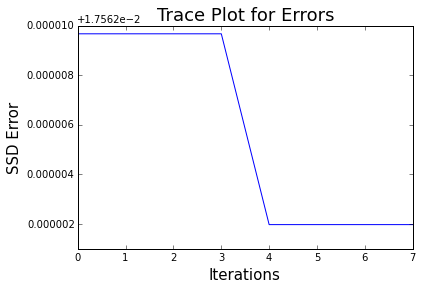

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  83
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

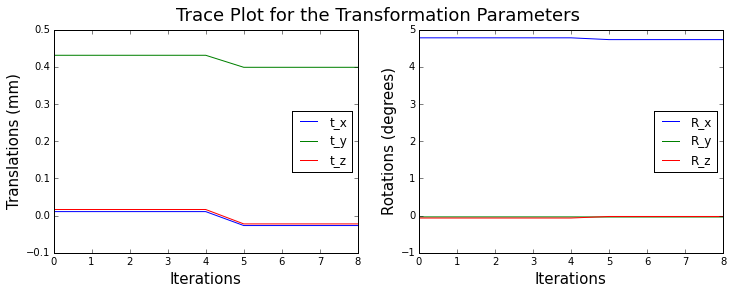

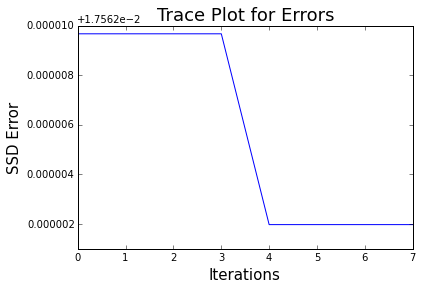

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  84
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

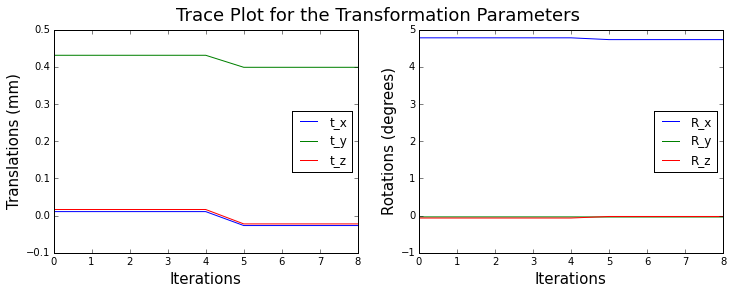

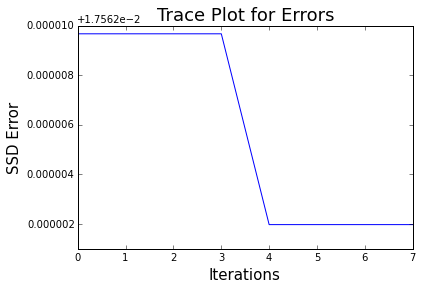

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  85
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

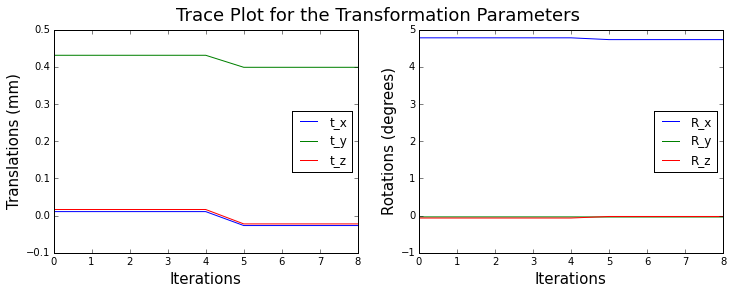

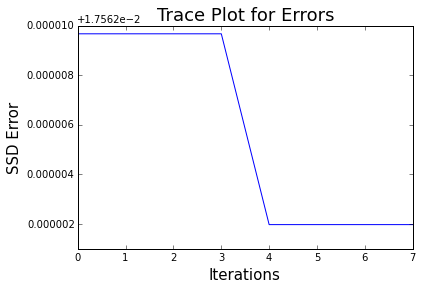

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  86
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

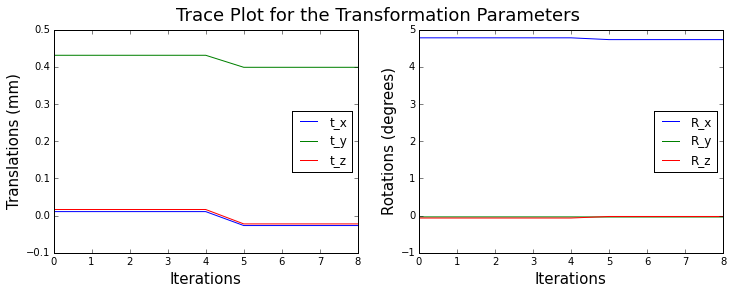

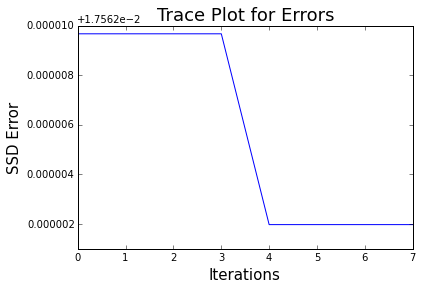

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  87
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

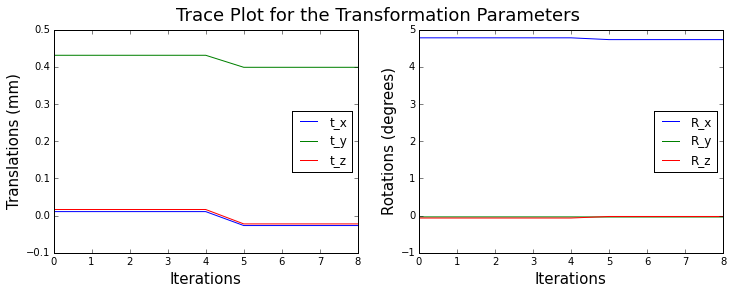

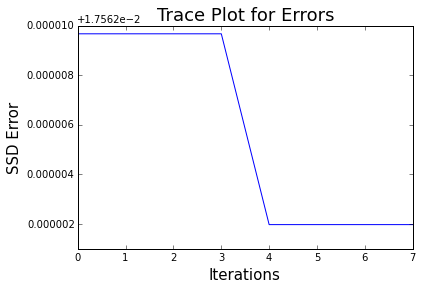

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  88
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

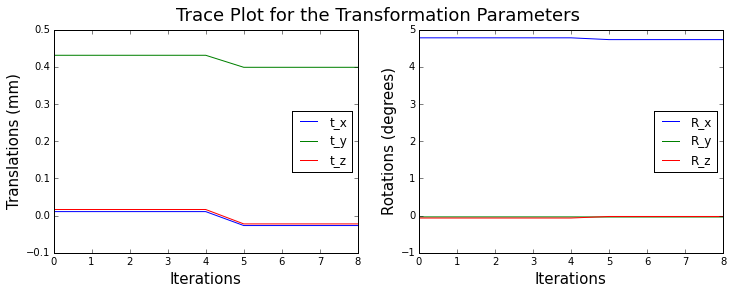

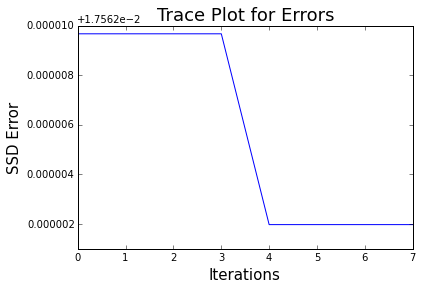

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  89
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

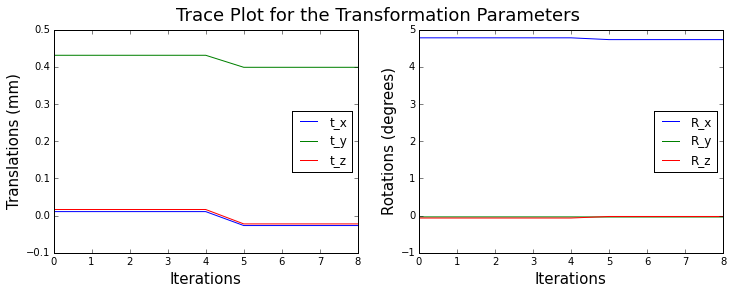

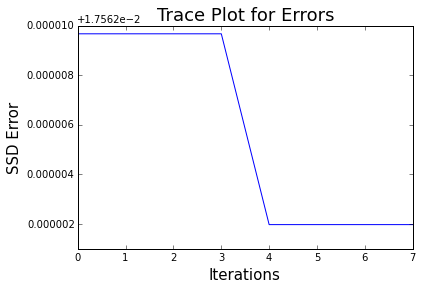

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  90
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

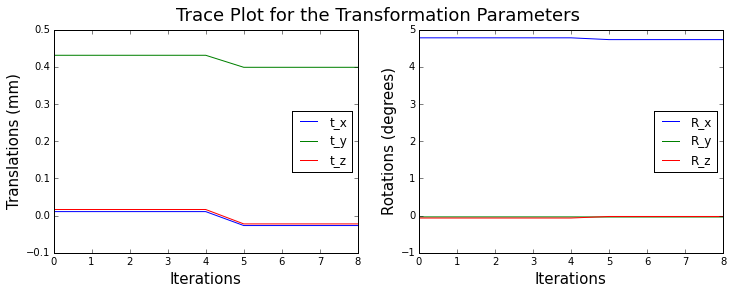

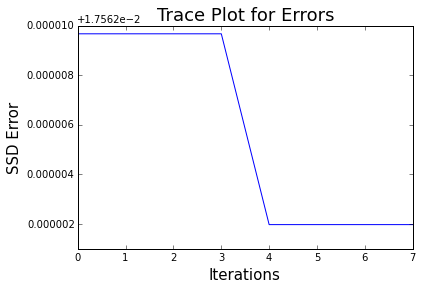

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  91
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

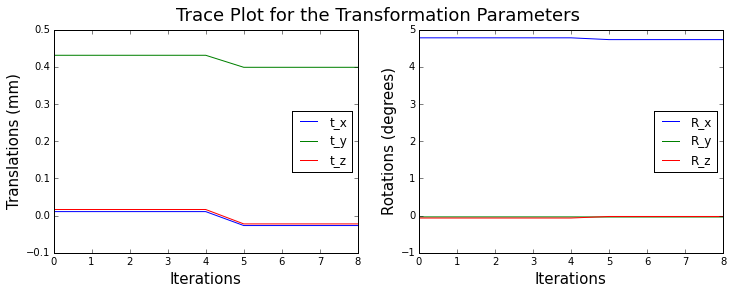

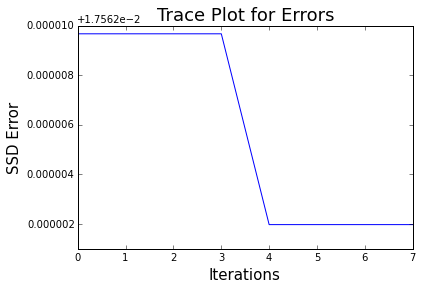

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  92
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

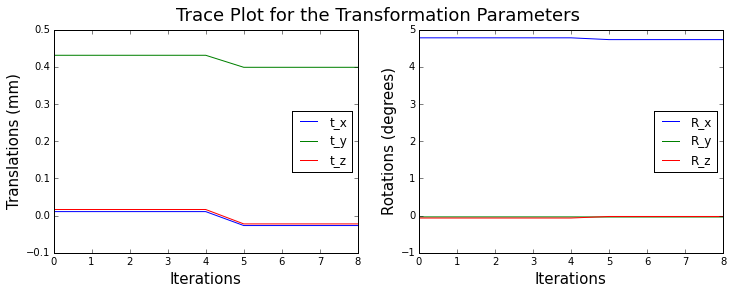

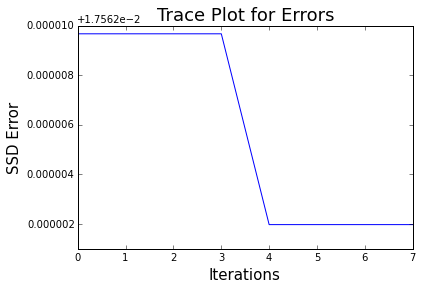

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  93
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

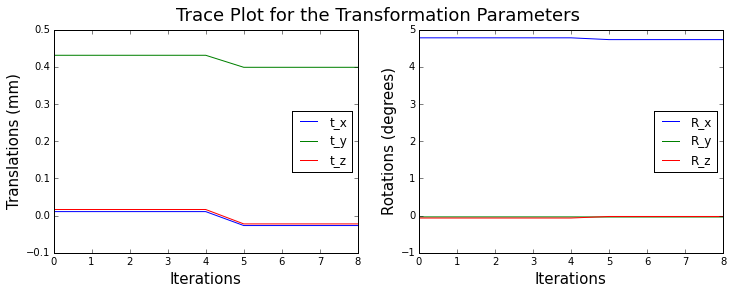

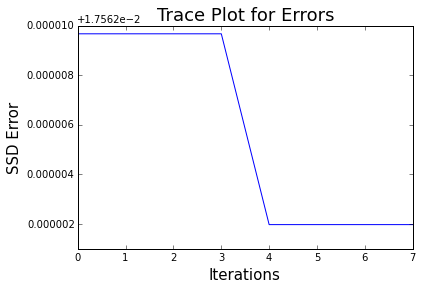

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  94
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

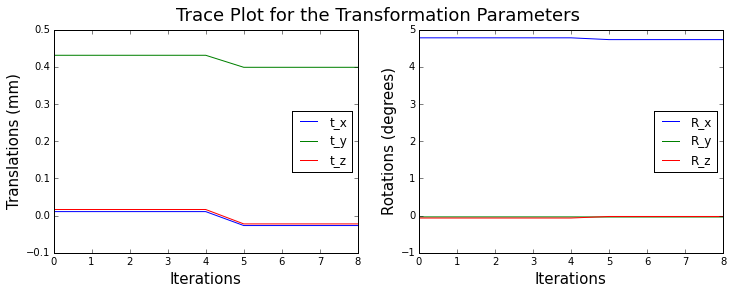

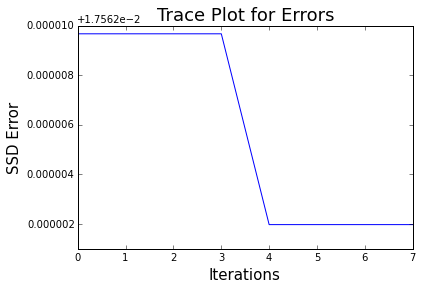

 min error: 0.0175639752439
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  95
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

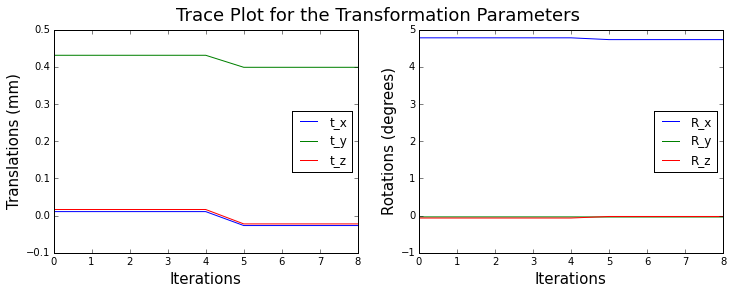

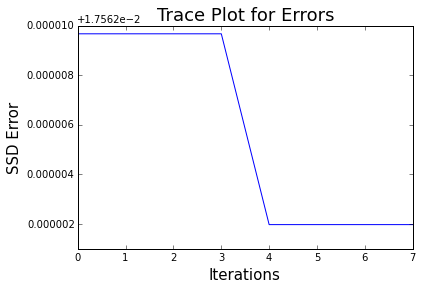

 min error: 0.017563975244
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  96
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

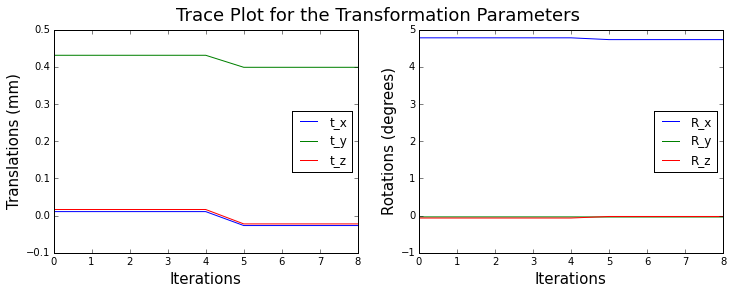

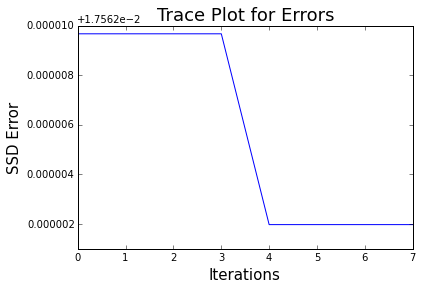

 min error: 0.017563975244
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  97
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

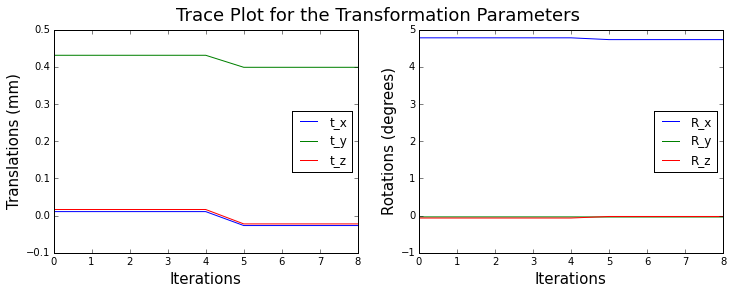

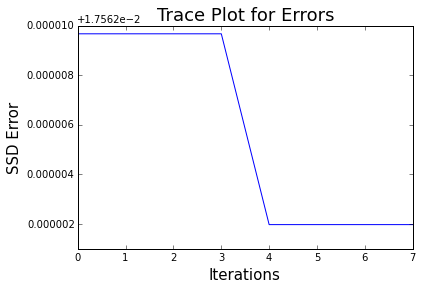

 min error: 0.017563975244
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  98
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

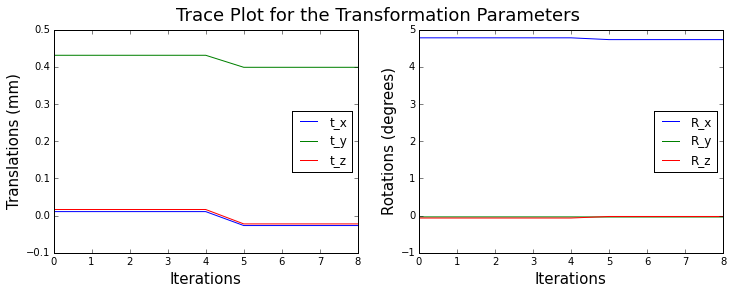

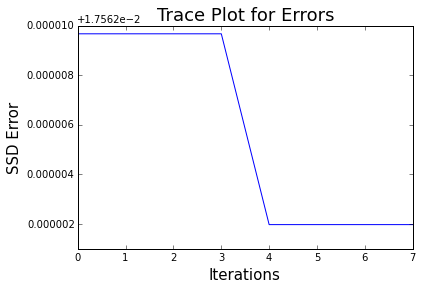

 min error: 0.017563975244
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
c =  99
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

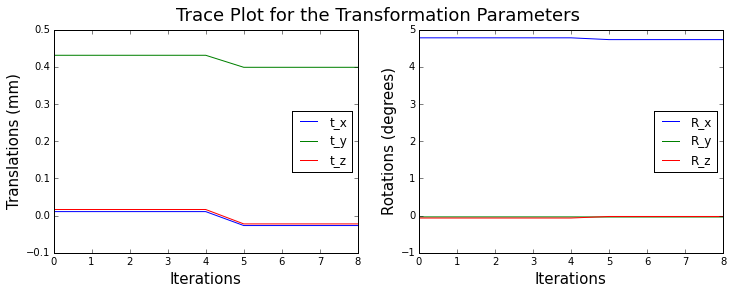

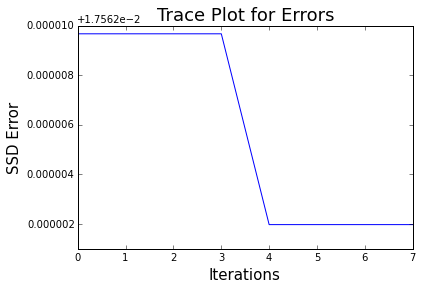

 min error: 0.017563975244
translations: [-0.02674244  0.39865524 -0.02232943] rotations: [ 4.73089396 -0.03768053 -0.02366705]
CPU times: user 13min 25s, sys: 9min 38s, total: 23min 4s
Wall time: 11min 42s


In [14]:
%%time
c_errors = []
c_errors.append(error)
for c in xrange(1,100):
    print 'c = ', c
    w = Tukeys_Biweight(R,c)
    W = np.diag(w)
    P_new, R_new, err = Gauss_Newton_IRLS(testVol1_masked, vol1_dervs, testVol2, vol2_dervs, W,
                             divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                             P_initial = P, max_iter = 15, mask = True)
    c_errors.append(err)
    print 'translations:', P_new[:3]*8, 'rotations:',P_new[3:]*180/np.pi

//anaconda/lib/python2.7/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


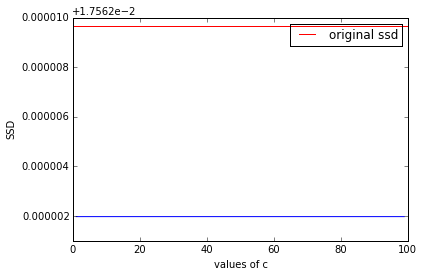

In [15]:
c_ls = np.arange(1,100)
plt.plot(c_ls, c_errors[1:])
plt.hlines(c_errors[0],0,100,'red',label='original ssd')
plt.xlabel('values of c')
plt.ylabel('SSD')
plt.legend(loc='best')
plt.show()

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

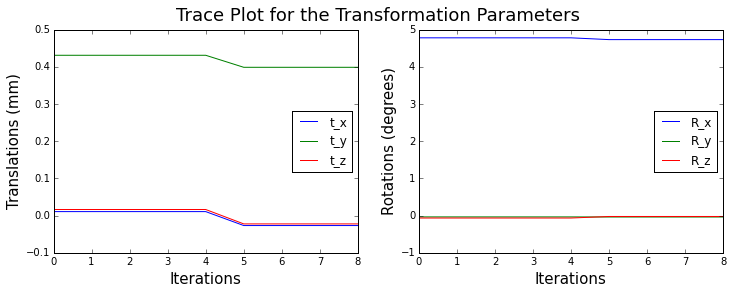

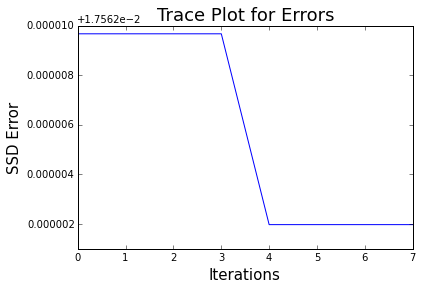

 min error: 0.0175639746423
translations: [-0.02674065  0.39865604 -0.02232846] rotations: [ 4.73089464 -0.03768058 -0.02366956]
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

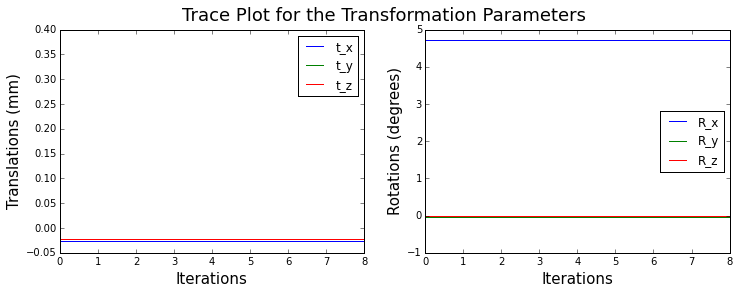

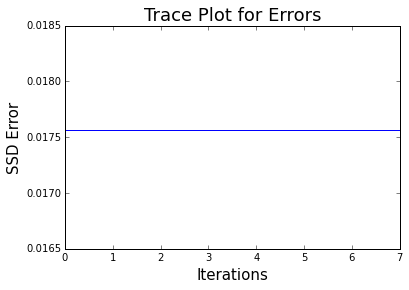

 min error: 0.0175639746423
translations: [-0.02674065  0.39865604 -0.02232846] rotations: [ 4.73089464 -0.03768058 -0.02366956]
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

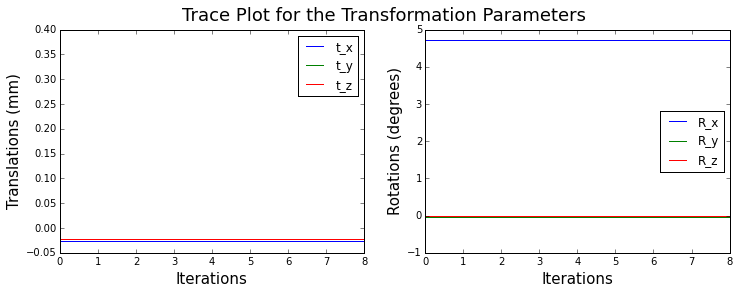

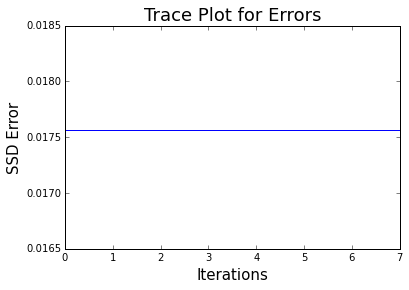

 min error: 0.0175639746423
translations: [-0.02674065  0.39865604 -0.02232846] rotations: [ 4.73089464 -0.03768058 -0.02366956]
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

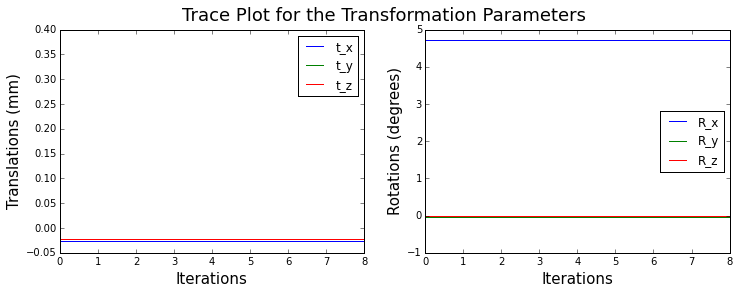

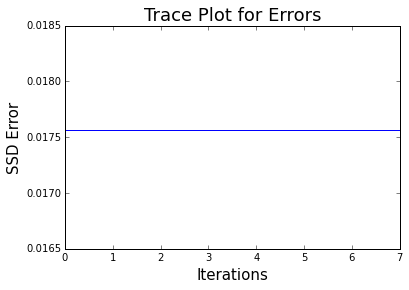

 min error: 0.0175639746423
translations: [-0.02674065  0.39865604 -0.02232846] rotations: [ 4.73089464 -0.03768058 -0.02366956]
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

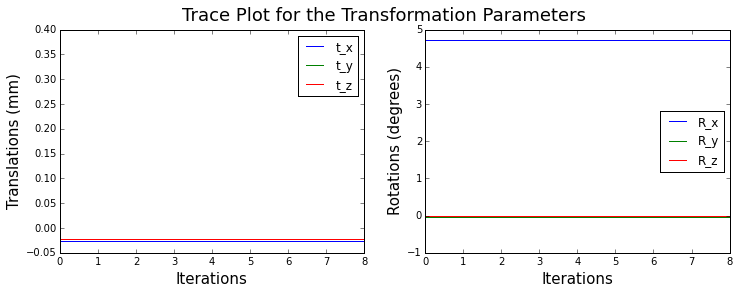

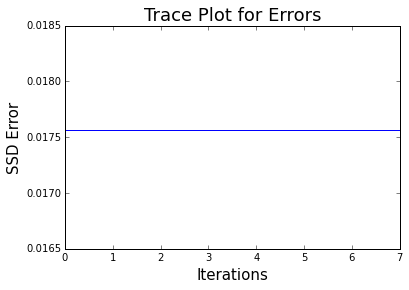

 min error: 0.0175639746423
translations: [-0.02674065  0.39865604 -0.02232846] rotations: [ 4.73089464 -0.03768058 -0.02366956]
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

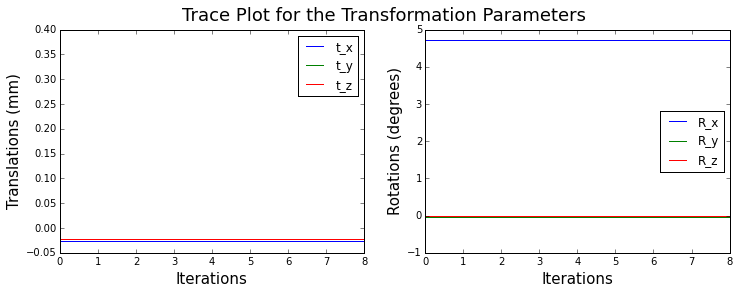

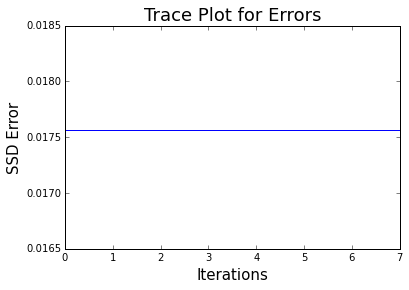

 min error: 0.0175639746423
translations: [-0.02674065  0.39865604 -0.02232846] rotations: [ 4.73089464 -0.03768058 -0.02366956]
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

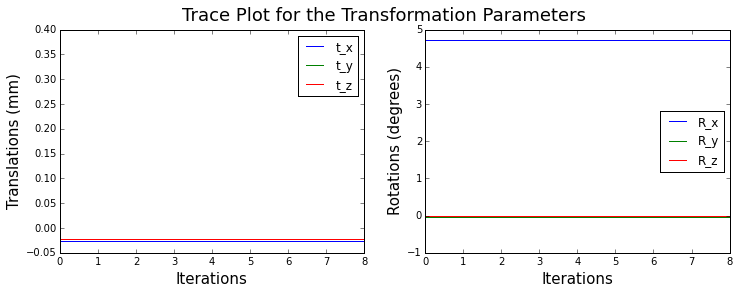

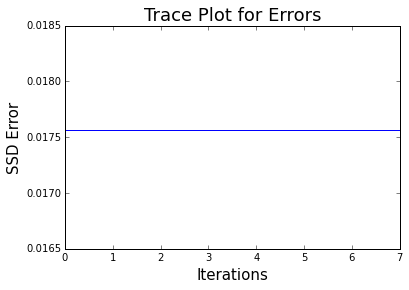

 min error: 0.0175639746423
translations: [-0.02674065  0.39865604 -0.02232846] rotations: [ 4.73089464 -0.03768058 -0.02366956]
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

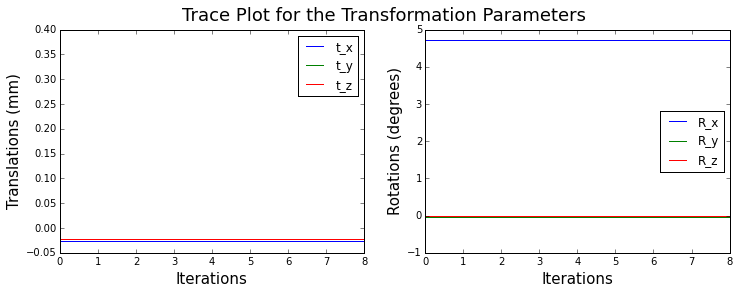

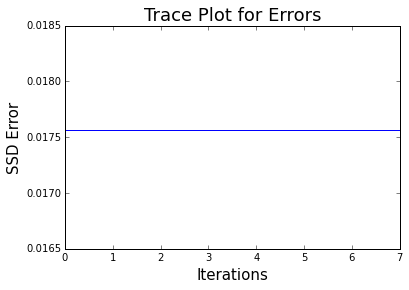

 min error: 0.0175639746423
translations: [-0.02674065  0.39865604 -0.02232846] rotations: [ 4.73089464 -0.03768058 -0.02366956]
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

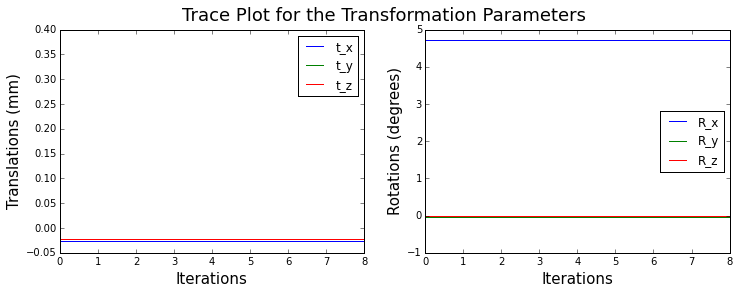

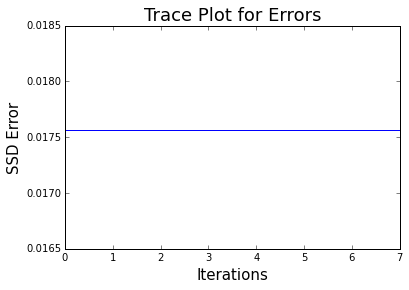

 min error: 0.0175639746423
translations: [-0.02674065  0.39865604 -0.02232846] rotations: [ 4.73089464 -0.03768058 -0.02366956]
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

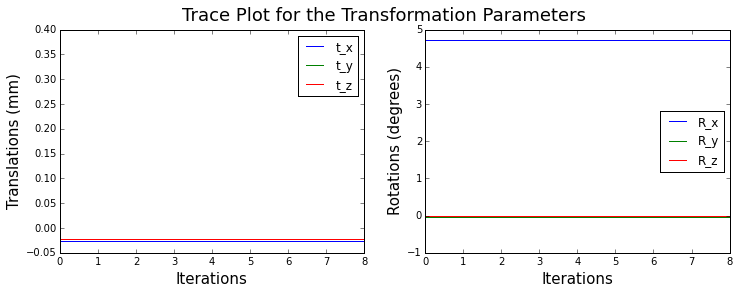

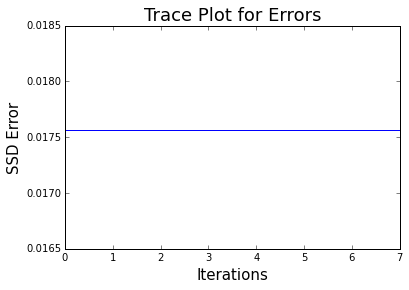

 min error: 0.0175639746423
translations: [-0.02674065  0.39865604 -0.02232846] rotations: [ 4.73089464 -0.03768058 -0.02366956]
CPU times: user 1min 26s, sys: 1min 1s, total: 2min 28s
Wall time: 1min 22s


In [105]:
%%time

errors = []
errors.append(error)
c = 1
for i in xrange(10):
    w = Tukeys_Biweight(R,c)
    W = np.diag(w)
    P, R, err = Gauss_Newton_IRLS(testVol1_masked, vol1_dervs, testVol2, vol2_dervs, W,
                             divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                             P_initial = P, max_iter = 15, mask = True)
    errors.append(err)
    print 'translations:', P[:3]*8, 'rotations:',P[3:]*180/np.pi

###  Initial IRLS using unmasked volumes

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19

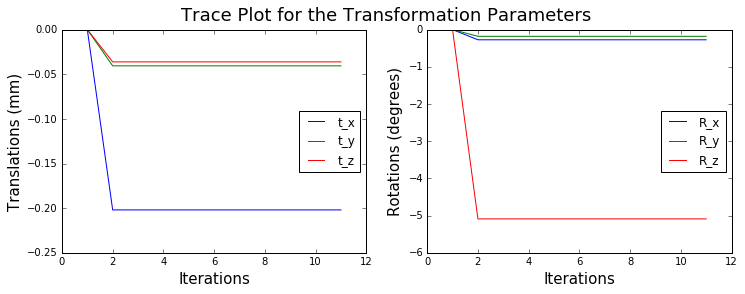

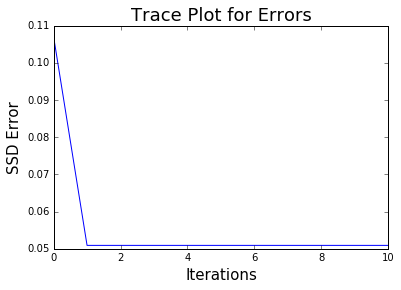

 min error: 0.0509196797227
translations: [-0.2019664  -0.0406084  -0.03616002] rotations: [-0.27405924 -0.18038399 -5.08848377]


In [37]:
## No masking
w = np.eye(s0*s1*s2)
P, R, error = Gauss_Newton_IRLS(testVol1, vol1_dervs, testVol2, vol2_dervs, w,
                         d=0.4, divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                         max_iter = 20, mask = False)
print 'translations:', P[:3]*8, 'rotations:',P[3:]*180/np.pi

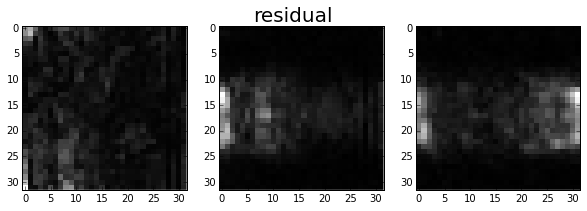

In [117]:
from visualize import plot_volume
residual = R.reshape([32,32,32])
plot_volume(residual,'residual')

### try IRLS without masking the volumes

In [118]:
mad_r = MAD(R)
if mad_r != 0:
    print 'MAD: ', mad_r
    R = (1./mad_r)*R

MAD:  0.000423615256875


In [57]:
msk = (residual < (mad_r + 1e-4)) & (residual > (mad_r - 1e-4))
np.sum(msk)

2028

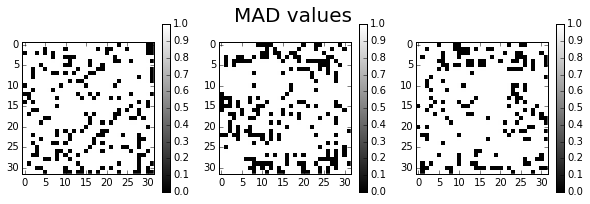

In [97]:
# black voxels are the ones that are close to the comptued MAD value
plot_volume(msk,'MAD values',colorbar=True)

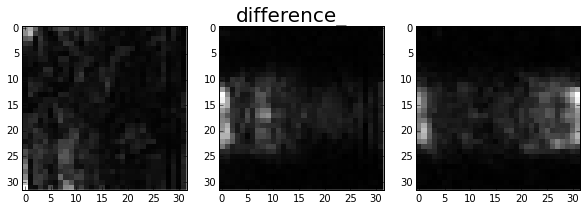

In [31]:
plot_volume(residual - mad_r,'difference')

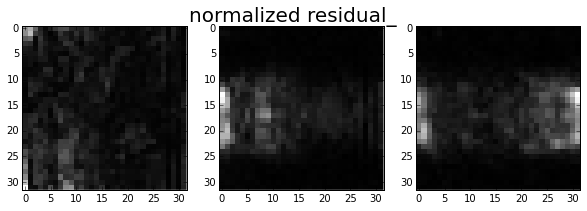

In [28]:
residual_normed = R.reshape([32,32,32])
plot_volume(residual_normed,'normalized residual')

c =  6
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 Converged in 14 iterations!


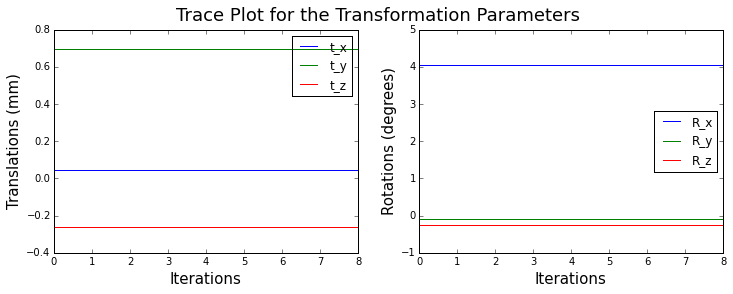

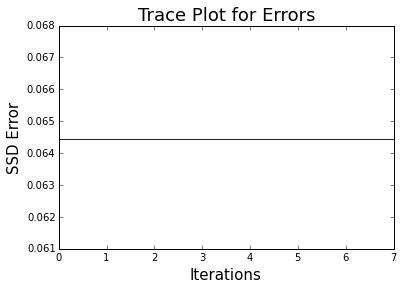

min error: 0.064450108099
translations: [ 0.04449146  0.69620283 -0.26078382] rotations: [ 4.03682655 -0.08811557 -0.24787218]


In [115]:
c = 6
print 'c = ', c
w = Tukeys_Biweight(R,c)
W = np.diag(w)
P_new, R_new, err = Gauss_Newton_IRLS(testVol1, vol1_dervs, testVol2, vol2_dervs, W,
                         divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                         P_initial = P, max_iter = 15, mask = False)
print 'translations:', P_new[:3]*8, 'rotations:',P_new[3:]*180/np.pi

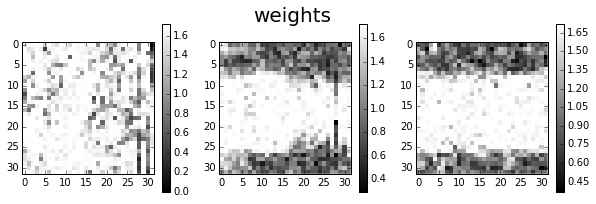

In [100]:
w_matrix = w.reshape([32,32,32])
plot_volume(w_matrix ,'weights', colorbar = True)

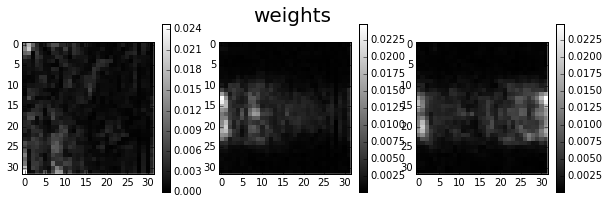

In [101]:
plot_volume(R_new.reshape([32,32,32]) ,'weights', colorbar = True)

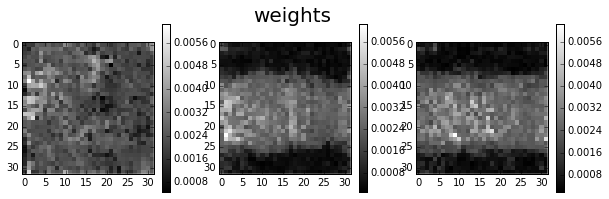

In [102]:
plot_volume(w_matrix*R_new.reshape([32,32,32]),'weights',colorbar = True)

c =  1
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

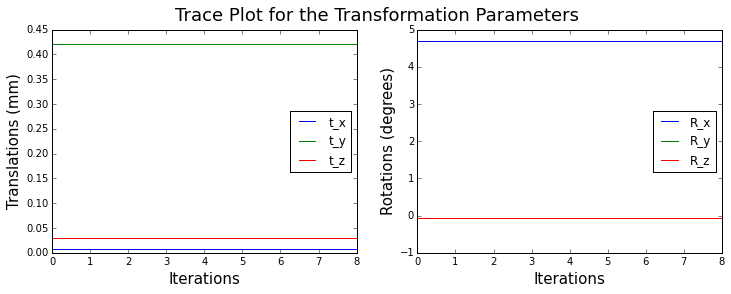

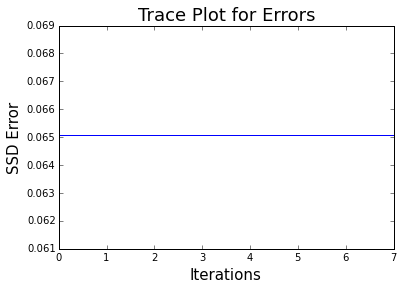

 min error: 0.0650799607079
translations: [ 0.00780941  0.42181283  0.02920091] rotations: [ 4.68139183 -0.05220989 -0.07089152]
c =  2
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

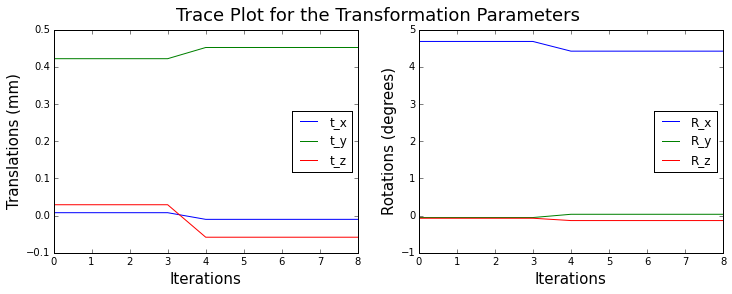

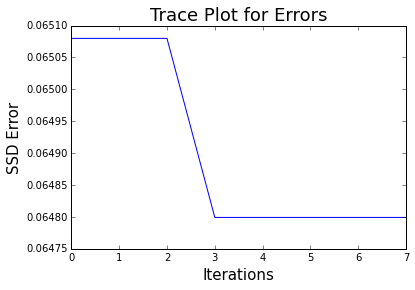

 min error: 0.0647991893789
translations: [-0.01008852  0.45188903 -0.05811417] rotations: [ 4.42061463  0.03547272 -0.13331106]
c =  3
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

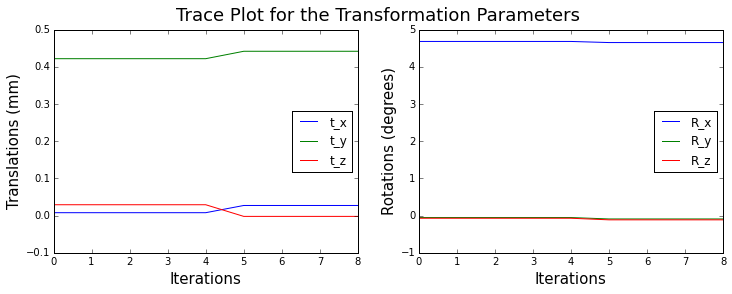

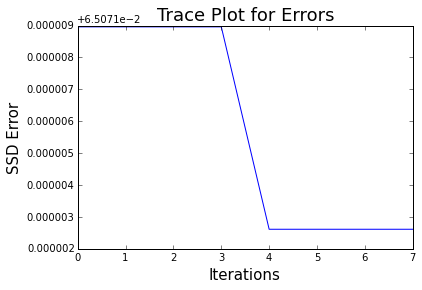

 min error: 0.0650736128936
translations: [ 0.02721862  0.44174477 -0.00212576] rotations: [ 4.65177652 -0.09019494 -0.11395126]
c =  4
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

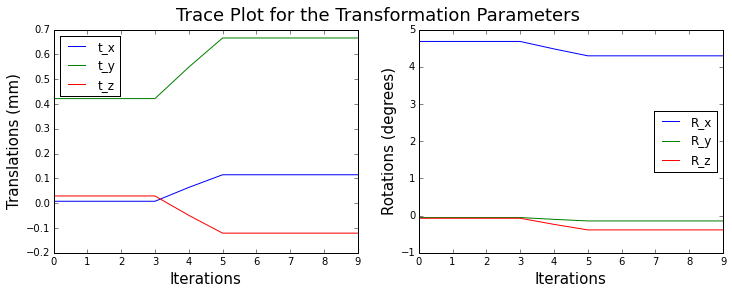

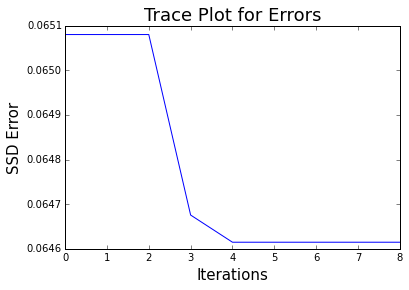

 min error: 0.0646147306907
translations: [ 0.11470682  0.66622777 -0.12071998] rotations: [ 4.29489655 -0.14346549 -0.38474325]
c =  5
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

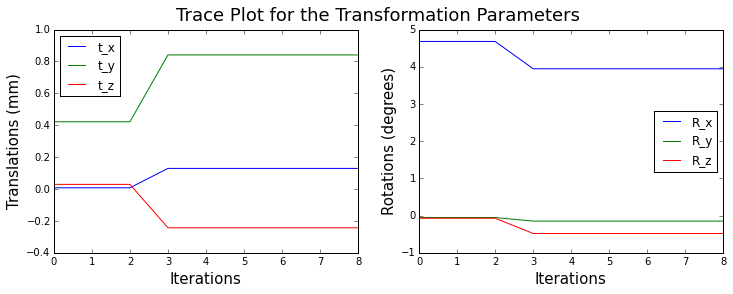

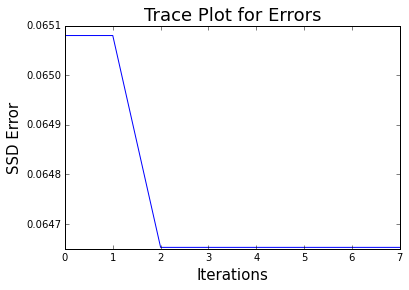

 min error: 0.0646528741882
translations: [ 0.129378    0.84122739 -0.24315921] rotations: [ 3.94644521 -0.14817852 -0.48098132]
c =  6
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

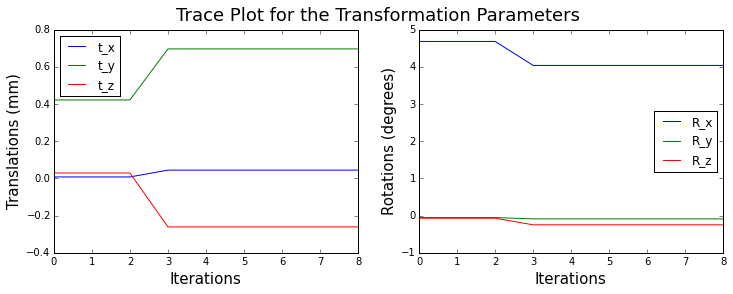

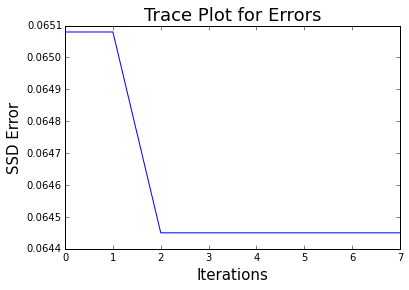

 min error: 0.064450108099
translations: [ 0.04449146  0.69620283 -0.26078382] rotations: [ 4.03682655 -0.08811557 -0.24787218]
c =  7
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

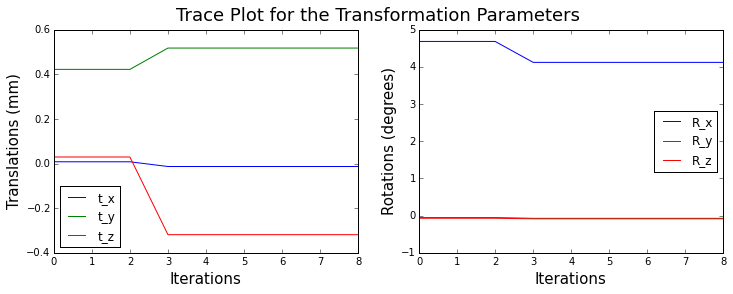

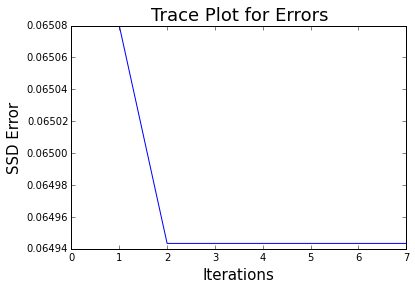

 min error: 0.0649433823187
translations: [-0.01338883  0.51728178 -0.31882873] rotations: [ 4.11894119 -0.07322999 -0.08659906]
c =  8
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

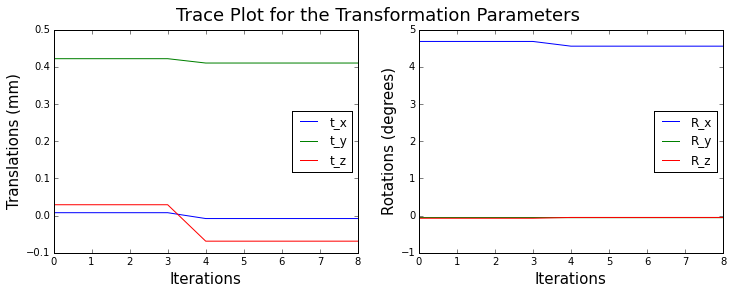

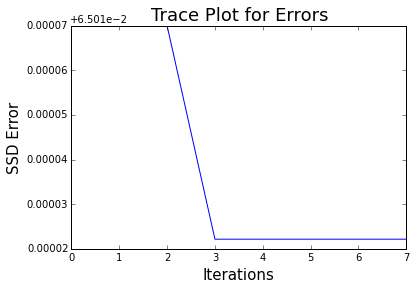

 min error: 0.0650321533754
translations: [-0.00792596  0.41012677 -0.0687267 ] rotations: [ 4.55465091 -0.05558599 -0.04947875]
c =  9
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

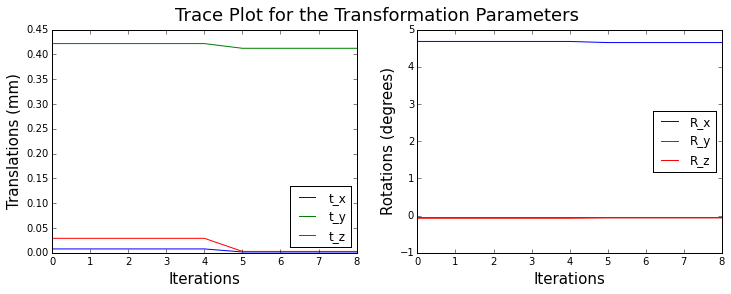

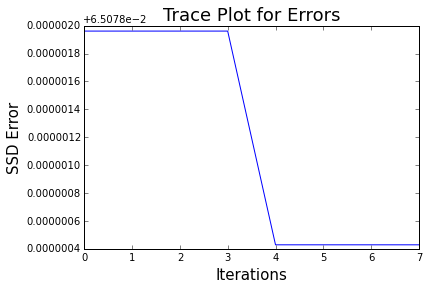

 min error: 0.0650784285976
translations: [ 0.00169241  0.412312    0.00280571] rotations: [ 4.65128349 -0.05295113 -0.06170367]
c =  10
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

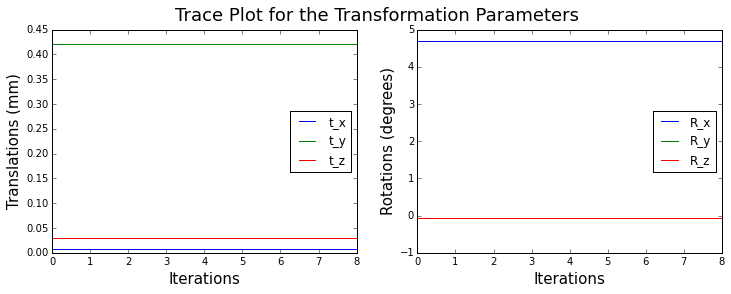

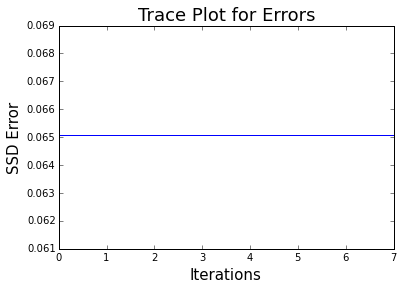

 min error: 0.0650799607079
translations: [ 0.00780941  0.42181283  0.02920091] rotations: [ 4.68139183 -0.05220989 -0.07089152]
c =  11
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

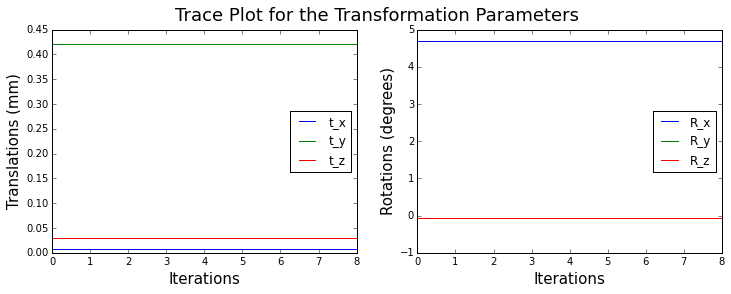

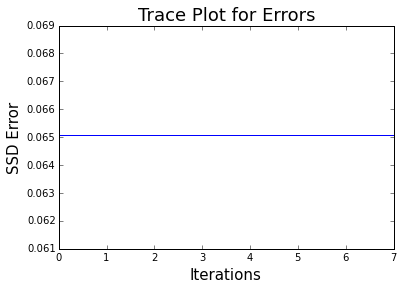

 min error: 0.0650799607079
translations: [ 0.00780941  0.42181283  0.02920091] rotations: [ 4.68139183 -0.05220989 -0.07089152]
c =  12
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

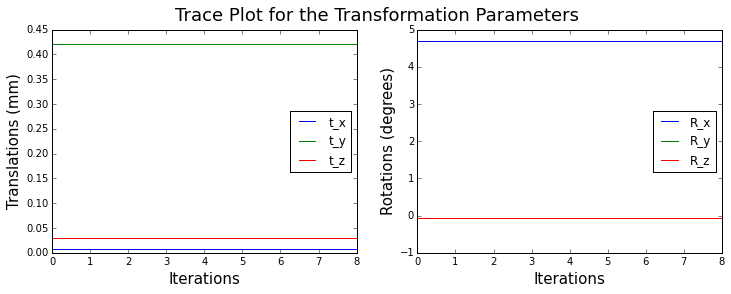

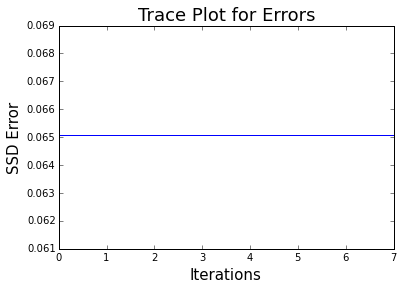

 min error: 0.0650799607079
translations: [ 0.00780941  0.42181283  0.02920091] rotations: [ 4.68139183 -0.05220989 -0.07089152]
c =  13
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

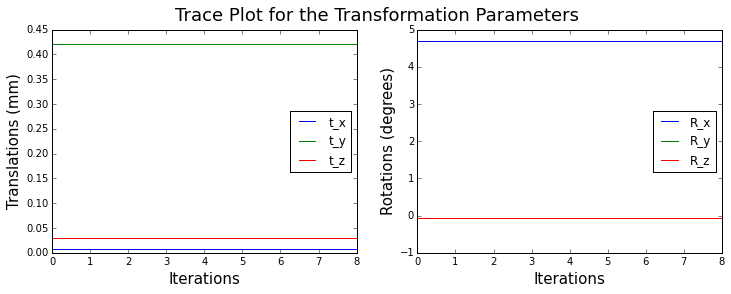

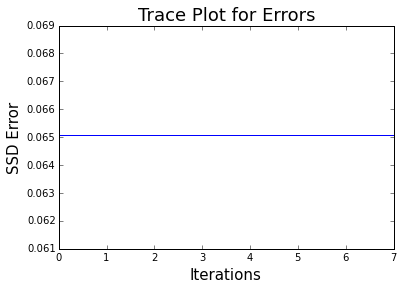

 min error: 0.0650799607079
translations: [ 0.00780941  0.42181283  0.02920091] rotations: [ 4.68139183 -0.05220989 -0.07089152]
c =  14
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

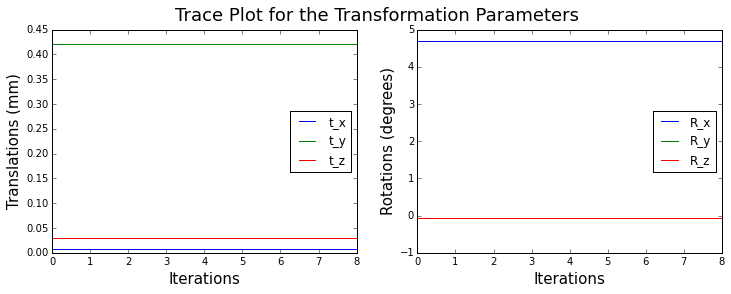

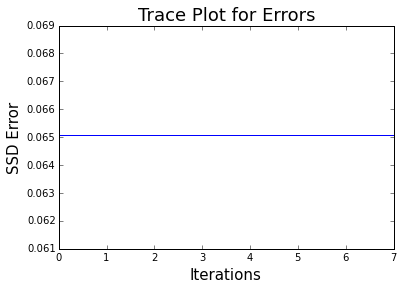

 min error: 0.0650799607079
translations: [ 0.00780941  0.42181283  0.02920091] rotations: [ 4.68139183 -0.05220989 -0.07089152]
CPU times: user 1min 54s, sys: 1min 24s, total: 3min 19s
Wall time: 1min 49s


In [87]:
%%time
## Try different values of c
c_errors = []
c_errors.append(error)
c_ls = np.arange(1,15,1)

for c in c_ls:
    print 'c = ', c
    w = Tukeys_Biweight(R,c)
    W = np.diag(w)
    P_new, R_new, err = Gauss_Newton_IRLS(testVol1, vol1_dervs, testVol2, vol2_dervs, W,
                             divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                             P_initial = P, max_iter = 15, mask = False)
    c_errors.append(err)
    print 'translations:', P_new[:3]*8, 'rotations:',P_new[3:]*180/np.pi

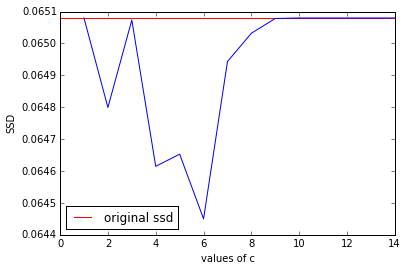

In [95]:
c_ls = np.arange(1,15,1)
plt.plot(c_ls, c_errors[1:])
plt.hlines(c_errors[0],0,14,'red',label='original ssd')
plt.xlabel('values of c')
plt.ylabel('SSD')
plt.legend(loc='best')
plt.show()

In [123]:
aa = w.reshape([32,32,32]

In [128]:
w.shape

(32768, 32768)

0 MAD:  1.0


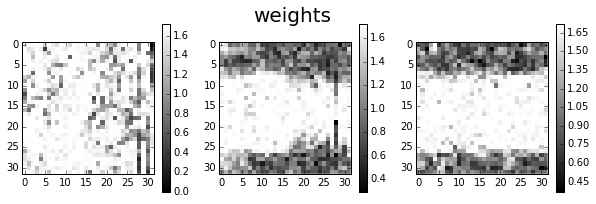

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

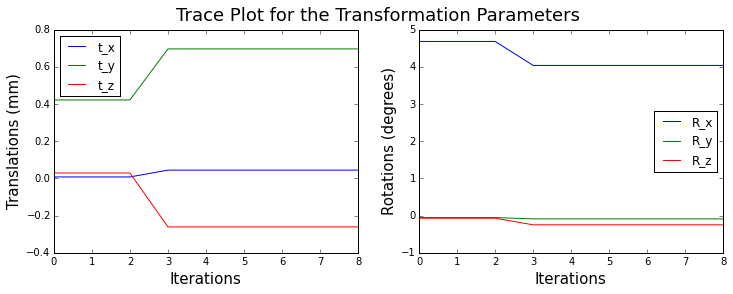

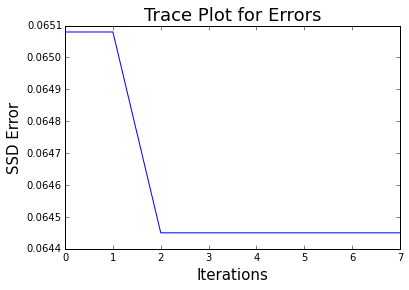

 min error: 0.064450108099
translations: [ 0.04449146  0.69620283 -0.26078382] rotations: [ 4.03682655 -0.08811557 -0.24787218]
1 MAD:  0.000423600406448


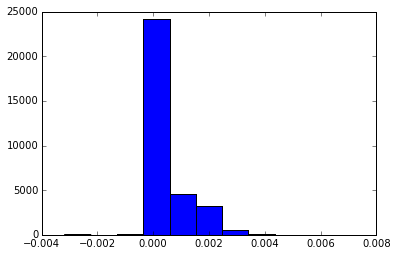

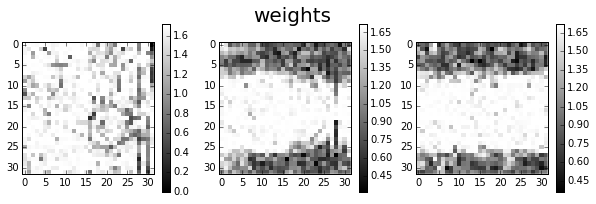

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 Converged in 14 iterations!


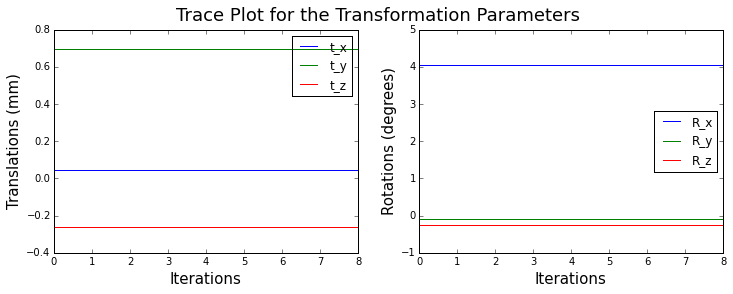

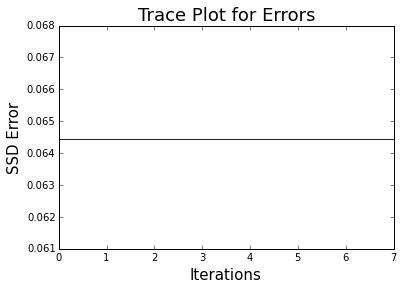

min error: 0.064450108099
translations: [ 0.04449146  0.69620283 -0.26078382] rotations: [ 4.03682655 -0.08811557 -0.24787218]
2 MAD:  0.000423630997491


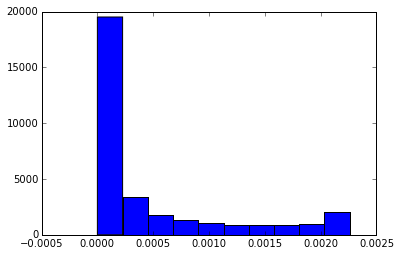

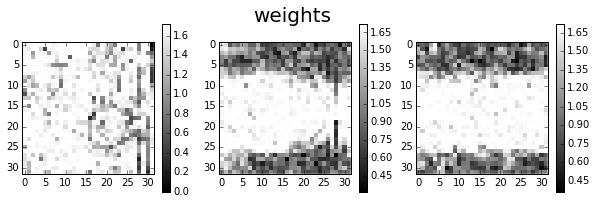

KeyboardInterrupt: 

In [114]:
%%time

errors = []
errors.append(error)
c = 6
mad_ls = []
for i in xrange(5):
    mad_r = MAD(R)
    mad_ls.append(mad_r)
    if mad_r != 0:
        print i,'MAD: ', mad_r
        R = (1./mad_r)*R
    w = Tukeys_Biweight(R,c)
    plot_volume(w.reshape([32,32,32]),'weights',colorbar=True)
    W = np.diag(w)
    P, R, err = Gauss_Newton_IRLS(testVol1, vol1_dervs, testVol2, vol2_dervs, W,
                             divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                             P_initial = P, max_iter = 15, mask = False)
    plt.hist(w*R,bins=50)
    plt.show()
    errors.append(err)
    print 'translations:', P[:3]*8, 'rotations:',P[3:]*180/np.pi

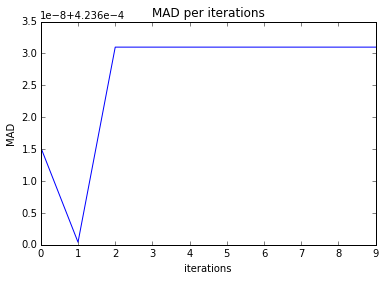

In [105]:
plt.plot(mad_ls)
plt.xlabel('iterations')
plt.ylabel('MAD')
plt.title('MAD per iterations')
plt.show()

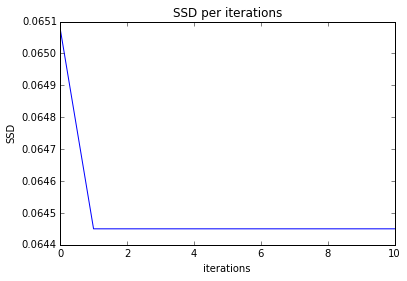

In [106]:
plt.plot(errors)
plt.xlabel('iterations')
plt.ylabel('SSD')
plt.title('SSD per iterations')
plt.show()

0 1 2 3 4 5 6 7 8 9 10 Converged in 10 iterations!


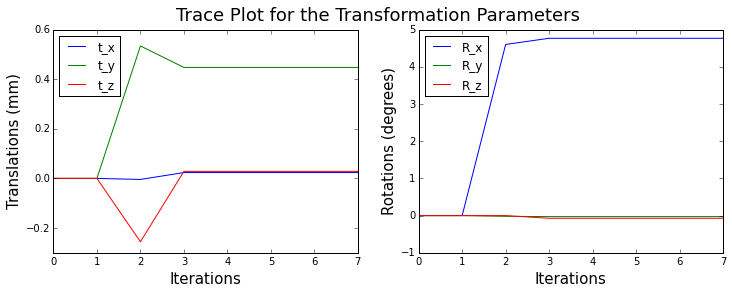

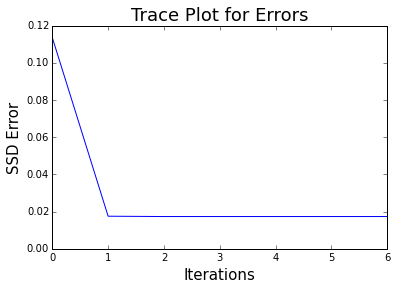

min error: 0.0173470077127
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
CPU times: user 9.16 s, sys: 6.86 s, total: 16 s
Wall time: 9.16 s


In [16]:
%%time
w = np.eye(s0*s1*s2)
P, R, error = Gauss_Newton_IRLS(testVol1_masked, vol1_dervs, testVol2, vol2_dervs, w,
                         divide_factor = 1., alpha = 1., decrease_factor = 0.25, 
                         max_iter = 15, mask = True)
print 'translations:', P[:3]*8, 'rotations:',P[3:]*180/np.pi

c =  1
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

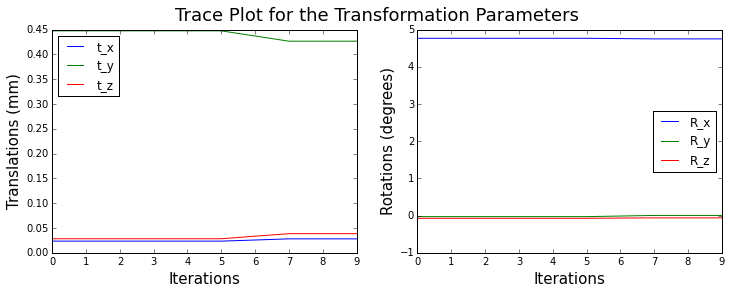

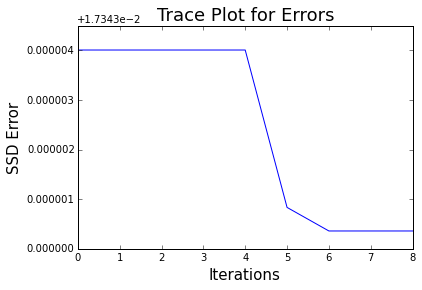

 min error: 0.0173433593713
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  2
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

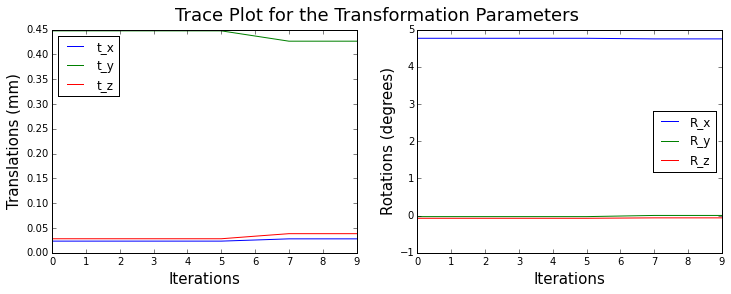

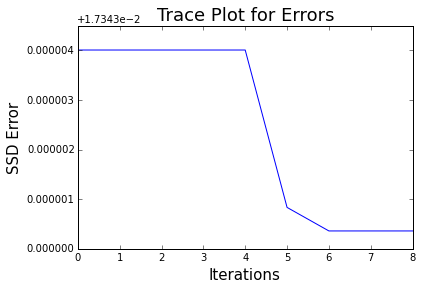

 min error: 0.017343359945
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  3
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

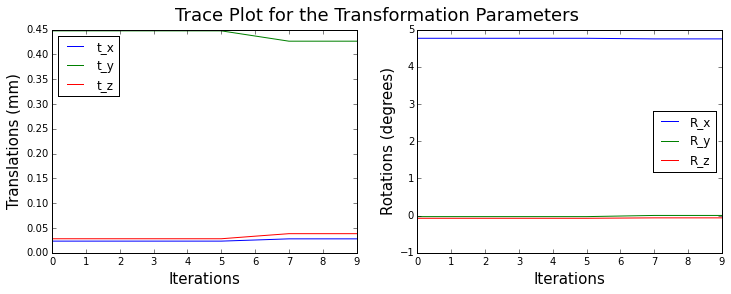

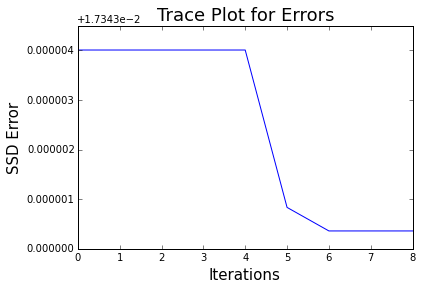

 min error: 0.0173433600513
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  4
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

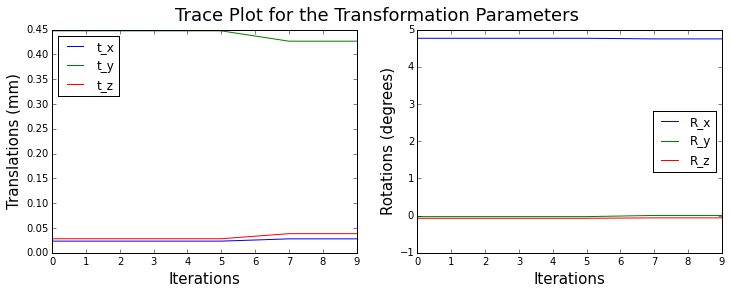

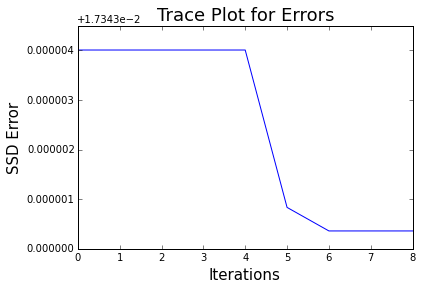

 min error: 0.0173433600884
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  5
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

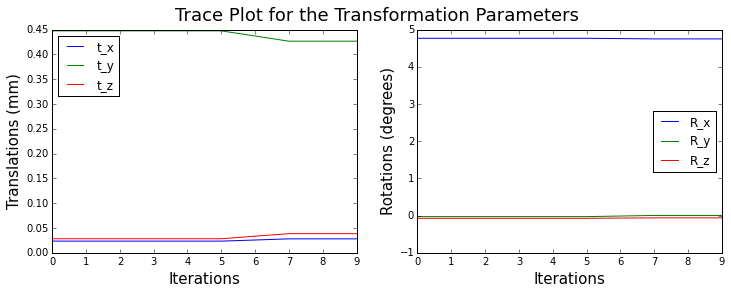

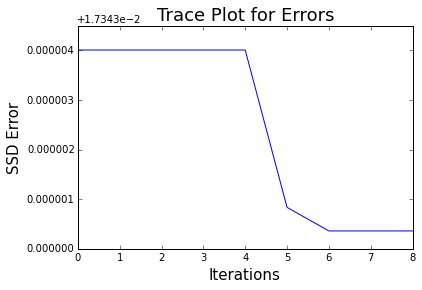

 min error: 0.0173433601057
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  6
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

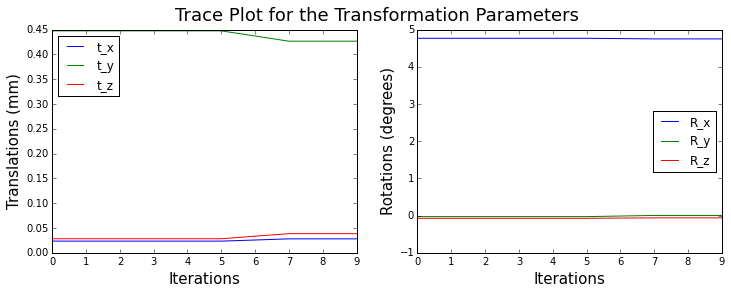

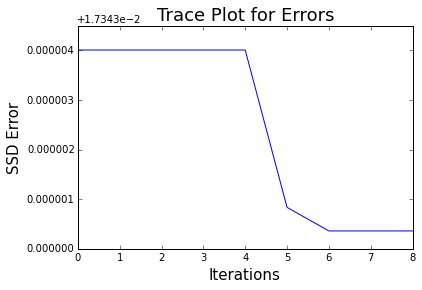

 min error: 0.017343360115
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  7
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

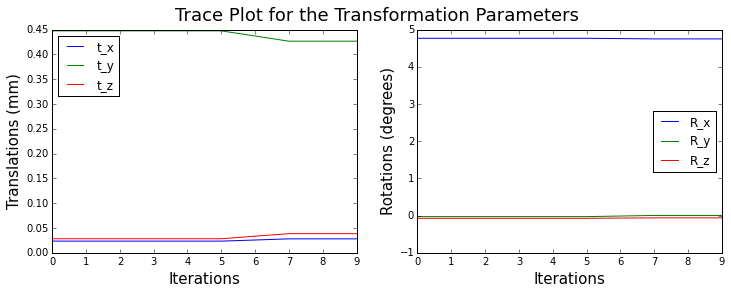

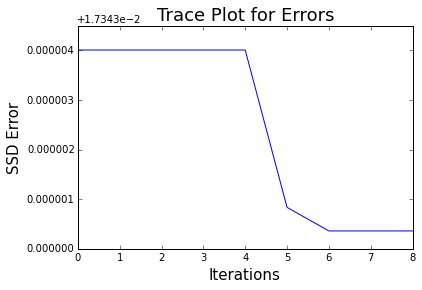

 min error: 0.0173433601207
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  8
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

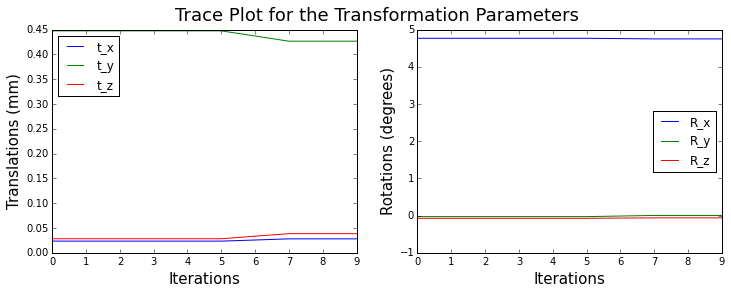

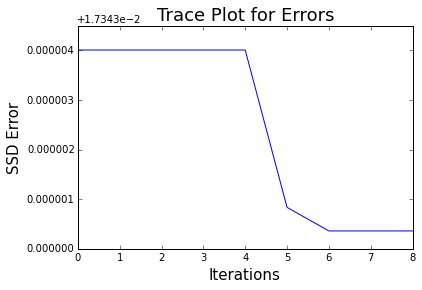

 min error: 0.0173433601243
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  9
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

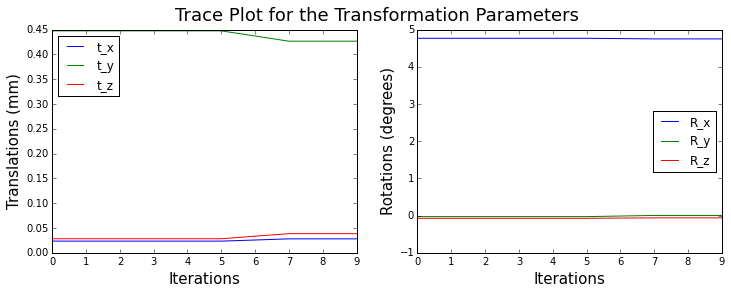

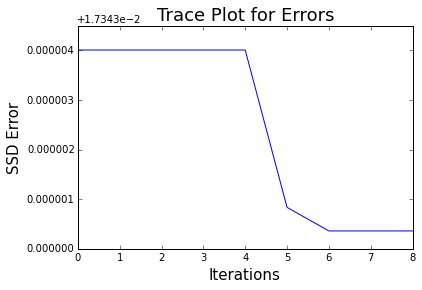

 min error: 0.0173433601268
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  10
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

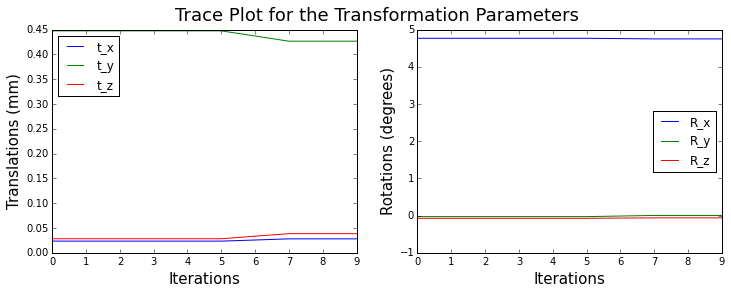

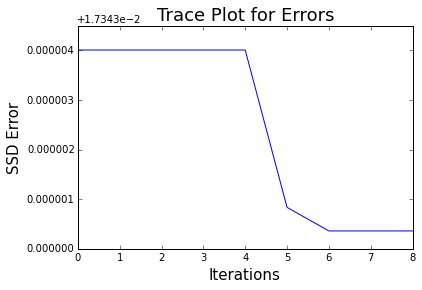

 min error: 0.0173433601286
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  11
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

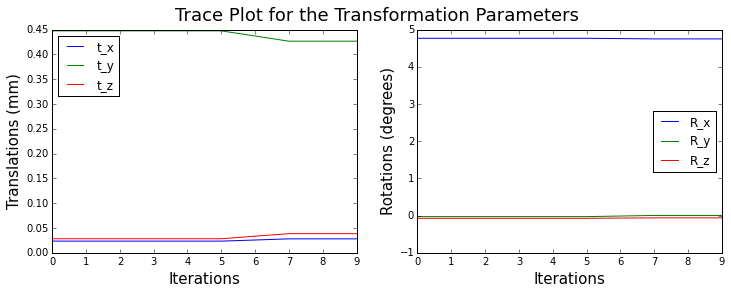

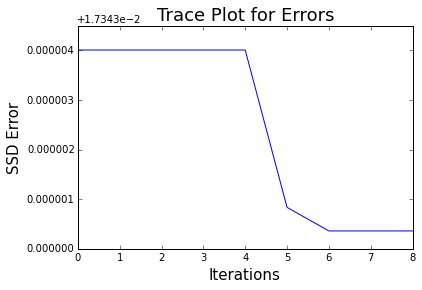

 min error: 0.0173433601299
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  12
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

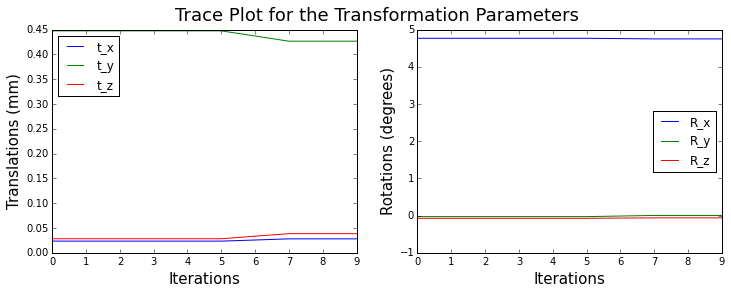

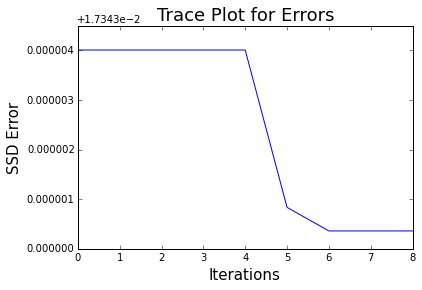

 min error: 0.017343360131
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  13
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

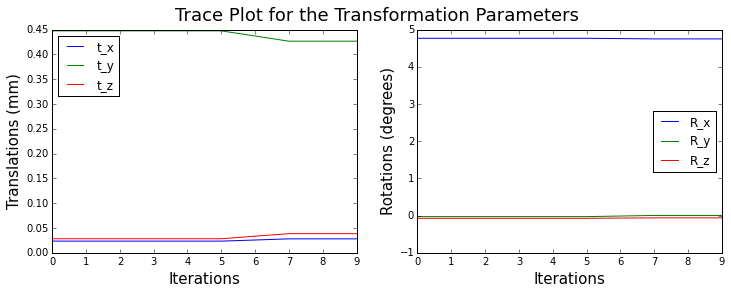

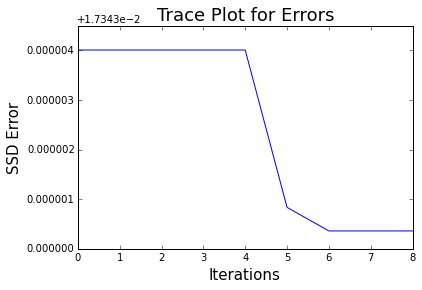

 min error: 0.0173433601317
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  14
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

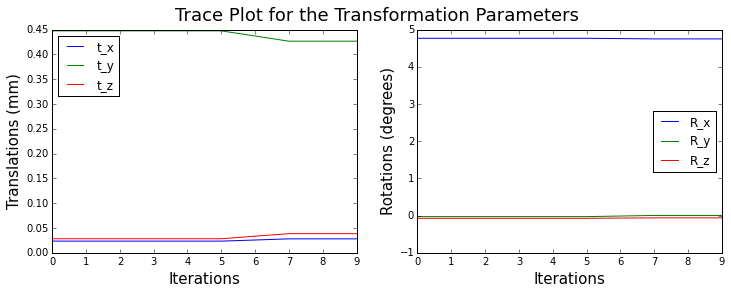

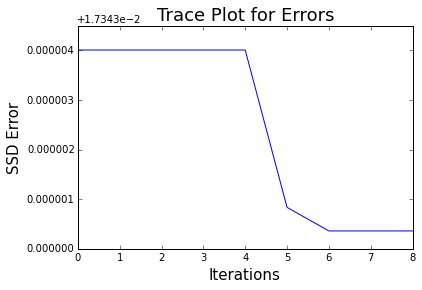

 min error: 0.0173433601324
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  15
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

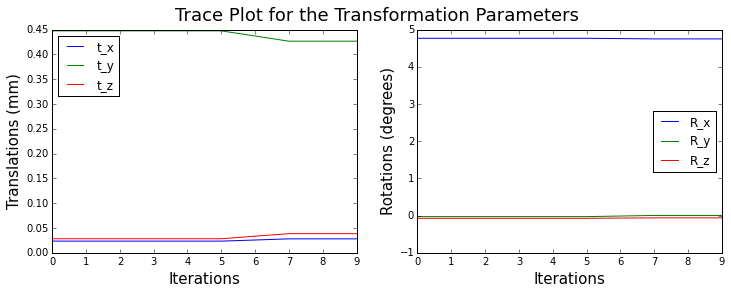

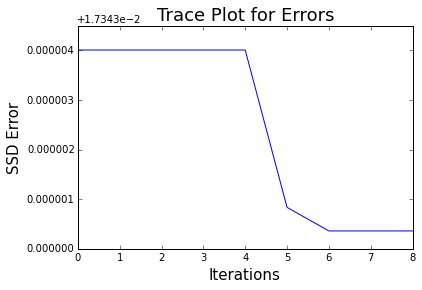

 min error: 0.0173433601329
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  16
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

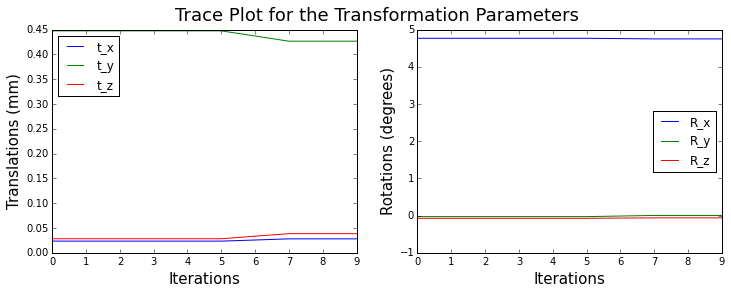

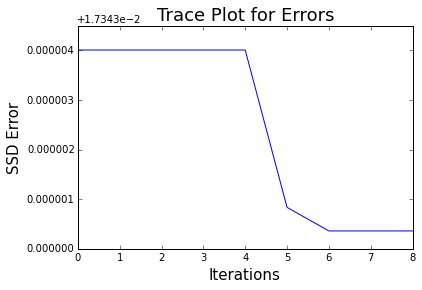

 min error: 0.0173433601333
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  17
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

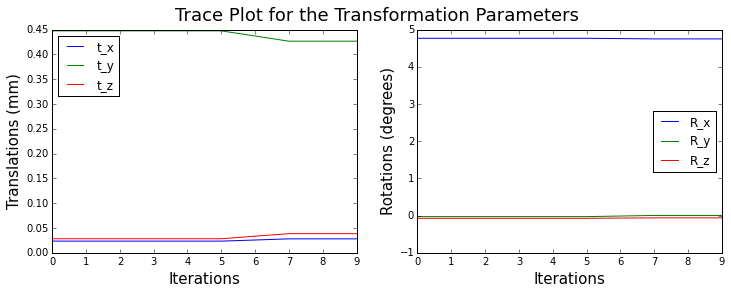

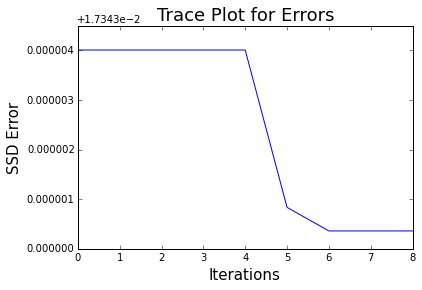

 min error: 0.0173433601336
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  18
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

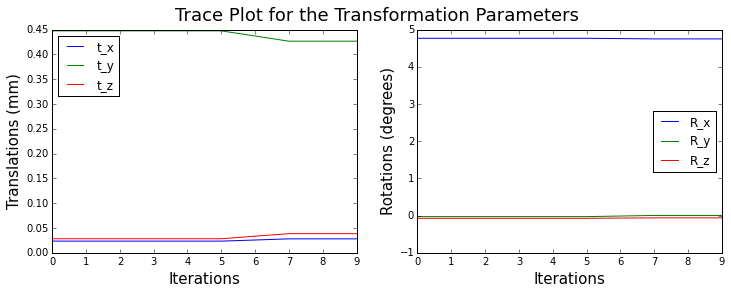

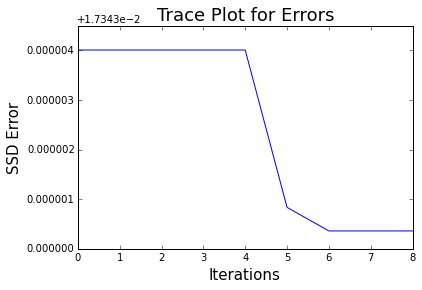

 min error: 0.0173433601339
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  19
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

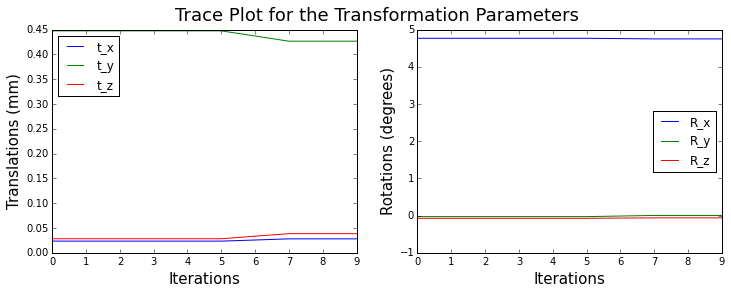

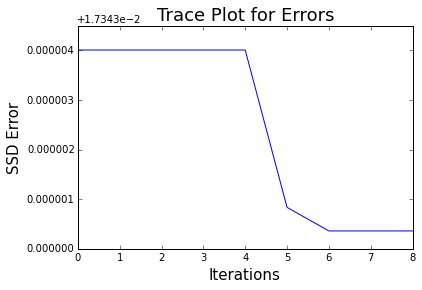

 min error: 0.0173433601341
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  20
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

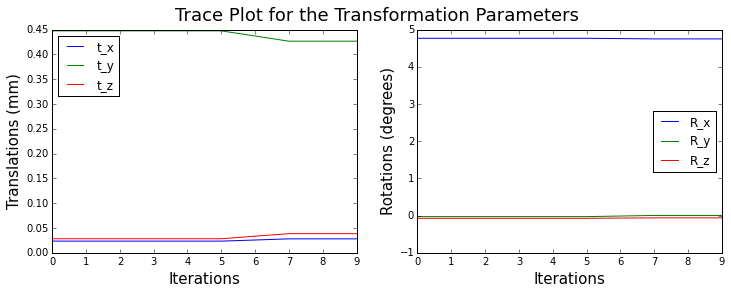

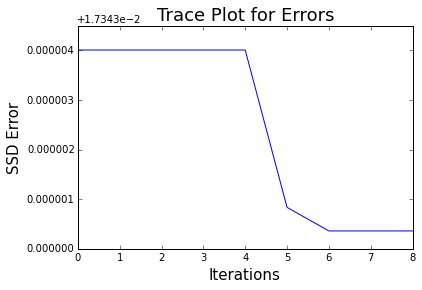

 min error: 0.0173433601344
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  21
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

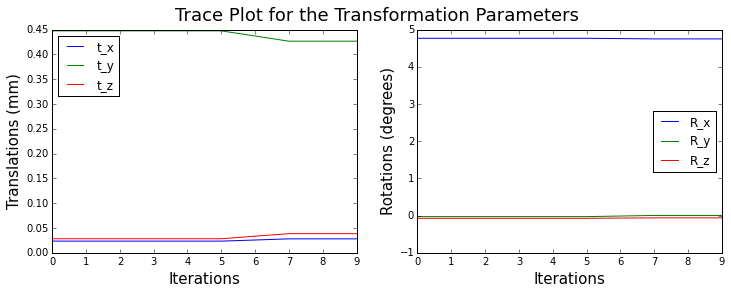

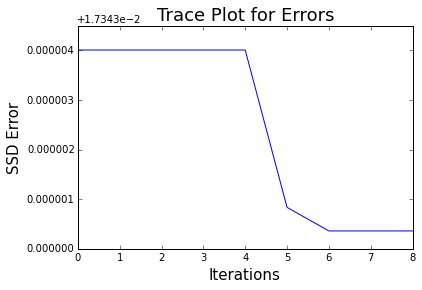

 min error: 0.0173433601345
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  22
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

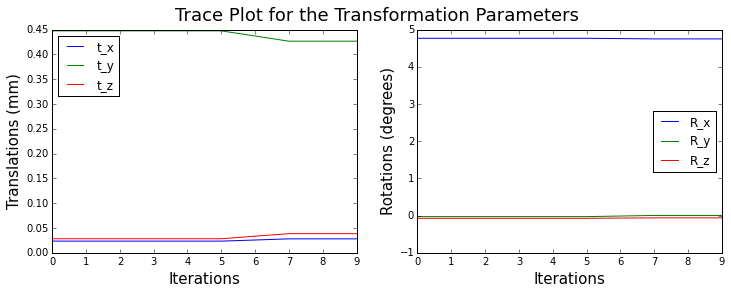

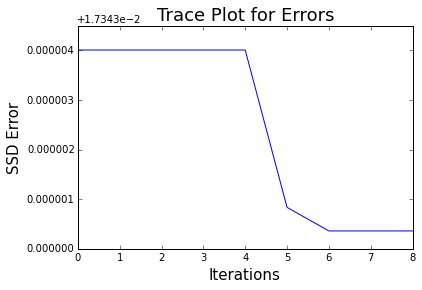

 min error: 0.0173433601347
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  23
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

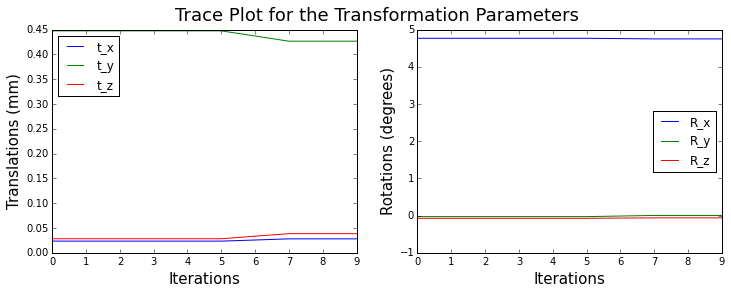

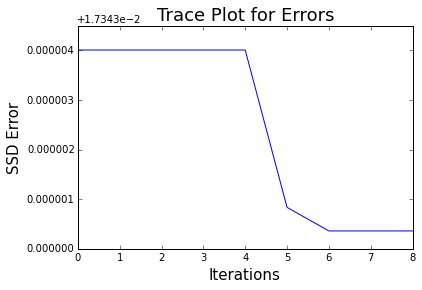

 min error: 0.0173433601348
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  24
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

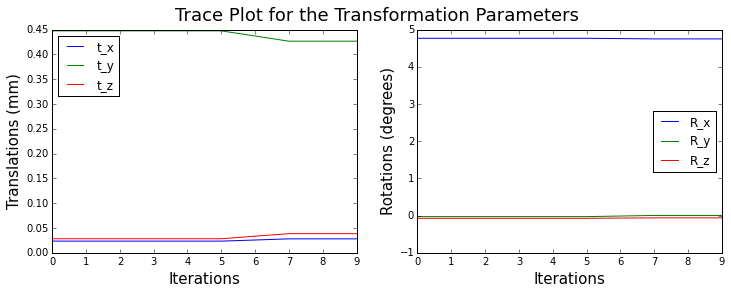

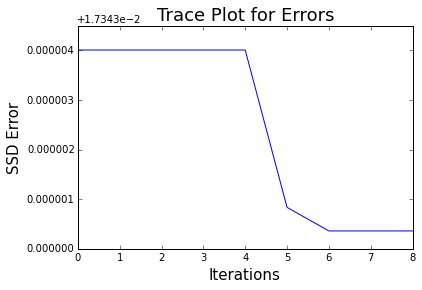

 min error: 0.0173433601349
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  25
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

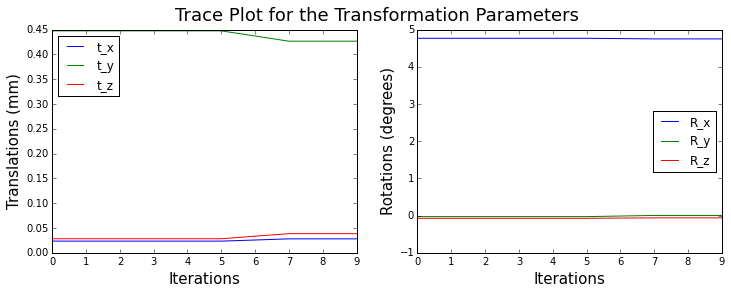

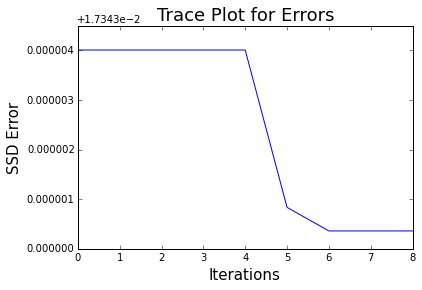

 min error: 0.017343360135
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  26
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

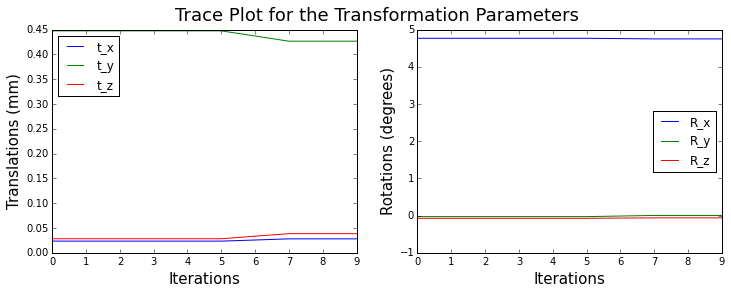

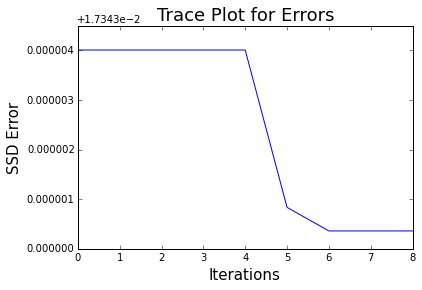

 min error: 0.0173433601351
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  27
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

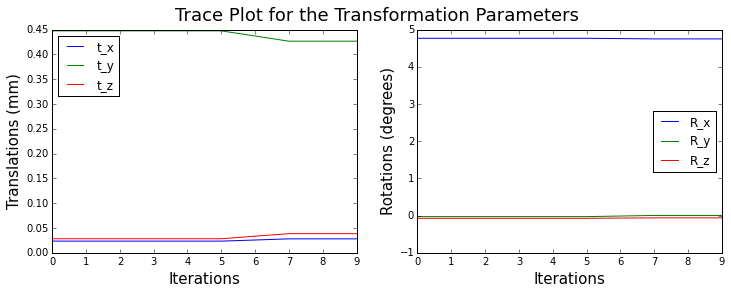

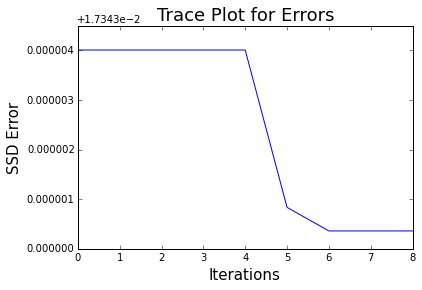

 min error: 0.0173433601352
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  28
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

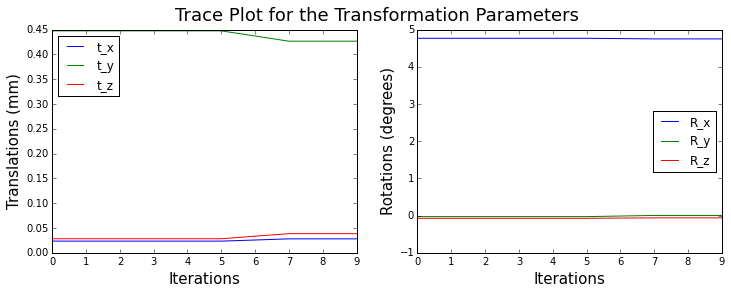

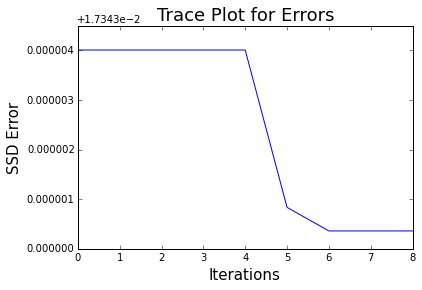

 min error: 0.0173433601353
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  29
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

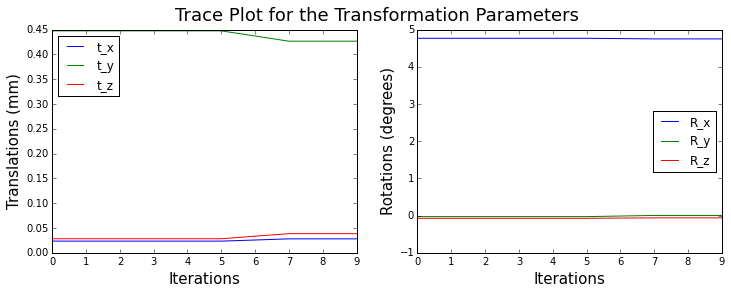

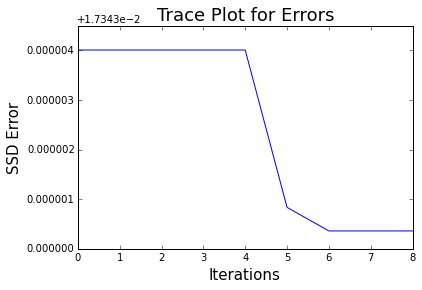

 min error: 0.0173433601354
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  30
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

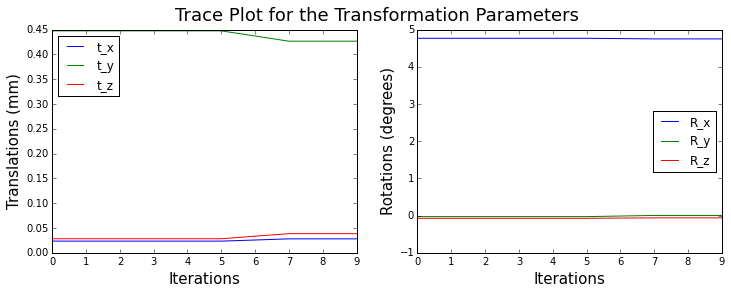

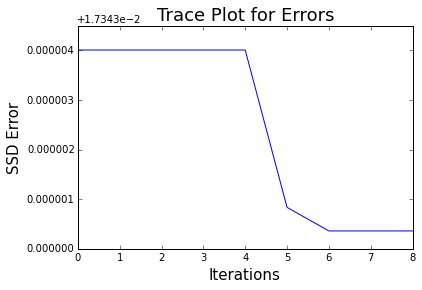

 min error: 0.0173433601354
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  31
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

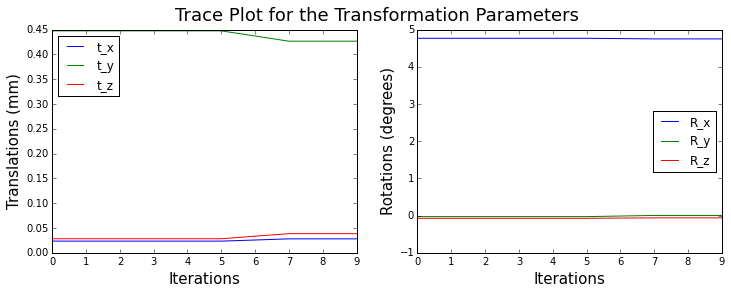

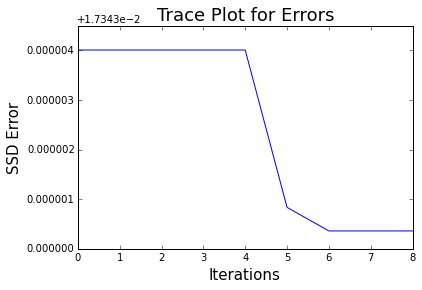

 min error: 0.0173433601355
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  32
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

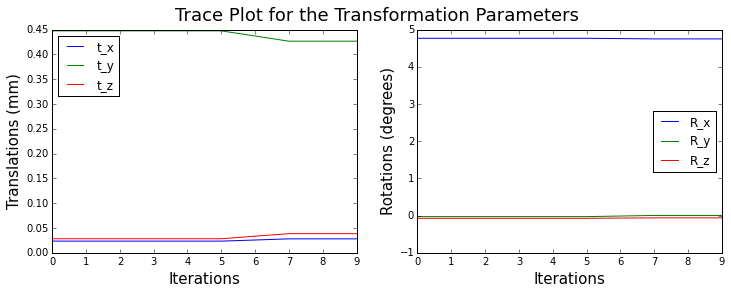

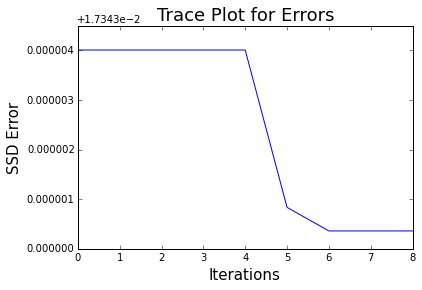

 min error: 0.0173433601355
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  33
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

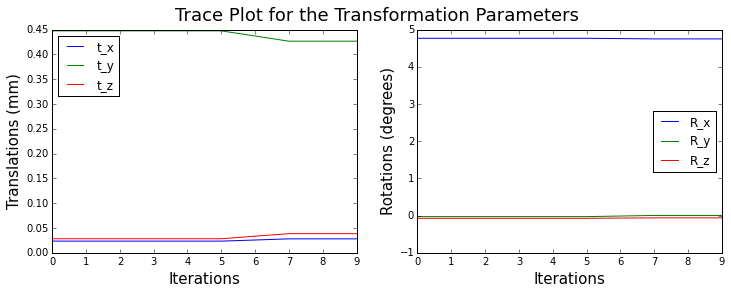

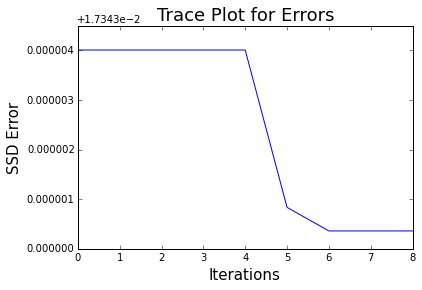

 min error: 0.0173433601356
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  34
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

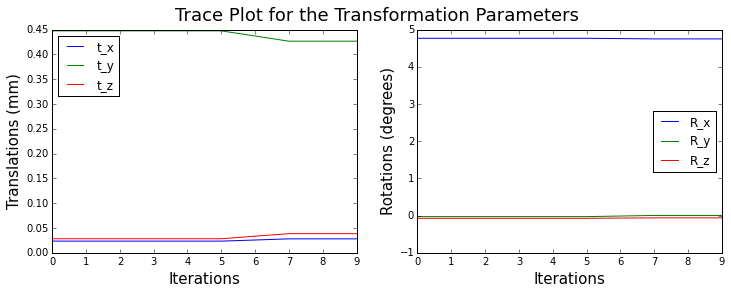

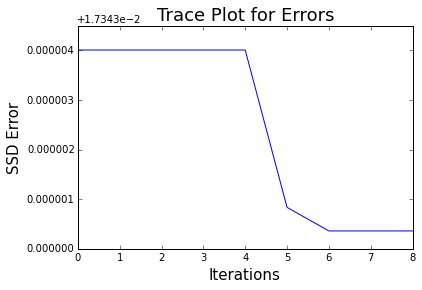

 min error: 0.0173433601356
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  35
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

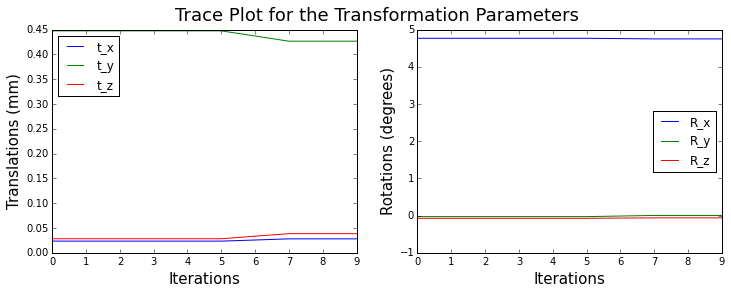

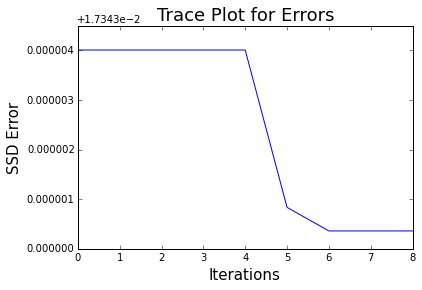

 min error: 0.0173433601356
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  36
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

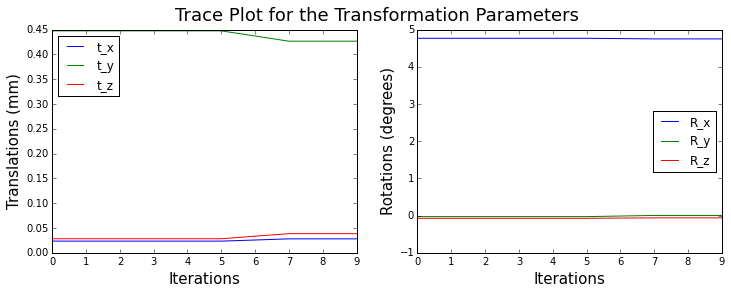

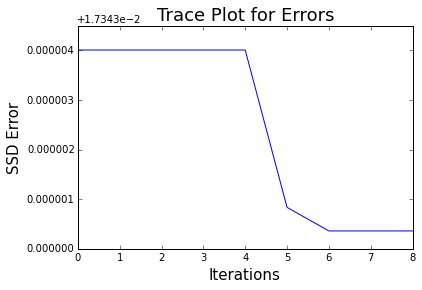

 min error: 0.0173433601357
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  37
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

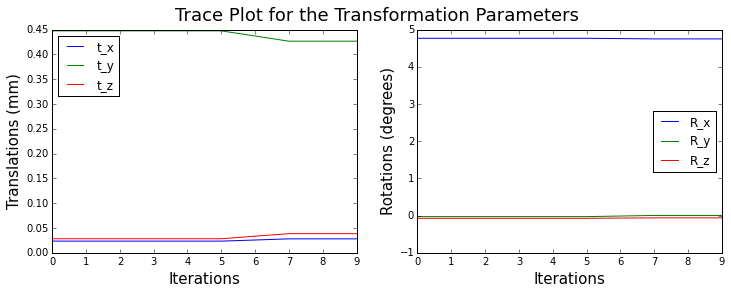

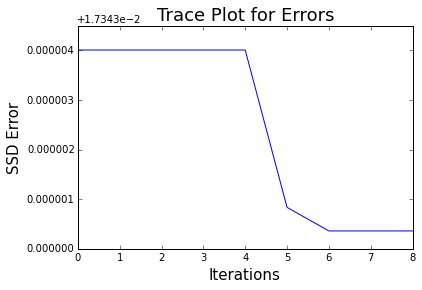

 min error: 0.0173433601357
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  38
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

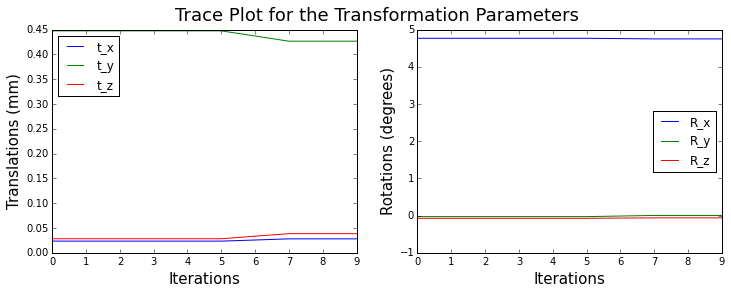

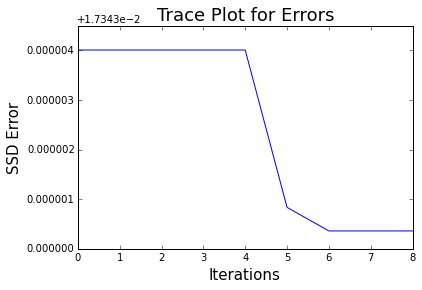

 min error: 0.0173433601357
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  39
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

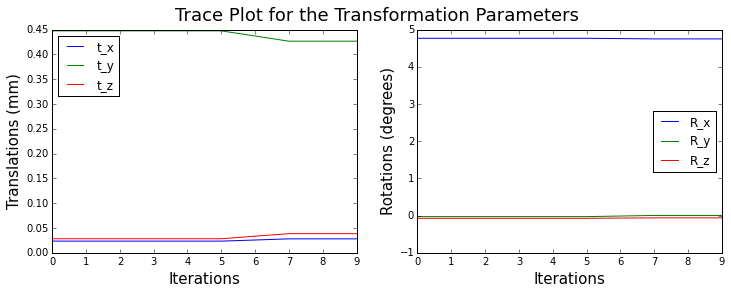

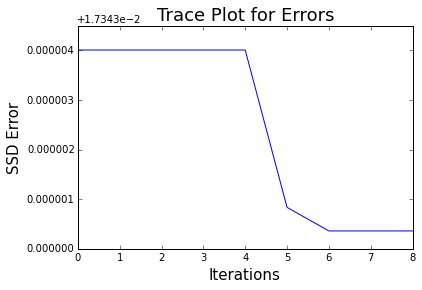

 min error: 0.0173433601358
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  40
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

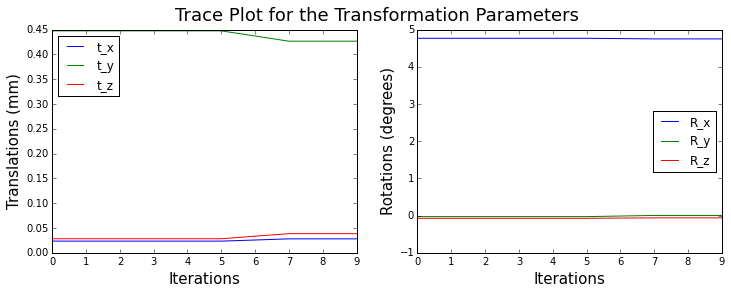

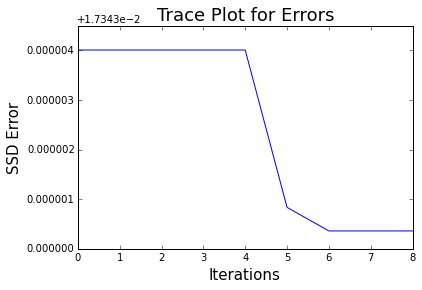

 min error: 0.0173433601358
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  41
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

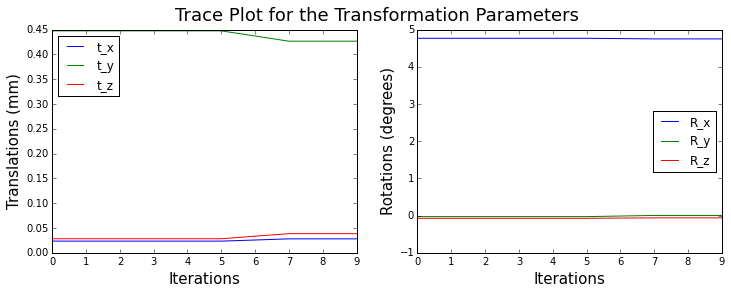

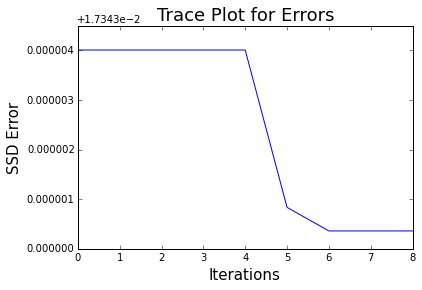

 min error: 0.0173433601358
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  42
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

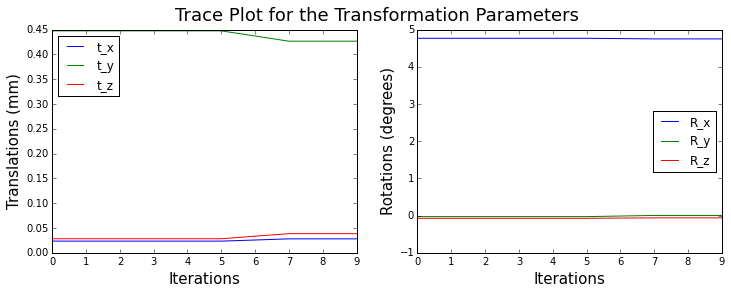

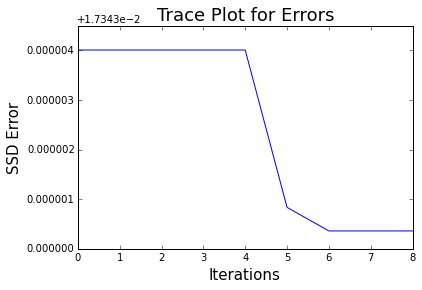

 min error: 0.0173433601358
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  43
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

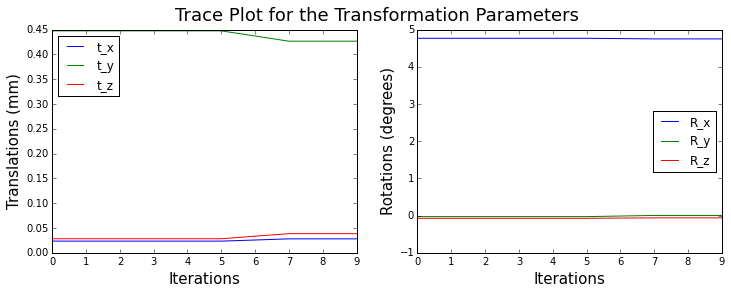

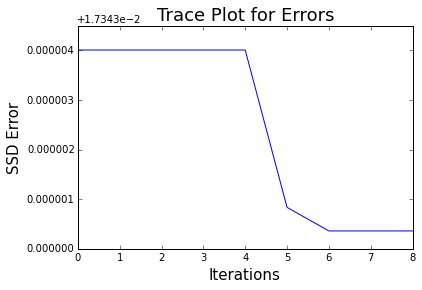

 min error: 0.0173433601359
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  44
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

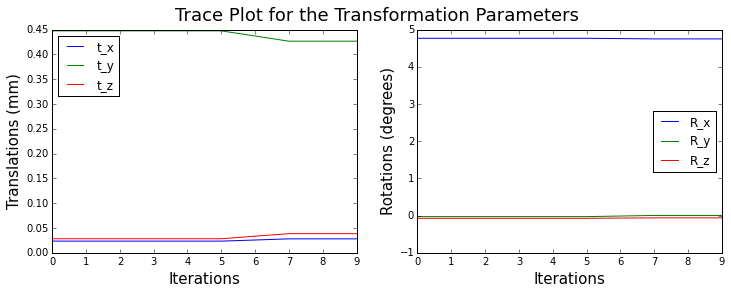

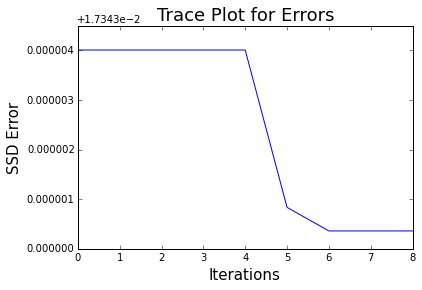

 min error: 0.0173433601359
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  45
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

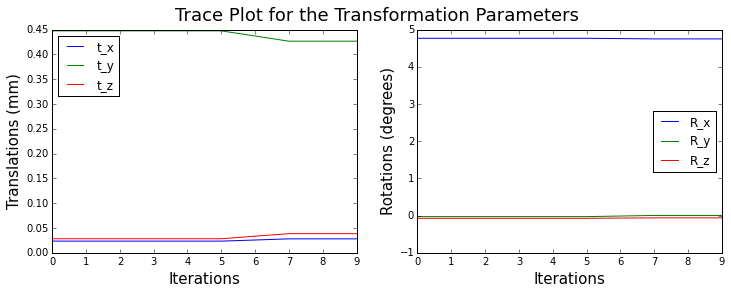

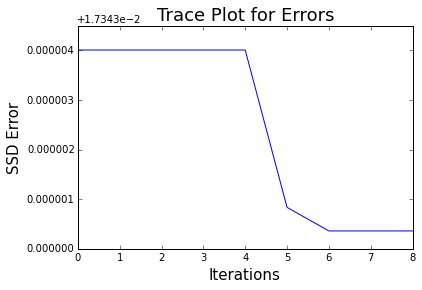

 min error: 0.0173433601359
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  46
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

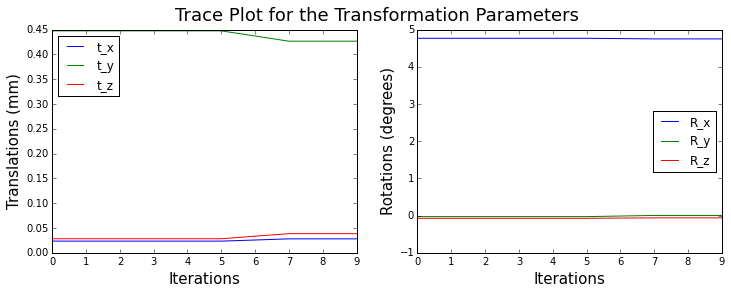

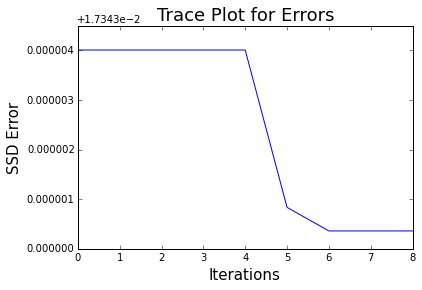

 min error: 0.0173433601359
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  47
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

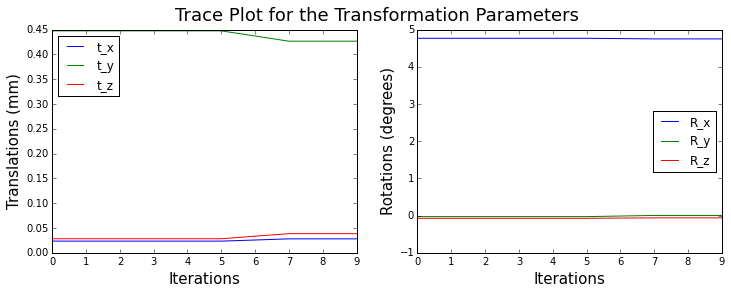

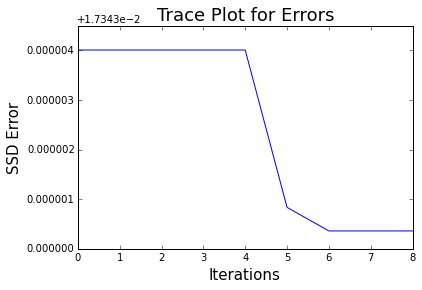

 min error: 0.0173433601359
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  48
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

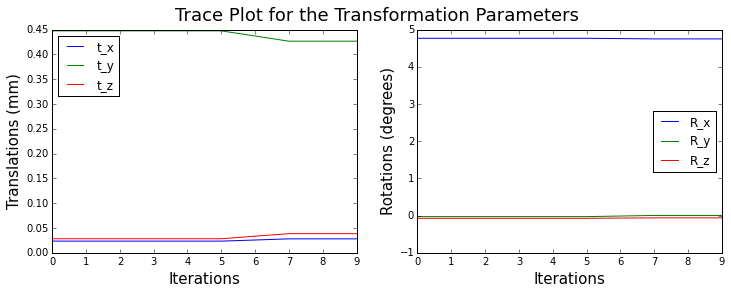

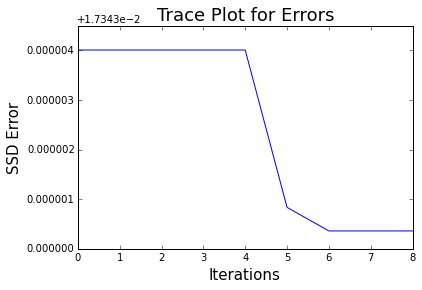

 min error: 0.0173433601359
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  49
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

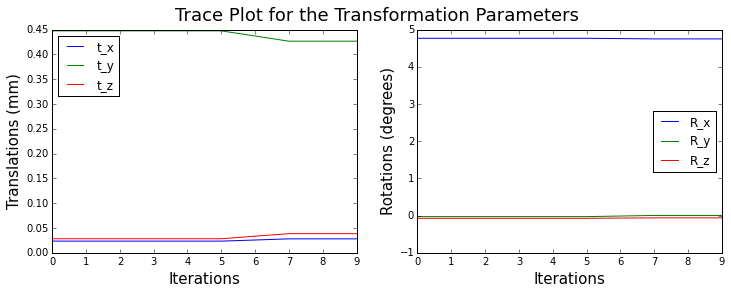

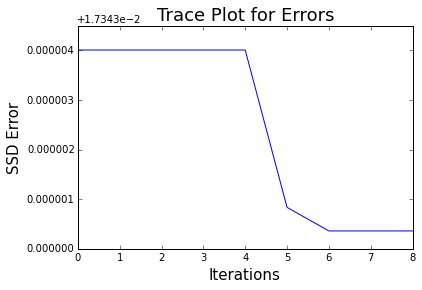

 min error: 0.0173433601359
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  50
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

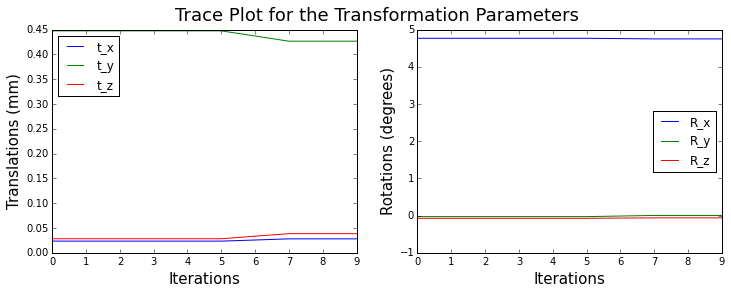

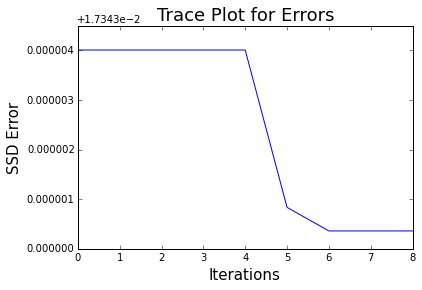

 min error: 0.017343360136
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  51
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

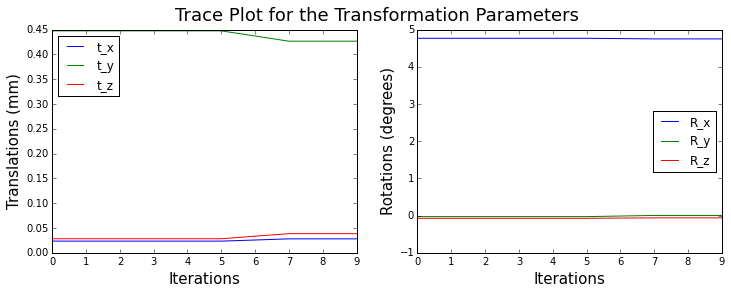

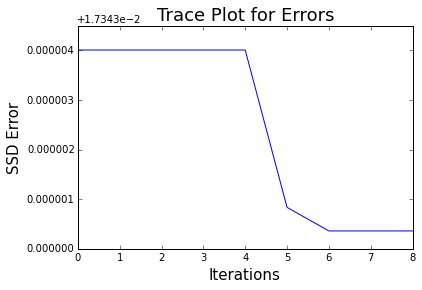

 min error: 0.017343360136
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  52
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

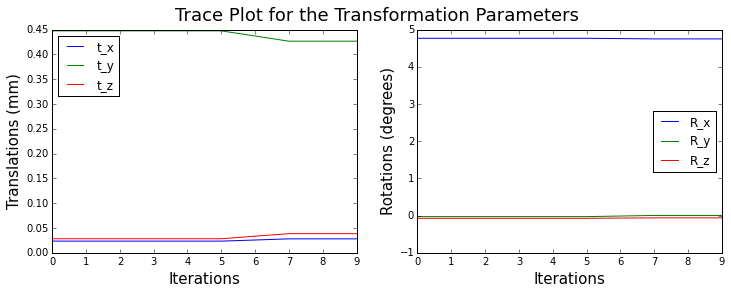

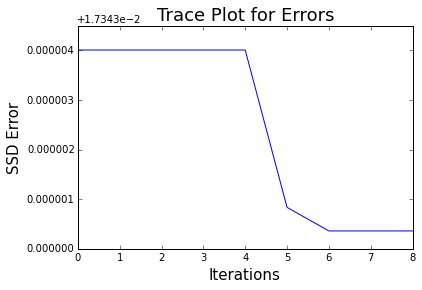

 min error: 0.017343360136
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  53
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

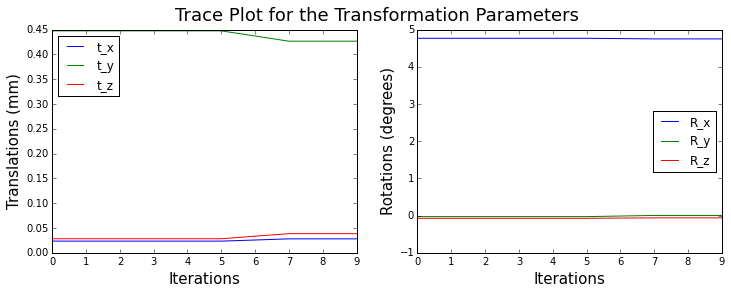

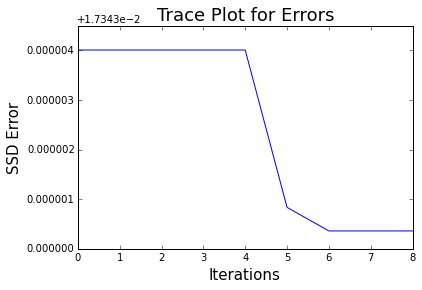

 min error: 0.017343360136
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  54
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

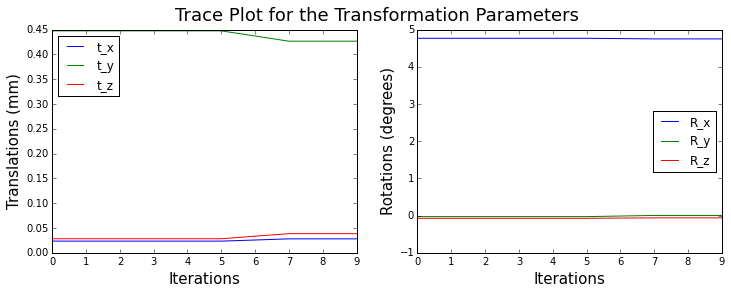

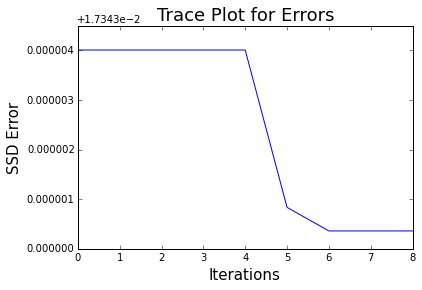

 min error: 0.017343360136
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  55
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

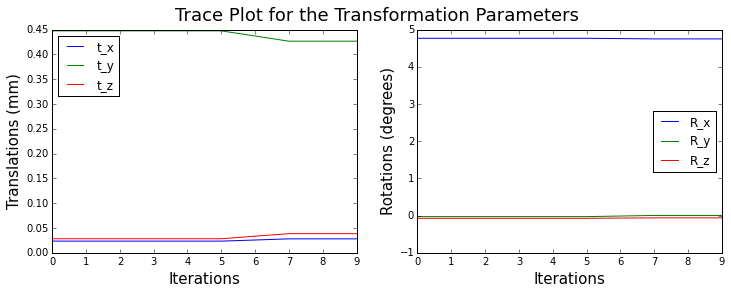

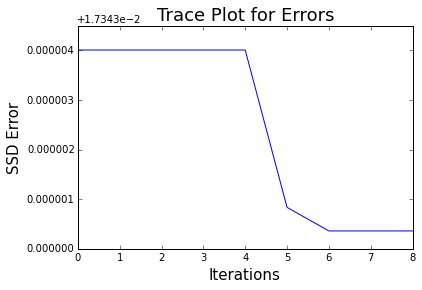

 min error: 0.017343360136
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  56
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

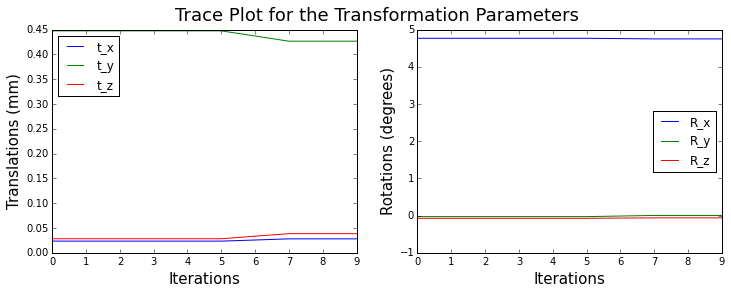

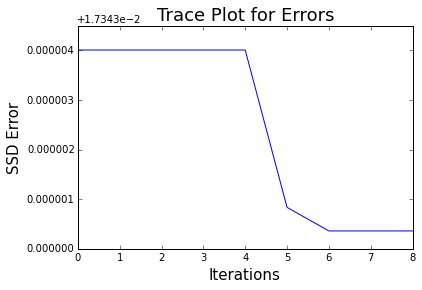

 min error: 0.017343360136
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  57
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

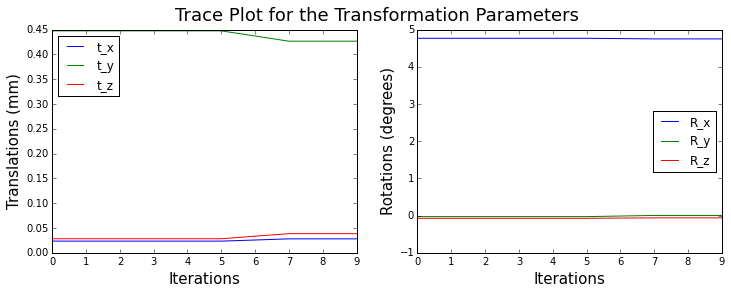

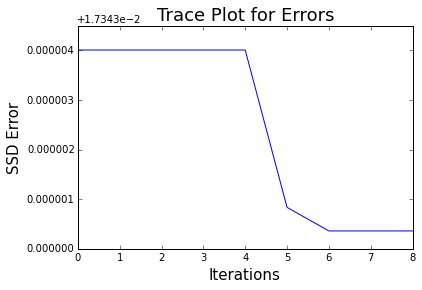

 min error: 0.017343360136
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  58
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

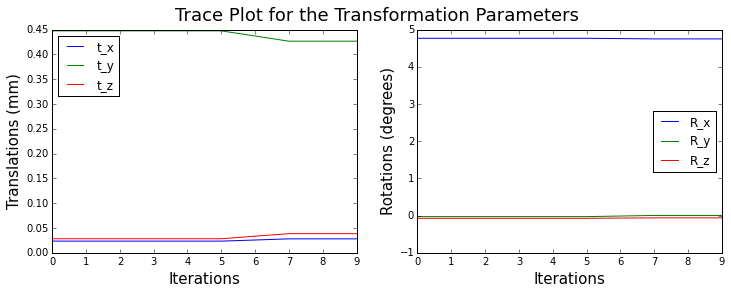

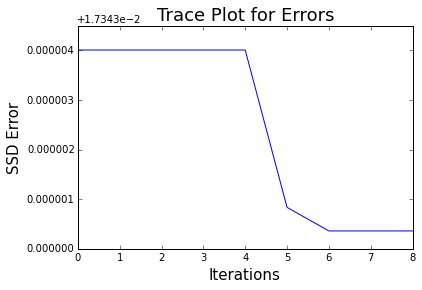

 min error: 0.017343360136
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  59
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

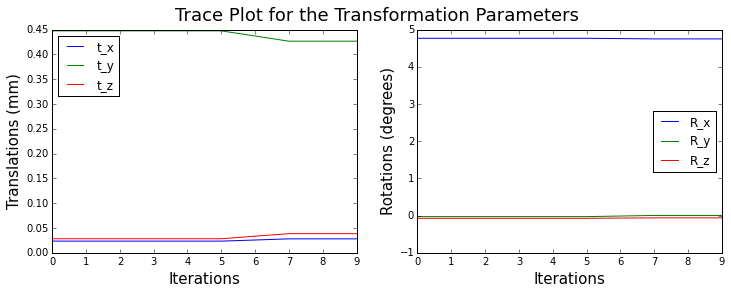

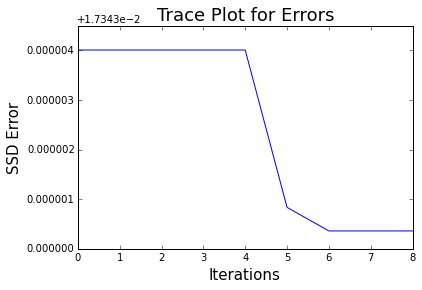

 min error: 0.017343360136
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  60
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

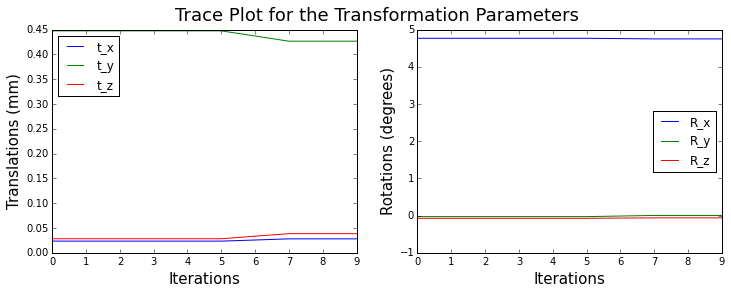

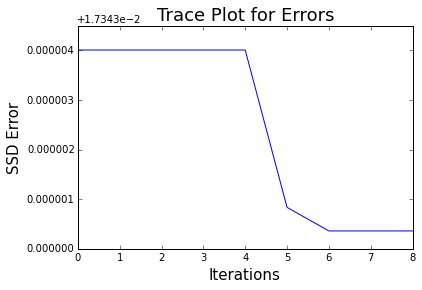

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  61
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

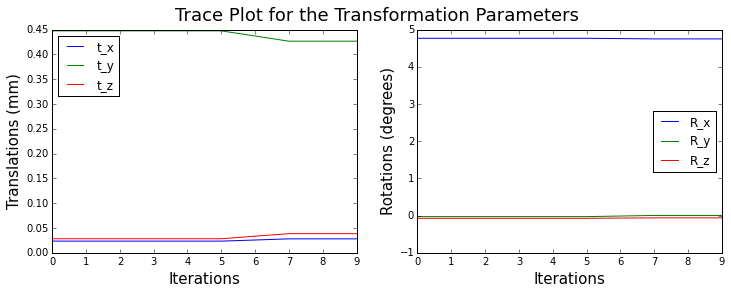

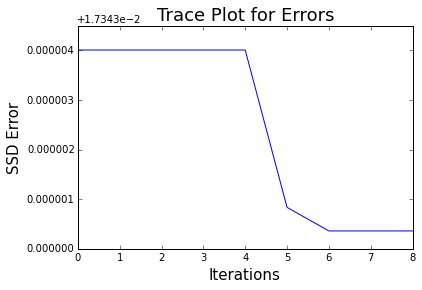

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  62
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

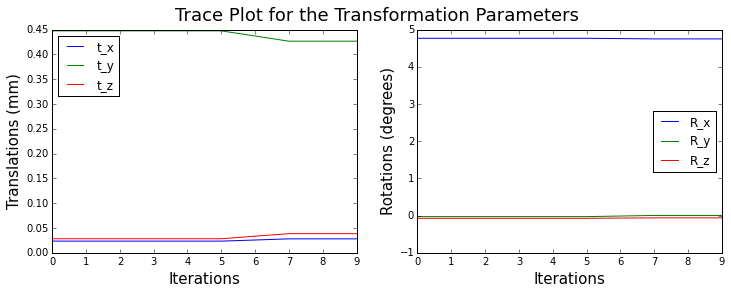

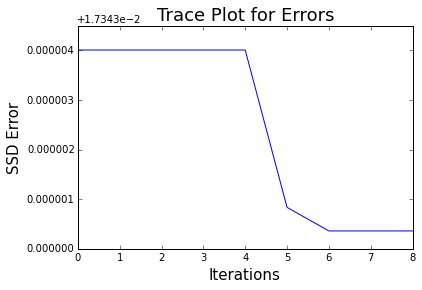

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  63
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

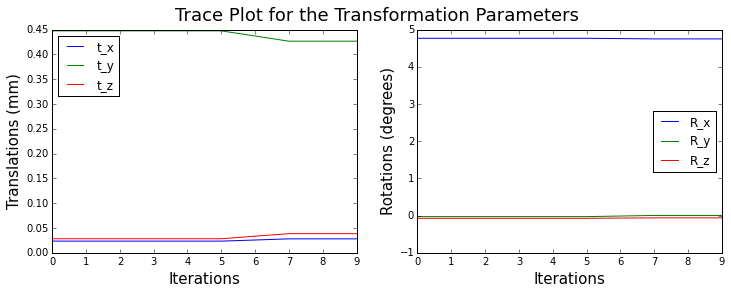

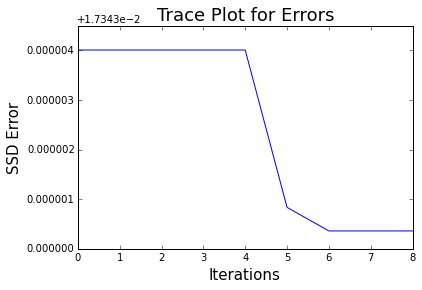

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  64
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

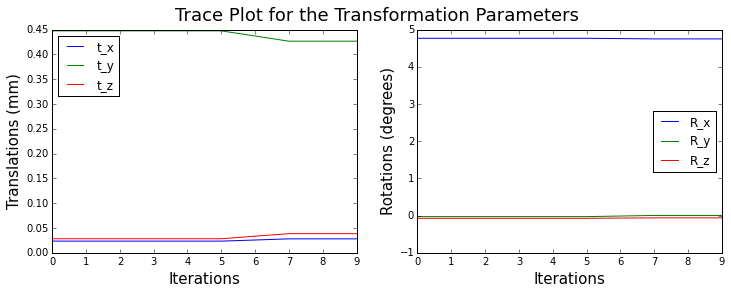

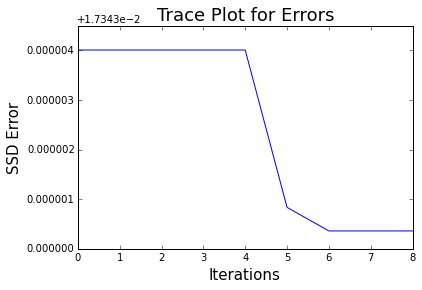

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  65
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

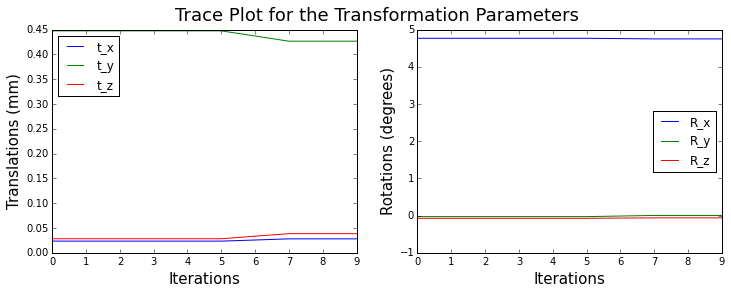

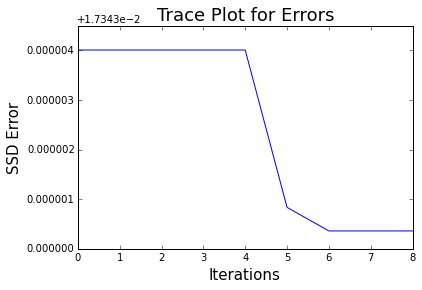

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  66
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

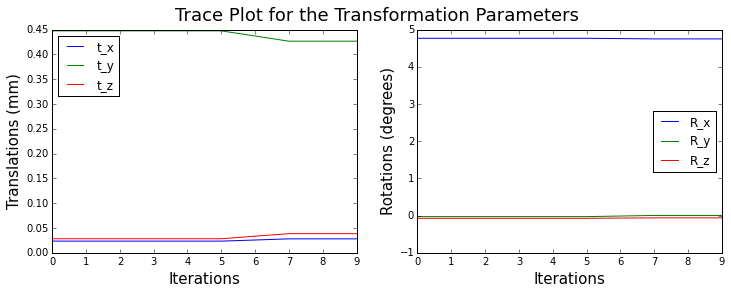

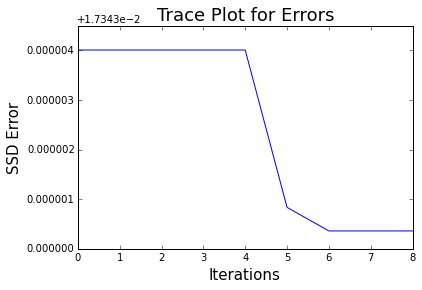

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  67
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

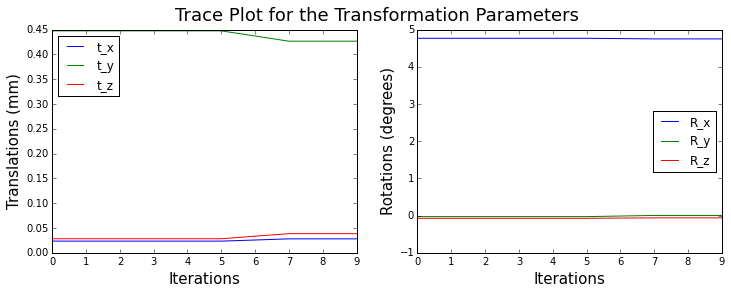

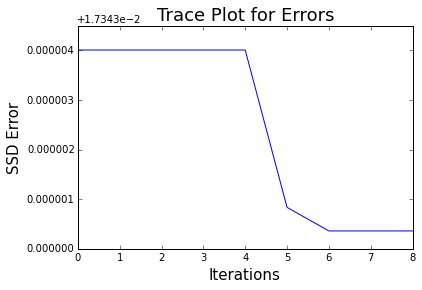

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  68
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

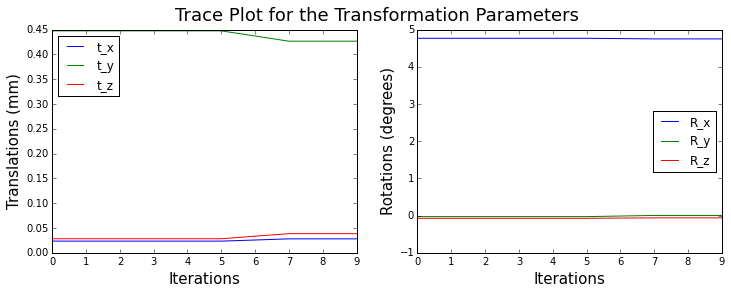

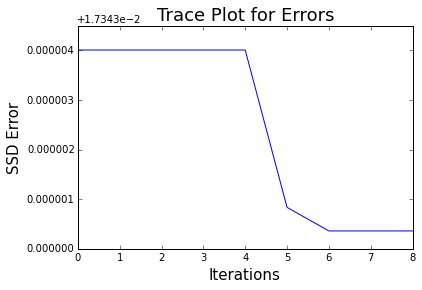

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  69
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

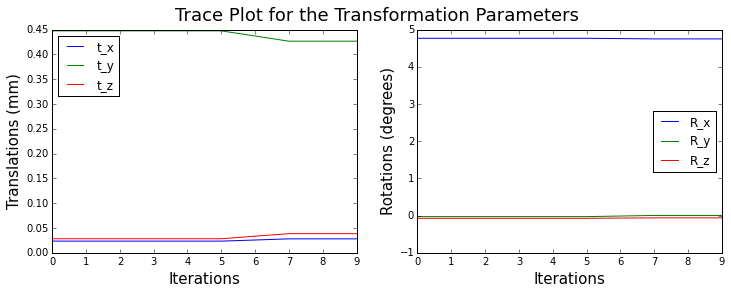

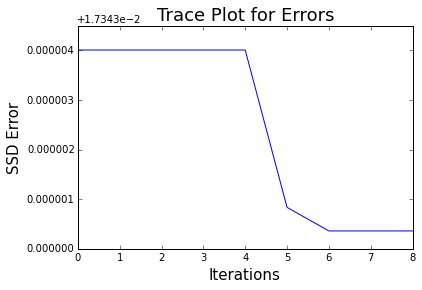

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  70
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

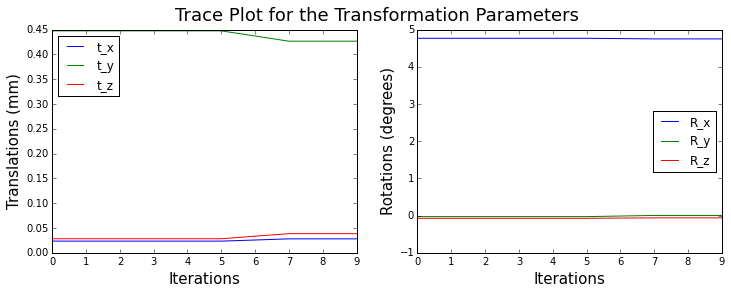

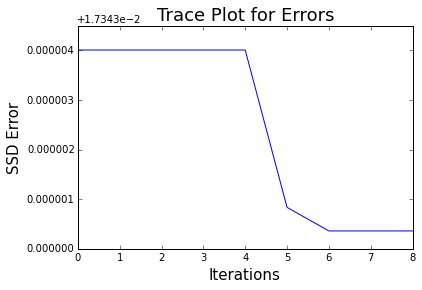

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  71
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

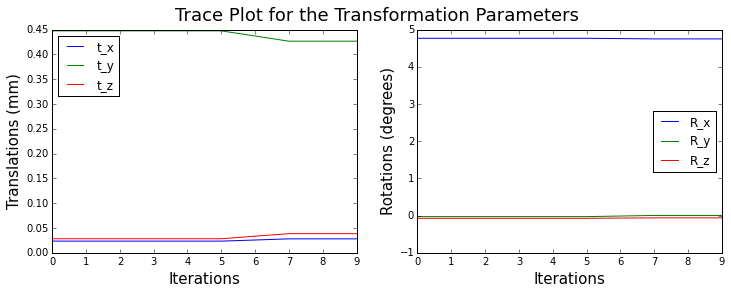

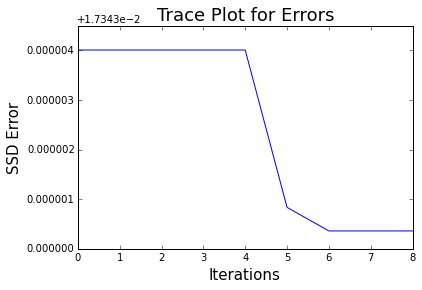

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  72
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

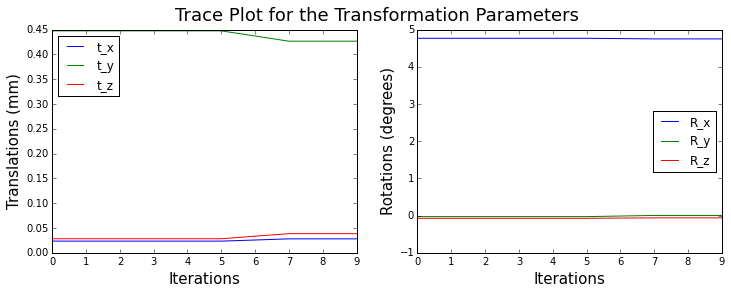

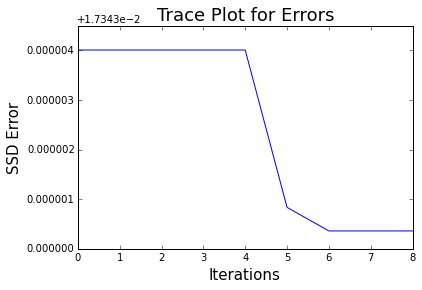

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  73
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

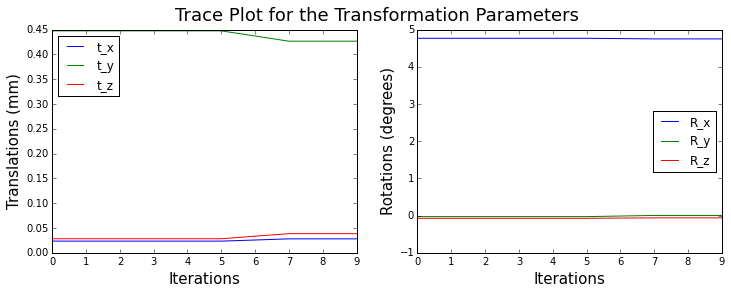

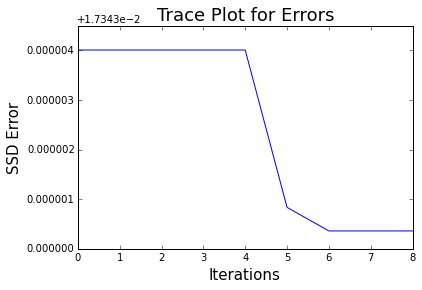

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  74
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

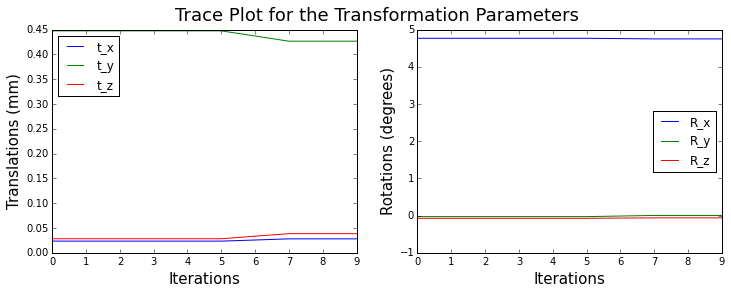

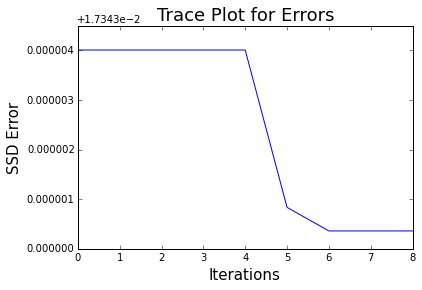

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  75
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

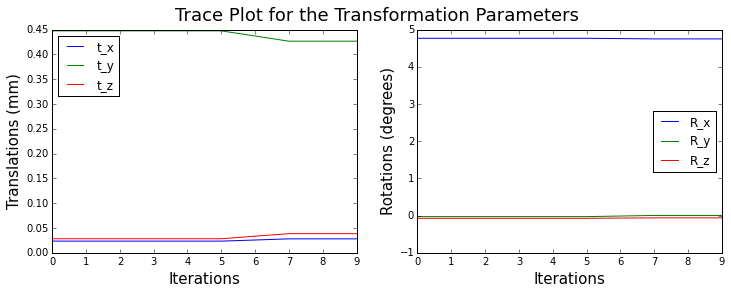

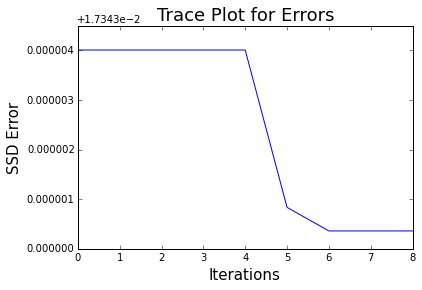

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  76
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

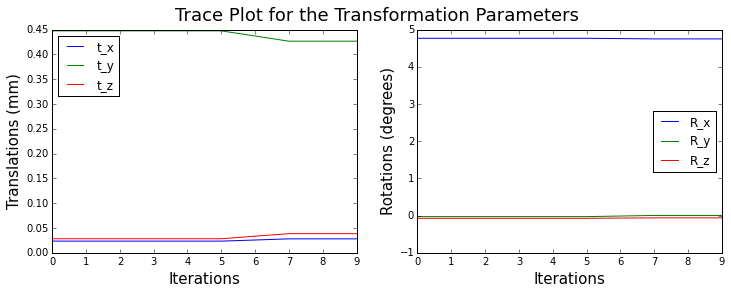

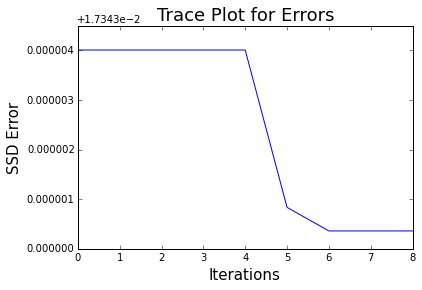

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  77
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

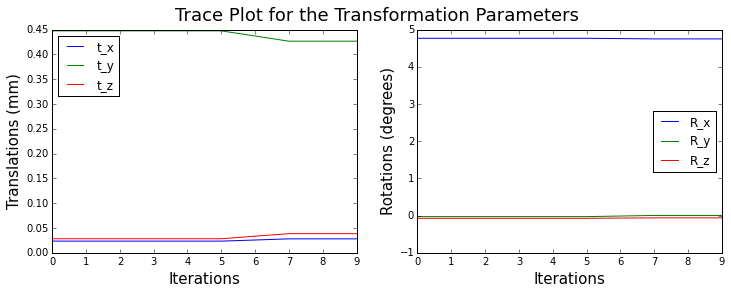

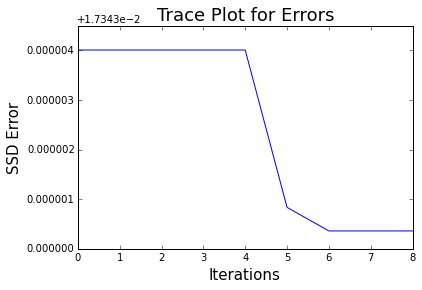

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  78
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

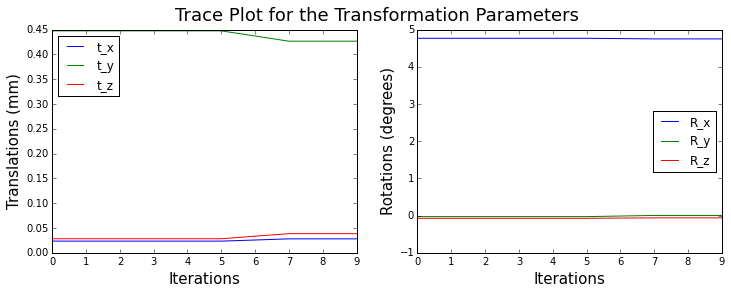

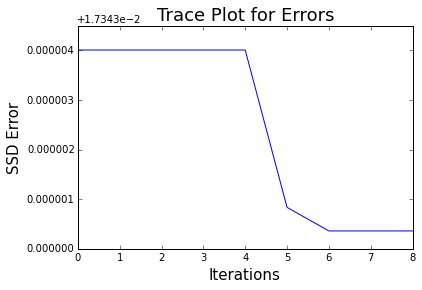

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  79
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

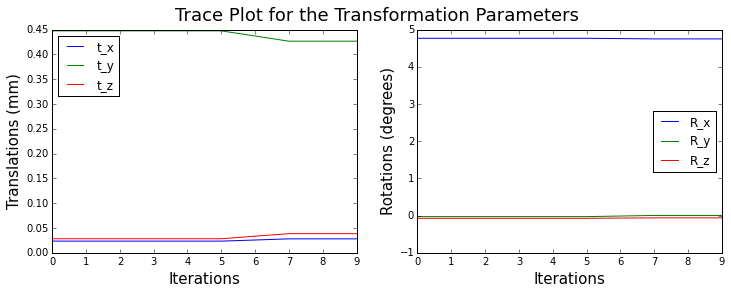

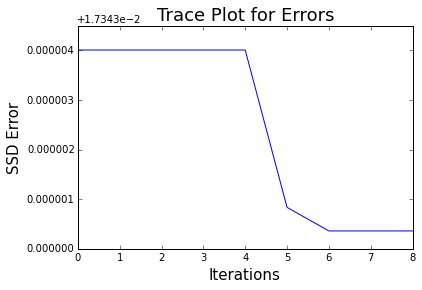

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  80
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

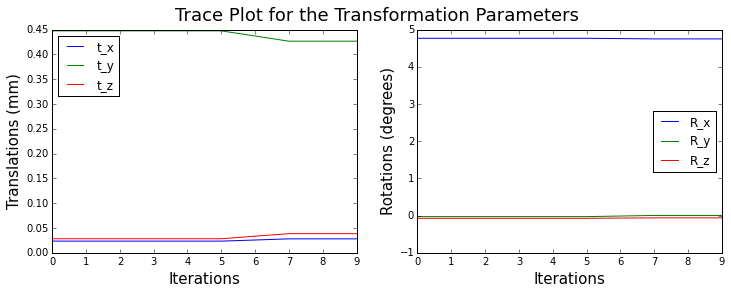

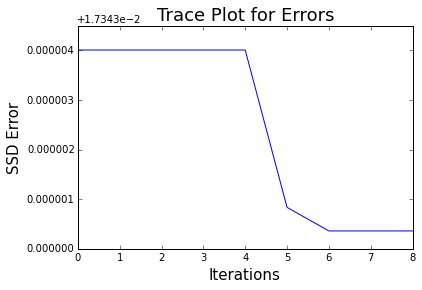

 min error: 0.0173433601361
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  81
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

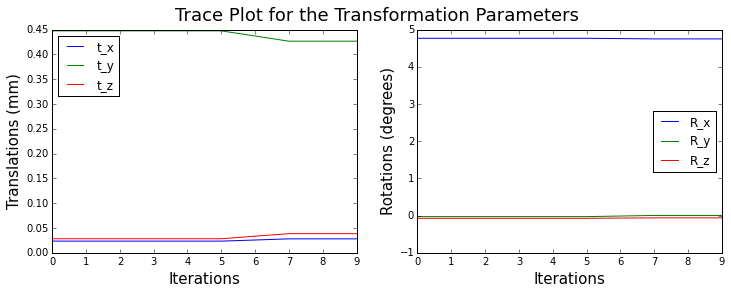

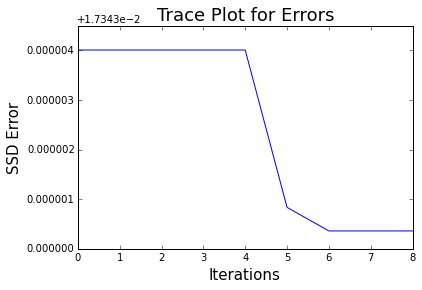

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  82
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

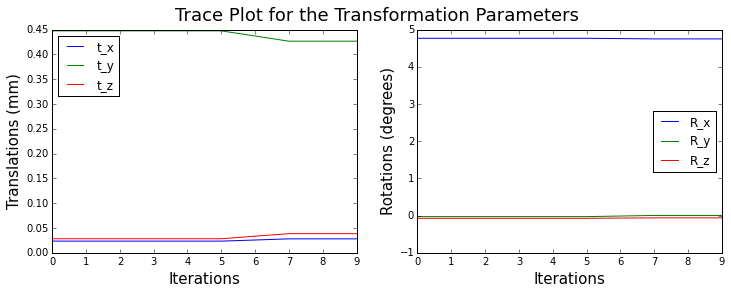

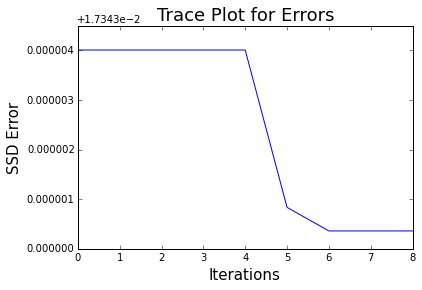

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  83
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

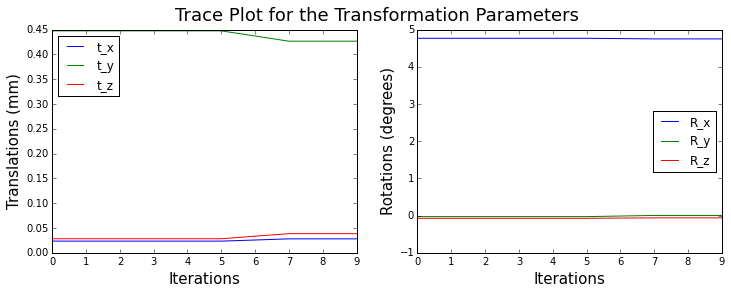

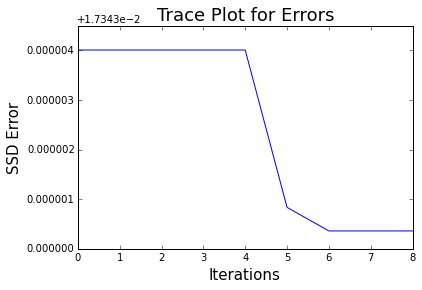

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  84
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

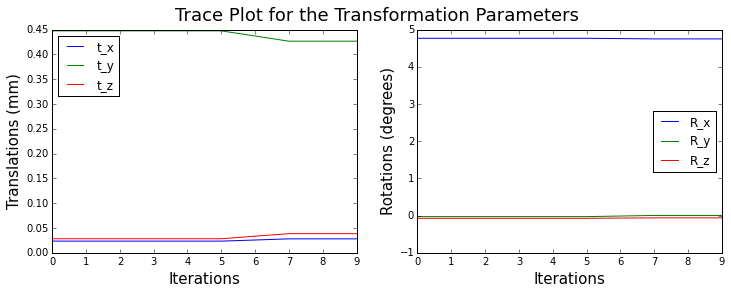

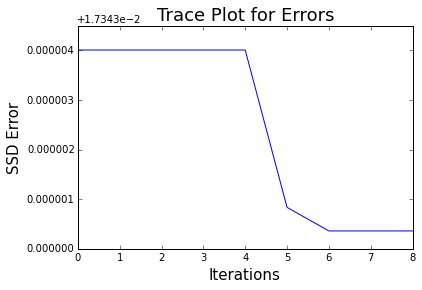

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  85
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

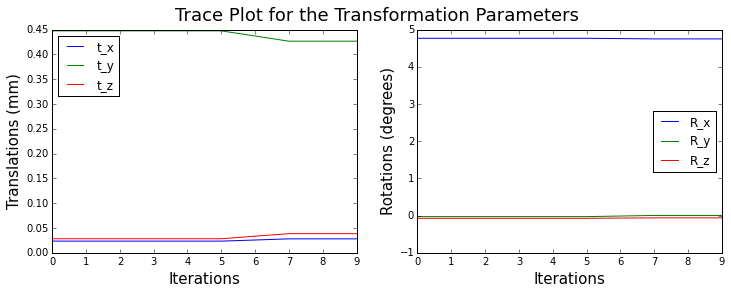

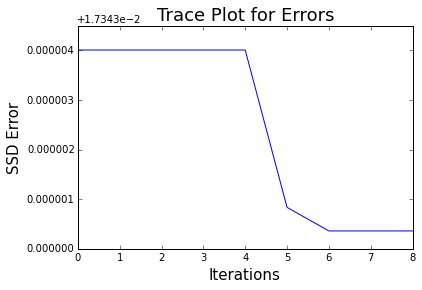

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  86
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

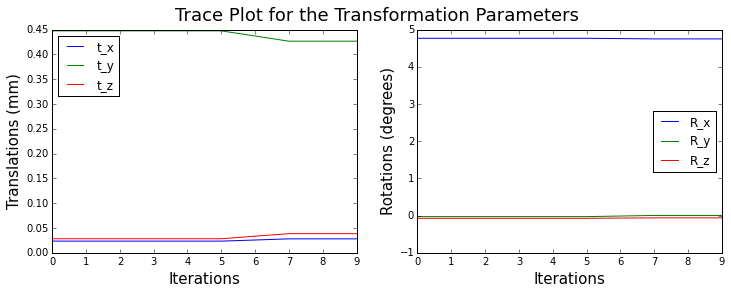

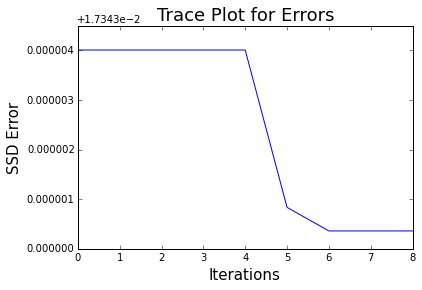

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  87
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

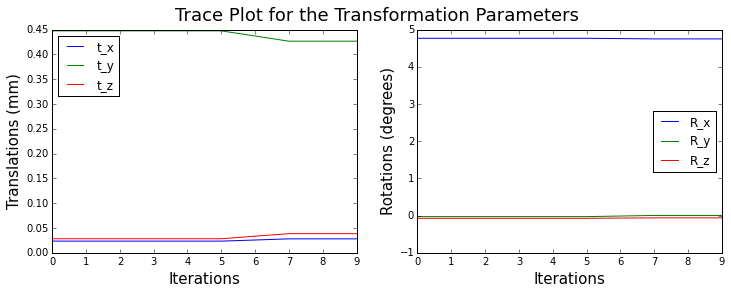

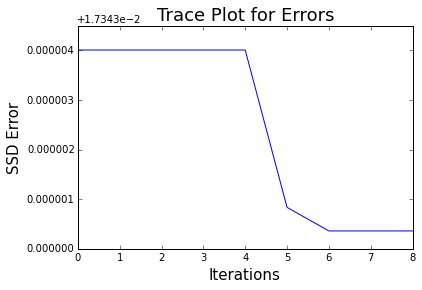

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  88
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

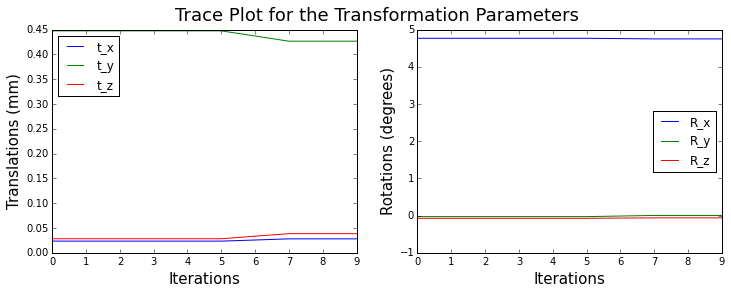

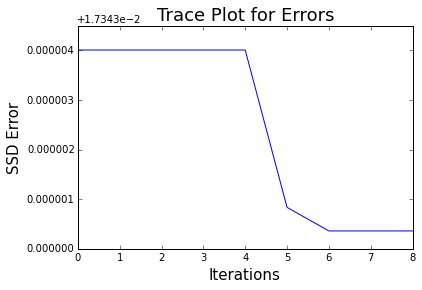

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  89
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

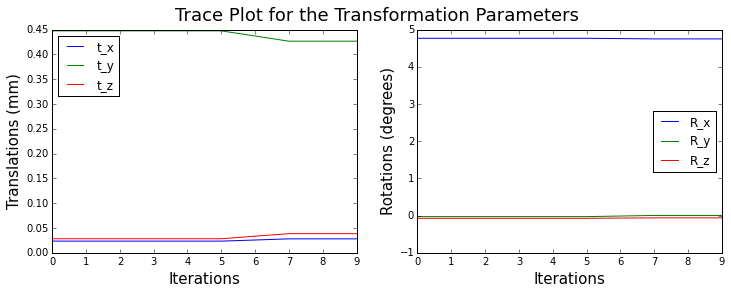

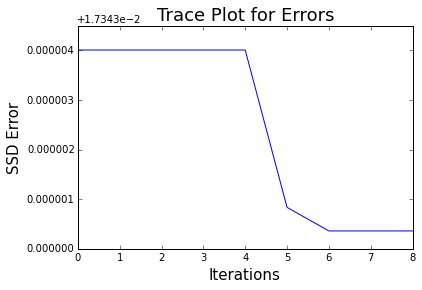

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  90
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

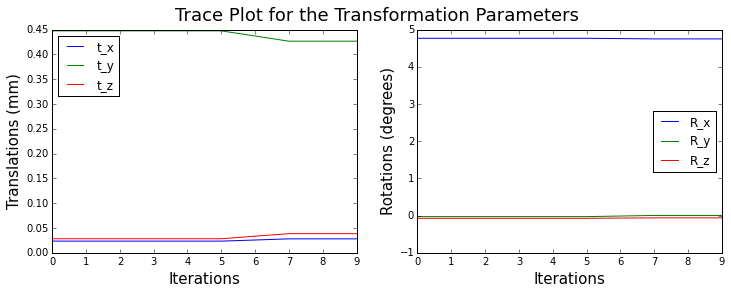

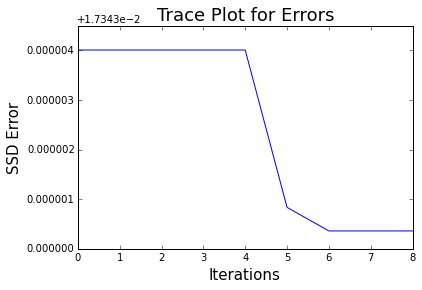

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  91
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

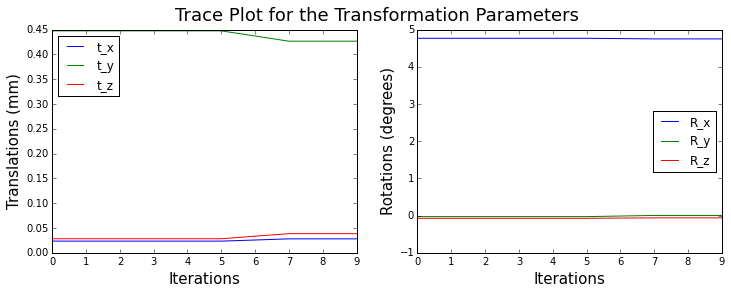

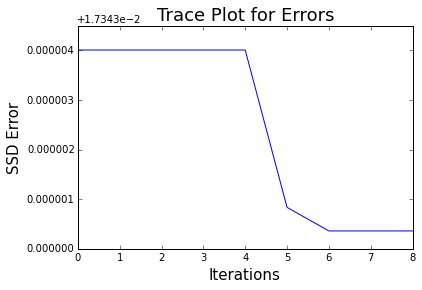

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  92
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

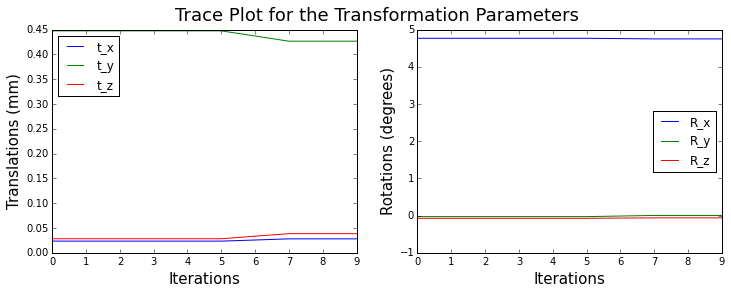

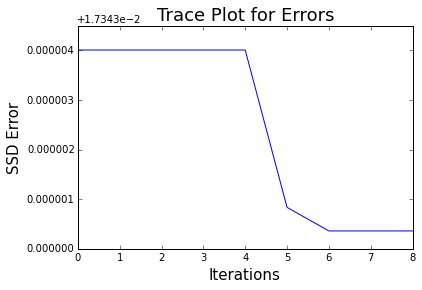

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  93
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

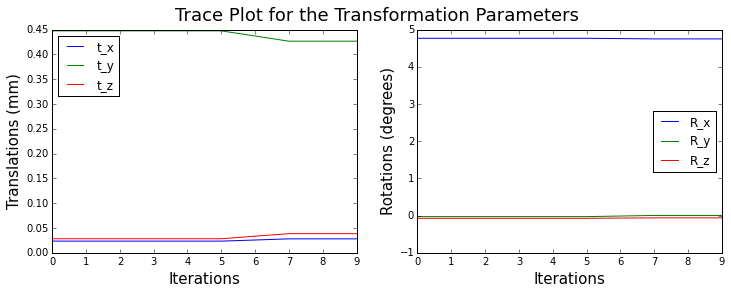

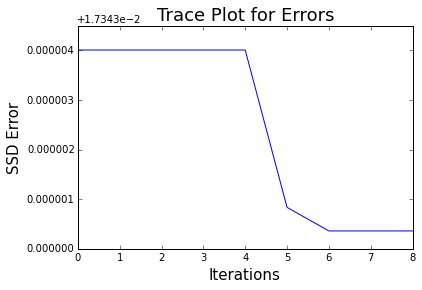

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  94
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

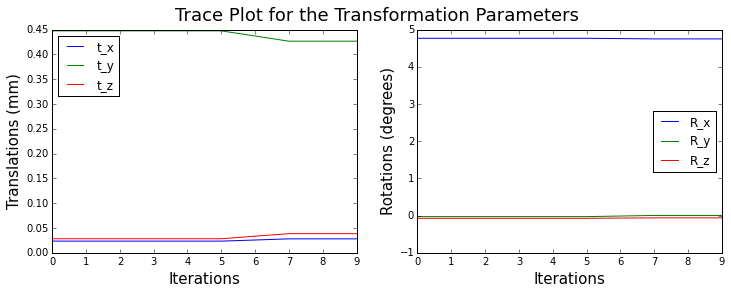

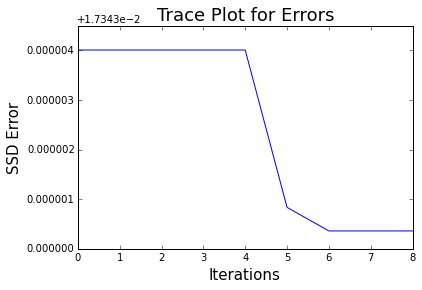

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  95
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

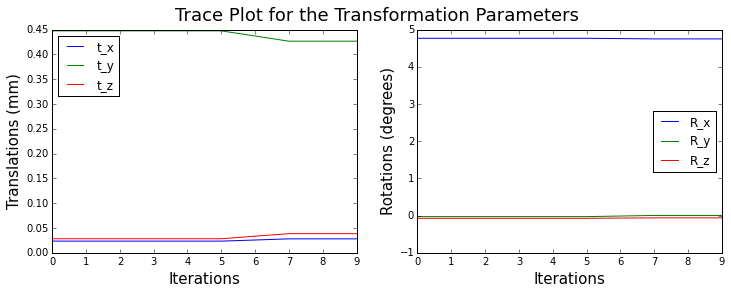

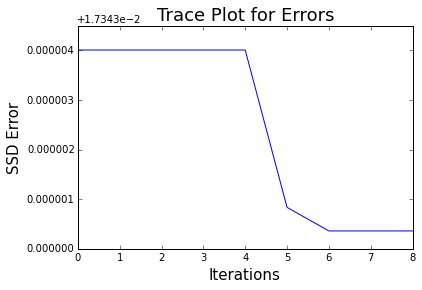

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  96
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

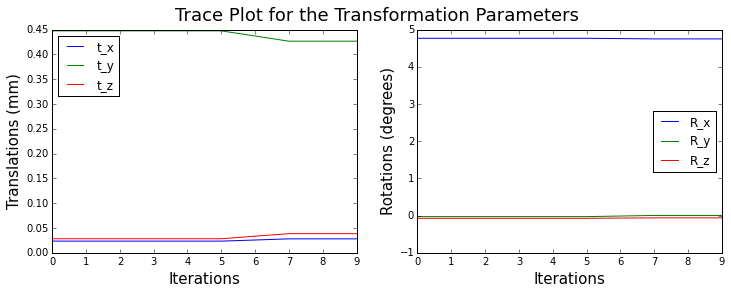

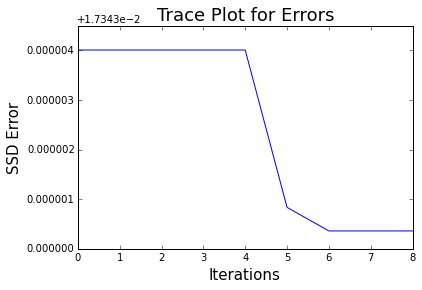

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  97
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

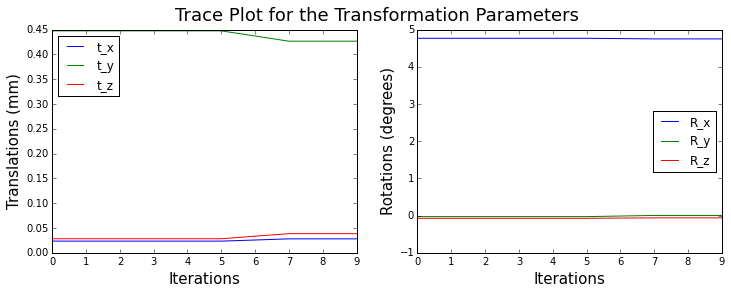

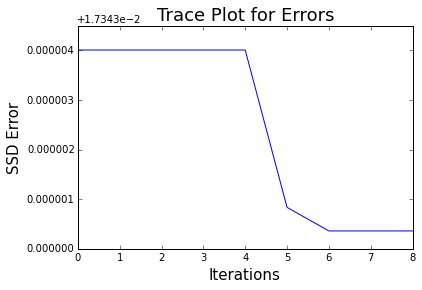

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  98
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

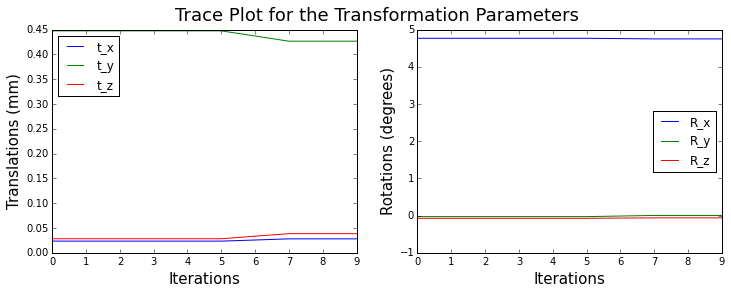

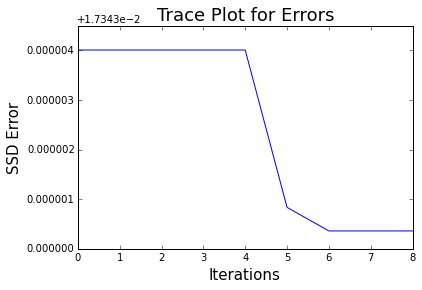

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
c =  99
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

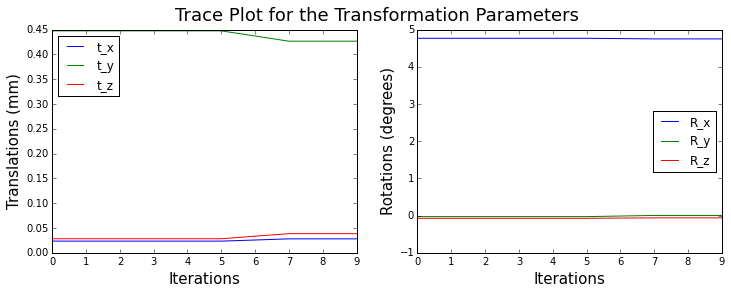

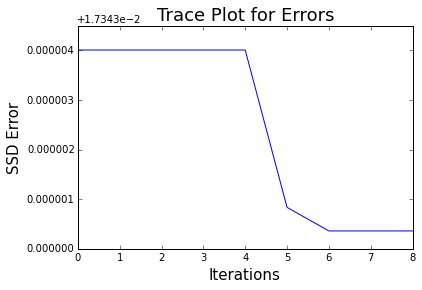

 min error: 0.0173433601362
translations: [ 0.02353898  0.44746569  0.02832742] rotations: [ 4.76665237 -0.02735019 -0.07220702]
CPU times: user 13min 40s, sys: 10min 20s, total: 24min 1s
Wall time: 12min 4s


In [17]:
%%time
mad_r = MAD(R)
if mad_r != 0:
    print 'normalized residual'
    R = (1./mad_r)*R
c_errors = []
c_errors.append(error)
for c in xrange(1,100):
    print 'c = ', c
    w = Tukeys_Biweight(R,c)
    W = np.diag(w)
    P_new, R_new, err = Gauss_Newton_IRLS(testVol1_masked, vol1_dervs, testVol2, vol2_dervs, W,
                             divide_factor = 1., alpha = 1., decrease_factor = 0.25, 
                             P_initial = P, max_iter = 15, mask = True)
    c_errors.append(err)
    print 'translations:', P[:3]*8, 'rotations:',P[3:]*180/np.pi

### IRLS with only non-zero values

0 1 2 3 4 5 6 7 8 9 10 Converged in 10 iterations!


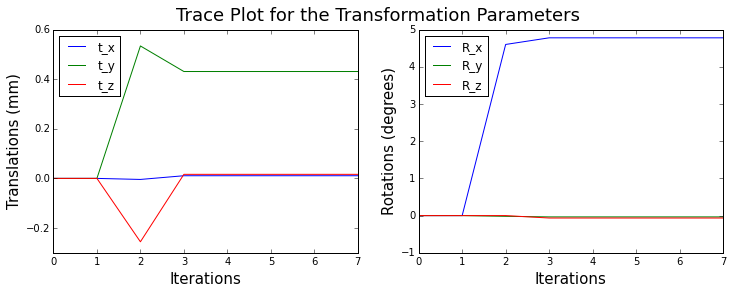

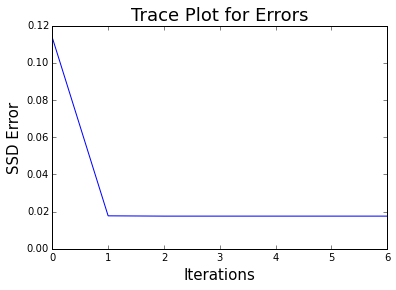

min error: 0.0175716691112
translations: [ 0.01074965  0.43097266  0.01638057] rotations: [ 4.77896254 -0.03499034 -0.06500659]
CPU times: user 8.15 s, sys: 5.9 s, total: 14 s
Wall time: 8.59 s


In [217]:
%%time
w = np.eye(s0*s1*s2)
P, R, error = Gauss_Newton_IRLS(testVol1_masked, vol1_dervs, testVol2, vol2_dervs, w,
                         d=0.4, divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                         max_iter = 15, mask = True)
print 'translations:', P[:3]*8, 'rotations:',P[3:]*180/np.pi

In [209]:
R_nonzero = (R.reshape([32,32,32]))[nonzero_mask]
mad_r = MAD(R_nonzero)
if mad_r != 0:
    print 'normalized residual'
    R = (1./mad_r)*R

normalized residual


c =  0.002
0 1 2 3 4 5 6 7 8 9 10 Converged in 10 iterations!


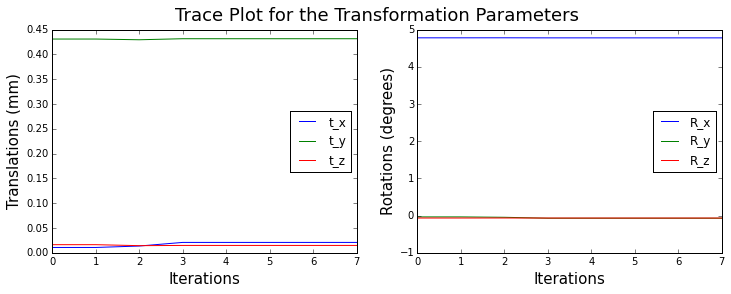

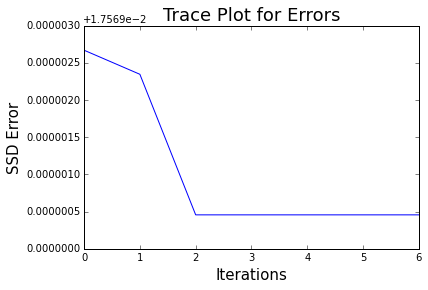

min error: 0.0175694562433
translations: [ 0.0209294   0.43160838  0.01486148] rotations: [ 4.77774271 -0.0705883  -0.06561338]
CPU times: user 7.99 s, sys: 6.04 s, total: 14 s
Wall time: 7.37 s


In [214]:
%%time
c = 0.002
print 'c = ', c
w = Tukeys_Biweight(R,c)
W = np.diag(w)
P_new, R_new, err = Gauss_Newton_IRLS(testVol1_masked, vol1_dervs, testVol2, vol2_dervs, W,
                         divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                         P_initial = P, max_iter = 15, mask = True)
print 'translations:', P_new[:3]*8, 'rotations:',P_new[3:]*180/np.pi

c =  0.0005
0 1 2 3 4 5 6 Converged in 6 iterations!


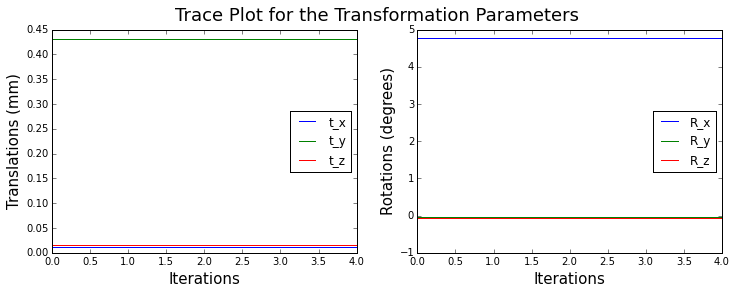

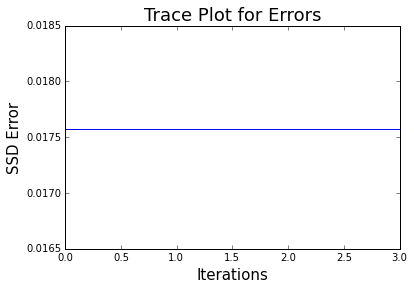

min error: 0.0175716691112
translations: [ 0.01074965  0.43097266  0.01638057] rotations: [ 4.77896254 -0.03499034 -0.06500659]
c =  0.001
0 1 2 3 4 5 6 Converged in 6 iterations!


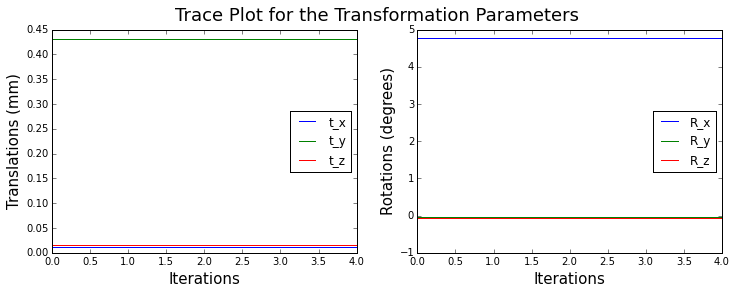

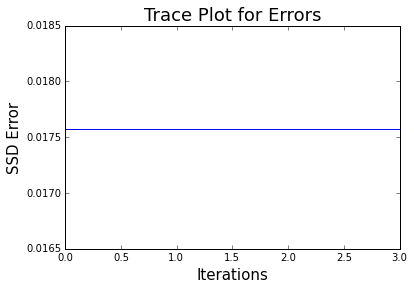

min error: 0.0175716691112
translations: [ 0.01074965  0.43097266  0.01638057] rotations: [ 4.77896254 -0.03499034 -0.06500659]
c =  0.0015
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

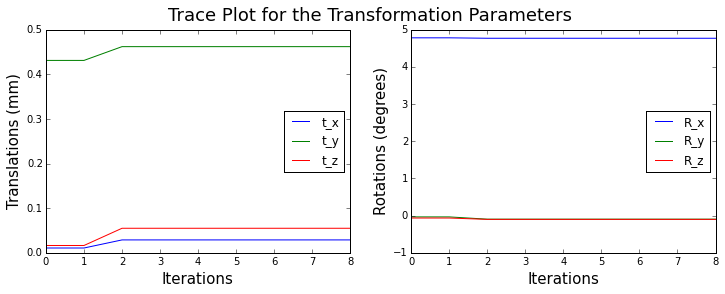

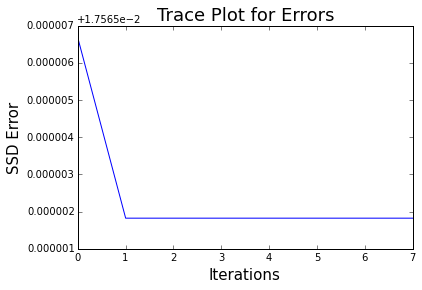

 min error: 0.01756682349
translations: [ 0.02886859  0.46182306  0.05495935] rotations: [ 4.76724255 -0.09583199 -0.10144783]
c =  0.002
0 1 2 3 4 5 6 7 8 9 10 Converged in 10 iterations!


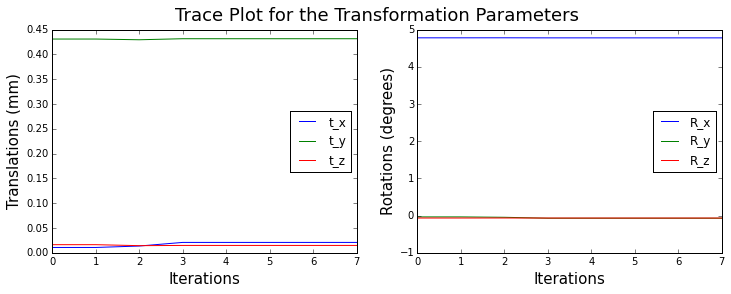

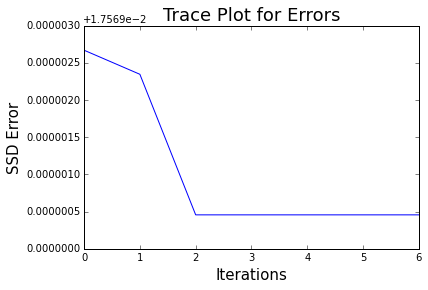

min error: 0.0175694562433
translations: [ 0.0209294   0.43160838  0.01486148] rotations: [ 4.77774271 -0.0705883  -0.06561338]
c =  0.0025
0 1 2 3 4 5 6 Converged in 6 iterations!


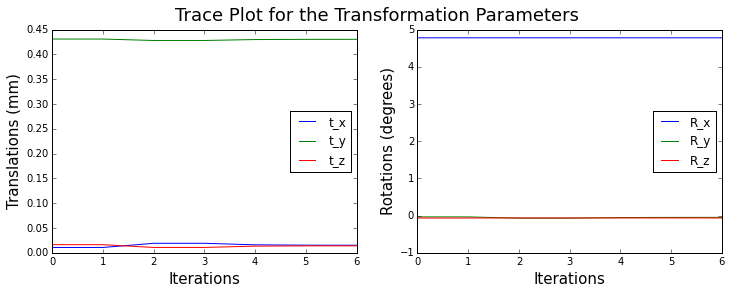

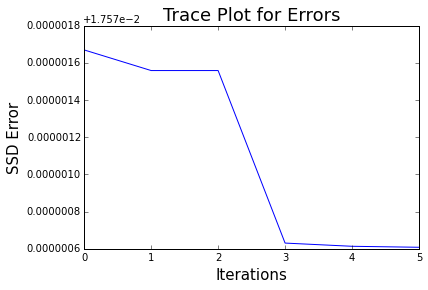

min error: 0.0175706081901
translations: [ 0.01520492  0.430388    0.01405726] rotations: [ 4.77858669 -0.04743179 -0.06334878]
c =  0.003
0 1 2 3 4 5 6 Converged in 6 iterations!


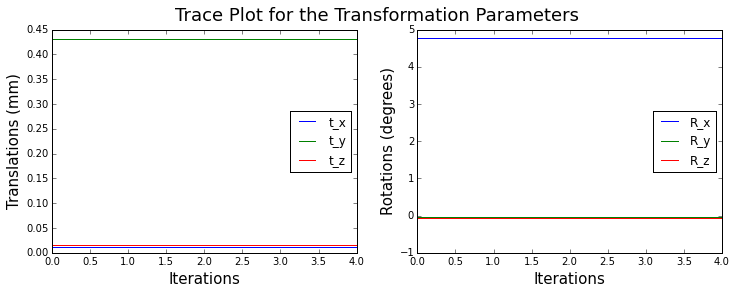

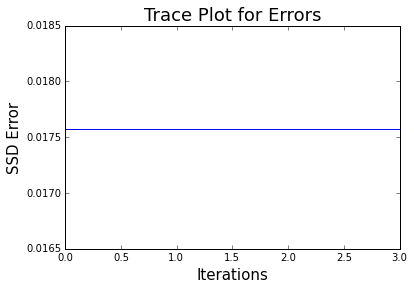

min error: 0.0175716691112
translations: [ 0.01074965  0.43097266  0.01638057] rotations: [ 4.77896254 -0.03499034 -0.06500659]
c =  0.0035
0 1 2 3 4 5 Converged in 5 iterations!


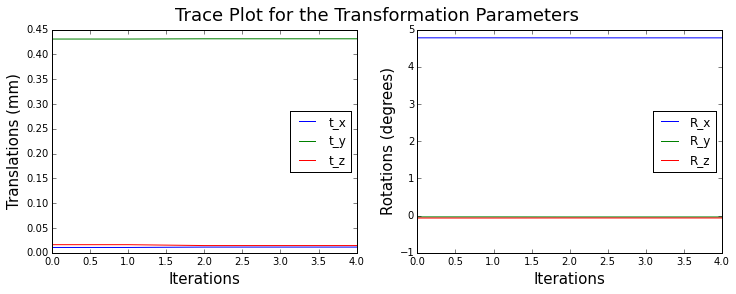

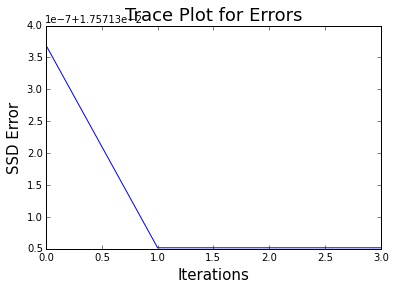

min error: 0.0175713515788
translations: [ 0.01150229  0.43146361  0.01458086] rotations: [ 4.77804447 -0.03665572 -0.06355698]
c =  0.004
0 1 2 3 4 5 6 Converged in 6 iterations!


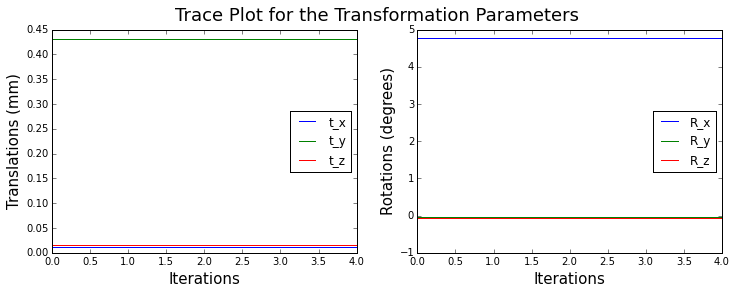

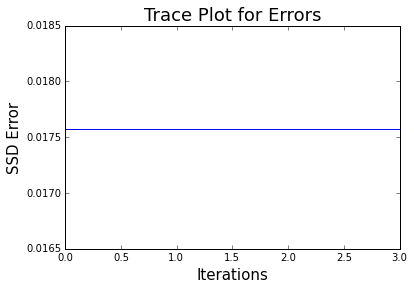

min error: 0.0175716691112
translations: [ 0.01074965  0.43097266  0.01638057] rotations: [ 4.77896254 -0.03499034 -0.06500659]
c =  0.0045
0 1 2 3 4 5 6 7 8 9 10 Converged in 10 iterations!


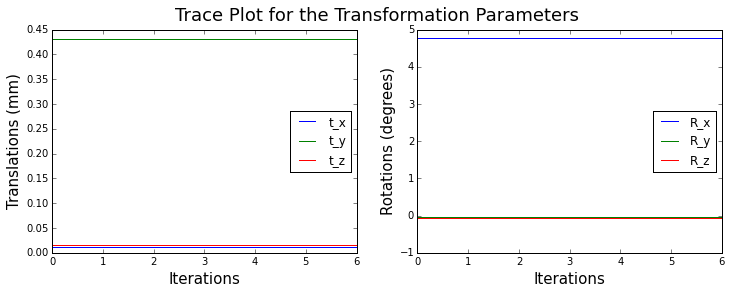

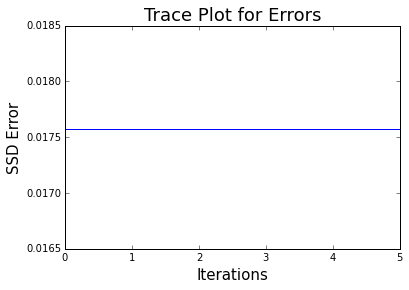

min error: 0.0175716691112
translations: [ 0.01074965  0.43097266  0.01638057] rotations: [ 4.77896254 -0.03499034 -0.06500659]
c =  0.005
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

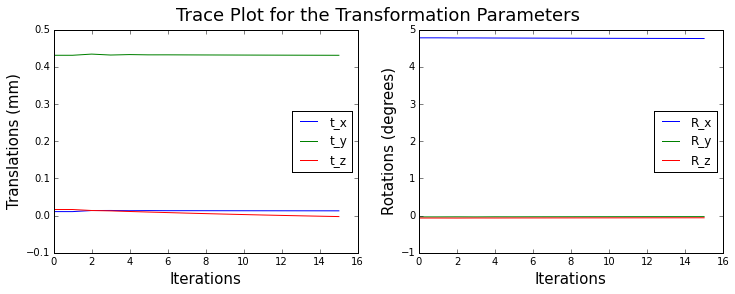

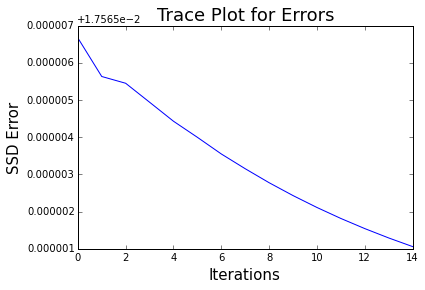

 min error: 0.0175660595
translations: [ 0.01282771  0.43093623 -0.00261066] rotations: [ 4.76015926 -0.02790679 -0.058764  ]
c =  0.0055
0 1 2 3 4 5 6 7 8 9 10 Converged in 10 iterations!


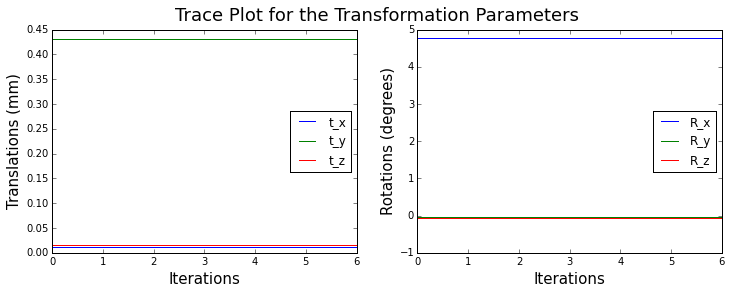

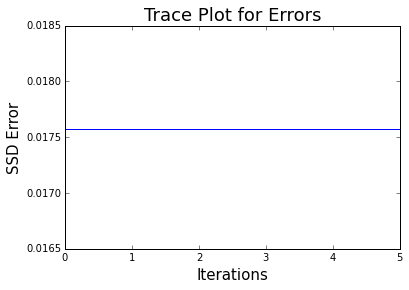

min error: 0.0175716691112
translations: [ 0.01074965  0.43097266  0.01638057] rotations: [ 4.77896254 -0.03499034 -0.06500659]
c =  0.006
0 1 2 3 4 5 6 7 8 Converged in 8 iterations!


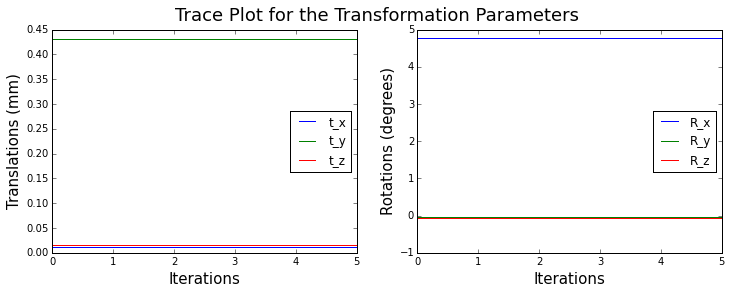

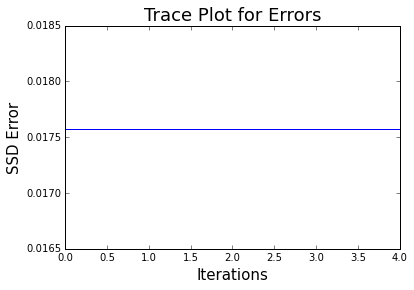

min error: 0.0175716691112
translations: [ 0.01074965  0.43097266  0.01638057] rotations: [ 4.77896254 -0.03499034 -0.06500659]
c =  0.0065
0 1 2 3 4 5 6 7 8 9 Converged in 9 iterations!


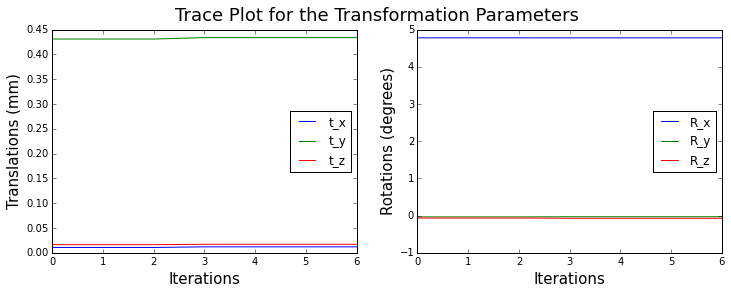

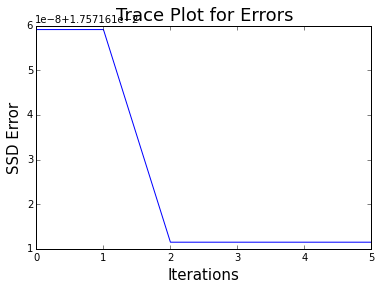

min error: 0.0175716214797
translations: [ 0.01202806  0.43384435  0.017155  ] rotations: [ 4.77814755 -0.03060853 -0.07204806]
c =  0.007
0 1 2 3 4 5 6 Converged in 6 iterations!


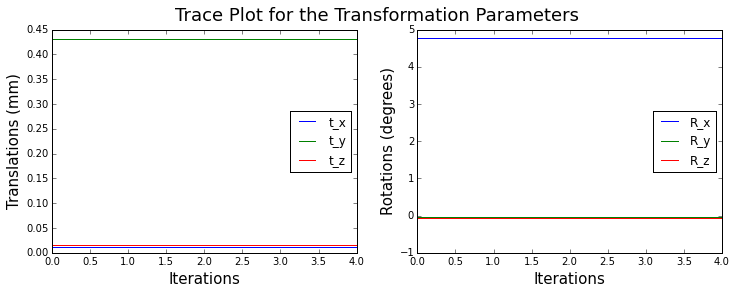

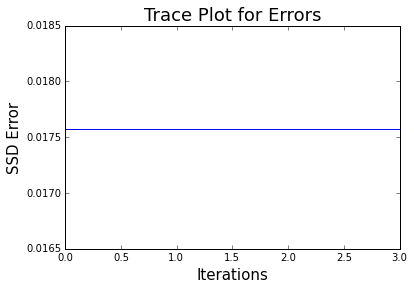

min error: 0.0175716691112
translations: [ 0.01074965  0.43097266  0.01638057] rotations: [ 4.77896254 -0.03499034 -0.06500659]
c =  0.0075
0 1 2 3 4 5 6 Converged in 6 iterations!


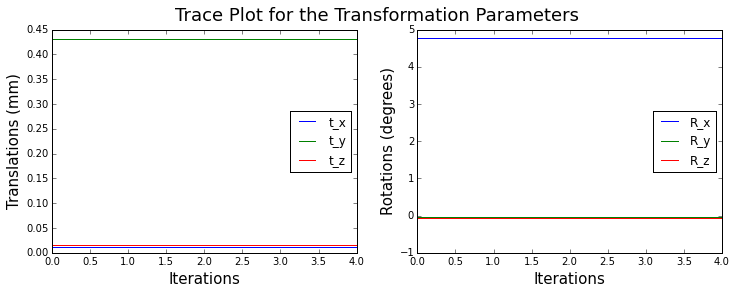

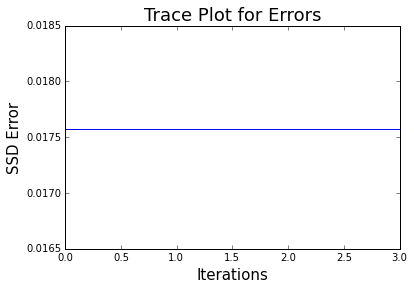

min error: 0.0175716691112
translations: [ 0.01074965  0.43097266  0.01638057] rotations: [ 4.77896254 -0.03499034 -0.06500659]
c =  0.008
0 1 2 3 4 5 6 Converged in 6 iterations!


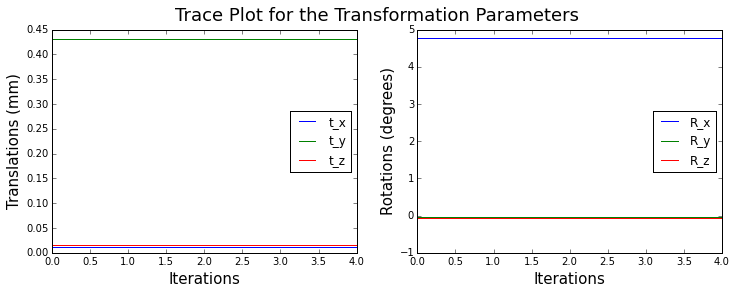

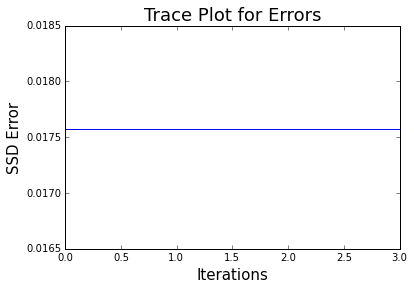

min error: 0.0175716691112
translations: [ 0.01074965  0.43097266  0.01638057] rotations: [ 4.77896254 -0.03499034 -0.06500659]
c =  0.0085
0 1 2 3 4 5 6 Converged in 6 iterations!


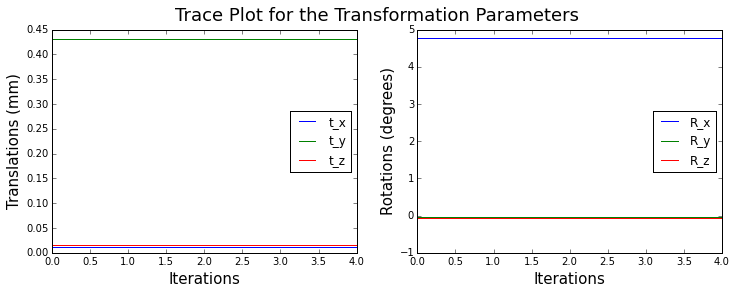

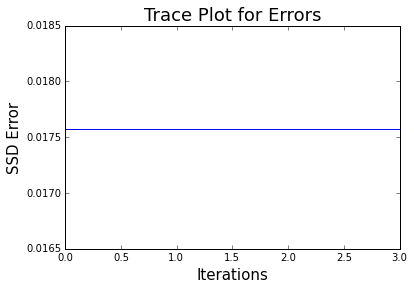

min error: 0.0175716691112
translations: [ 0.01074965  0.43097266  0.01638057] rotations: [ 4.77896254 -0.03499034 -0.06500659]
c =  0.009
0 1 2 3 4 5 6 Converged in 6 iterations!


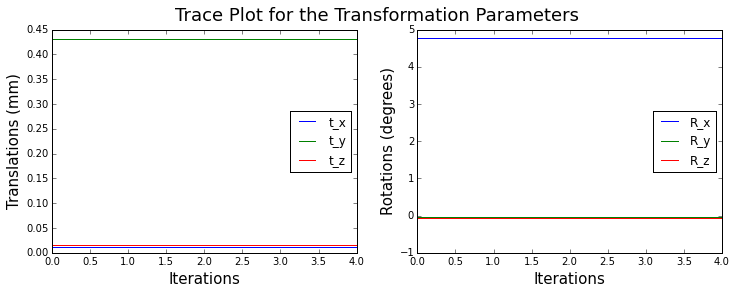

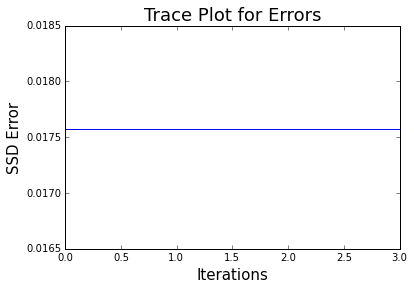

min error: 0.0175716691112
translations: [ 0.01074965  0.43097266  0.01638057] rotations: [ 4.77896254 -0.03499034 -0.06500659]
c =  0.0095
0 1 2 3 4 5 6 Converged in 6 iterations!


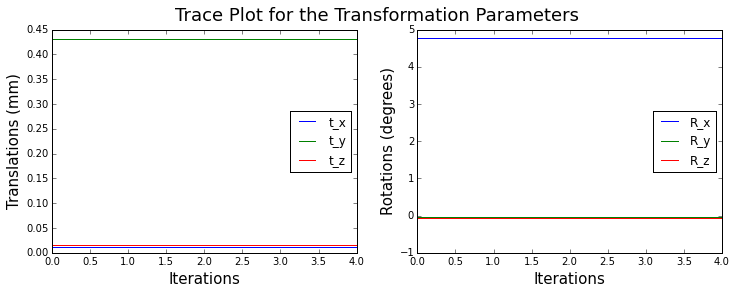

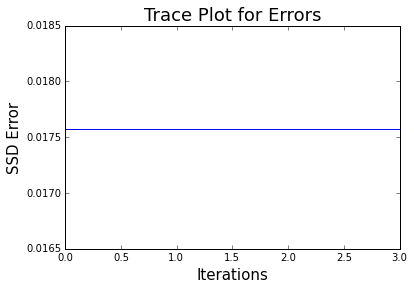

min error: 0.0175716691112
translations: [ 0.01074965  0.43097266  0.01638057] rotations: [ 4.77896254 -0.03499034 -0.06500659]
CPU times: user 2min 34s, sys: 1min 59s, total: 4min 34s
Wall time: 2min 28s


In [215]:
%%time

c_errors = []
c_errors.append(error)
c_ls = np.arange(0,0.01,0.0005)[1:]
for c in c_ls:
    print 'c = ', c
    w = Tukeys_Biweight(R,c)
    W = np.diag(w)
    P_new, R_new, err = Gauss_Newton_IRLS(testVol1_masked, vol1_dervs, testVol2, vol2_dervs, W,
                             divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                             P_initial = P, max_iter = 15, mask = True)
    c_errors.append(err)
    print 'translations:', P_new[:3]*8, 'rotations:',P_new[3:]*180/np.pi

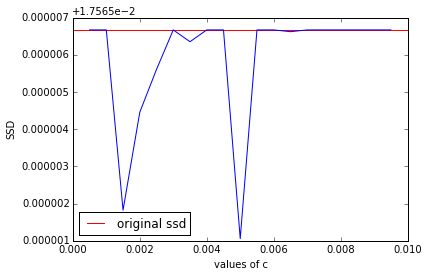

In [216]:
c_ls = np.arange(0,0.01,0.0005)[1:]
plt.plot(c_ls, c_errors[1:])
plt.hlines(c_errors[0],0,0.01,'red',label='original ssd')
plt.xlabel('values of c')
plt.ylabel('SSD')
plt.legend(loc='best')
plt.show()

normalized residual
0 1 2 3 4 5 6 7 8 9 10 11 12 13 14

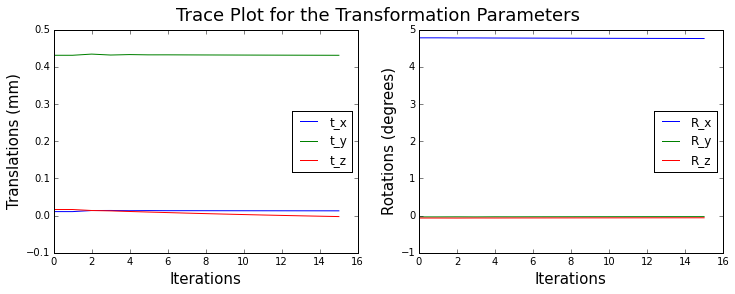

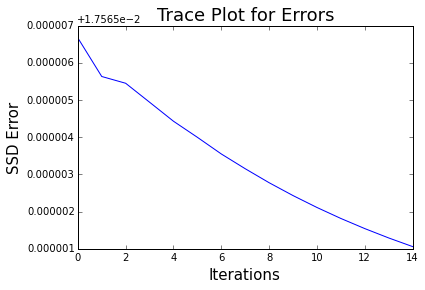

 min error: 0.0175660595
translations: [ 0.01282771  0.43093623 -0.00261066] rotations: [ 4.76015926 -0.02790679 -0.058764  ]
normalized residual
0 1 2 3 4 5 6 7 8 9 Converged in 9 iterations!


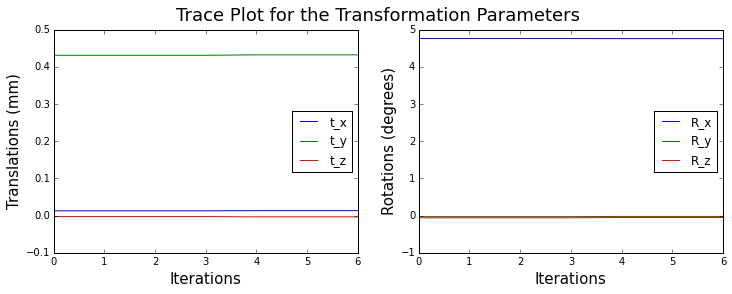

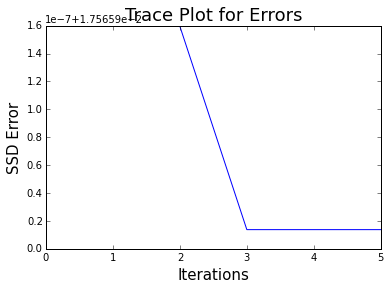

min error: 0.0175659137391
translations: [ 0.01332622  0.43216624 -0.00335617] rotations: [ 4.75721136 -0.02222153 -0.05131667]
normalized residual
0 1 2 3 4 5 Converged in 5 iterations!


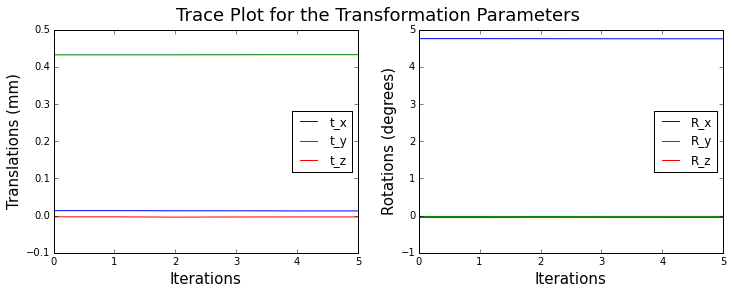

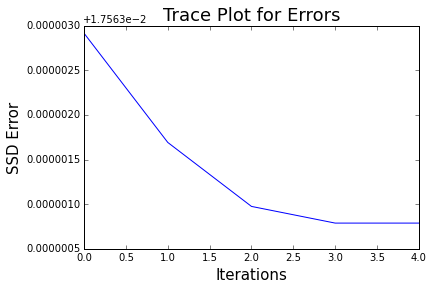

min error: 0.0175637879422
translations: [ 0.0126012   0.43260666 -0.00362411] rotations: [ 4.75323704 -0.02150746 -0.05124833]
normalized residual
0 1 2 3 4 5 6 Converged in 6 iterations!


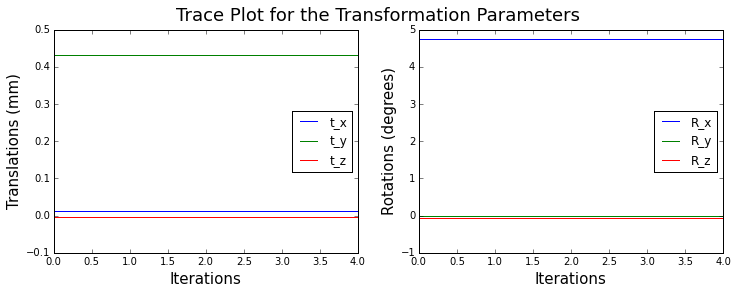

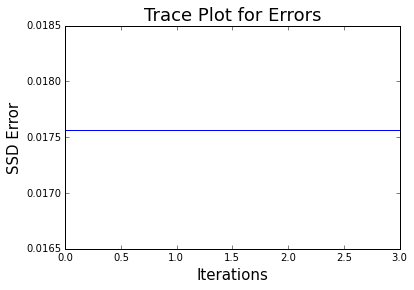

min error: 0.0175637879422
translations: [ 0.0126012   0.43260666 -0.00362411] rotations: [ 4.75323704 -0.02150746 -0.05124833]
normalized residual
0 1 2 3 4 5 6 Converged in 6 iterations!


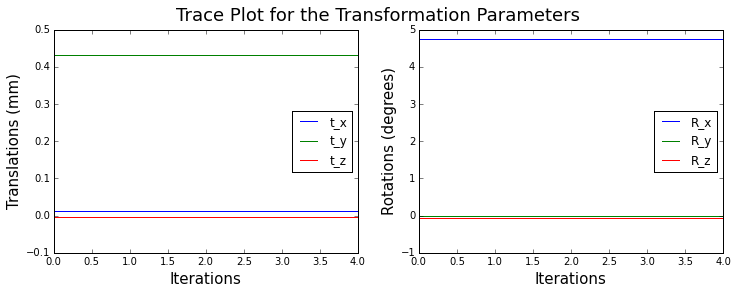

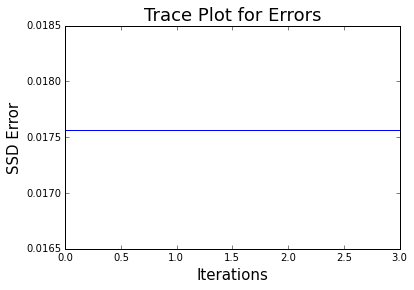

min error: 0.0175637879422
translations: [ 0.0126012   0.43260666 -0.00362411] rotations: [ 4.75323704 -0.02150746 -0.05124833]
normalized residual
0 1 2 3 4 5 6 Converged in 6 iterations!


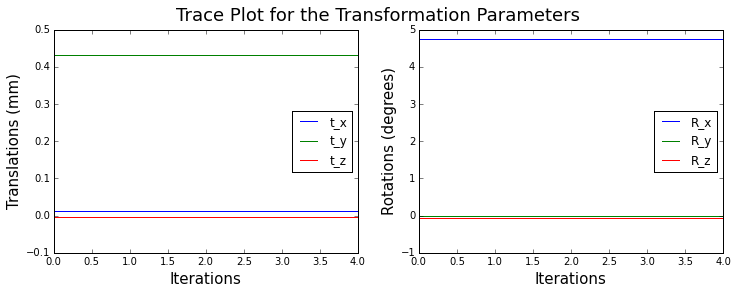

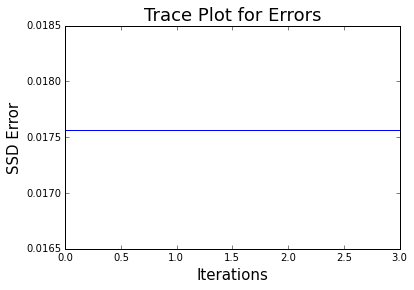

min error: 0.0175637879422
translations: [ 0.0126012   0.43260666 -0.00362411] rotations: [ 4.75323704 -0.02150746 -0.05124833]
normalized residual
0 1 2 3 4 5 6 Converged in 6 iterations!


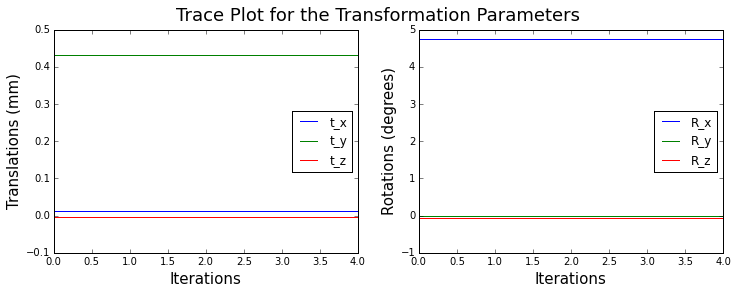

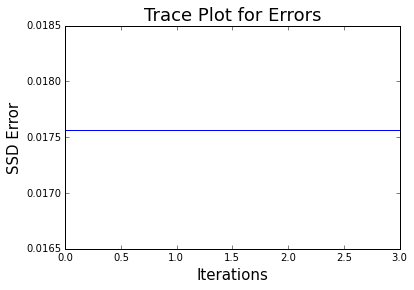

min error: 0.0175637879422
translations: [ 0.0126012   0.43260666 -0.00362411] rotations: [ 4.75323704 -0.02150746 -0.05124833]
normalized residual
0 1 2 3 4 5 6 Converged in 6 iterations!


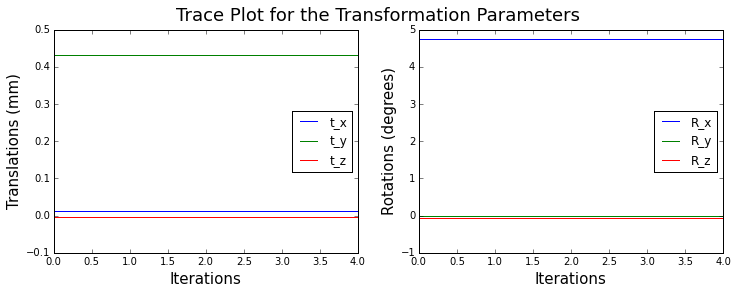

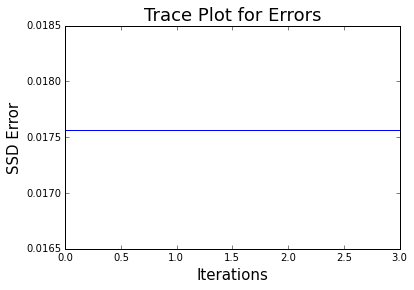

min error: 0.0175637879422
translations: [ 0.0126012   0.43260666 -0.00362411] rotations: [ 4.75323704 -0.02150746 -0.05124833]
normalized residual
0 1 2 3 4 5 6 Converged in 6 iterations!


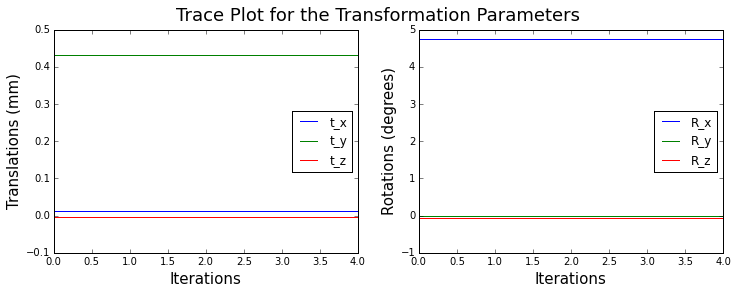

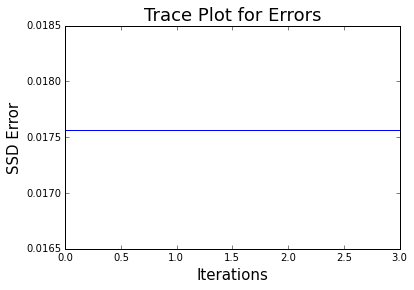

min error: 0.0175637879422
translations: [ 0.0126012   0.43260666 -0.00362411] rotations: [ 4.75323704 -0.02150746 -0.05124833]
normalized residual
0 1 2 3 4 5 6 Converged in 6 iterations!


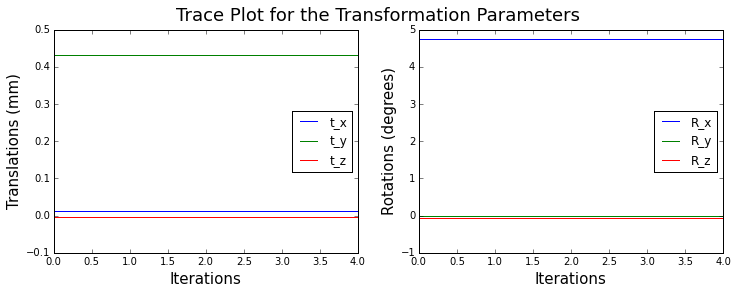

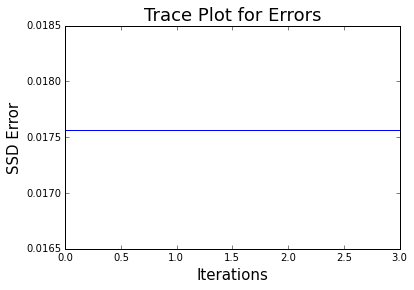

min error: 0.0175637879422
translations: [ 0.0126012   0.43260666 -0.00362411] rotations: [ 4.75323704 -0.02150746 -0.05124833]
CPU times: user 1min 20s, sys: 1min 3s, total: 2min 24s
Wall time: 1min 17s


In [218]:
%%time
errors = []
errors.append(error)
c = 0.005
for i in xrange(10):
    R_nonzero = (R.reshape([32,32,32]))[nonzero_mask]
    mad_r = MAD(R_nonzero)
    if mad_r != 0:
        print 'normalized residual'
        R = (1./mad_r)*R
    w = Tukeys_Biweight(R,c)
    W = np.diag(w)
    P, R, err = Gauss_Newton_IRLS(testVol1_masked, vol1_dervs, testVol2, vol2_dervs, W,
                             divide_factor = 16., alpha = 1., decrease_factor = 0.25, 
                             P_initial = P, max_iter = 15, mask = True)
    errors.append(err)
    print 'translations:', P[:3]*8, 'rotations:',P[3:]*180/np.pi

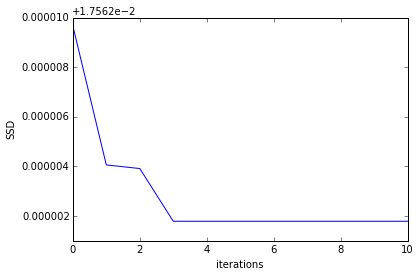

In [219]:
plt.plot(errors)
plt.xlabel('iterations')
plt.ylabel('SSD')
plt.show()